# <span style="color:#F72585">Introducción a Keras LSTM para series de tiempo multivariadas</span>

Ejemplo datos de clima (weather)

## <span style="color:#4361EE">Introducción</span>


Este cuaderno es  una introducción a la predicción de series de tiempo utilizando redes neuronales recurrentes (RNN). Esto se cubre en dos partes: primero, pronosticará una serie de tiempo univariada, luego pronosticará una serie de tiempo multivariada.


## <span style="color:#4361EE">Importar las librería requeridas</span>

In [1]:
import tensorflow as tf

import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd

mpl.rcParams['figure.figsize'] = (8, 6)
mpl.rcParams['axes.grid'] = False

print('version de tf: ', tf.__version__)

from tensorflow.keras.layers import Input, LSTM, Dense, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam 

version de tf:  2.9.1


## <span style="color:#4361EE">El conjunto de datos weather</span> 


Usaremos el conjunto de datos (dataset) [weather time series dataset recorded by the Max Planck Institute for Biogeochemistry](https://www.bgc-jena.mpg.de/wetter/). Estan disponibles en [kaggle](https://www.kaggle.com/kusuri/jena-climate), en una versión preparada por Francois Chollet, la cual usaremos aquí.

Este dataset contiene 14 variables (features) diferentes tales como temperatura ambiente, presión atmosférica, y humedad. Estos datos fueron recolectados cada 10 minutos, comenzando en 2003. Por eficiencia, usaremos los datos recolectados entre 2009 y 2016. Estos datos fueron preparados por François Chollet para su libro Deep Learning with Python. En total son 420551 registros de datos.

In [2]:
# download teh data and store it in your system
zip_path = tf.keras.utils.get_file(
    origin='https://storage.googleapis.com/tensorflow/tf-keras-datasets/jena_climate_2009_2016.csv.zip',
    fname='jena_climate_2009_2016.csv.zip',
    extract=True)
# after download the file is in this path
csv_path, _ = os.path.splitext(zip_path) # /home/alvaro/.keras/datasets/jena_climate_2009_2016.csv'


13568290/13568290 [==============================] - 2s 0us/step


In [3]:
csv_path

'C:\\Users\\User\\.keras\\datasets\\jena_climate_2009_2016.csv'

In [4]:
df = pd.read_csv(csv_path)

### <span style="color:#4CC9F0">Una primera mirada a los datos</span>


In [5]:
df.head()

,Date Time,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg)
0,01.01.2009 00:10:00,996.52,-8.02,265.40,-8.90,93.3,3.33,3.11,0.22,1.94,3.12,1307.75,1.03,1.75,152.3
1,01.01.2009 00:20:00,996.57,-8.41,265.01,-9.28,93.4,3.23,3.02,0.21,1.89,3.03,1309.80,0.72,1.50,136.1
2,01.01.2009 00:30:00,996.53,-8.51,264.91,-9.31,93.9,3.21,3.01,0.20,1.88,3.02,1310.24,0.19,0.63,171.6
3,01.01.2009 00:40:00,996.51,-8.31,265.12,-9.07,94.2,3.26,3.07,0.19,1.92,3.08,1309.19,0.34,0.50,198.0
4,01.01.2009 00:50:00,996.51,-8.27,265.15,-9.04,94.1,3.27,3.08,0.19,1.92,3.09,1309.00,0.32,0.63,214.3


In [6]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
p (mbar),420551.0,989.212776,8.358481,913.60,984.20,989.58,994.72,1015.35
T (degC),420551.0,9.450147,8.423365,-23.01,3.36,9.42,15.47,37.28
Tpot (K),420551.0,283.492743,8.504471,250.60,277.43,283.47,289.53,311.34
Tdew (degC),420551.0,4.955854,6.730674,-25.01,0.24,5.22,10.07,23.11
rh (%),420551.0,76.008259,16.476175,12.95,65.21,79.30,89.40,100.00
VPmax (mbar),420551.0,13.576251,7.739020,0.95,7.78,11.82,17.60,63.77
VPact (mbar),420551.0,9.533756,4.184164,0.79,6.21,8.86,12.35,28.32
VPdef (mbar),420551.0,4.042412,4.896851,0.00,0.87,2.19,5.30,46.01
sh (g/kg),420551.0,6.022408,2.656139,0.50,3.92,5.59,7.80,18.13
H2OC (mmol/mol),420551.0,9.640223,4.235395,0.80,6.29,8.96,12.49,28.82


Como puede verse arriba, se registra una observación cada 10 minutos. Esto significa que, durante una hora, se tendrán 6 observaciones. Del mismo modo, en un  día se tienen 144 (6x24) observaciones. En total son 420551 observaciones.

Dado un tiempo específico, digamos que desea predecir la temperatura 6 horas en el futuro. Para hacer esta predicción, se elige usar 5 días de observaciones. Por lo tanto, crearía una ventana que contiene las últimas 720 (5x144) observaciones para entrenar el modelo. Son posibles muchas de estas configuraciones, lo que hace que este conjunto de datos sea bueno para experimentar.

La siguiente función devuelve las ventanas de tiempo descritas anteriormente para entrenar el modelo. El parámetro *history_size* es el tamaño de la ventana de información pasada. El *target_size* es qué tan lejos en el futuro necesita el modelo aprender a predecir; *target_size* es la etiqueta que debe predecirse.

## <span style="color:#4361EE">Funciones para gráficos</span>

In [7]:
def create_time_steps(length):
  return list(range(-length, 0))

In [8]:
def show_plot(plot_data, delta, title):
  labels = ['Historia', 'Futuro Verdadero' , 'Predicción del Modelo']
  marker = ['.-', 'rx', 'go']
  time_steps = create_time_steps(plot_data[0].shape[0])
  if delta:
    future = delta
  else:
    future = 0

  plt.title(title)
  for i, x in enumerate(plot_data):
    if i:
      plt.plot(future, plot_data[i], marker[i], markersize=10,
               label=labels[i])
    else:
      plt.plot(time_steps, plot_data[i].flatten(), marker[i], label=labels[i])
  plt.legend()
  plt.xlim([time_steps[0], (future+5)*2])
  plt.xlabel('Salto de tiempo (Time-Step)')
  return plt

In [9]:
def plot_train_history(history, title):
    loss = history.history['loss']
    val_loss = history.history['val_loss']

    epochs = range(len(loss))

    plt.figure()

    plt.plot(epochs, loss, 'b', label='Pérdida entrenamiento')
    plt.plot(epochs, val_loss, 'r', label='Pérdida validación')
    plt.title(title)
    plt.legend()

    plt.show()

In [10]:
def plot_serie_prediction(y_test, y_pred,rms, epochs):
    plt.plot(np.arange(0, len(y_test)), y_test, marker='.', label="verdadero")
    plt.plot(np.arange(0, len(y_test)), y_pred, marker='+', label="predicho")
    plt.xlabel('Time Step')
    plt.annotate("rms = "+str(round(rms,2)) , xy=(100, 140), size = 15)
    #plt.annotate("modelo = LSTM(50), timestep=60" , xy=(100, 146), size = 15)
    #plt.annotate("epochs=40" , xy=(100, 143), size = 15)
    plt.title("Intervalo de predicción a un día. Escala original", size = 20)
    plt.legend()
    plt.show()

## <span style="color:#4361EE">Funciones para preparar datos de entrenamiento</span>

### <span style="color:#4CC9F0">Caso Univariado</span>


In [11]:
def univariate_data(dataset, start_index, end_index, history_size, target_size):
    ''' dataset: conjunto de datos
        start_index: índice inicial de donde empezar a tomar los datos
        end_index: índice final para tomar los datos. None para tomarlos todos
        history_size: tamaño de la venytana para crear las secuencias
        target_size: dentro de cuántas observaciones futuras desea pronosticar
    '''
   
    data = []
    labels = []

    start_index = start_index + history_size
    if end_index is None:
        end_index = len(dataset) - target_size

    for i in range(start_index, end_index):
        indices = range(i-history_size, i)
        # Reshape data from (history_size,) to (history_size, 1)
        data.append(np.reshape(dataset[indices], (history_size, 1)))
        labels.append(dataset[i+target_size])
    
    return np.array(data), np.array(labels)

### <span style="color:#4CC9F0">Caso multivariado</span>


In [12]:
def multivariate_data(dataset, target, start_index, end_index, history_size,
                      target_size, step, single_step=False):
    ''' dataset: conjunto de datos para las secuencias de entrada
        target:  conjunto de datos para las secuencias de salida
        start_index: índice inicial de donde empezar a tomar los datos
        end_index: índice final para tomar los datos. None para tomarlos todos
        history_size: tamaño de la venytana para crear las secuencias
        target_size: dentro de cuántas observaciones futuras desea pronosticar
        step: Cada cuántas observaciones deben tomarse. Para secuencias muy largas
              que no cambia mucho localmente
        single_step: Predecir solamente un valor futuro (=True),
                     o predecir todos los valores hasta target_size(=False)
    '''  
    data = []
    labels = []

    start_index = start_index + history_size
    if end_index is None:
        end_index = len(dataset) - target_size

    for i in range(start_index, end_index):
        indices = range(i-history_size, i, step)
        data.append(dataset[indices])

        if single_step:
            labels.append(target[i+target_size])
        else:
            labels.append(target[i:i+target_size])

    return np.array(data), np.array(labels)

En las partes  siguientes, las primeras 300,000 filas de datos serán el conjunto de datos de entrenamiento, y el resto será el conjunto de datos de validación (120551). Esto equivale a unos 2100 días de datos de entrenamiento.


In [13]:
TRAIN_SPLIT = 300000

Se coloca una semilla para gerantizar reproductibidad

In [14]:
tf.random.set_seed(13)

## <span style="color:#4361EE">Pronóstico de una serie de tiempo multivariada</span>


El conjunto de datos original contiene catorce variables (features). Para simplificar, esta sección considera solo tres de los catorce originales. Las características utilizadas son la temperatura del aire, la presión atmosférica y la densidad del aire.

Para usar más variables, agregue sus nombres a esta lista.

In [15]:
features_considered = ['p (mbar)', 'T (degC)', 'rho (g/m**3)']

In [16]:
features = df[features_considered]
features.index = df['Date Time']
features.head()

,p (mbar),T (degC),rho (g/m**3)
Date Time,,,
01.01.2009 00:10:00,996.52,-8.02,1307.75
01.01.2009 00:20:00,996.57,-8.41,1309.80
01.01.2009 00:30:00,996.53,-8.51,1310.24
01.01.2009 00:40:00,996.51,-8.31,1309.19
01.01.2009 00:50:00,996.51,-8.27,1309.00



Echemos un vistazo a cómo cada una de estas características varía con el tiempo.


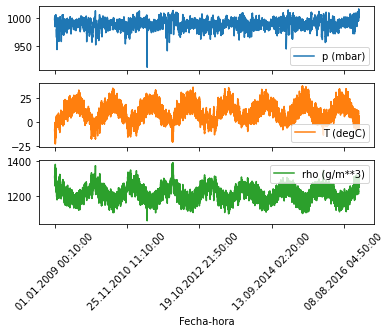

In [17]:
features.plot(subplots=True, rot=45, xlabel='Fecha-hora')
plt.show()

Como se mencionó, el primer paso será estandarizar el conjunto de datos utilizando la media y la desviación estándar de los datos de entrenamiento.

In [18]:
dataset = features.values
data_mean = dataset[:TRAIN_SPLIT].mean(axis=0)
data_std = dataset[:TRAIN_SPLIT].std(axis=0)

In [19]:
dataset = (dataset-data_mean)/data_std

## <span style="color:#4361EE">Modelo de un Paso</span>


En una configuración de un  paso, el modelo aprende a predecir un solo punto en el futuro en función del historial proporcionado.

La función a continuación realiza la misma tarea de ventanas que antes, sin embargo, aquí muestra la observación pasada en función del tamaño de paso dado.

En este cuaderno, la red muestra datos de los últimos cinco (5) días, es decir, 720 observaciones que se muestrean cada hora. El muestreo se realiza cada  hora, ya que no se espera un cambio drástico en 60 minutos. Por lo tanto, 120 observaciones representan la historia de los últimos cinco días. Para el modelo de predicción de un solo paso, la etiqueta para un punto de datos es la temperatura dentro de 12 horas. Para crear una etiqueta para esto, se utiliza la temperatura después de 72 (12 * 6) observaciones.

### <span style="color:#4CC9F0">Crea arreglos de datos de entrenamiento y validación</span>


In [20]:
past_history = 720
future_target = 72
STEP = 6

x_train_single, y_train_single = multivariate_data(dataset, dataset[:, 1], 0,
                                                   TRAIN_SPLIT, past_history,
                                                   future_target, STEP,
                                                   single_step=True)
x_val_single, y_val_single = multivariate_data(dataset, dataset[:, 1],
                                               TRAIN_SPLIT, None, past_history,
                                               future_target, STEP,
                                               single_step=True)

In [21]:
print(dataset.shape)
print(x_train_single.shape)
print(y_train_single.shape)
print(x_val_single.shape)
print(y_val_single.shape)

(420551, 3)
(299280, 120, 3)
(299280,)
(119759, 120, 3)
(119759,)


Veamos una ventana de datos de la historia pasada

In [22]:
print ('Ventana ejemplo de la historia pasada : {}'.format(x_train_single[0].shape))

Ventana ejemplo de la historia pasada : (120, 3)


In [23]:
#x_train_single[0:10,:]

### <span style="color:#4CC9F0">Crea objetos tf.data.Dataset para entreno y validación</span>

Para manejo más eficiente de memoria 

In [24]:
BATCH_SIZE = 256
BUFFER_SIZE = 10000

train_data_single = tf.data.Dataset.from_tensor_slices((x_train_single, y_train_single))
train_data_single = train_data_single.cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE).repeat()

val_data_single = tf.data.Dataset.from_tensor_slices((x_val_single, y_val_single))
val_data_single = val_data_single.batch(BATCH_SIZE).repeat()

## <span style="color:#4361EE">Breve revisión de cache, shuffle, batch y repeat</span>

### <span style="color:#4CC9F0">¿Cómo trabaja dataset.shuffle()?</span>


### <span style="color:#4CC9F0">¿Cómo trabaja dataset.repeat() ?</span>

### <span style="color:#4CC9F0">¿Qué produce dataset.batch?</span>


### <span style="color:#4CC9F0">¿Qué es el caché?</span>


Los datos almacenados en caché son archivos, scripts, imágenes y otros elementos multimedia almacenados en su dispositivo después de abrir una aplicación o visitar un sitio web por primera vez. Estos datos se utilizan para cargar rápidamente información sobre la aplicación o el sitio web cada vez que se revisa. 

La memoria caché tiene una latencia extremadamente baja, lo que significa que se puede acceder muy rápidamente. La otra cara de la baja latencia significa que no se puede almacenar mucha memoria. Esta es la razón por la cual los archivos de pequeño tamaño  se almacenan en la memoria caché. 

Como cualquier red implementada en *tf.keras*  la capa de entrada requiere require el tamaño de entrada de los datos.


### <span style="color:#4CC9F0">Modelo LSTM</span>

In [25]:
input_shape = (x_train_single.shape[1], x_train_single.shape[2])
units = 32
drop_out_rate = 0.0

# layers
inputs = Input(input_shape)
x = Dropout(drop_out_rate, name= 'Dropout_01')(inputs)
x = LSTM(units=units, name='LSTM_layer',
         dropout=drop_out_rate, recurrent_dropout=drop_out_rate)(x)
x = Dropout(drop_out_rate, name= 'Dropout_02')(x)
outputs = Dense(1)(x)

# model
single_step_model = Model(inputs=inputs, outputs=outputs, name='series_LSTM_model')
single_step_model.summary()


#single_step_model = tf.keras.models.Sequential()
#single_step_model.add(tf.keras.layers.LSTM(32, input_shape=x_train_single.shape[-2:]))
#single_step_model.add(tf.keras.layers.Dense(1))

Model: "series_LSTM_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 120, 3)]          0         
                                                                 
 Dropout_01 (Dropout)        (None, 120, 3)            0         
                                                                 
 LSTM_layer (LSTM)           (None, 32)                4608      
                                                                 
 Dropout_02 (Dropout)        (None, 32)                0         
                                                                 
 dense (Dense)               (None, 1)                 33        
                                                                 
Total params: 4,641
Trainable params: 4,641
Non-trainable params: 0
_________________________________________________________________


### <span style="color:#4CC9F0">Compila</span>

Usamos la función de costo mean absolute error definida por

$$
mae = \frac{1}{n}\sum_{i=1}^n|y_i - \tilde{y}_i|
$$

In [26]:
single_step_model.compile(optimizer=Adam(), loss='mae')

Revisemos una predicción simple

In [27]:
for x, y in val_data_single.take(1):
  print(single_step_model.predict(x).shape)

8/8 [==============================] - 1s 19ms/step
(256, 1)


In [28]:
#single_step_model.predict(x).T

### <span style="color:#4CC9F0">Entrena</span>

In [29]:
EVALUATION_INTERVAL = 200
EPOCHS = 10
single_step_history = single_step_model.fit(train_data_single, epochs=EPOCHS,
                                            steps_per_epoch=EVALUATION_INTERVAL,
                                            validation_data=val_data_single,
                                            validation_steps=50)

Epoch 1/10
200/200 [==============================] - 33s 146ms/step - loss: 0.3774 - val_loss: 0.2638
Epoch 2/10
200/200 [==============================] - 30s 148ms/step - loss: 0.2693 - val_loss: 0.2479
Epoch 3/10
200/200 [==============================] - 33s 163ms/step - loss: 0.2651 - val_loss: 0.2626
Epoch 4/10
200/200 [==============================] - 30s 152ms/step - loss: 0.2613 - val_loss: 0.2454
Epoch 5/10
200/200 [==============================] - 29s 145ms/step - loss: 0.2286 - val_loss: 0.2345
Epoch 6/10
200/200 [==============================] - 33s 167ms/step - loss: 0.2428 - val_loss: 0.2618
Epoch 7/10
200/200 [==============================] - 37s 187ms/step - loss: 0.2461 - val_loss: 0.2520
Epoch 8/10
200/200 [==============================] - 34s 172ms/step - loss: 0.2464 - val_loss: 0.2436
Epoch 9/10
200/200 [==============================] - 35s 177ms/step - loss: 0.2527 - val_loss: 0.2512
Epoch 10/10
200/200 [==============================] - 31s 155ms/step - l

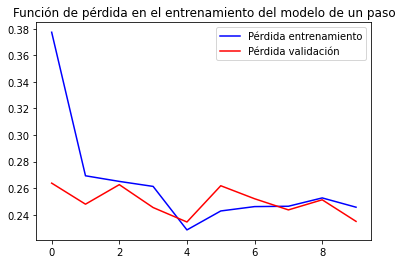

In [30]:
plot_train_history(single_step_history,
                   'Función de pérdida en el entrenamiento del modelo de un paso')

## <span style="color:#4361EE">Predicciones</span>


Ahora que el modelo está entrenado, hagamos algunas predicciones de muestra. El modelo tiene el historial de tres features en los últimos cinco días muestreados cada hora (120 puntos de datos), ya que el objetivo es predecir la temperatura, el gráfico solo muestra la temperatura pasada. La predicción se hace un día en el futuro (de ahí la brecha entre la historia y la predicción).

8/8 [==============================] - 0s 21ms/step


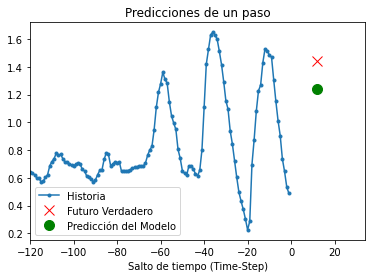

8/8 [==============================] - 0s 17ms/step


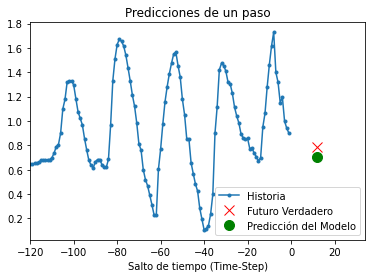

8/8 [==============================] - 0s 21ms/step


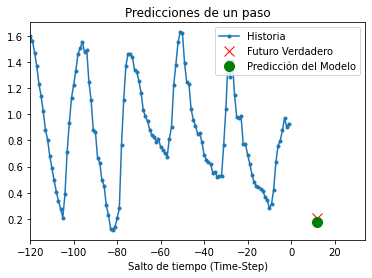

In [31]:
for x, y in val_data_single.take(3):
    plot = show_plot([x[0][:, 1].numpy(), y[0].numpy(),
                    single_step_model.predict(x)[0]], 12,
                   'Predicciones de un paso')
    plot.show()

8/8 [==============================] - 0s 18ms/step


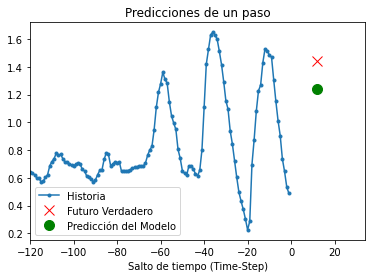

8/8 [==============================] - 0s 22ms/step


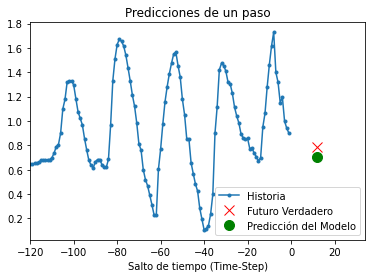

8/8 [==============================] - 0s 17ms/step


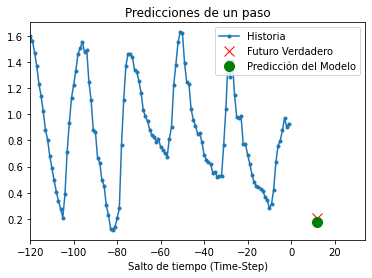

8/8 [==============================] - 0s 20ms/step


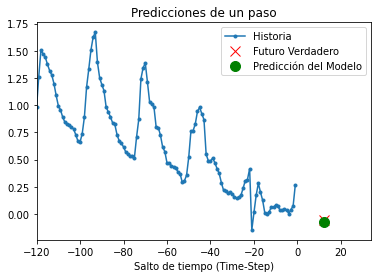

8/8 [==============================] - 0s 18ms/step


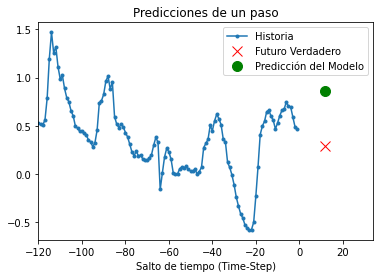

8/8 [==============================] - 0s 20ms/step


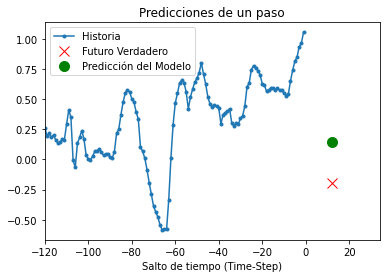

8/8 [==============================] - 0s 21ms/step


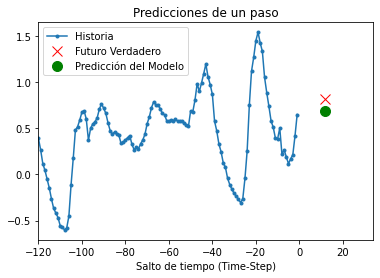

8/8 [==============================] - 0s 20ms/step


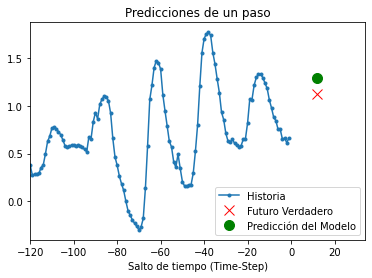

8/8 [==============================] - 0s 27ms/step


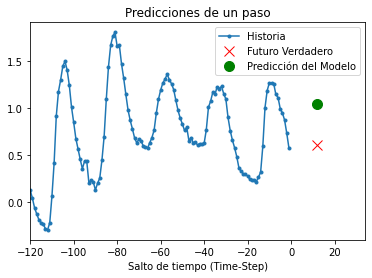

8/8 [==============================] - 0s 21ms/step


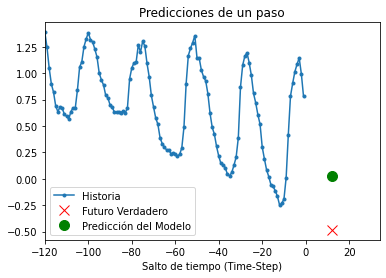

8/8 [==============================] - 0s 18ms/step


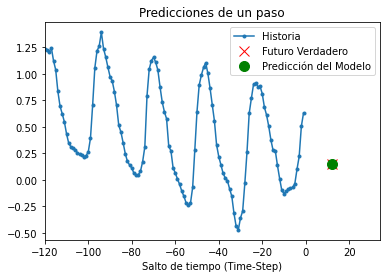

8/8 [==============================] - 0s 21ms/step


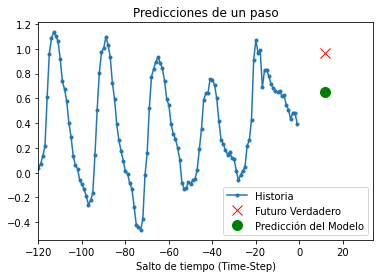

8/8 [==============================] - 0s 22ms/step


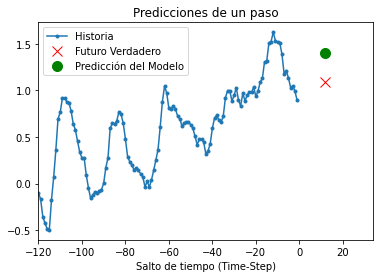

8/8 [==============================] - 0s 22ms/step


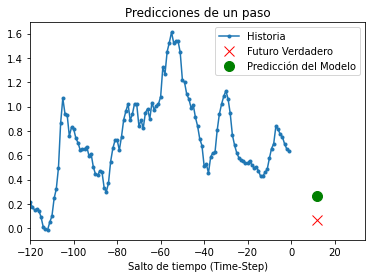

8/8 [==============================] - 0s 25ms/step


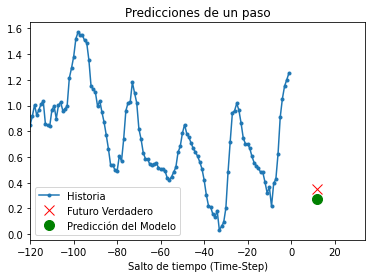

8/8 [==============================] - 0s 19ms/step


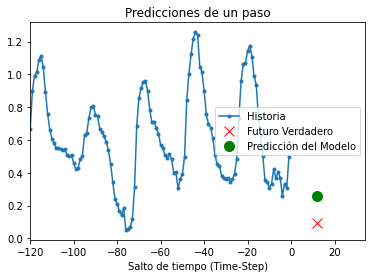

8/8 [==============================] - 0s 22ms/step


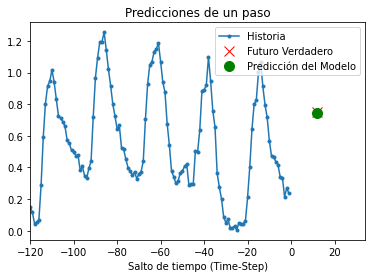

8/8 [==============================] - 0s 21ms/step


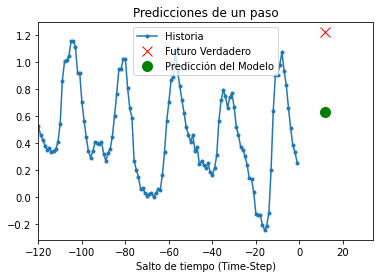

8/8 [==============================] - 0s 21ms/step


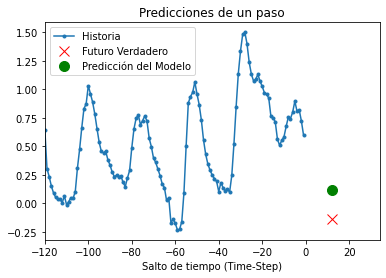

8/8 [==============================] - 0s 18ms/step


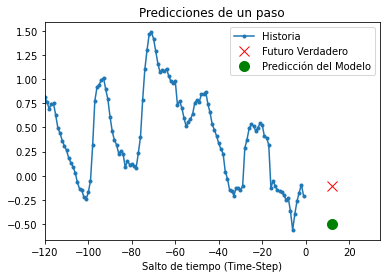

8/8 [==============================] - 0s 23ms/step


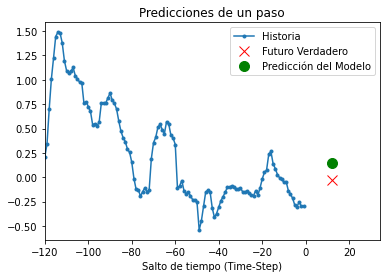

8/8 [==============================] - 0s 21ms/step


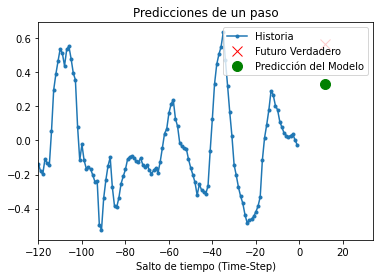

8/8 [==============================] - 0s 19ms/step


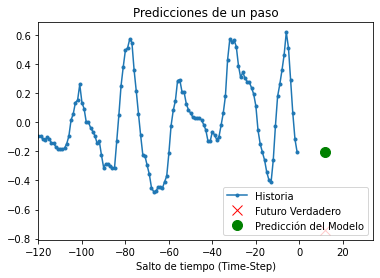

8/8 [==============================] - 0s 13ms/step


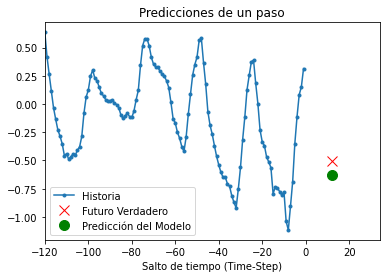

8/8 [==============================] - 0s 17ms/step


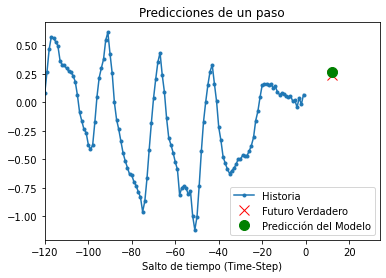

8/8 [==============================] - 0s 18ms/step


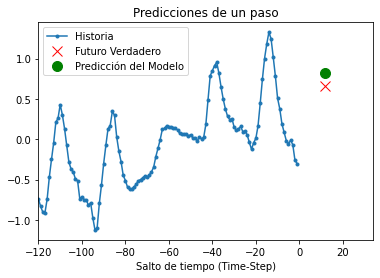

8/8 [==============================] - 0s 24ms/step


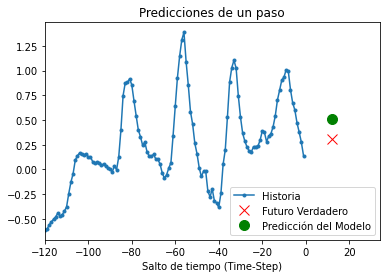

8/8 [==============================] - 0s 25ms/step


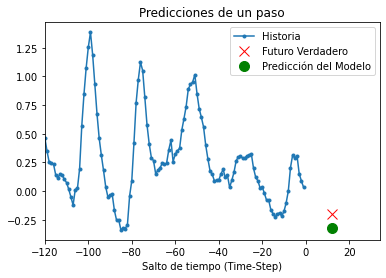

8/8 [==============================] - 0s 24ms/step


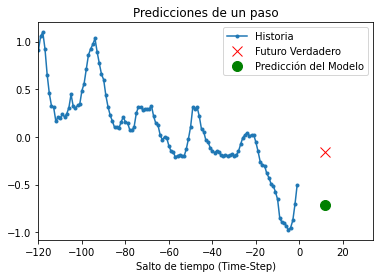

8/8 [==============================] - 0s 22ms/step


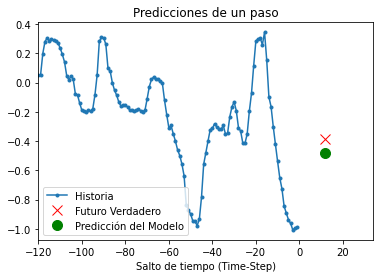

8/8 [==============================] - 0s 22ms/step


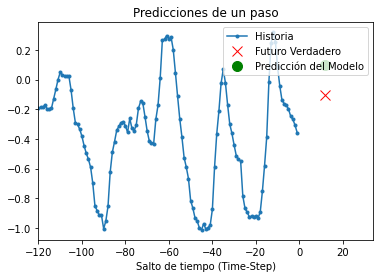

8/8 [==============================] - 0s 26ms/step


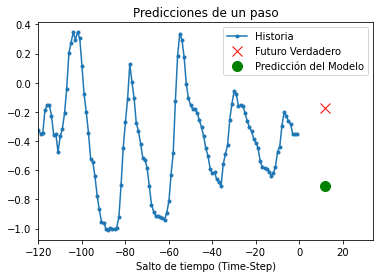

8/8 [==============================] - 0s 21ms/step


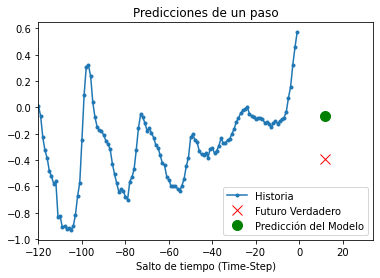

8/8 [==============================] - 0s 20ms/step


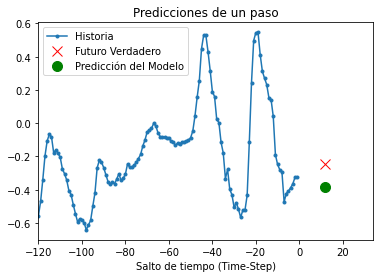

8/8 [==============================] - 0s 18ms/step


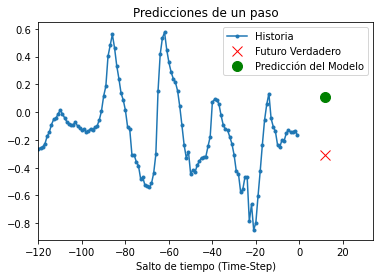

8/8 [==============================] - 0s 20ms/step


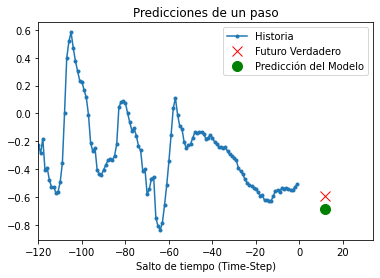

8/8 [==============================] - 0s 23ms/step


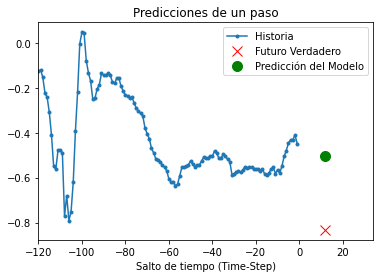

8/8 [==============================] - 0s 23ms/step


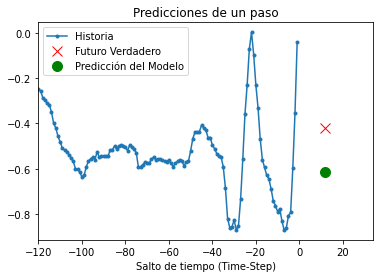

8/8 [==============================] - 0s 18ms/step


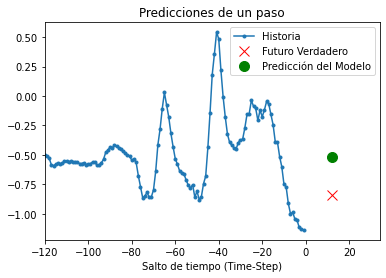

8/8 [==============================] - 0s 26ms/step


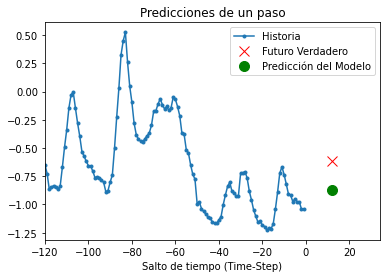

8/8 [==============================] - 0s 28ms/step


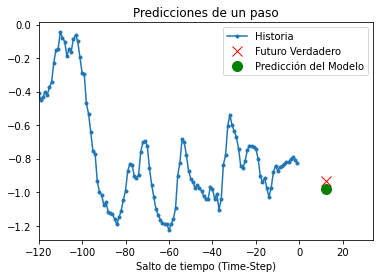

8/8 [==============================] - 0s 24ms/step


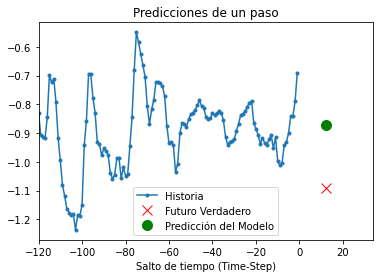

8/8 [==============================] - 0s 31ms/step


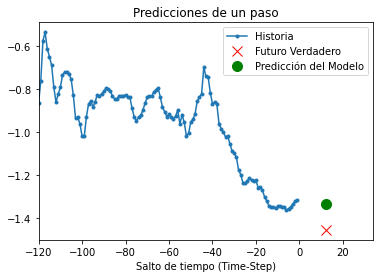

8/8 [==============================] - 0s 18ms/step


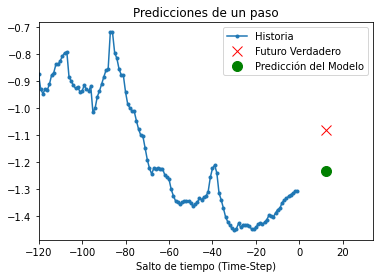

8/8 [==============================] - 0s 23ms/step


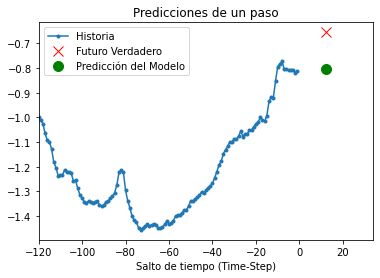

8/8 [==============================] - 0s 17ms/step


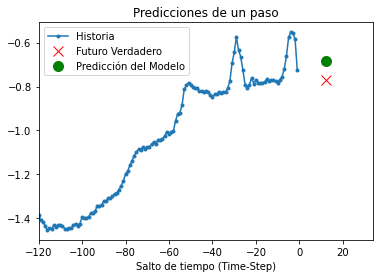

8/8 [==============================] - 0s 18ms/step


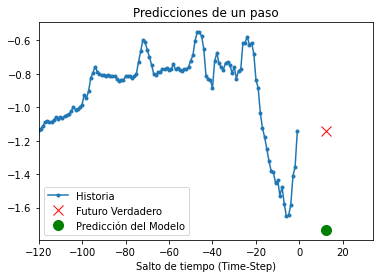

8/8 [==============================] - 0s 19ms/step


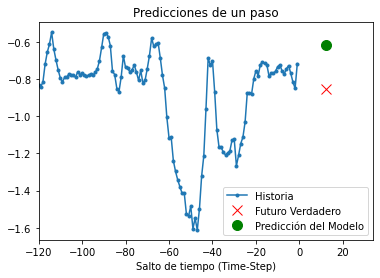

8/8 [==============================] - 0s 16ms/step


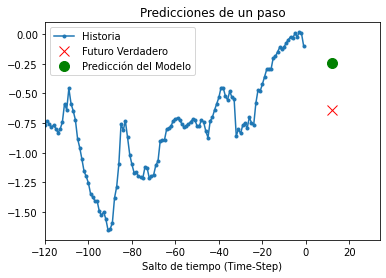

8/8 [==============================] - 0s 21ms/step


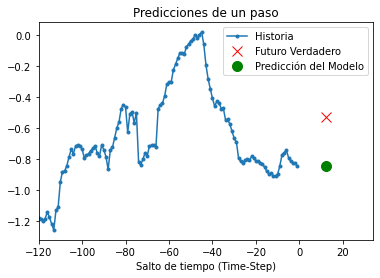

8/8 [==============================] - 0s 18ms/step


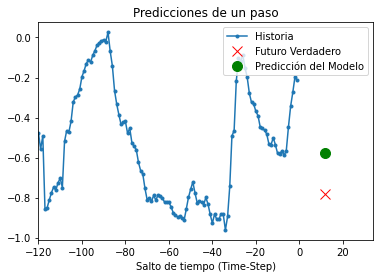

8/8 [==============================] - 0s 18ms/step


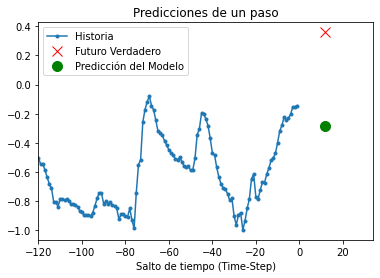

8/8 [==============================] - 0s 21ms/step


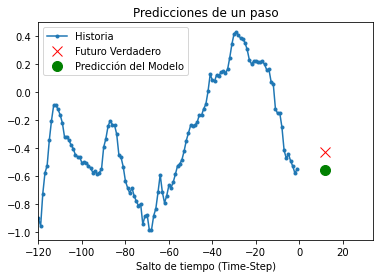

8/8 [==============================] - 0s 23ms/step


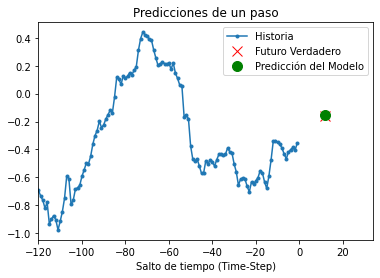

8/8 [==============================] - 0s 18ms/step


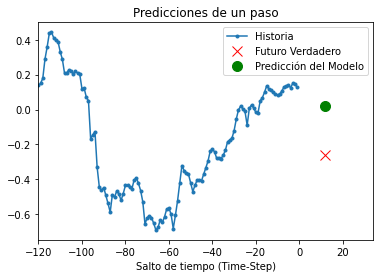

8/8 [==============================] - 0s 18ms/step


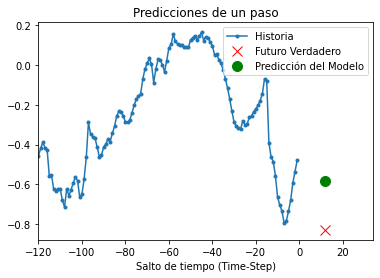

8/8 [==============================] - 0s 18ms/step


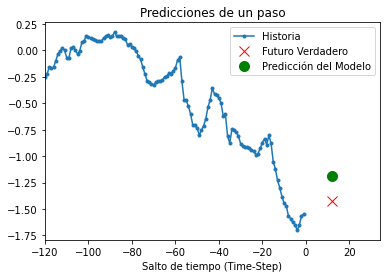

8/8 [==============================] - 0s 19ms/step


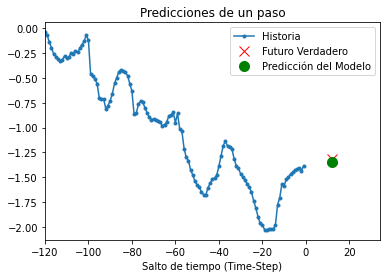

8/8 [==============================] - 0s 18ms/step


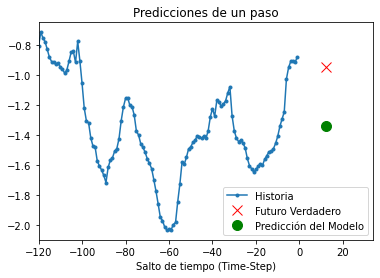

8/8 [==============================] - 0s 23ms/step


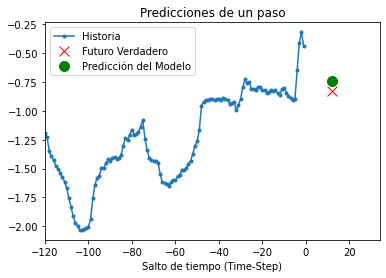

8/8 [==============================] - 0s 18ms/step


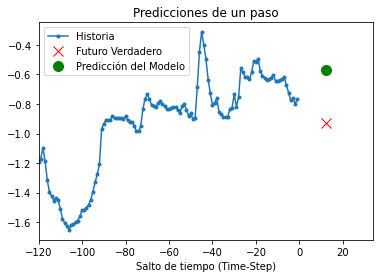

8/8 [==============================] - 0s 17ms/step


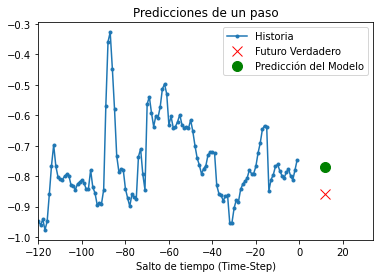

8/8 [==============================] - 0s 19ms/step


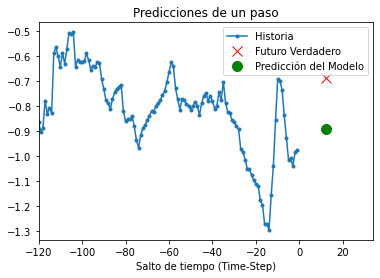

8/8 [==============================] - 0s 19ms/step


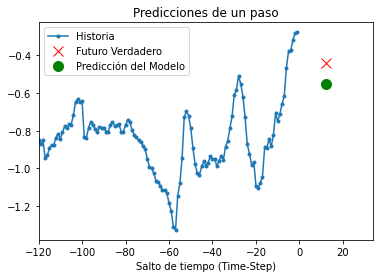

8/8 [==============================] - 0s 16ms/step


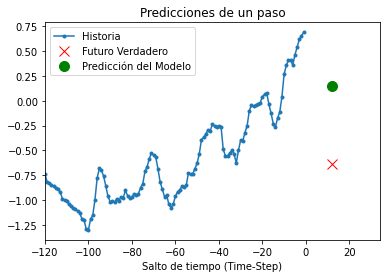

8/8 [==============================] - 0s 16ms/step


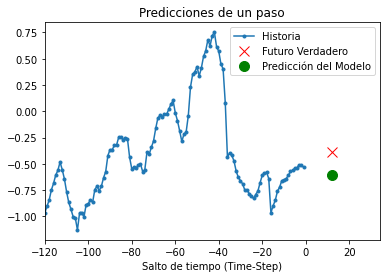

8/8 [==============================] - 0s 19ms/step


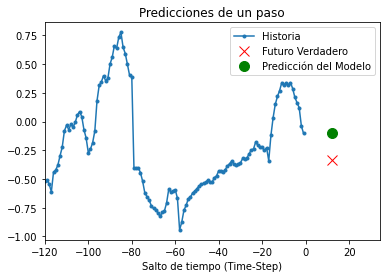

8/8 [==============================] - 0s 19ms/step


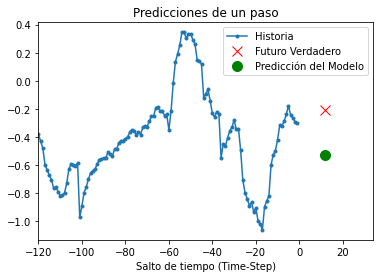

8/8 [==============================] - 0s 29ms/step


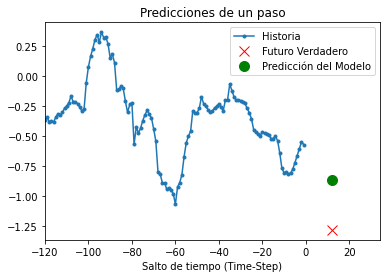

8/8 [==============================] - 0s 17ms/step


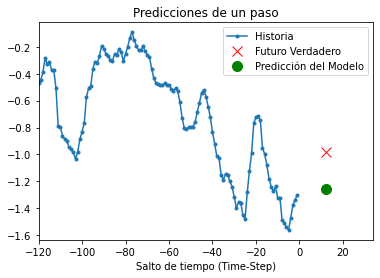

8/8 [==============================] - 0s 17ms/step


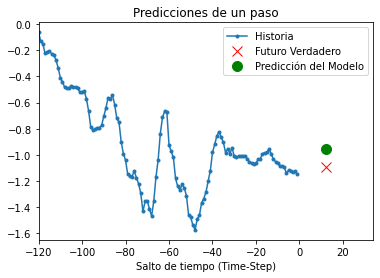

8/8 [==============================] - 0s 20ms/step


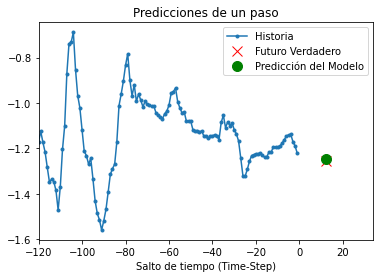

8/8 [==============================] - 0s 18ms/step


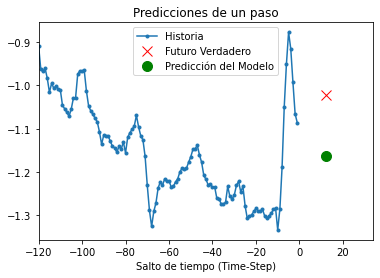

8/8 [==============================] - 0s 22ms/step


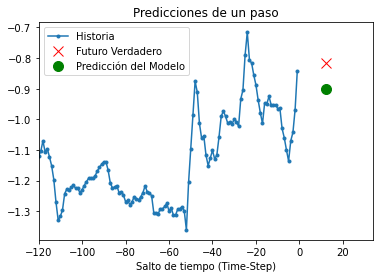

8/8 [==============================] - 0s 19ms/step


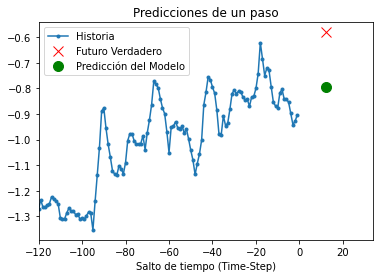

8/8 [==============================] - 0s 18ms/step


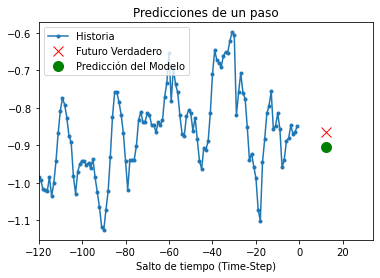

8/8 [==============================] - 0s 19ms/step


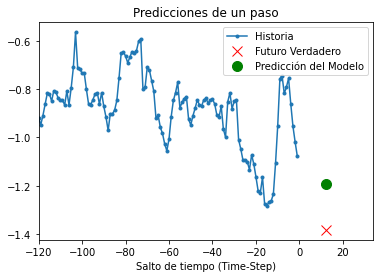

8/8 [==============================] - 0s 18ms/step


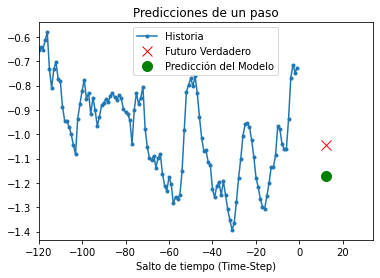

8/8 [==============================] - 0s 18ms/step


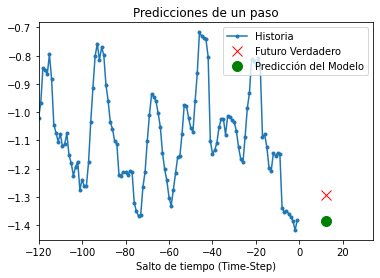

8/8 [==============================] - 0s 19ms/step


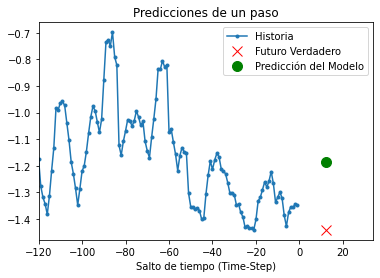

8/8 [==============================] - 0s 17ms/step


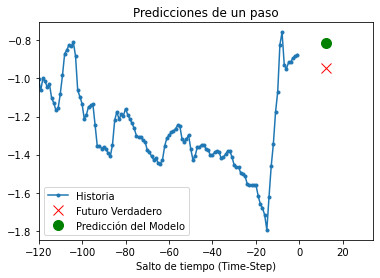

8/8 [==============================] - 0s 17ms/step


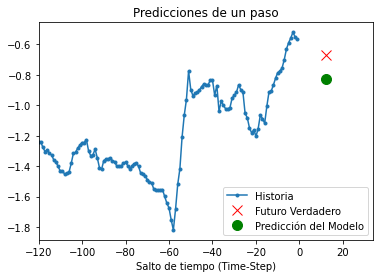

8/8 [==============================] - 0s 16ms/step


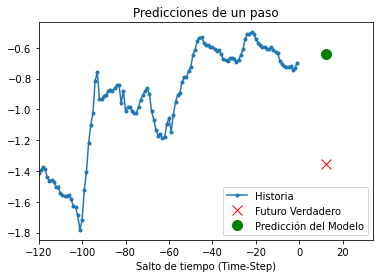

8/8 [==============================] - 0s 17ms/step


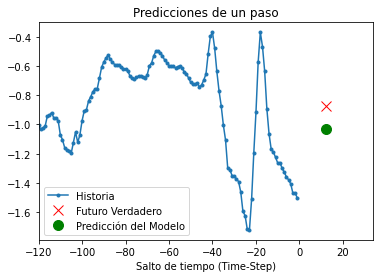

8/8 [==============================] - 0s 17ms/step


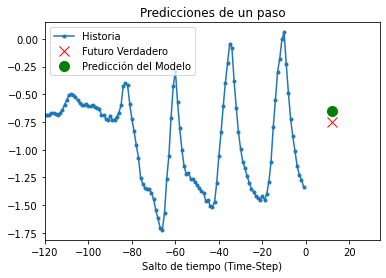

8/8 [==============================] - 0s 17ms/step


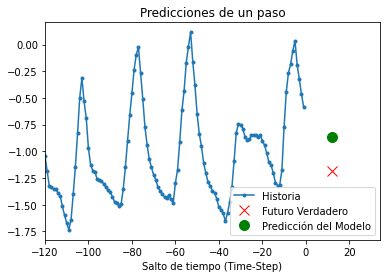

8/8 [==============================] - 0s 15ms/step


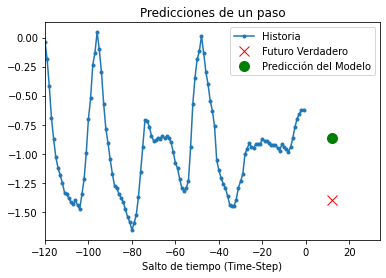

8/8 [==============================] - 0s 17ms/step


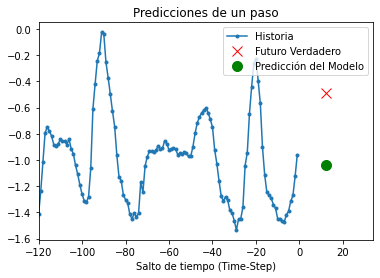

8/8 [==============================] - 0s 21ms/step


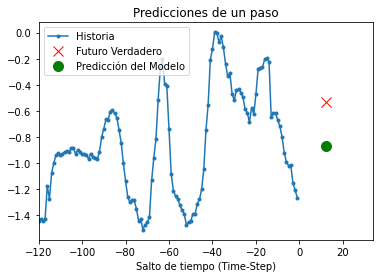

8/8 [==============================] - 0s 21ms/step


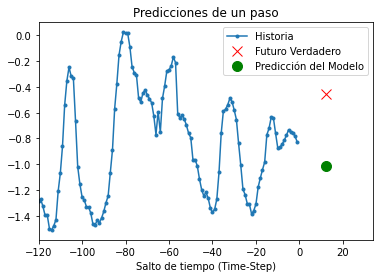

8/8 [==============================] - 0s 17ms/step


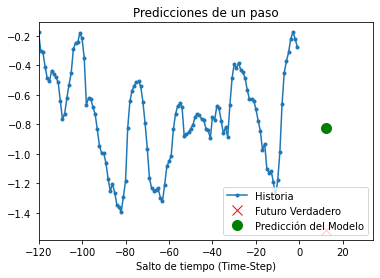

8/8 [==============================] - 0s 31ms/step


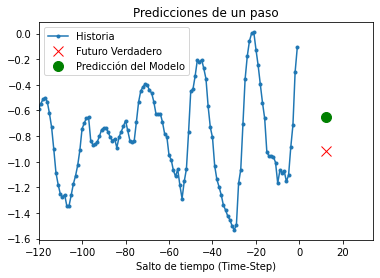

8/8 [==============================] - 0s 16ms/step


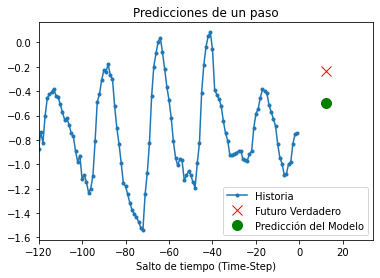

8/8 [==============================] - 0s 22ms/step


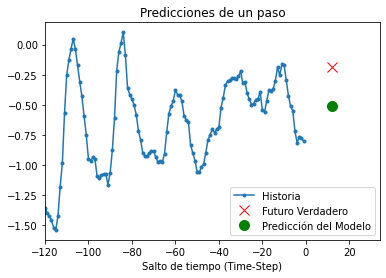

8/8 [==============================] - 0s 27ms/step


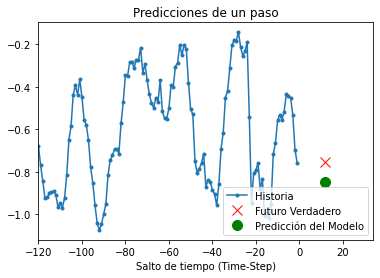

8/8 [==============================] - 0s 22ms/step


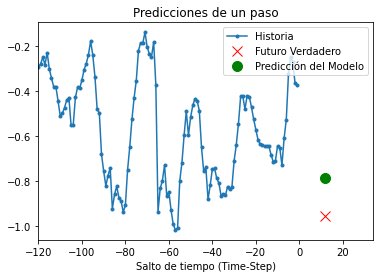

8/8 [==============================] - 0s 18ms/step


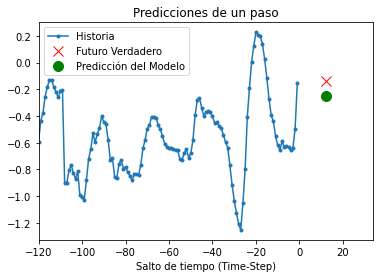

8/8 [==============================] - 0s 22ms/step


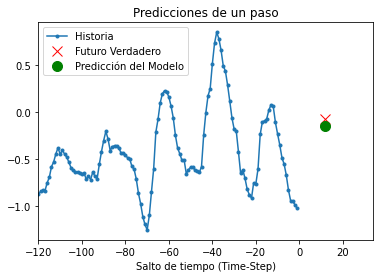

8/8 [==============================] - 0s 23ms/step


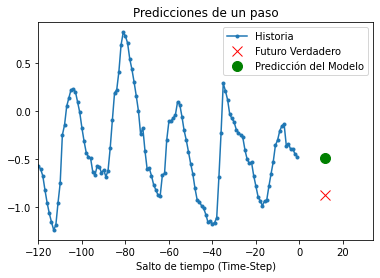

8/8 [==============================] - 0s 23ms/step


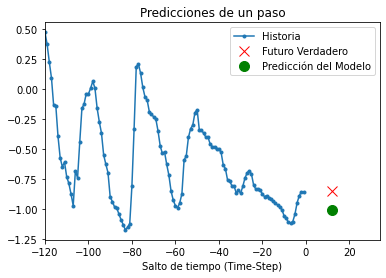

8/8 [==============================] - 0s 25ms/step


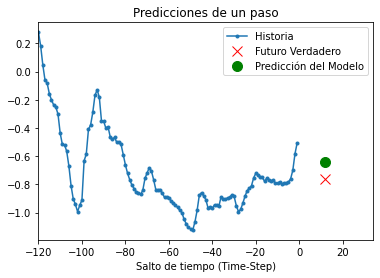

8/8 [==============================] - 0s 27ms/step


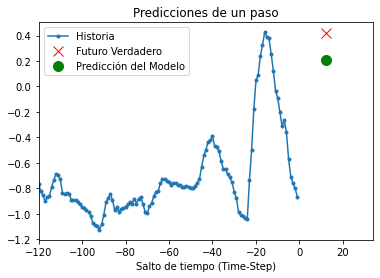

8/8 [==============================] - 0s 23ms/step


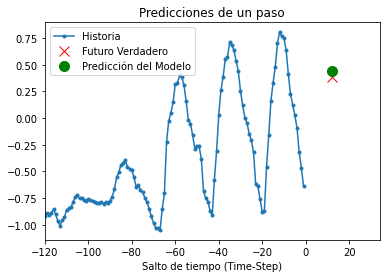

8/8 [==============================] - 0s 26ms/step


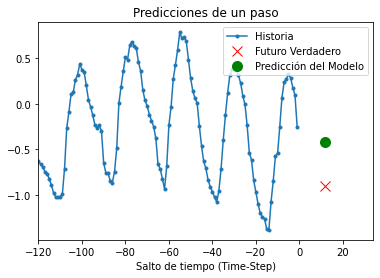

8/8 [==============================] - 0s 24ms/step


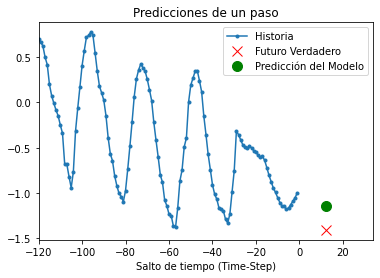

8/8 [==============================] - 0s 23ms/step


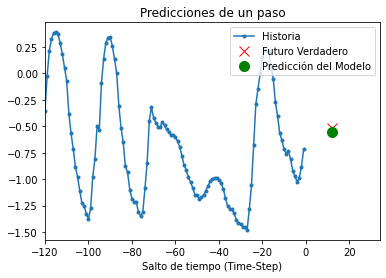

8/8 [==============================] - 0s 27ms/step


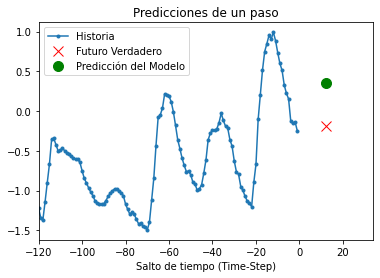

8/8 [==============================] - 0s 16ms/step


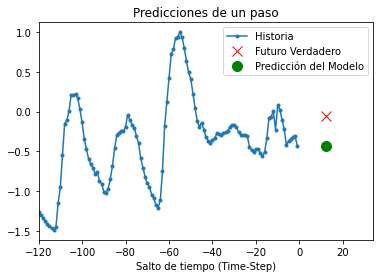

8/8 [==============================] - 0s 16ms/step


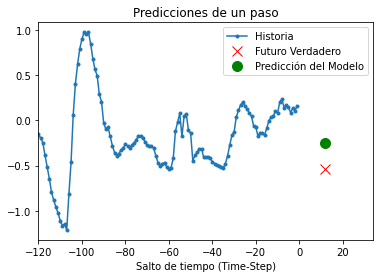

8/8 [==============================] - 0s 17ms/step


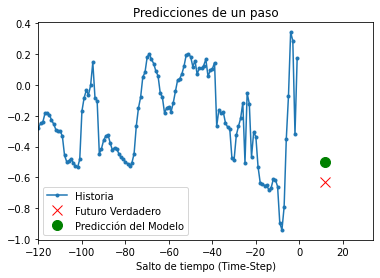

8/8 [==============================] - 0s 18ms/step


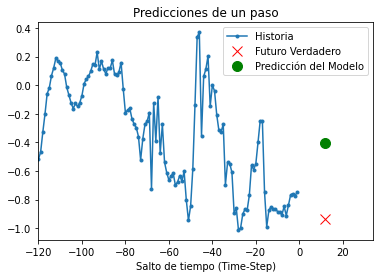

8/8 [==============================] - 0s 18ms/step


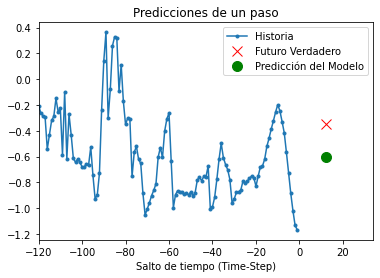

8/8 [==============================] - 0s 15ms/step


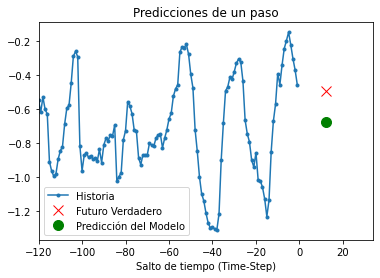

8/8 [==============================] - 0s 18ms/step


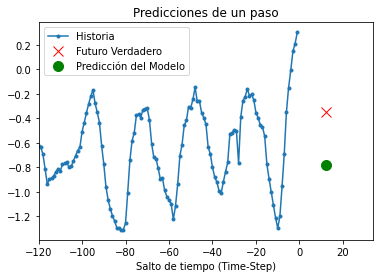

8/8 [==============================] - 0s 19ms/step


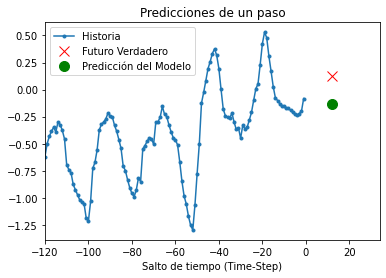

8/8 [==============================] - 0s 17ms/step


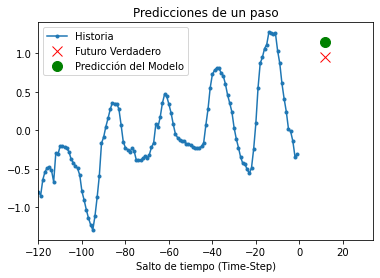

8/8 [==============================] - 0s 18ms/step


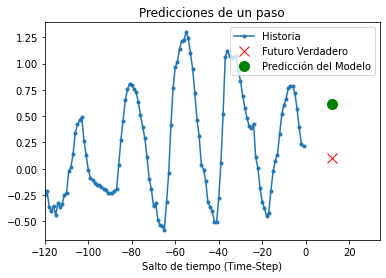

8/8 [==============================] - 0s 16ms/step


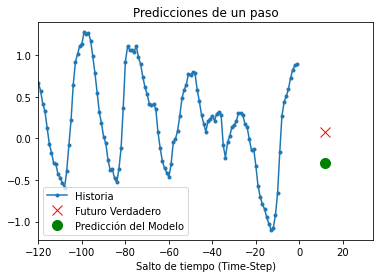

8/8 [==============================] - 0s 19ms/step


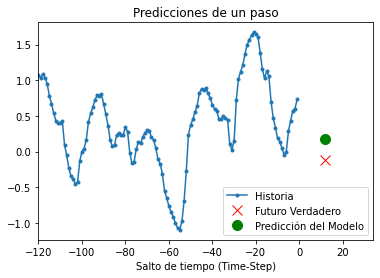

8/8 [==============================] - 0s 19ms/step


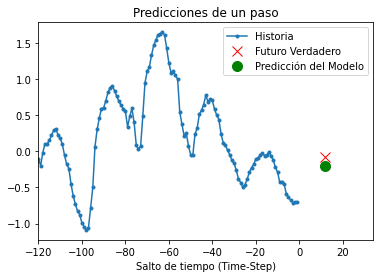

8/8 [==============================] - 0s 20ms/step


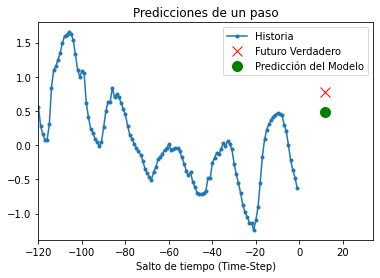

8/8 [==============================] - 0s 16ms/step


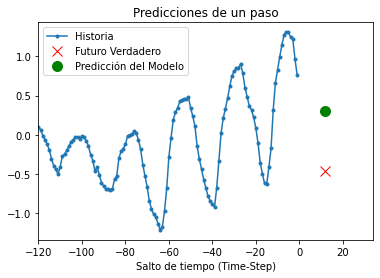

8/8 [==============================] - 0s 18ms/step


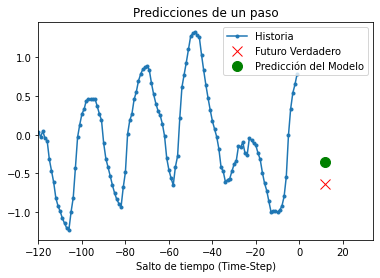

8/8 [==============================] - 0s 21ms/step


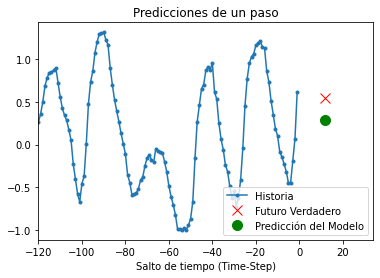

8/8 [==============================] - 0s 27ms/step


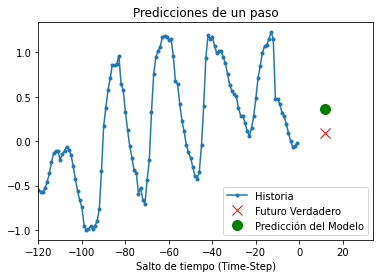

8/8 [==============================] - 0s 22ms/step


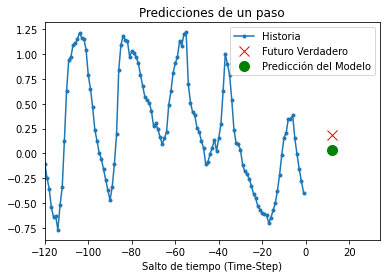

8/8 [==============================] - 0s 19ms/step


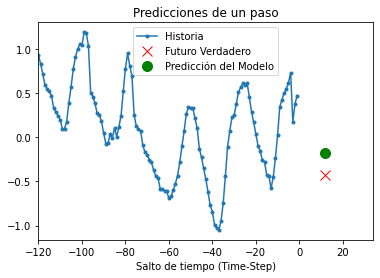

8/8 [==============================] - 0s 21ms/step


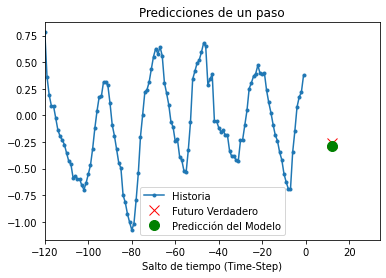

8/8 [==============================] - 0s 18ms/step


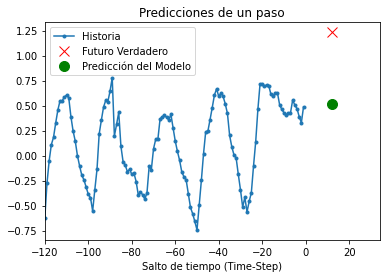

8/8 [==============================] - 0s 21ms/step


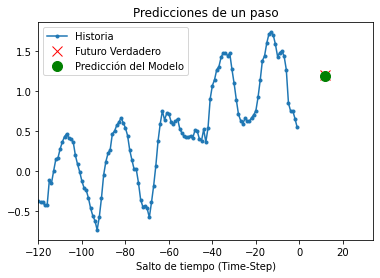

8/8 [==============================] - 0s 27ms/step


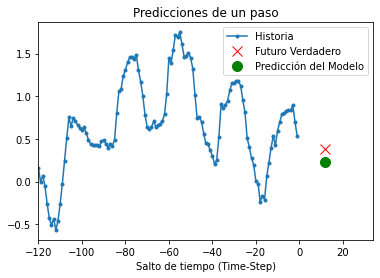

8/8 [==============================] - 0s 21ms/step


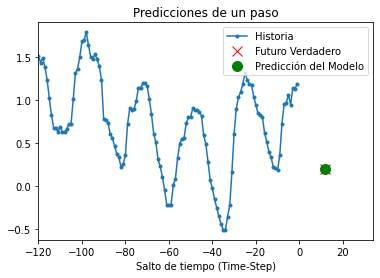

8/8 [==============================] - 0s 21ms/step


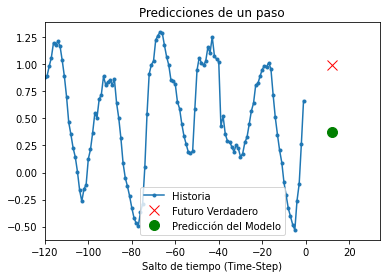

8/8 [==============================] - 0s 19ms/step


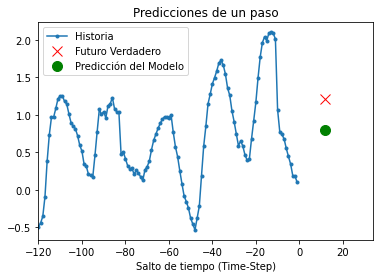

8/8 [==============================] - 0s 24ms/step


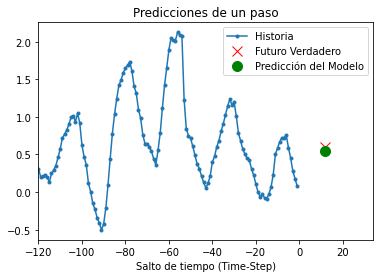

8/8 [==============================] - 0s 23ms/step


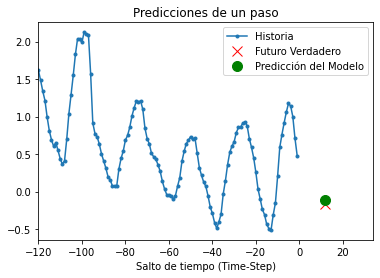

8/8 [==============================] - 0s 18ms/step


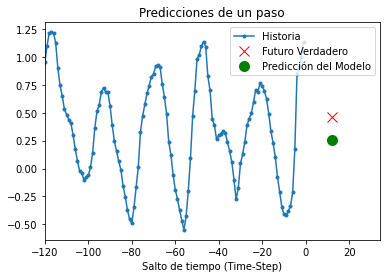

8/8 [==============================] - 0s 24ms/step


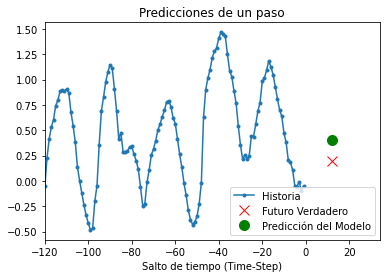

8/8 [==============================] - 0s 21ms/step


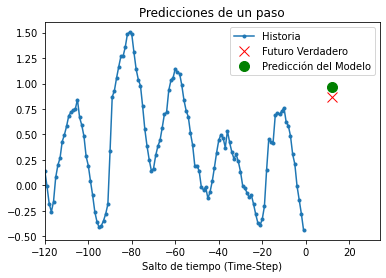

8/8 [==============================] - 0s 17ms/step


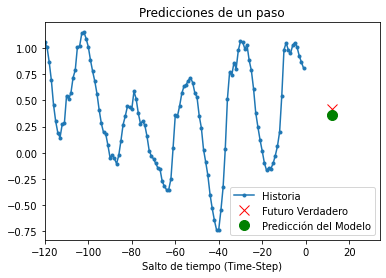

8/8 [==============================] - 0s 17ms/step


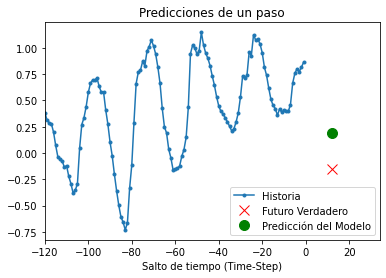

8/8 [==============================] - 0s 18ms/step


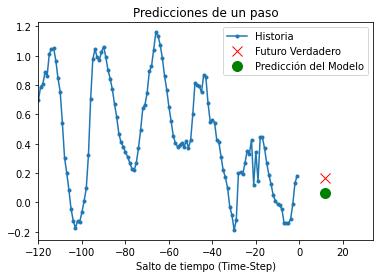

8/8 [==============================] - 0s 22ms/step


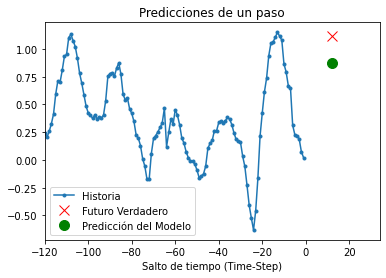

8/8 [==============================] - 0s 17ms/step


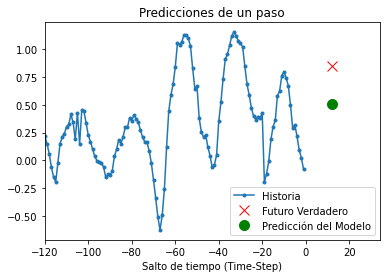

8/8 [==============================] - 0s 23ms/step


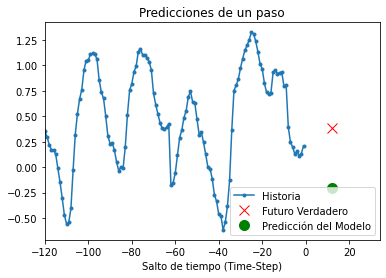

8/8 [==============================] - 0s 19ms/step


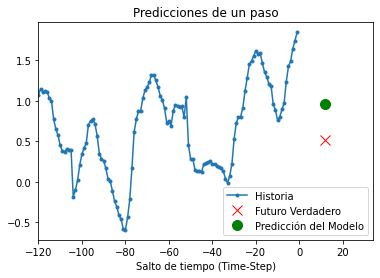

8/8 [==============================] - 0s 17ms/step


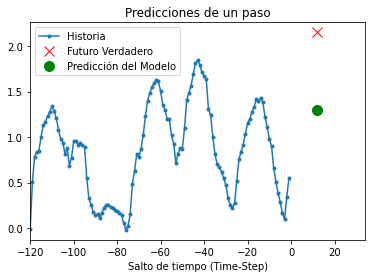

8/8 [==============================] - 0s 18ms/step


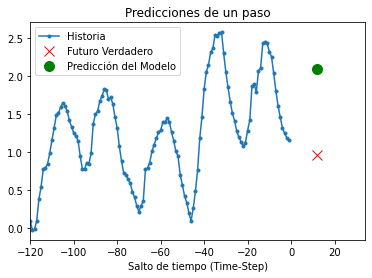

8/8 [==============================] - 0s 19ms/step


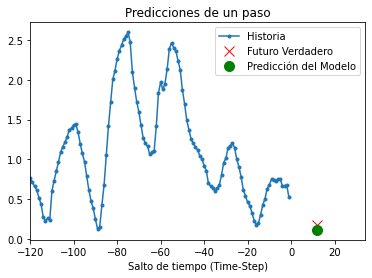

8/8 [==============================] - 0s 20ms/step


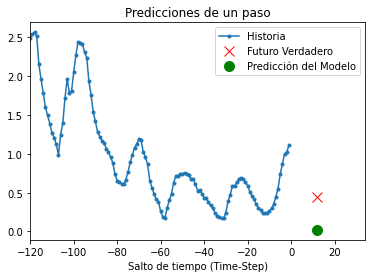

8/8 [==============================] - 0s 19ms/step


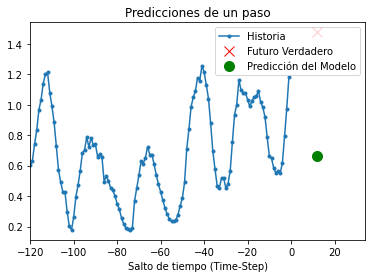

8/8 [==============================] - 0s 17ms/step


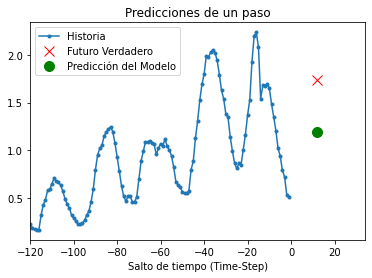

8/8 [==============================] - 0s 19ms/step


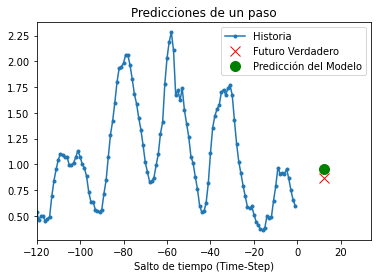

8/8 [==============================] - 0s 22ms/step


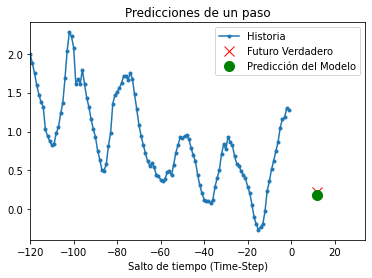

8/8 [==============================] - 0s 22ms/step


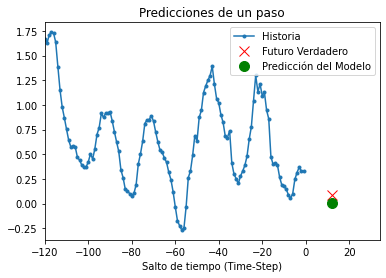

8/8 [==============================] - 0s 21ms/step


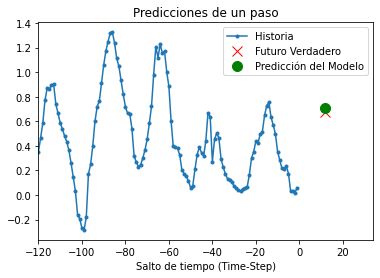

8/8 [==============================] - 0s 26ms/step


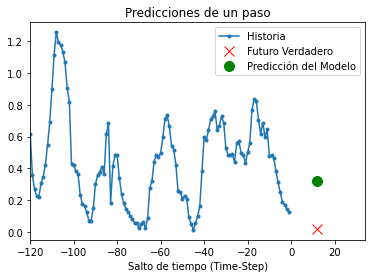

8/8 [==============================] - 0s 21ms/step


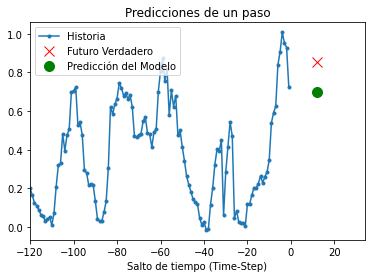

8/8 [==============================] - 0s 19ms/step


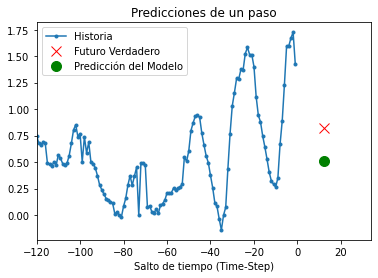

8/8 [==============================] - 0s 19ms/step


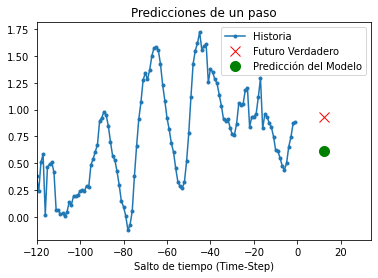

8/8 [==============================] - 0s 17ms/step


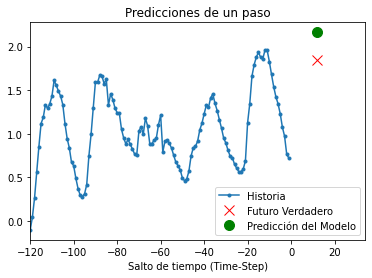

8/8 [==============================] - 0s 23ms/step


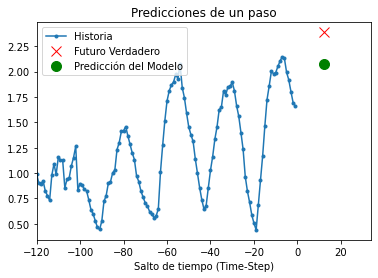

8/8 [==============================] - 0s 22ms/step


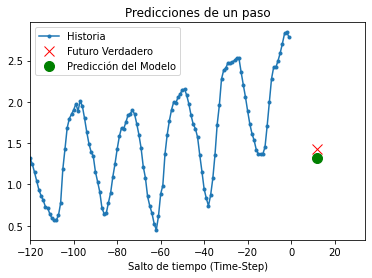

8/8 [==============================] - 0s 22ms/step


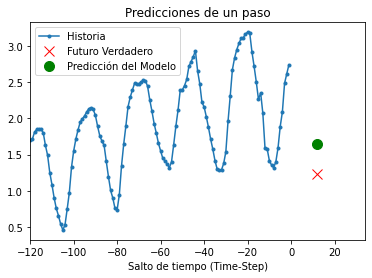

8/8 [==============================] - 0s 22ms/step


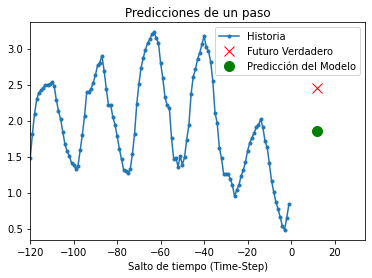

8/8 [==============================] - 0s 23ms/step


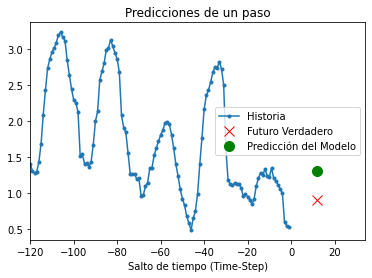

8/8 [==============================] - 0s 23ms/step


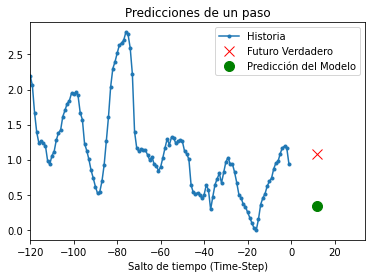

8/8 [==============================] - 0s 22ms/step


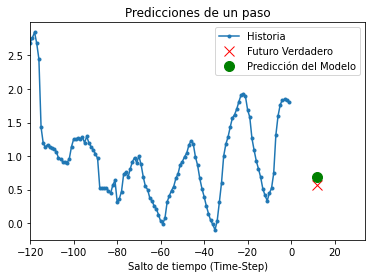

8/8 [==============================] - 0s 22ms/step


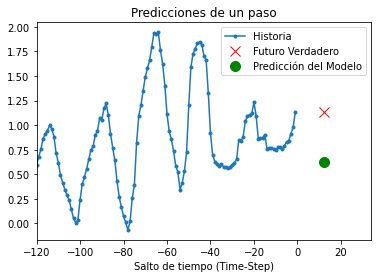

8/8 [==============================] - 0s 22ms/step


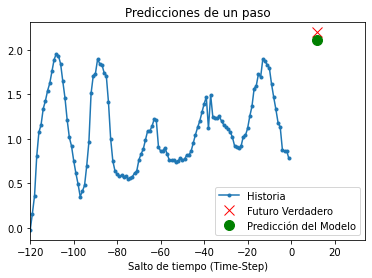

8/8 [==============================] - 0s 24ms/step


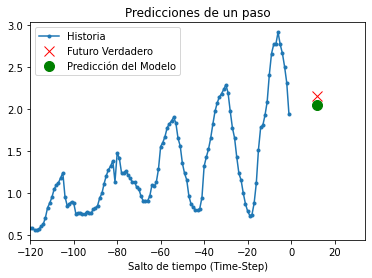

8/8 [==============================] - 0s 19ms/step


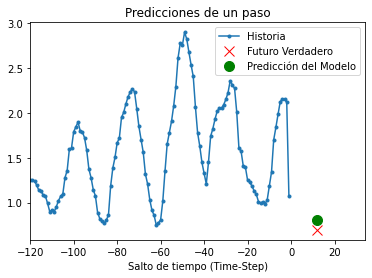

8/8 [==============================] - 0s 21ms/step


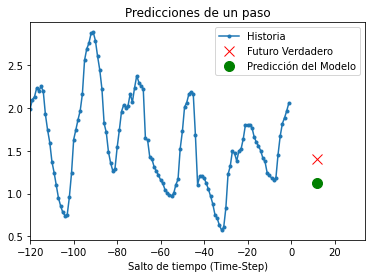

8/8 [==============================] - 0s 22ms/step


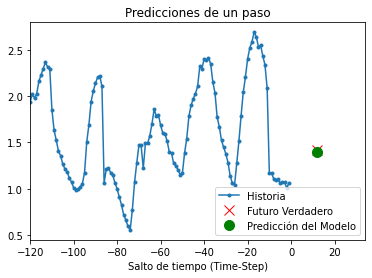

8/8 [==============================] - 0s 21ms/step


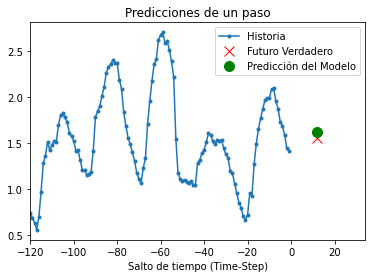

8/8 [==============================] - 0s 23ms/step


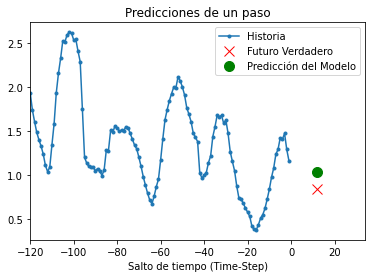

8/8 [==============================] - 0s 27ms/step


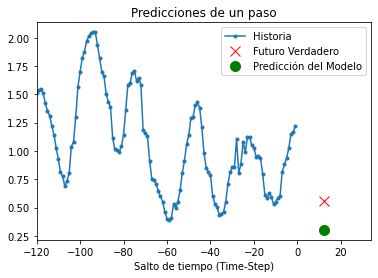

8/8 [==============================] - 0s 24ms/step


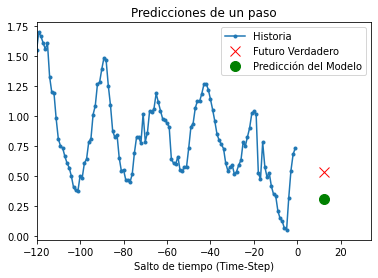

8/8 [==============================] - 0s 24ms/step


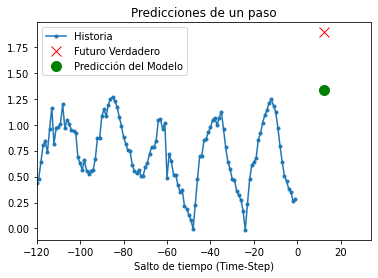

8/8 [==============================] - 0s 21ms/step


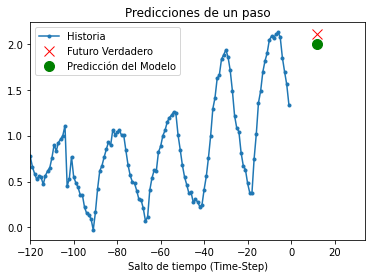

8/8 [==============================] - 0s 21ms/step


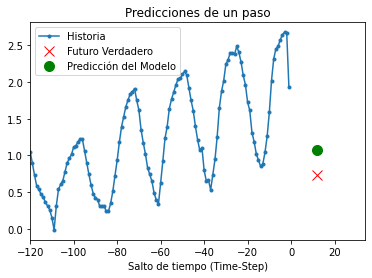

8/8 [==============================] - 0s 23ms/step


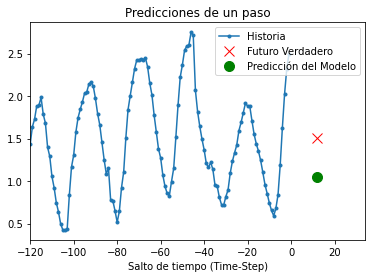

8/8 [==============================] - 0s 22ms/step


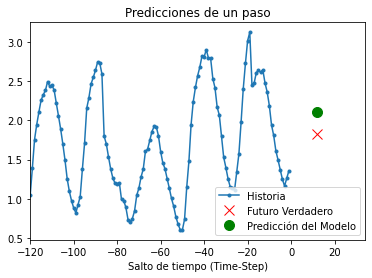

8/8 [==============================] - 0s 23ms/step


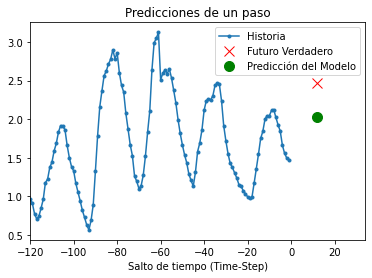

8/8 [==============================] - 0s 21ms/step


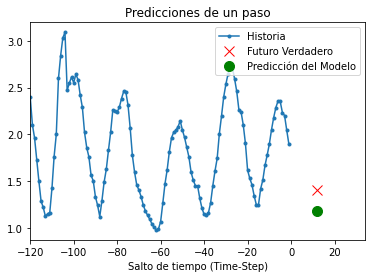

8/8 [==============================] - 0s 24ms/step


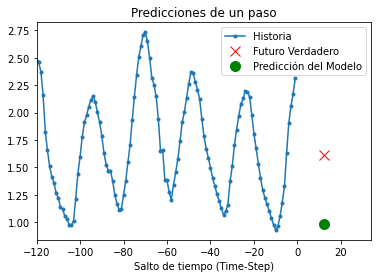

8/8 [==============================] - 0s 23ms/step


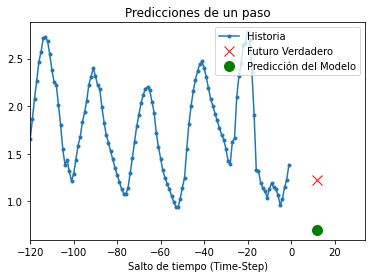

8/8 [==============================] - 0s 23ms/step


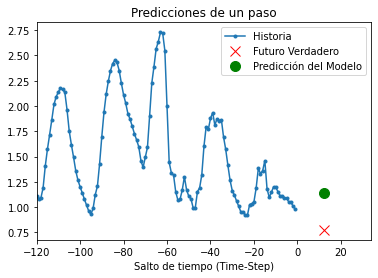

8/8 [==============================] - 0s 22ms/step


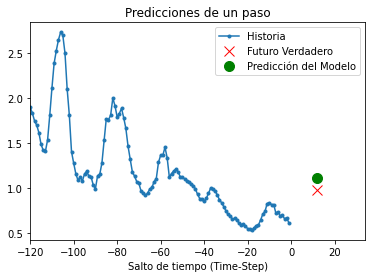

8/8 [==============================] - 0s 23ms/step


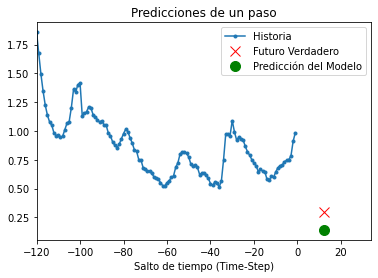

8/8 [==============================] - 0s 22ms/step


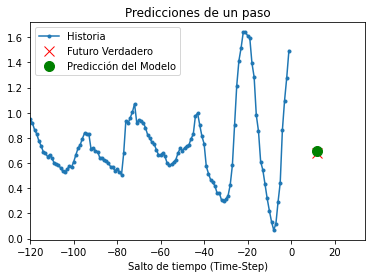

8/8 [==============================] - 0s 25ms/step


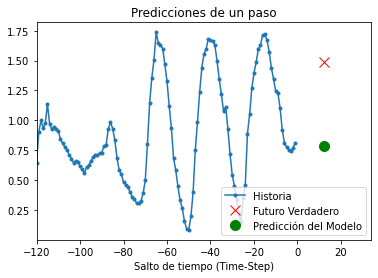

8/8 [==============================] - 0s 21ms/step


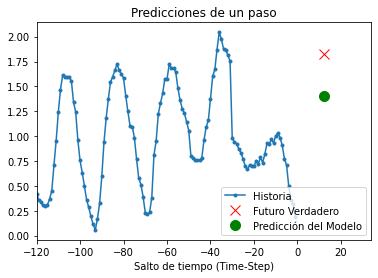

8/8 [==============================] - 0s 25ms/step


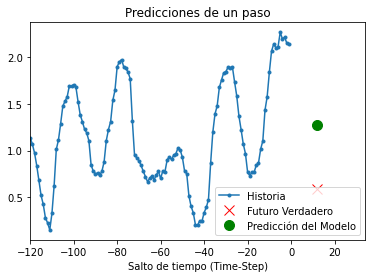

8/8 [==============================] - 0s 19ms/step


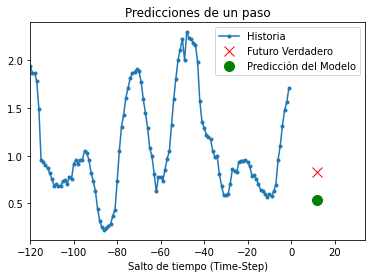

8/8 [==============================] - 0s 25ms/step


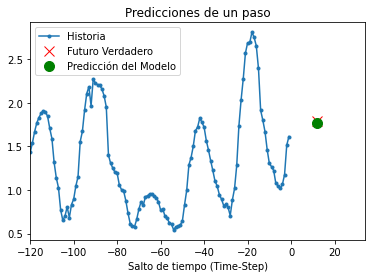

8/8 [==============================] - 0s 23ms/step


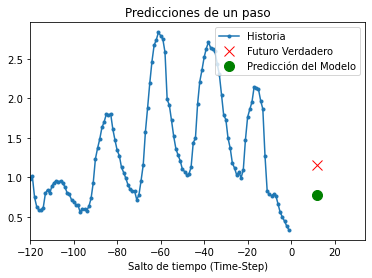

8/8 [==============================] - 0s 22ms/step


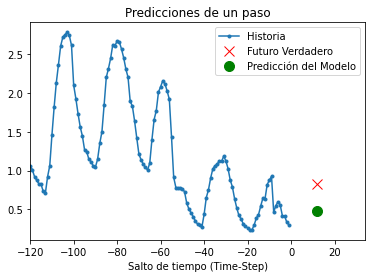

8/8 [==============================] - 0s 23ms/step


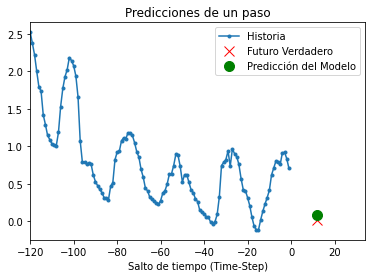

8/8 [==============================] - 0s 22ms/step


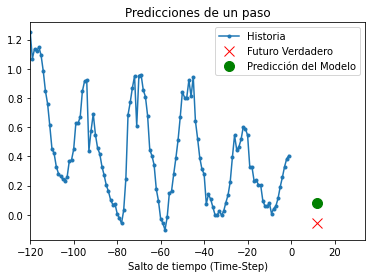

8/8 [==============================] - 0s 26ms/step


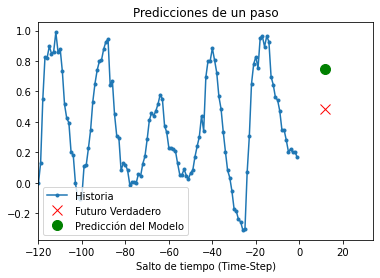

8/8 [==============================] - 0s 23ms/step


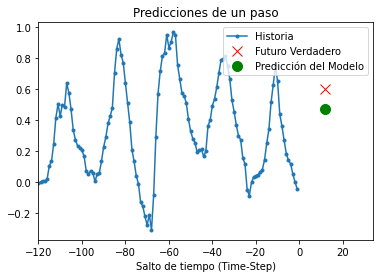

8/8 [==============================] - 0s 22ms/step


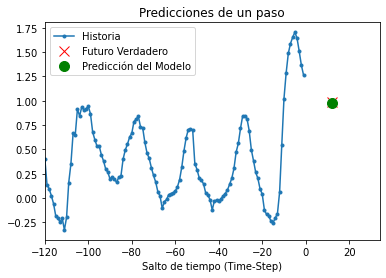

8/8 [==============================] - 0s 23ms/step


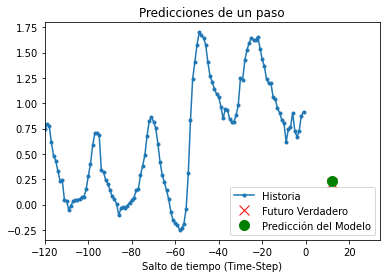

8/8 [==============================] - 0s 24ms/step


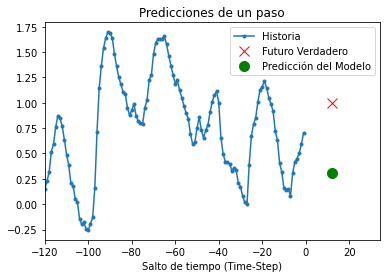

8/8 [==============================] - 0s 22ms/step


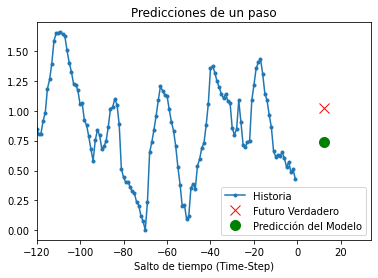

8/8 [==============================] - 0s 31ms/step


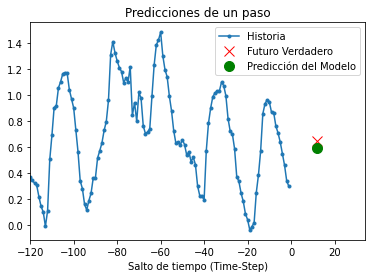

8/8 [==============================] - 0s 23ms/step


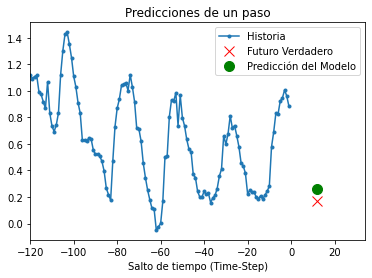

8/8 [==============================] - 0s 23ms/step


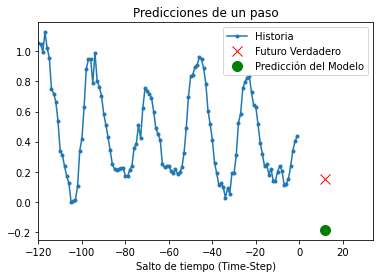

8/8 [==============================] - 0s 23ms/step


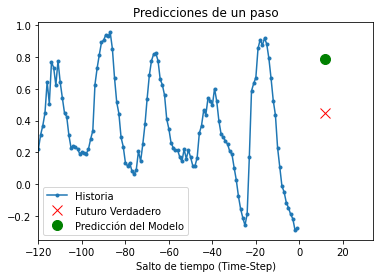

8/8 [==============================] - 0s 21ms/step


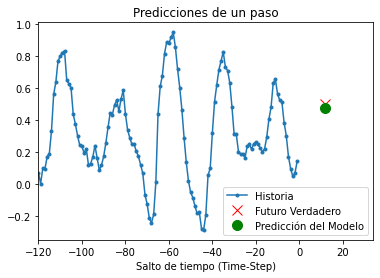

8/8 [==============================] - 0s 22ms/step


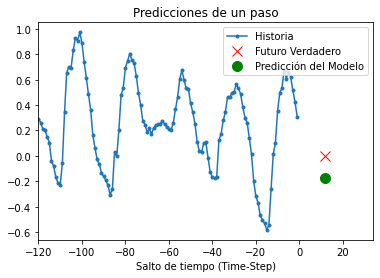

8/8 [==============================] - 0s 24ms/step


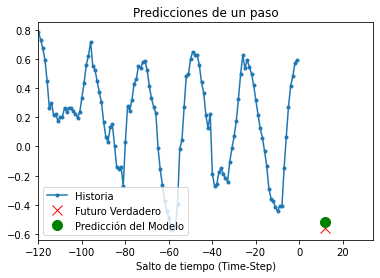

8/8 [==============================] - 0s 22ms/step


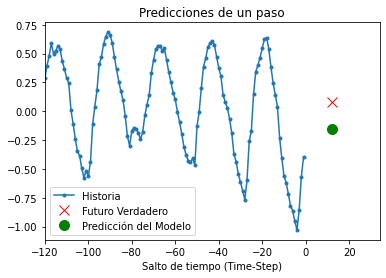

8/8 [==============================] - 0s 24ms/step


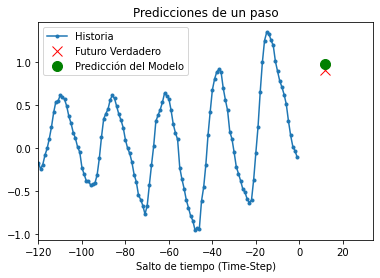

8/8 [==============================] - 0s 23ms/step


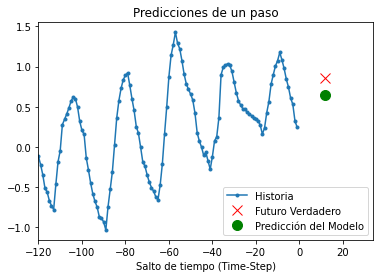

8/8 [==============================] - 0s 23ms/step


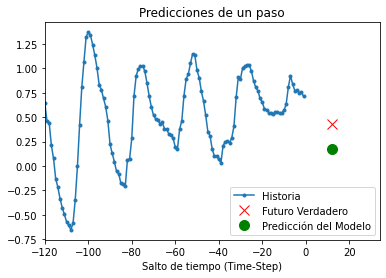

8/8 [==============================] - 0s 23ms/step


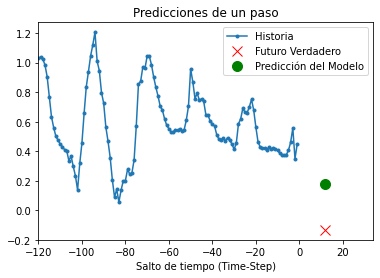

8/8 [==============================] - 0s 24ms/step


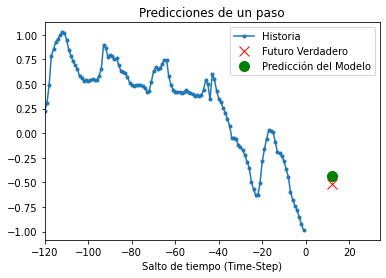

8/8 [==============================] - 0s 23ms/step


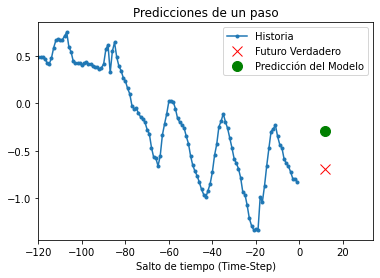

8/8 [==============================] - 0s 25ms/step


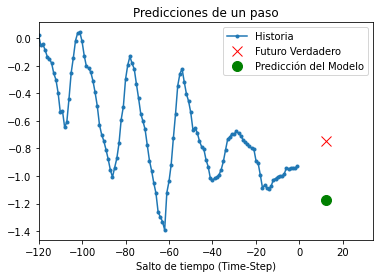

8/8 [==============================] - 0s 23ms/step


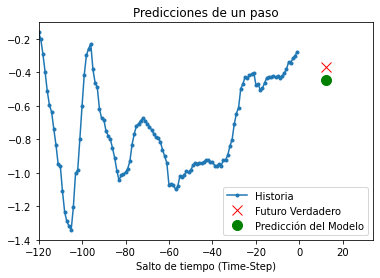

8/8 [==============================] - 0s 24ms/step


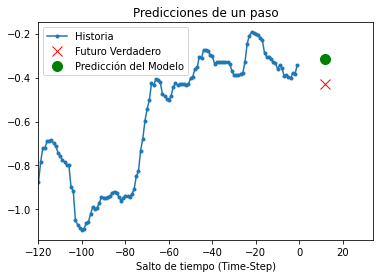

8/8 [==============================] - 0s 22ms/step


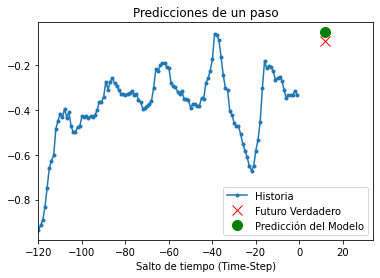

8/8 [==============================] - 0s 25ms/step


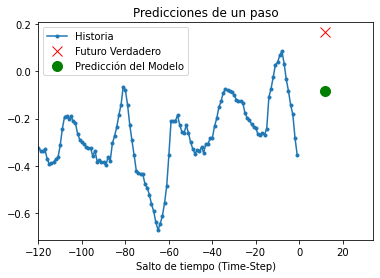

8/8 [==============================] - 0s 23ms/step


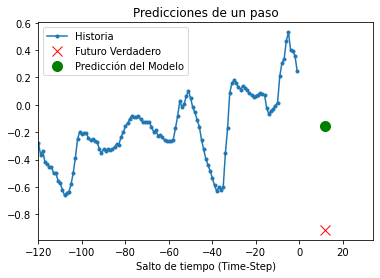

8/8 [==============================] - 0s 22ms/step


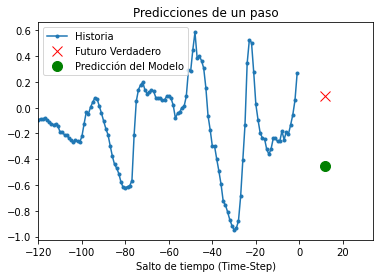

8/8 [==============================] - 0s 17ms/step


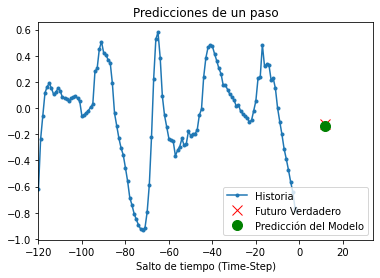

8/8 [==============================] - 0s 20ms/step


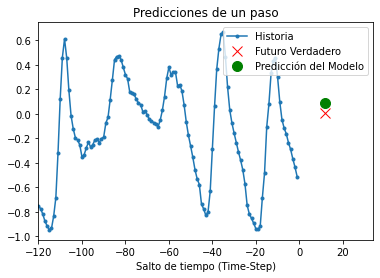

8/8 [==============================] - 0s 20ms/step


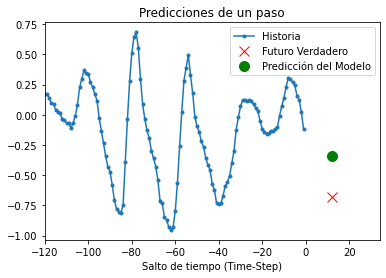

8/8 [==============================] - 0s 23ms/step


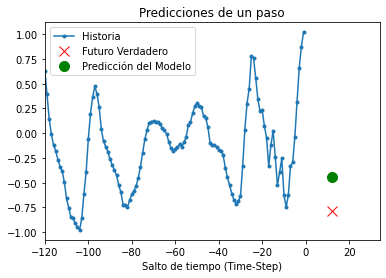

8/8 [==============================] - 0s 24ms/step


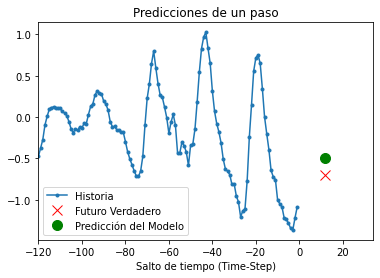

8/8 [==============================] - 0s 25ms/step


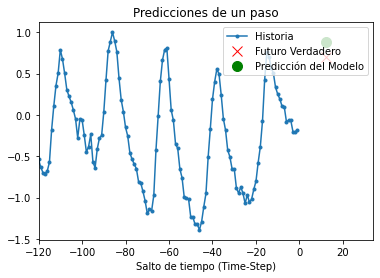

8/8 [==============================] - 0s 27ms/step


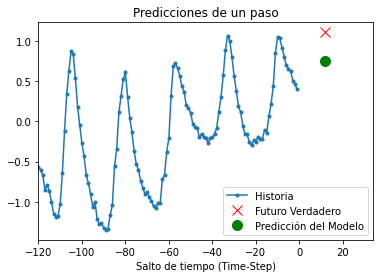

8/8 [==============================] - 0s 24ms/step


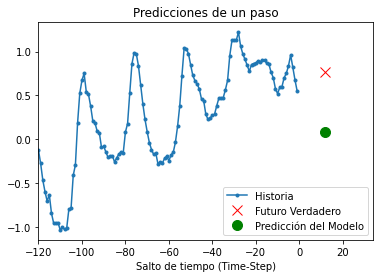

8/8 [==============================] - 0s 22ms/step


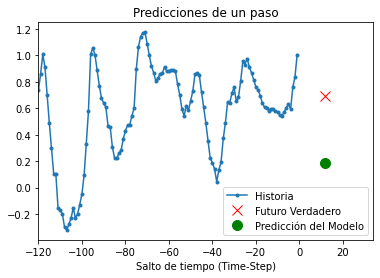

8/8 [==============================] - 0s 20ms/step


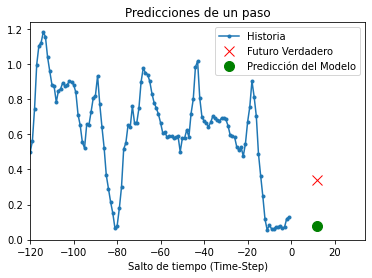

8/8 [==============================] - 0s 25ms/step


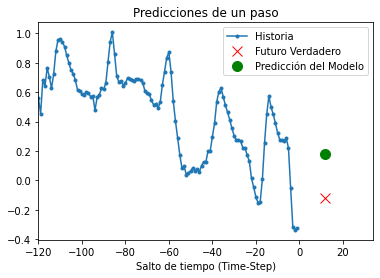

8/8 [==============================] - 0s 20ms/step


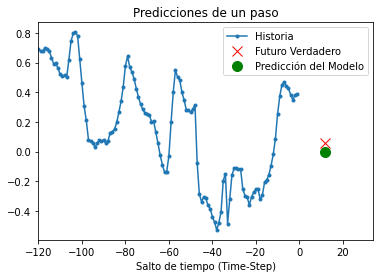

8/8 [==============================] - 0s 25ms/step


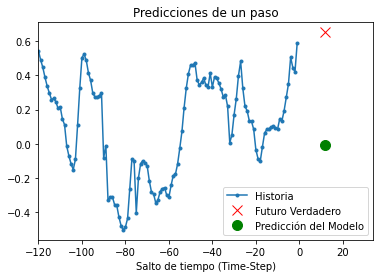

8/8 [==============================] - 0s 20ms/step


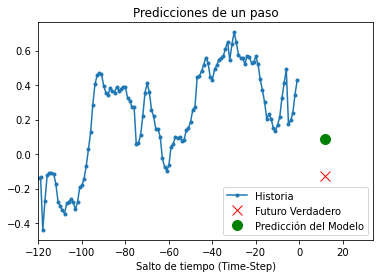

8/8 [==============================] - 0s 26ms/step


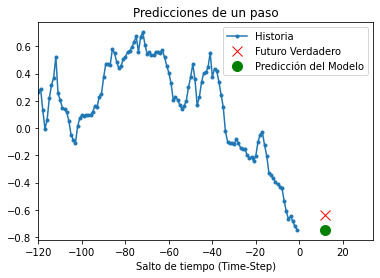

8/8 [==============================] - 0s 31ms/step


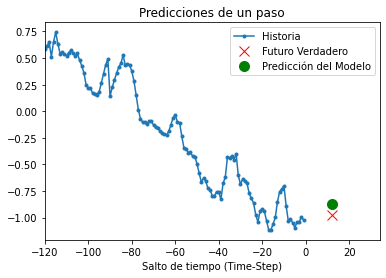

8/8 [==============================] - 0s 22ms/step


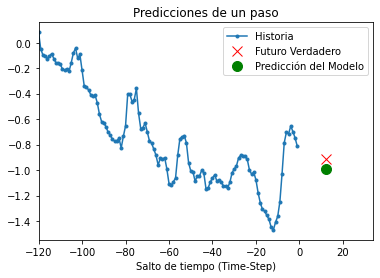

8/8 [==============================] - 0s 23ms/step


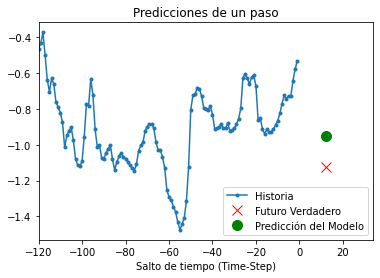

8/8 [==============================] - 0s 24ms/step


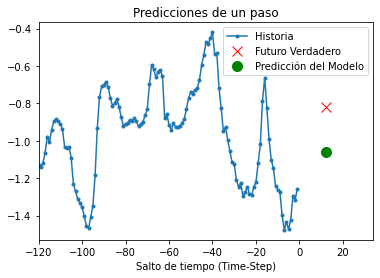

8/8 [==============================] - 0s 21ms/step


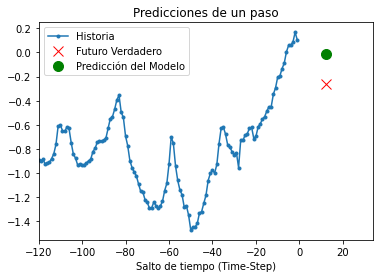

8/8 [==============================] - 0s 23ms/step


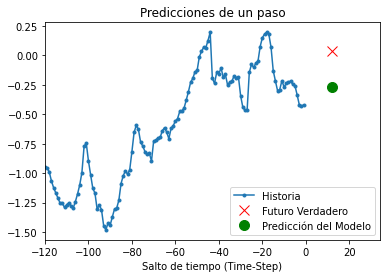

8/8 [==============================] - 0s 23ms/step


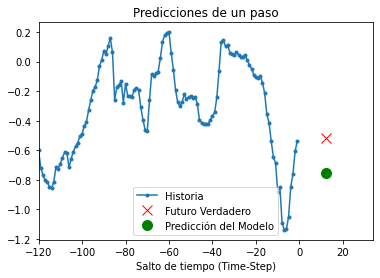

8/8 [==============================] - 0s 22ms/step


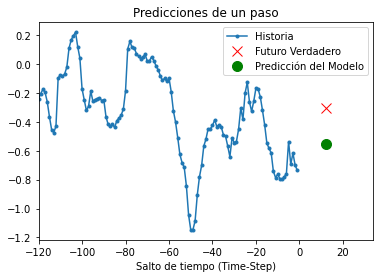

8/8 [==============================] - 0s 21ms/step


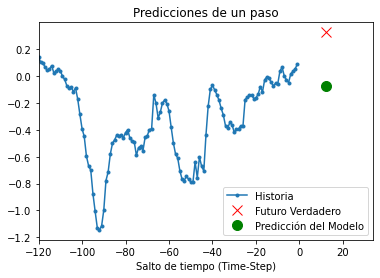

8/8 [==============================] - 0s 22ms/step


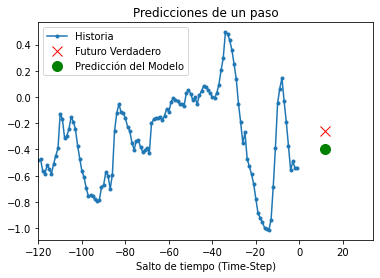

8/8 [==============================] - 0s 19ms/step


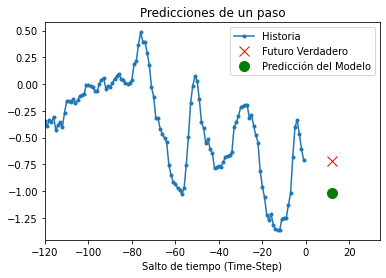

8/8 [==============================] - 0s 19ms/step


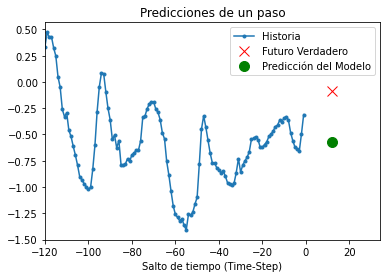

8/8 [==============================] - 0s 21ms/step


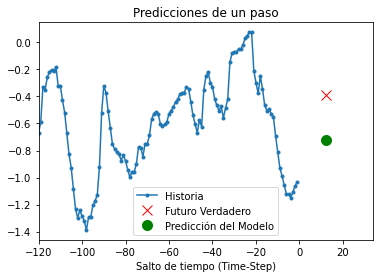

8/8 [==============================] - 0s 21ms/step


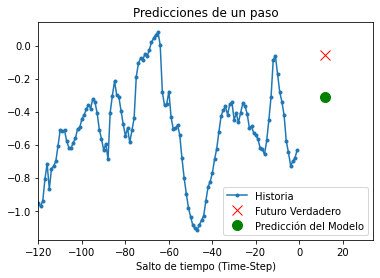

8/8 [==============================] - 0s 21ms/step


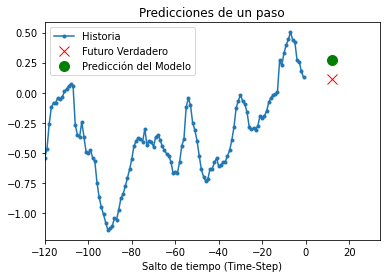

8/8 [==============================] - 0s 23ms/step


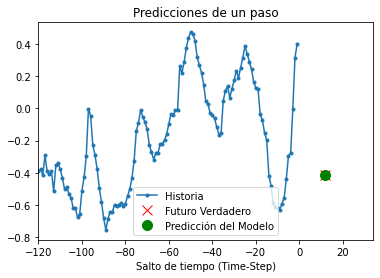

8/8 [==============================] - 0s 21ms/step


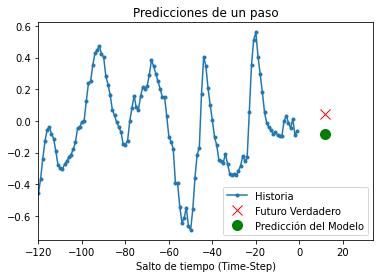

8/8 [==============================] - 0s 19ms/step


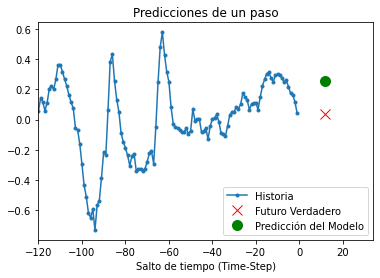

8/8 [==============================] - 0s 22ms/step


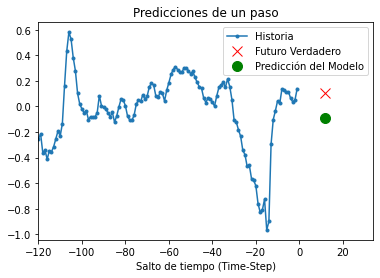

8/8 [==============================] - 0s 21ms/step


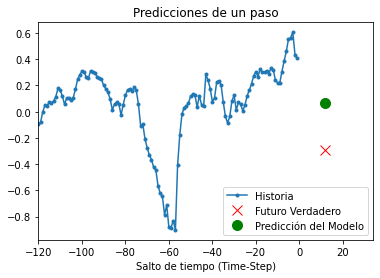

8/8 [==============================] - 0s 19ms/step


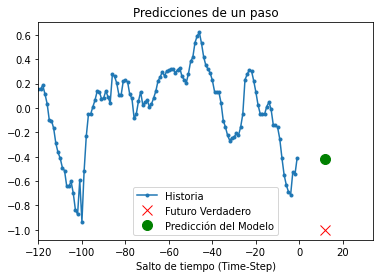

8/8 [==============================] - 0s 24ms/step


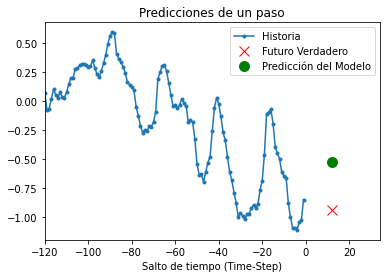

8/8 [==============================] - 0s 20ms/step


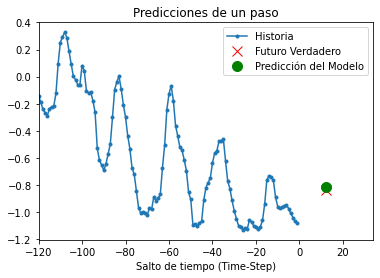

8/8 [==============================] - 0s 23ms/step


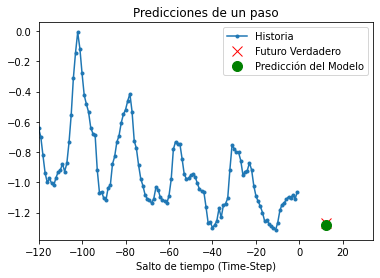

8/8 [==============================] - 0s 20ms/step


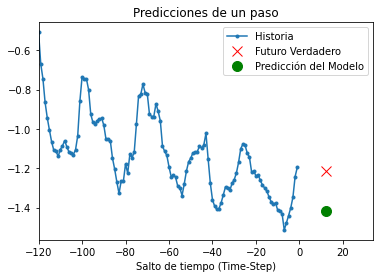

8/8 [==============================] - 0s 22ms/step


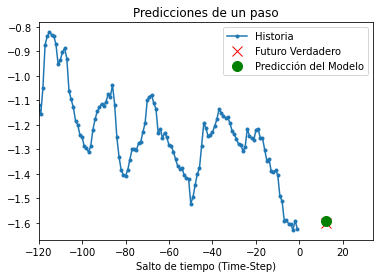

8/8 [==============================] - 0s 22ms/step


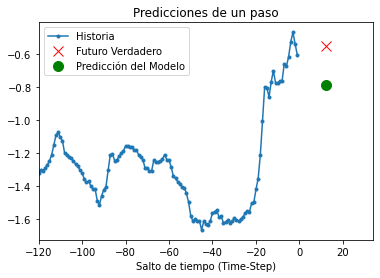

8/8 [==============================] - 0s 19ms/step


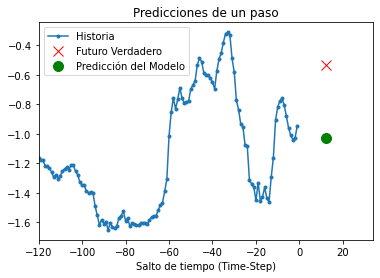

8/8 [==============================] - 0s 19ms/step


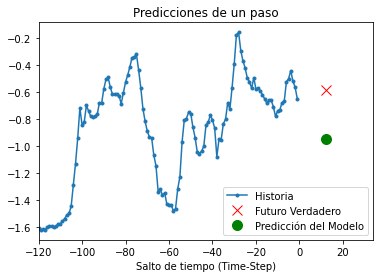

8/8 [==============================] - 0s 17ms/step


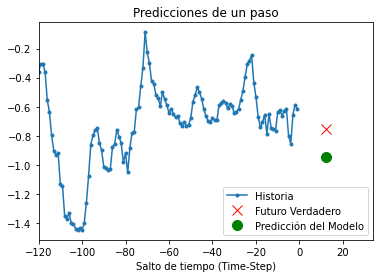

8/8 [==============================] - 0s 19ms/step


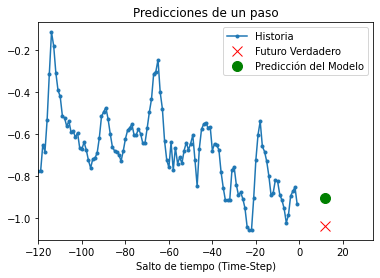

8/8 [==============================] - 0s 16ms/step


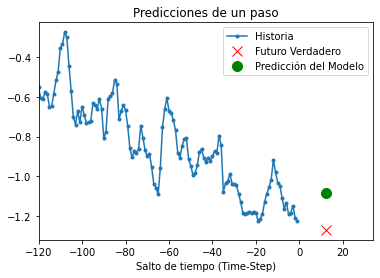

8/8 [==============================] - 0s 21ms/step


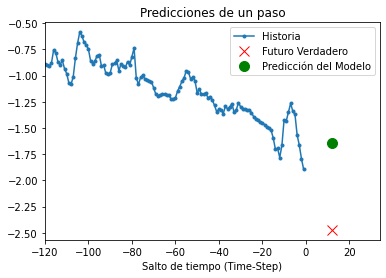

8/8 [==============================] - 0s 19ms/step


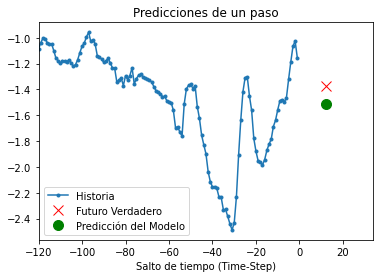

8/8 [==============================] - 0s 21ms/step


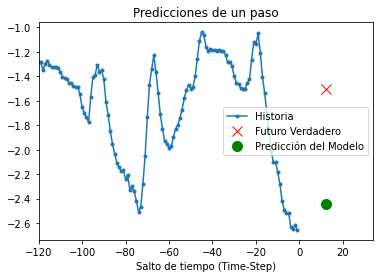

8/8 [==============================] - 0s 19ms/step


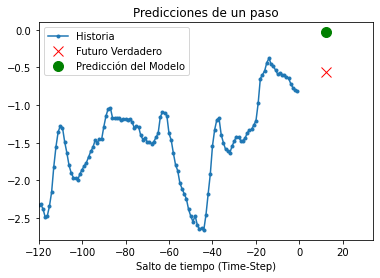

8/8 [==============================] - 0s 24ms/step


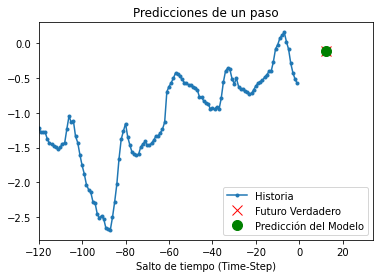

8/8 [==============================] - 0s 24ms/step


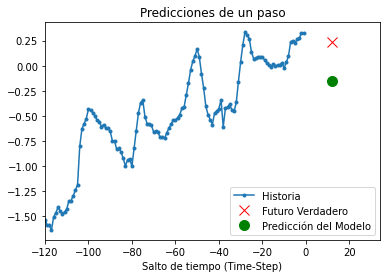

8/8 [==============================] - 0s 22ms/step


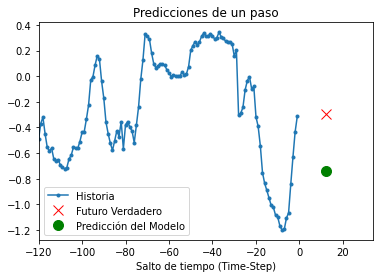

8/8 [==============================] - 0s 24ms/step


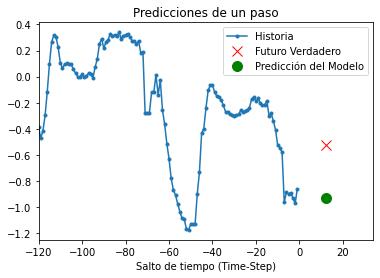

8/8 [==============================] - 0s 20ms/step


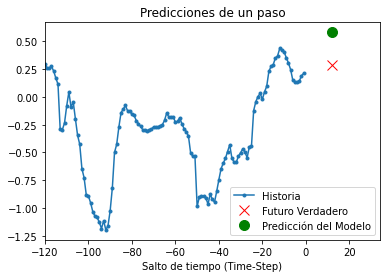

8/8 [==============================] - 0s 20ms/step


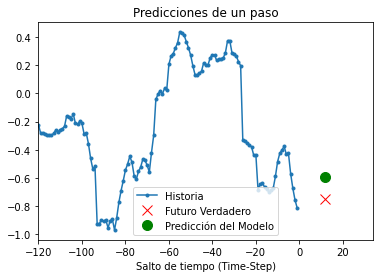

8/8 [==============================] - 0s 22ms/step


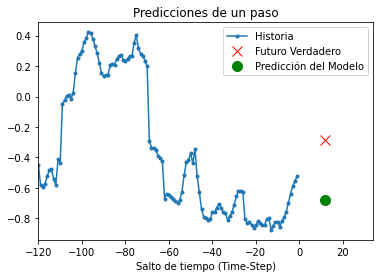

8/8 [==============================] - 0s 20ms/step


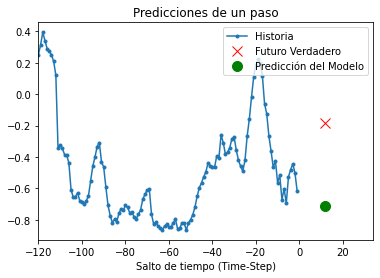

8/8 [==============================] - 0s 20ms/step


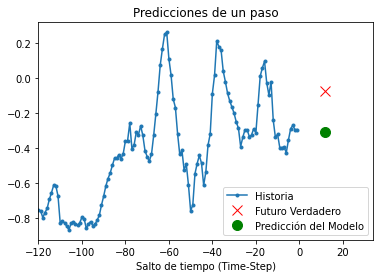

8/8 [==============================] - 0s 23ms/step


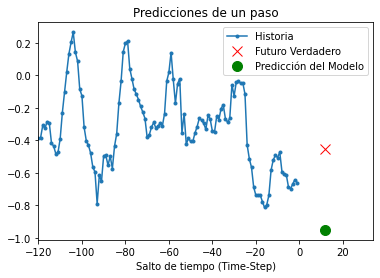

8/8 [==============================] - 0s 20ms/step


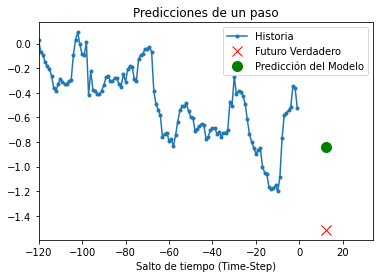

8/8 [==============================] - 0s 20ms/step


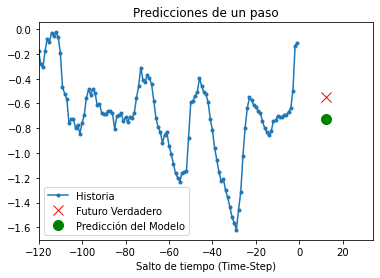

8/8 [==============================] - 0s 18ms/step


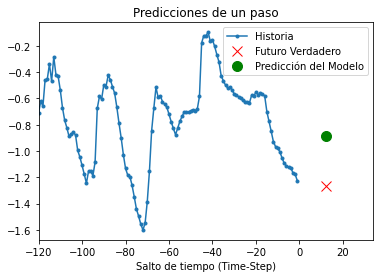

8/8 [==============================] - 0s 18ms/step


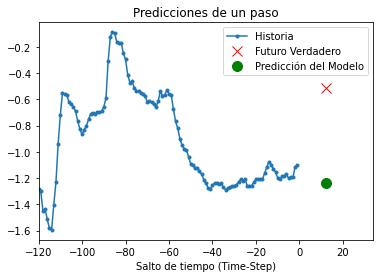

8/8 [==============================] - 0s 22ms/step


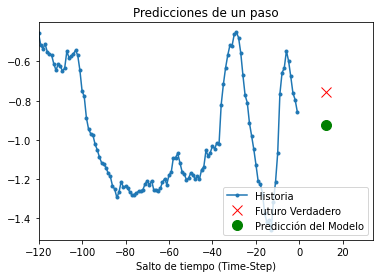

8/8 [==============================] - 0s 19ms/step


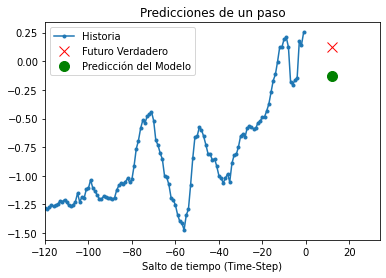

8/8 [==============================] - 0s 18ms/step


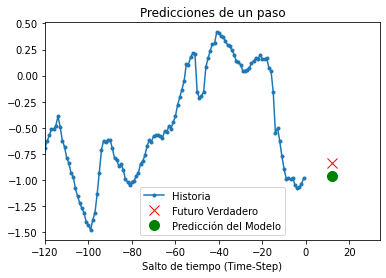

8/8 [==============================] - 0s 19ms/step


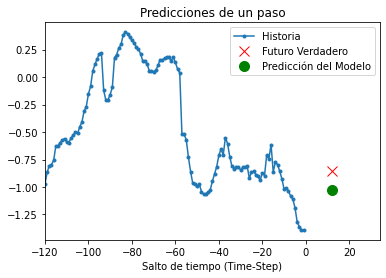

8/8 [==============================] - 0s 20ms/step


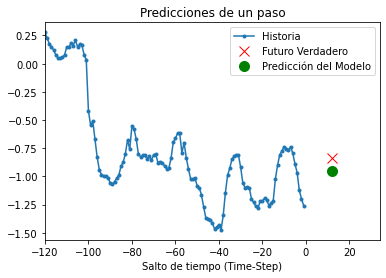

8/8 [==============================] - 0s 19ms/step


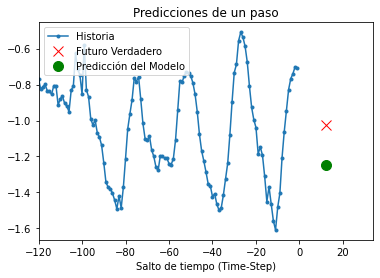

8/8 [==============================] - 0s 19ms/step


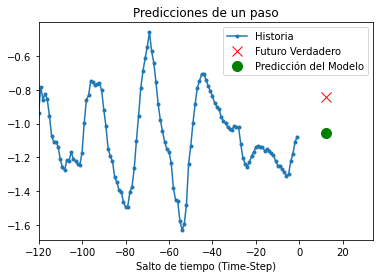

8/8 [==============================] - 0s 19ms/step


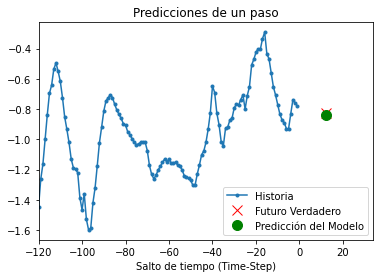

8/8 [==============================] - 0s 19ms/step


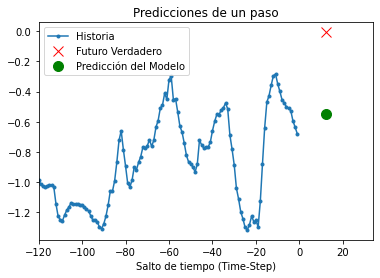

8/8 [==============================] - 0s 18ms/step


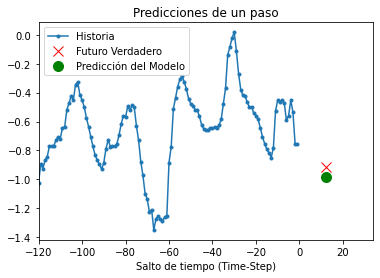

8/8 [==============================] - 0s 23ms/step


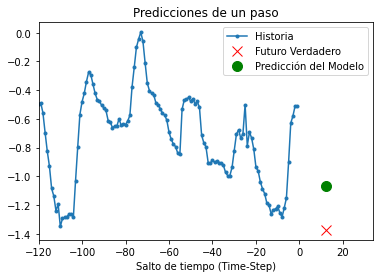

8/8 [==============================] - 0s 19ms/step


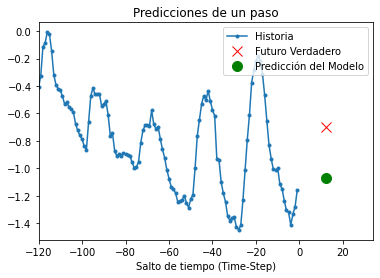

8/8 [==============================] - 0s 17ms/step


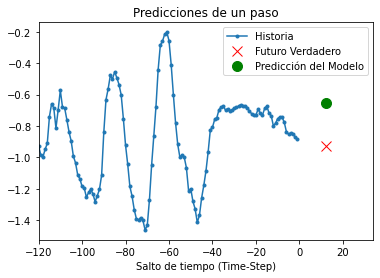

8/8 [==============================] - 0s 18ms/step


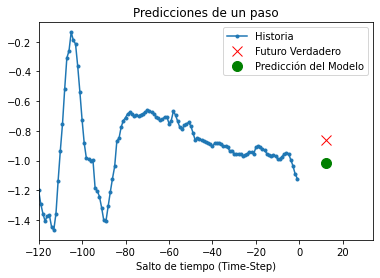

8/8 [==============================] - 0s 22ms/step


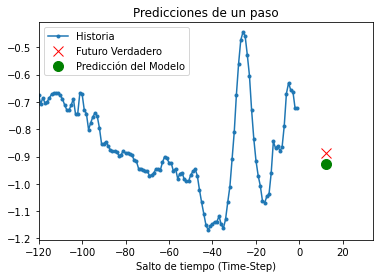

8/8 [==============================] - 0s 19ms/step


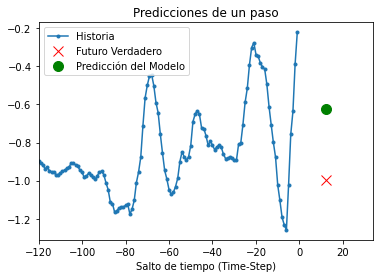

8/8 [==============================] - 0s 22ms/step


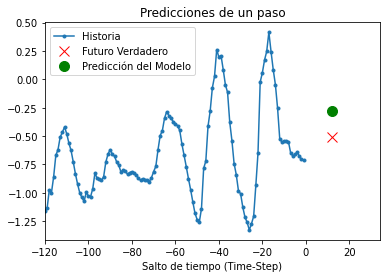

8/8 [==============================] - 0s 18ms/step


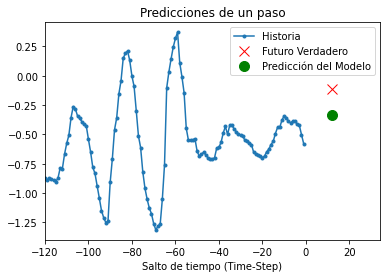

8/8 [==============================] - 0s 19ms/step


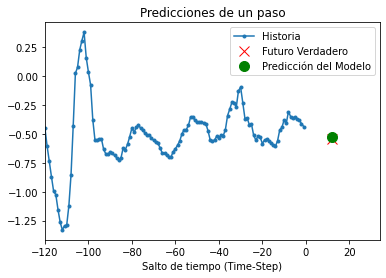

8/8 [==============================] - 0s 23ms/step


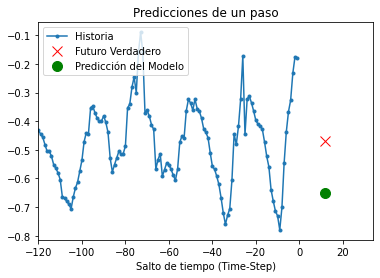

8/8 [==============================] - 0s 22ms/step


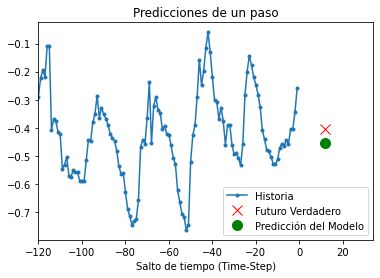

8/8 [==============================] - 0s 18ms/step


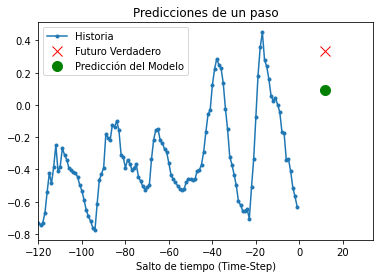

8/8 [==============================] - 0s 20ms/step


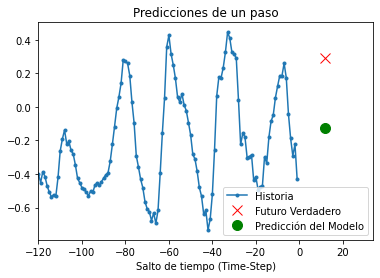

8/8 [==============================] - 0s 27ms/step


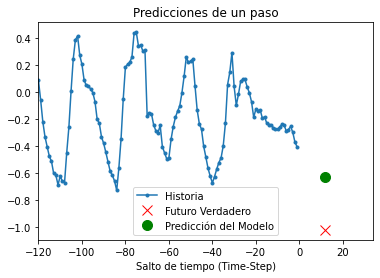

8/8 [==============================] - 0s 18ms/step


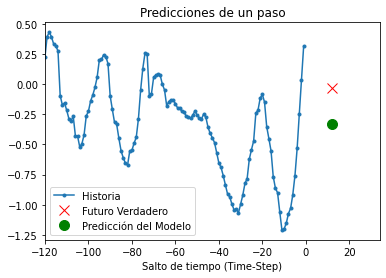

8/8 [==============================] - 0s 21ms/step


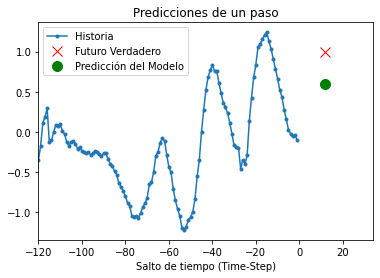

8/8 [==============================] - 0s 22ms/step


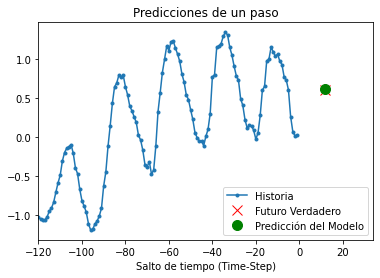

8/8 [==============================] - 0s 18ms/step


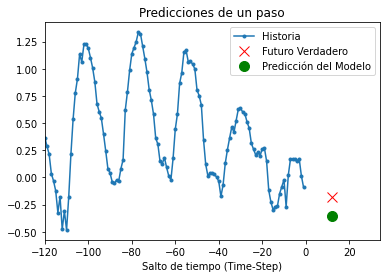

8/8 [==============================] - 0s 20ms/step


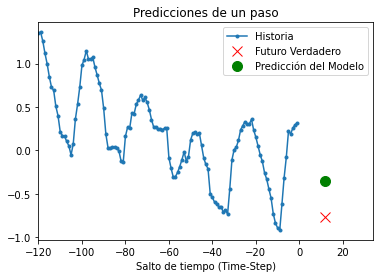

8/8 [==============================] - 0s 22ms/step


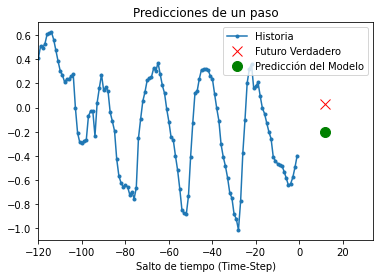

8/8 [==============================] - 0s 18ms/step


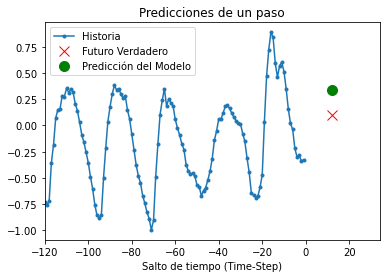

8/8 [==============================] - 0s 22ms/step


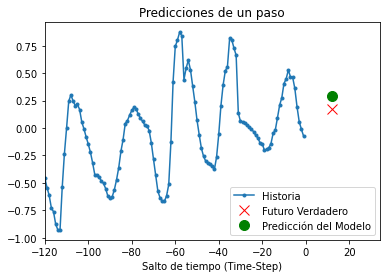

8/8 [==============================] - 0s 18ms/step


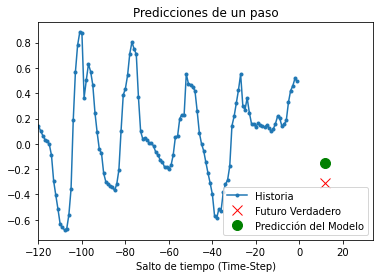

8/8 [==============================] - 0s 15ms/step


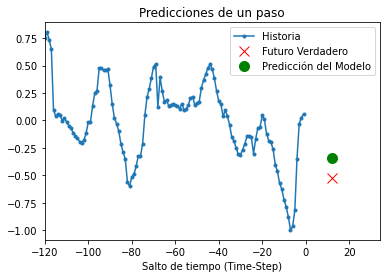

8/8 [==============================] - 0s 21ms/step


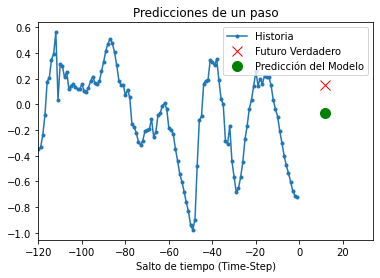

8/8 [==============================] - 0s 19ms/step


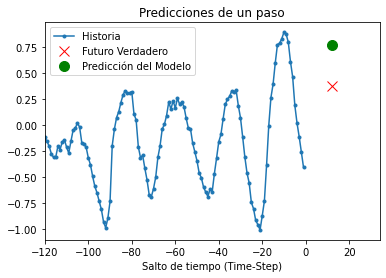

8/8 [==============================] - 0s 19ms/step


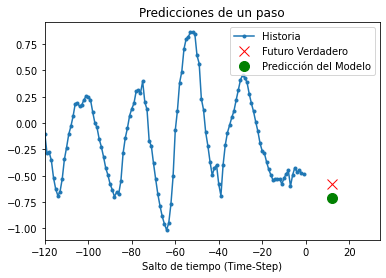

8/8 [==============================] - 0s 21ms/step


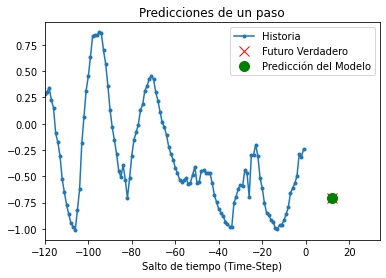

8/8 [==============================] - 0s 18ms/step


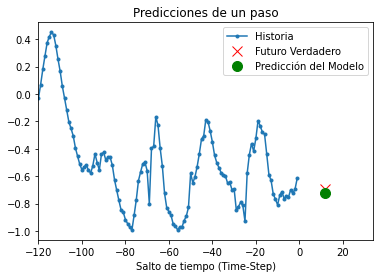

8/8 [==============================] - 0s 18ms/step


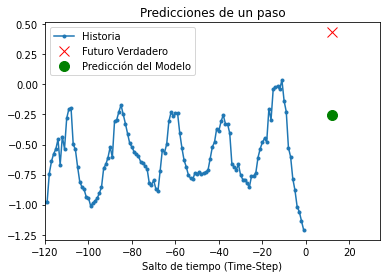

8/8 [==============================] - 0s 18ms/step


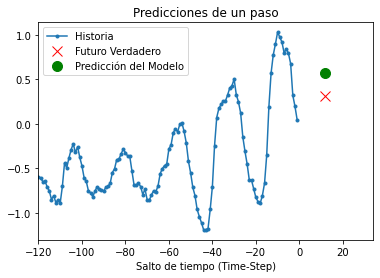

8/8 [==============================] - 0s 18ms/step


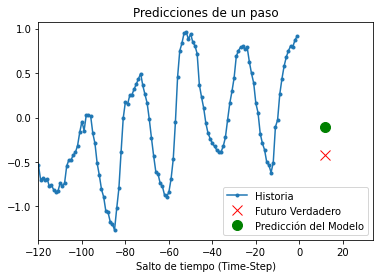

8/8 [==============================] - 0s 18ms/step


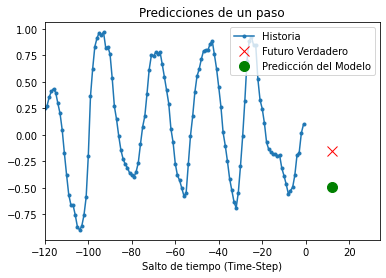

8/8 [==============================] - 0s 18ms/step


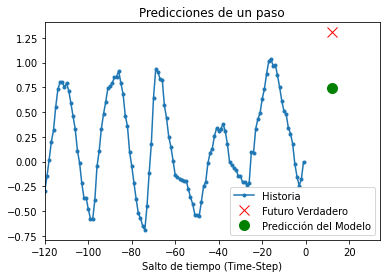

8/8 [==============================] - 0s 21ms/step


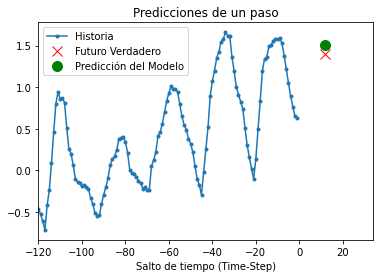

8/8 [==============================] - 0s 18ms/step


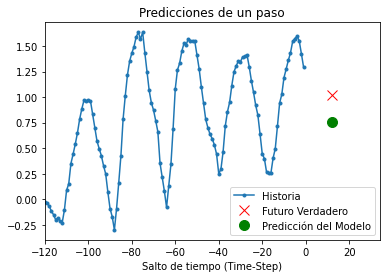

8/8 [==============================] - 0s 18ms/step


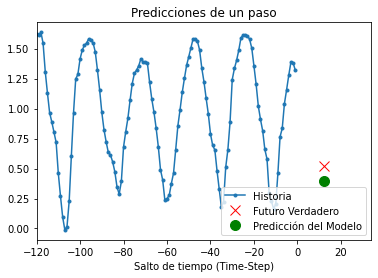

8/8 [==============================] - 0s 21ms/step


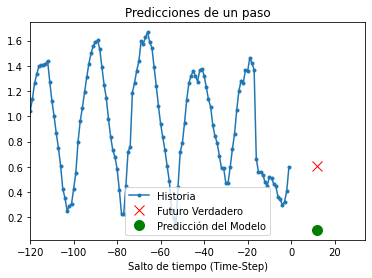

8/8 [==============================] - 0s 21ms/step


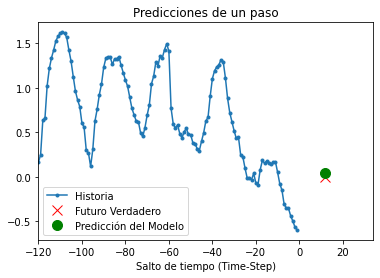

8/8 [==============================] - 0s 19ms/step


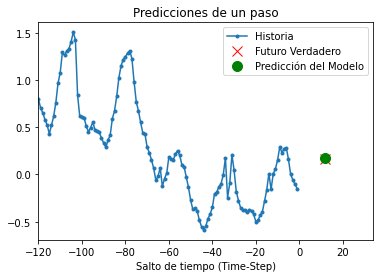

8/8 [==============================] - 0s 19ms/step


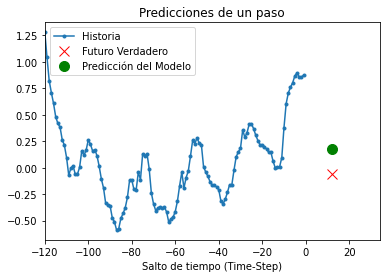

8/8 [==============================] - 0s 18ms/step


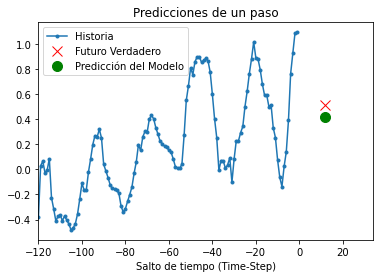

8/8 [==============================] - 0s 18ms/step


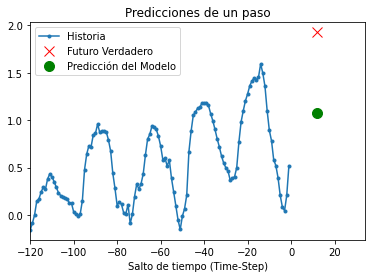

8/8 [==============================] - 0s 19ms/step


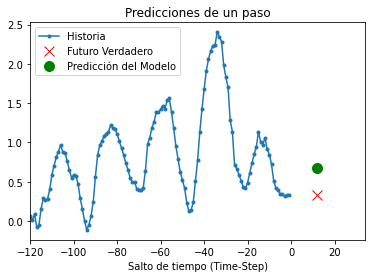

8/8 [==============================] - 0s 19ms/step


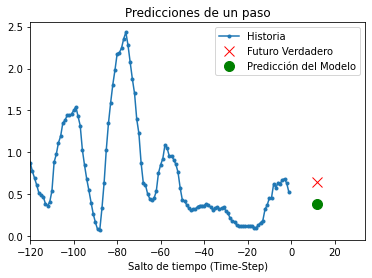

8/8 [==============================] - 0s 21ms/step


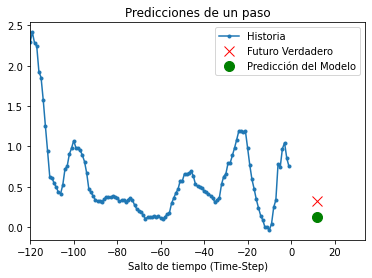

8/8 [==============================] - 0s 21ms/step


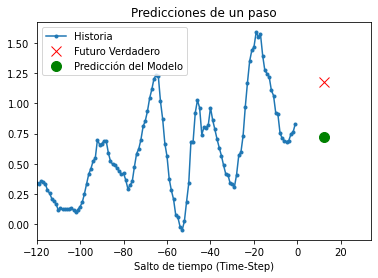

8/8 [==============================] - 0s 21ms/step


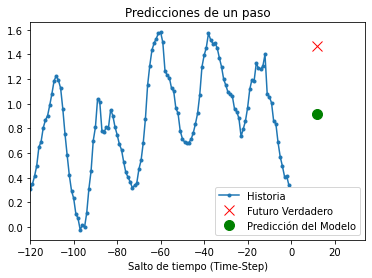

8/8 [==============================] - 0s 18ms/step


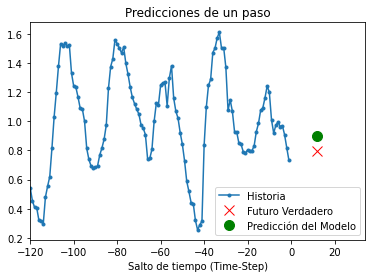

8/8 [==============================] - 0s 19ms/step


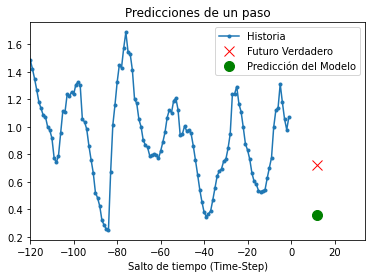

8/8 [==============================] - 0s 16ms/step


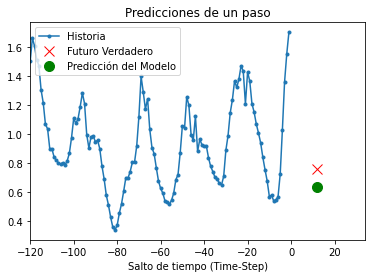

8/8 [==============================] - 0s 20ms/step


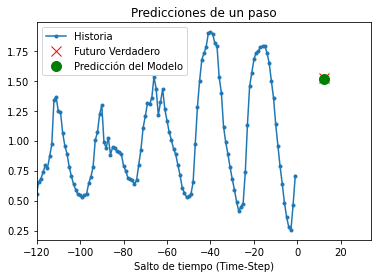

8/8 [==============================] - 0s 22ms/step


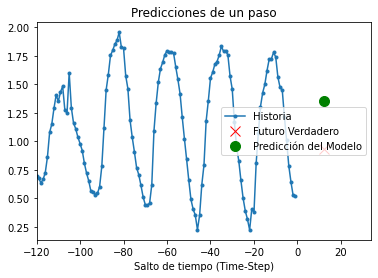

8/8 [==============================] - 0s 24ms/step


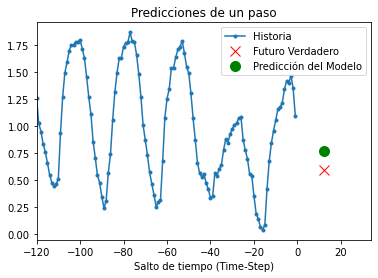

8/8 [==============================] - 0s 22ms/step


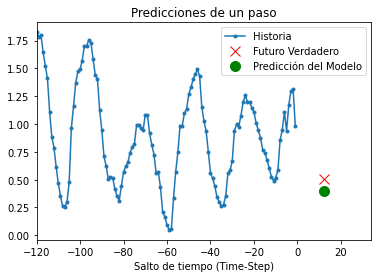

8/8 [==============================] - 0s 27ms/step


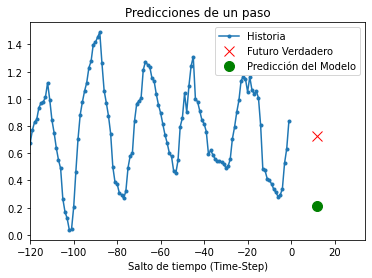

8/8 [==============================] - 0s 21ms/step


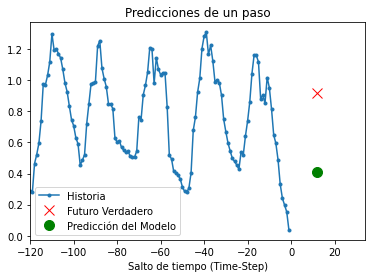

8/8 [==============================] - 0s 25ms/step


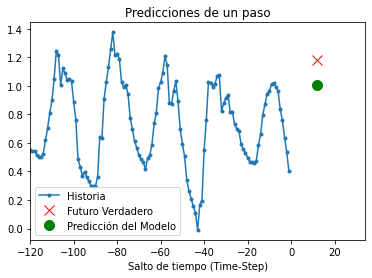

8/8 [==============================] - 0s 21ms/step


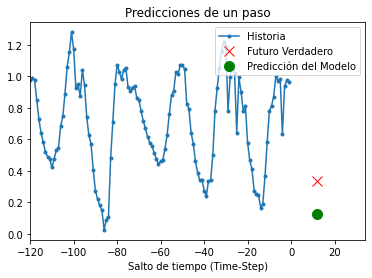

8/8 [==============================] - 0s 23ms/step


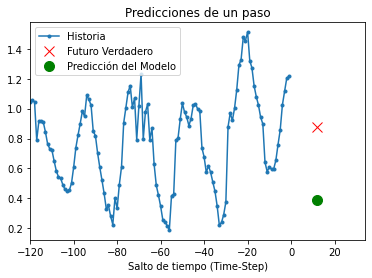

8/8 [==============================] - 0s 24ms/step


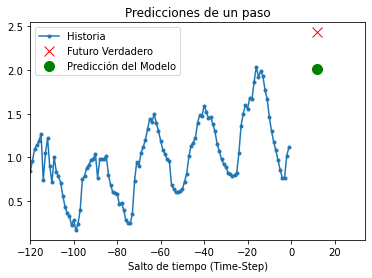

8/8 [==============================] - 0s 23ms/step


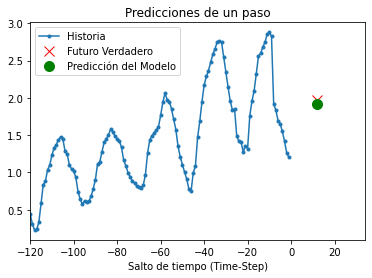

8/8 [==============================] - 0s 22ms/step


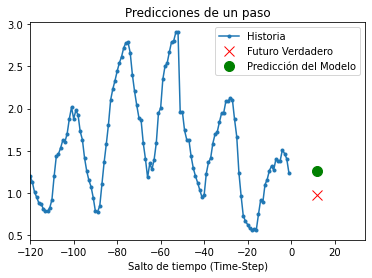

8/8 [==============================] - 0s 23ms/step


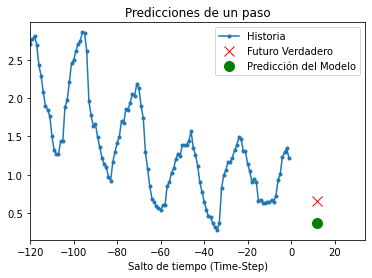

8/8 [==============================] - 0s 22ms/step


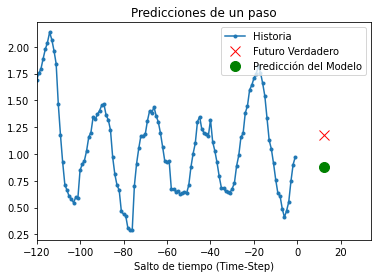

8/8 [==============================] - 0s 22ms/step


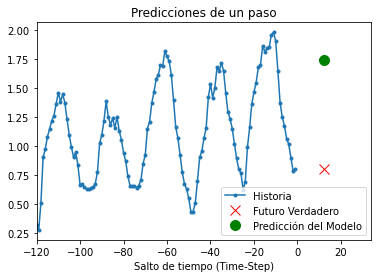

8/8 [==============================] - 0s 22ms/step


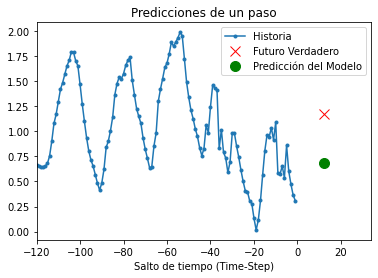

8/8 [==============================] - 0s 24ms/step


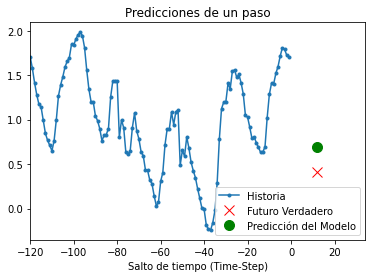

8/8 [==============================] - 0s 24ms/step


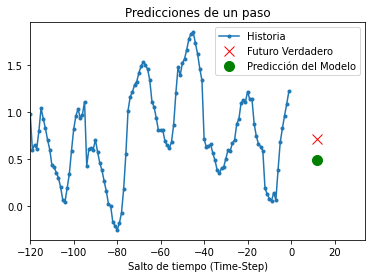

8/8 [==============================] - 0s 19ms/step


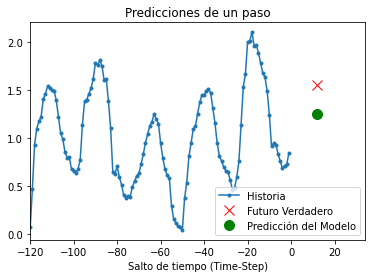

8/8 [==============================] - 0s 22ms/step


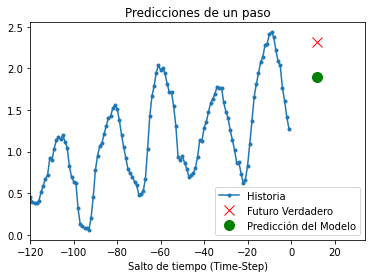

8/8 [==============================] - 0s 17ms/step


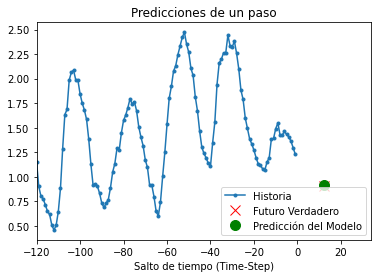

8/8 [==============================] - 0s 20ms/step


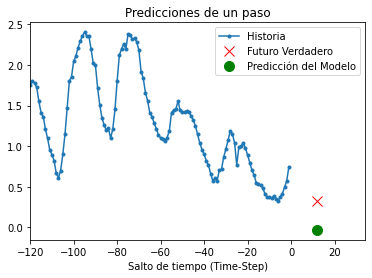

8/8 [==============================] - 0s 22ms/step


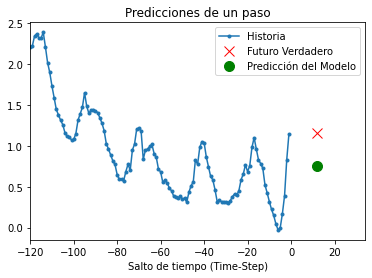

8/8 [==============================] - 0s 18ms/step


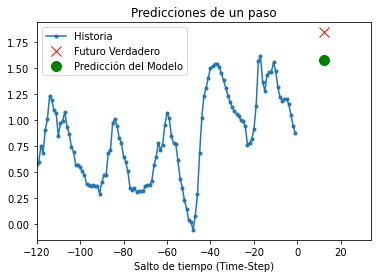

8/8 [==============================] - 0s 21ms/step


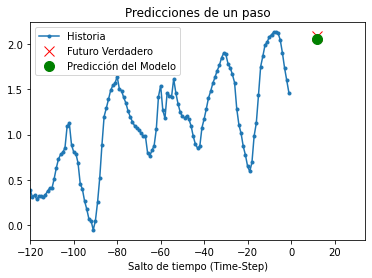

8/8 [==============================] - 0s 24ms/step


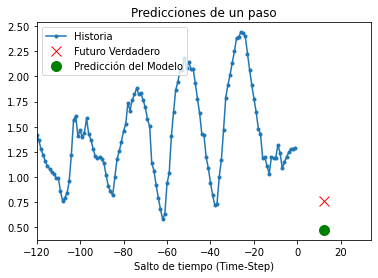

8/8 [==============================] - 0s 24ms/step


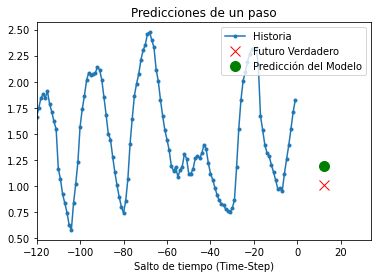

8/8 [==============================] - 0s 29ms/step


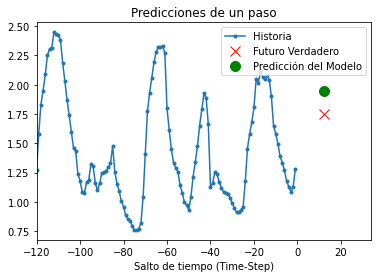

8/8 [==============================] - 0s 25ms/step


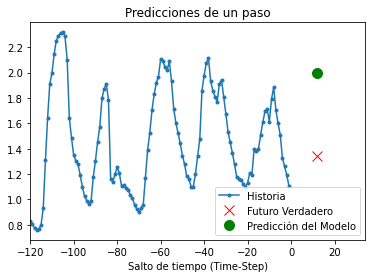

8/8 [==============================] - 0s 25ms/step


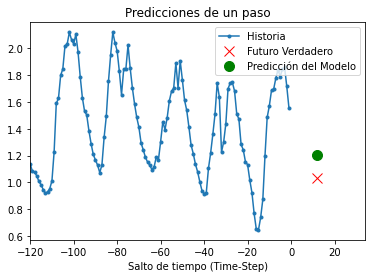

8/8 [==============================] - 0s 24ms/step


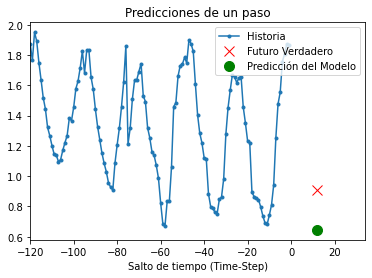

8/8 [==============================] - 0s 27ms/step


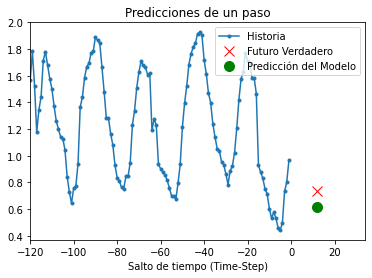

8/8 [==============================] - 0s 24ms/step


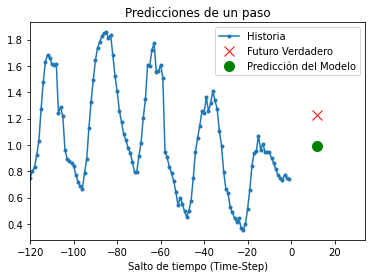

8/8 [==============================] - 0s 22ms/step


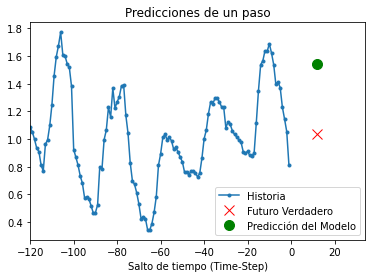

8/8 [==============================] - 0s 23ms/step


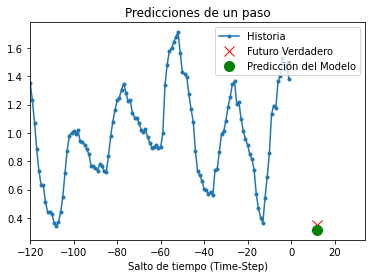

8/8 [==============================] - 0s 20ms/step


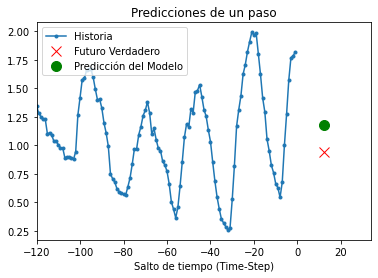

8/8 [==============================] - 0s 21ms/step


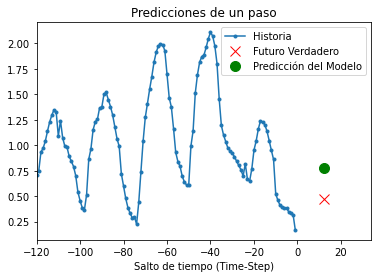

8/8 [==============================] - 0s 25ms/step


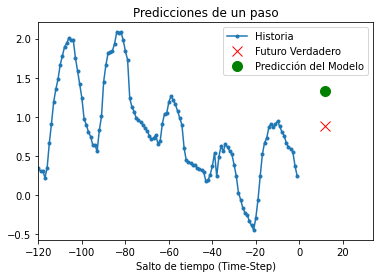

8/8 [==============================] - 0s 22ms/step


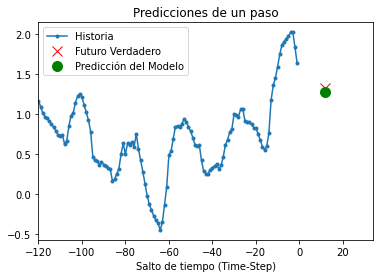

8/8 [==============================] - 0s 24ms/step


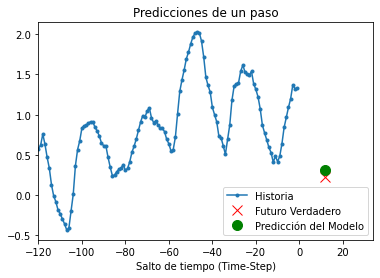

8/8 [==============================] - 0s 24ms/step


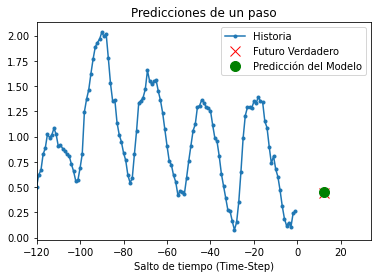

8/8 [==============================] - 0s 25ms/step


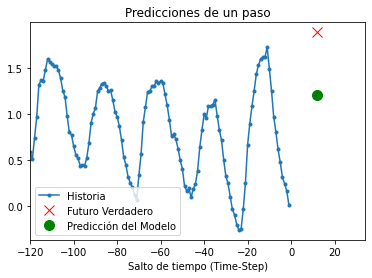

8/8 [==============================] - 0s 23ms/step


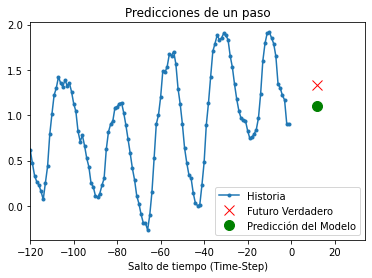

8/8 [==============================] - 0s 19ms/step


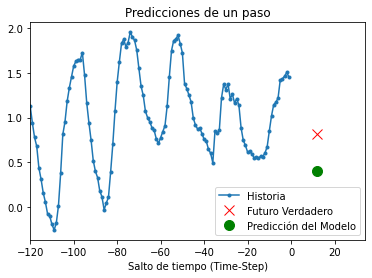

8/8 [==============================] - 0s 19ms/step


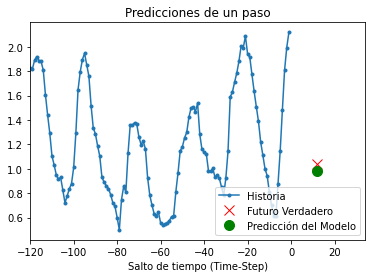

8/8 [==============================] - 0s 24ms/step


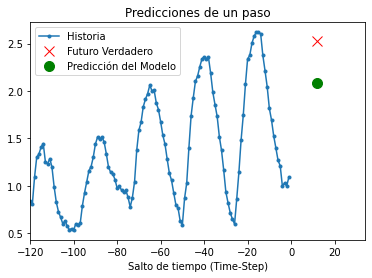

8/8 [==============================] - 0s 23ms/step


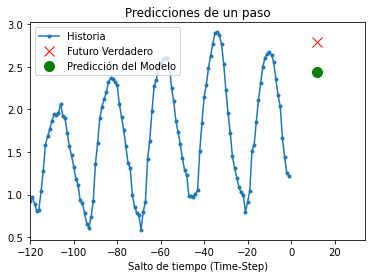

8/8 [==============================] - 0s 24ms/step


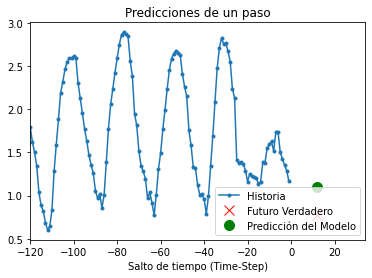

8/8 [==============================] - 0s 25ms/step


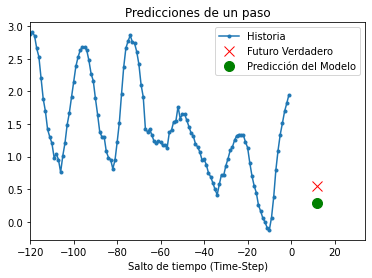

8/8 [==============================] - 0s 22ms/step


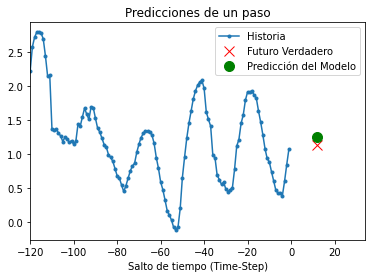

8/8 [==============================] - 0s 18ms/step


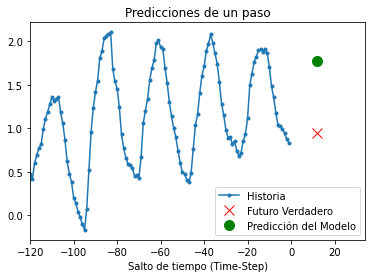

8/8 [==============================] - 0s 20ms/step


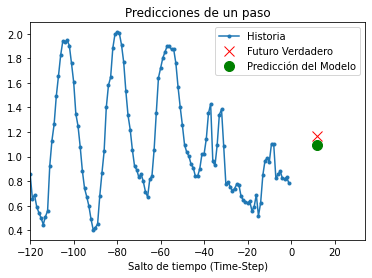

8/8 [==============================] - 0s 20ms/step


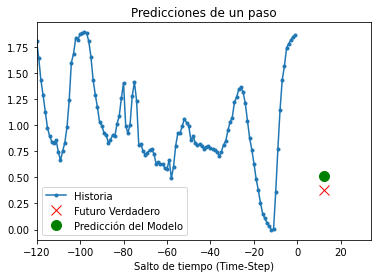

8/8 [==============================] - 0s 24ms/step


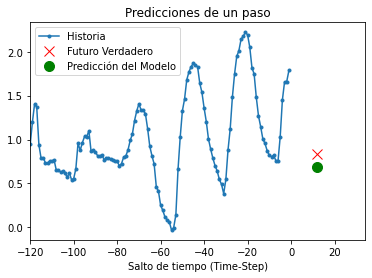

8/8 [==============================] - 0s 23ms/step


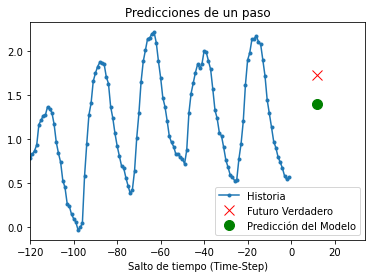

8/8 [==============================] - 0s 23ms/step


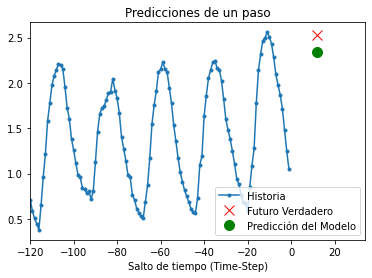

8/8 [==============================] - 0s 21ms/step


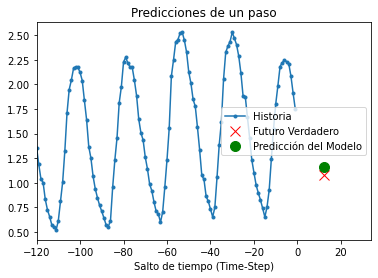

8/8 [==============================] - 0s 20ms/step


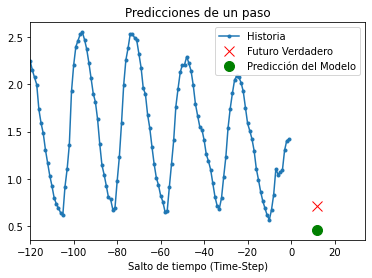

8/8 [==============================] - 0s 20ms/step


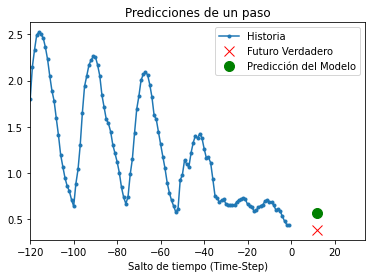

8/8 [==============================] - 0s 25ms/step


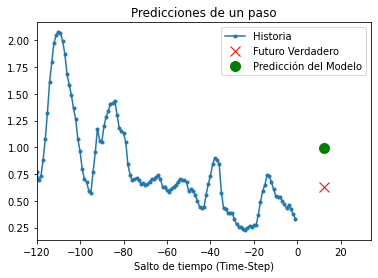

8/8 [==============================] - 0s 22ms/step


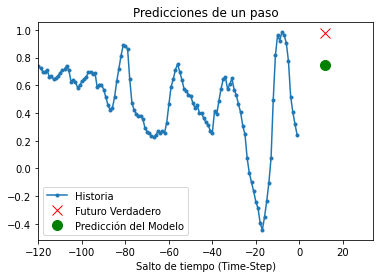

8/8 [==============================] - 0s 22ms/step


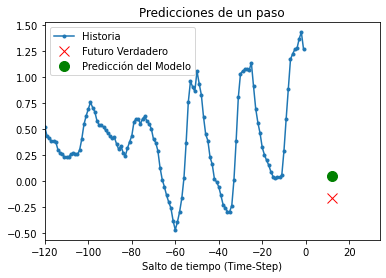

8/8 [==============================] - 0s 25ms/step


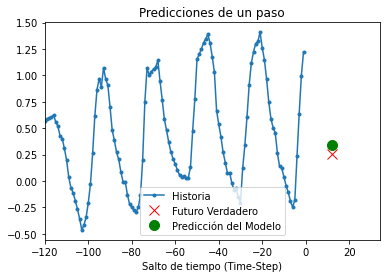

8/8 [==============================] - 0s 18ms/step


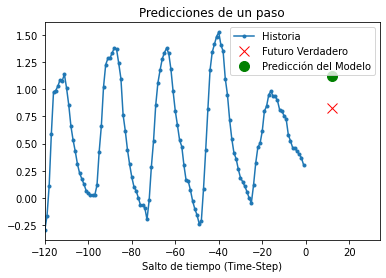

8/8 [==============================] - 0s 18ms/step


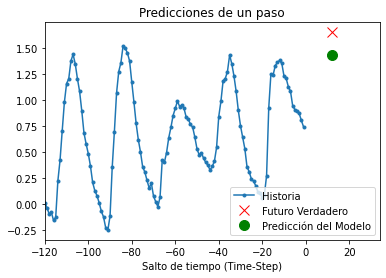

8/8 [==============================] - 0s 20ms/step


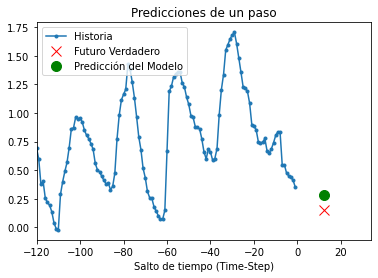

8/8 [==============================] - 0s 20ms/step


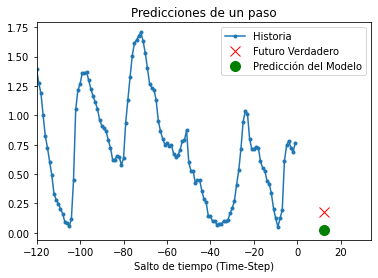

8/8 [==============================] - 0s 20ms/step


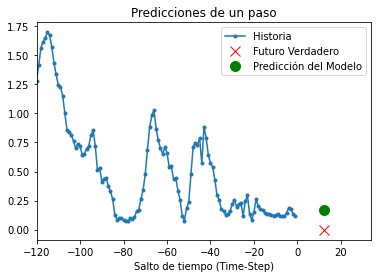

8/8 [==============================] - 0s 19ms/step


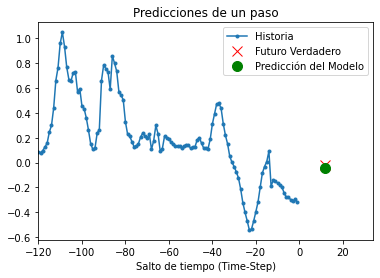

8/8 [==============================] - 0s 18ms/step


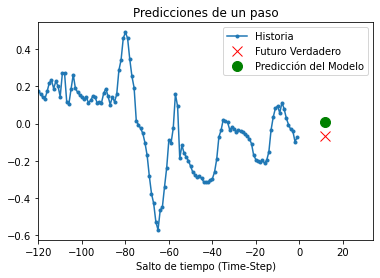

8/8 [==============================] - 0s 17ms/step


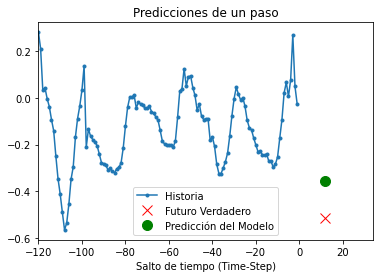

8/8 [==============================] - 0s 25ms/step


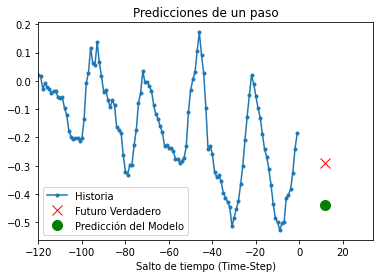

8/8 [==============================] - 0s 23ms/step


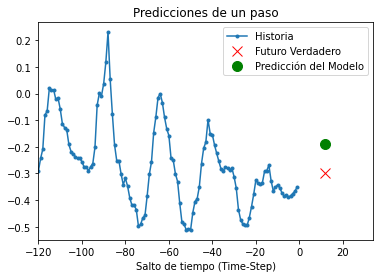

8/8 [==============================] - 0s 22ms/step


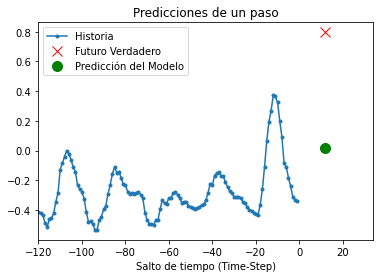

8/8 [==============================] - 0s 24ms/step


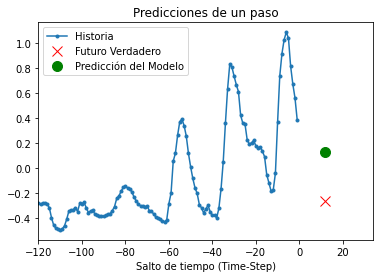

8/8 [==============================] - 0s 22ms/step


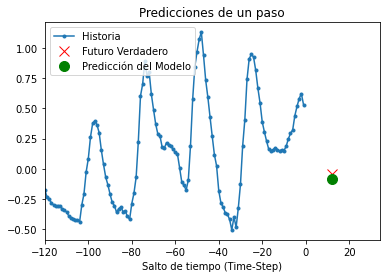

8/8 [==============================] - 0s 23ms/step


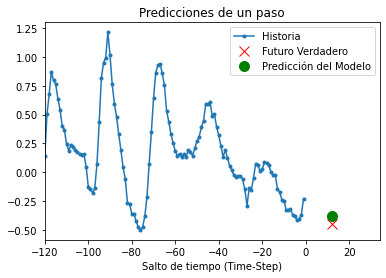

8/8 [==============================] - 0s 22ms/step


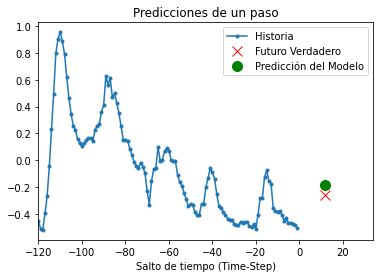

8/8 [==============================] - 0s 25ms/step


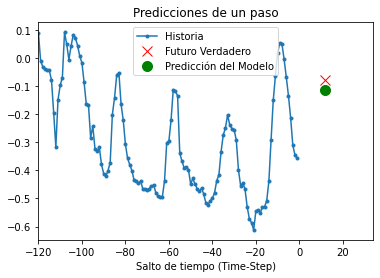

8/8 [==============================] - 0s 20ms/step


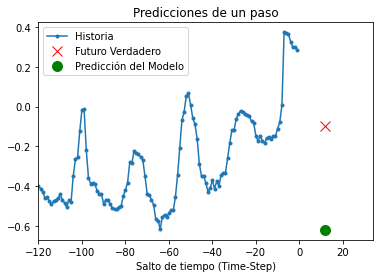

8/8 [==============================] - 0s 22ms/step


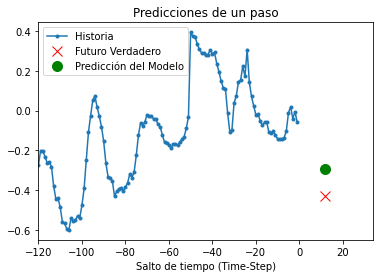

8/8 [==============================] - 0s 28ms/step


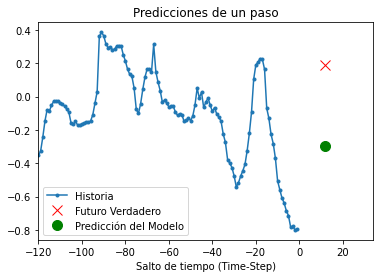

8/8 [==============================] - 0s 19ms/step


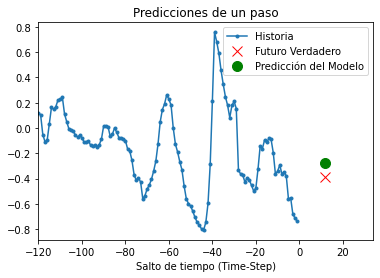

8/8 [==============================] - 0s 23ms/step


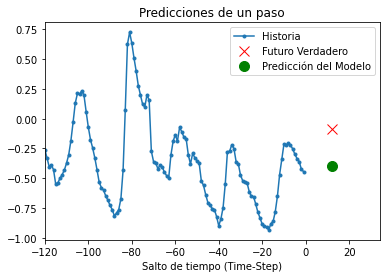

8/8 [==============================] - 0s 20ms/step


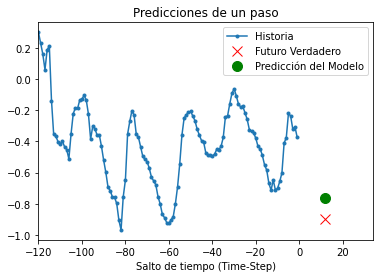

8/8 [==============================] - 0s 23ms/step


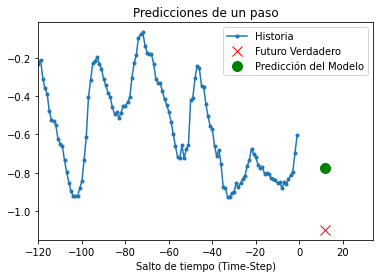

8/8 [==============================] - 0s 20ms/step


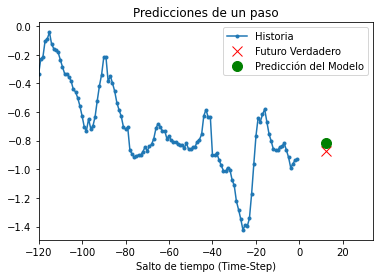

8/8 [==============================] - 0s 20ms/step


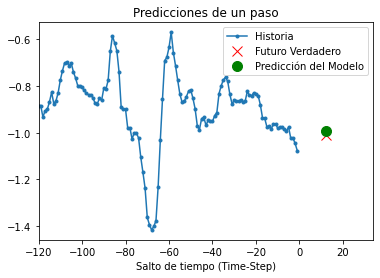

8/8 [==============================] - 0s 20ms/step


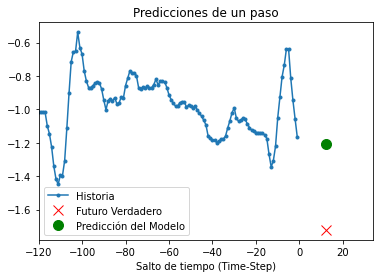

8/8 [==============================] - 0s 22ms/step


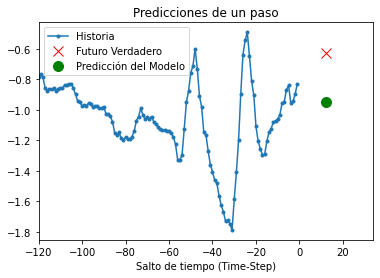

8/8 [==============================] - 0s 23ms/step


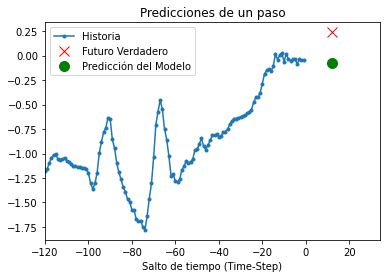

8/8 [==============================] - 0s 28ms/step


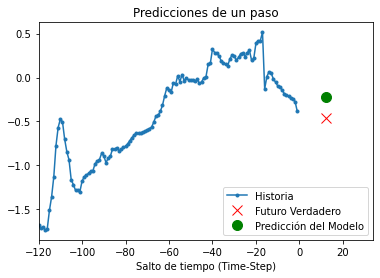

8/8 [==============================] - 0s 21ms/step


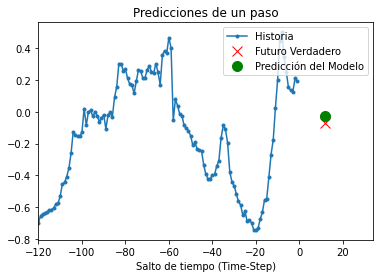

8/8 [==============================] - 0s 26ms/step


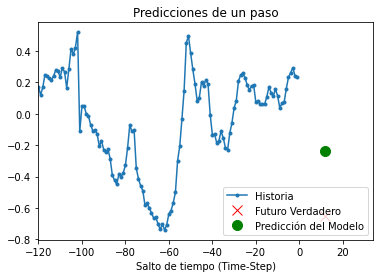

8/8 [==============================] - 0s 22ms/step


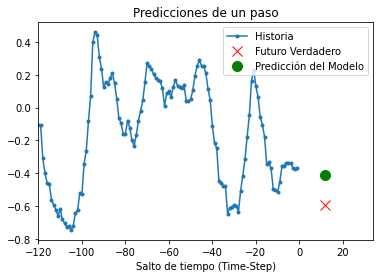

8/8 [==============================] - 0s 22ms/step


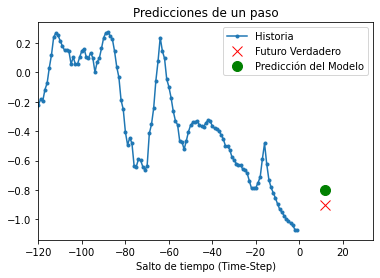

8/8 [==============================] - 0s 19ms/step


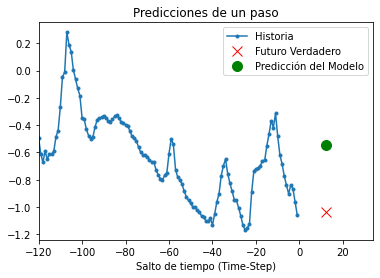

8/8 [==============================] - 0s 23ms/step


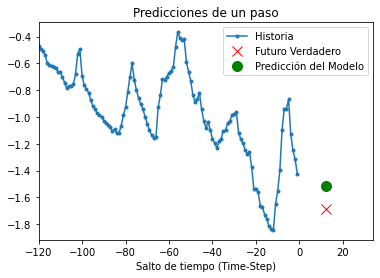

8/8 [==============================] - 0s 24ms/step


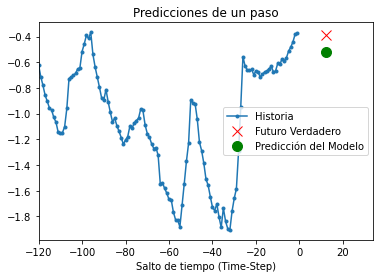

8/8 [==============================] - 0s 32ms/step


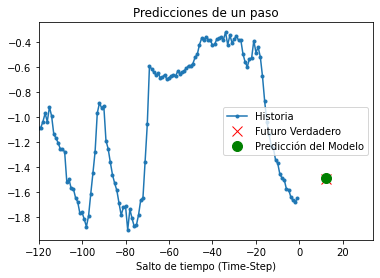

8/8 [==============================] - 0s 27ms/step


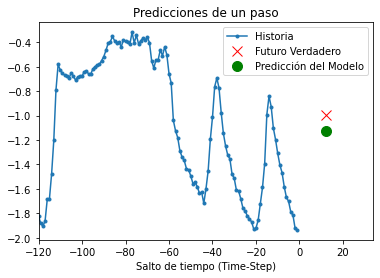

8/8 [==============================] - 0s 23ms/step


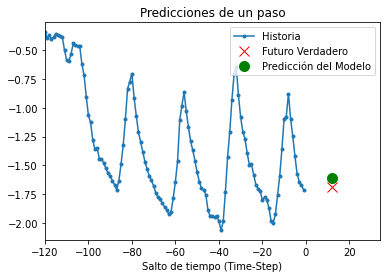

8/8 [==============================] - 1s 25ms/step


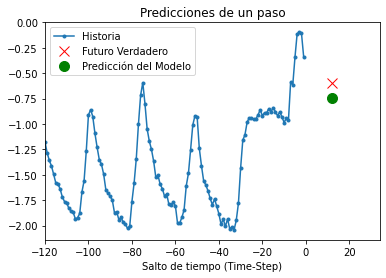

8/8 [==============================] - 0s 23ms/step


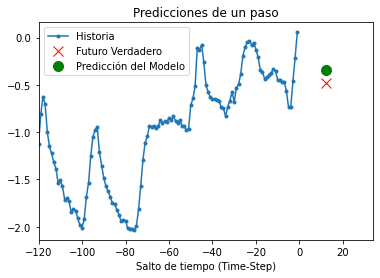

8/8 [==============================] - 0s 24ms/step


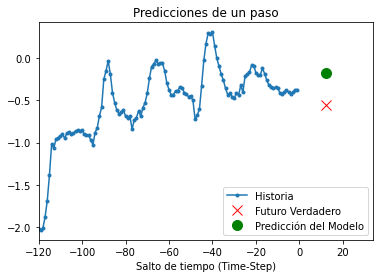

8/8 [==============================] - 0s 29ms/step


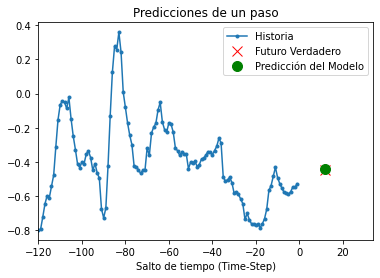

8/8 [==============================] - 0s 31ms/step


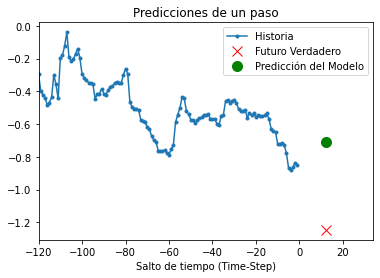

8/8 [==============================] - 0s 26ms/step


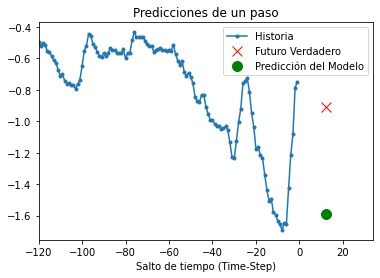

8/8 [==============================] - 0s 23ms/step


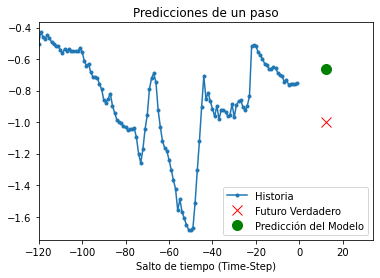

8/8 [==============================] - 0s 24ms/step


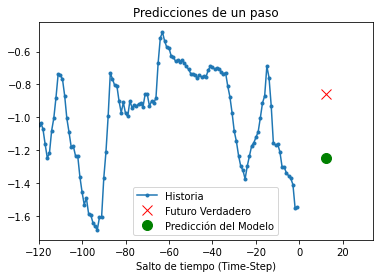

8/8 [==============================] - 0s 27ms/step


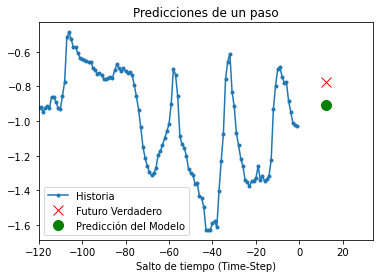

8/8 [==============================] - 0s 25ms/step


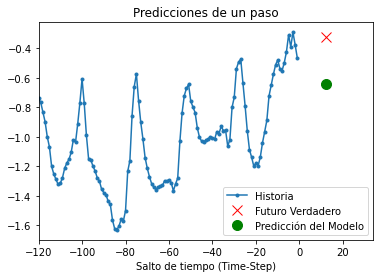

8/8 [==============================] - 0s 27ms/step


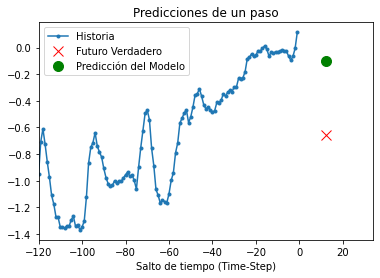

8/8 [==============================] - 0s 26ms/step


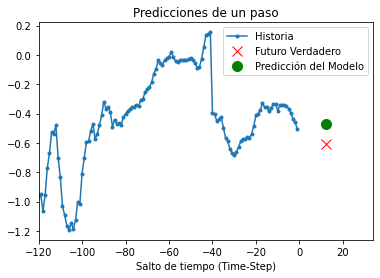

7/7 [==============================] - 0s 25ms/step


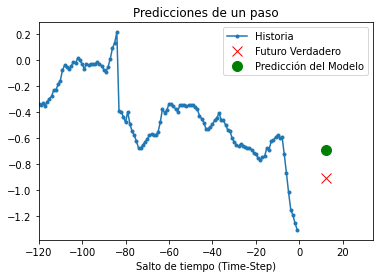

8/8 [==============================] - 0s 22ms/step


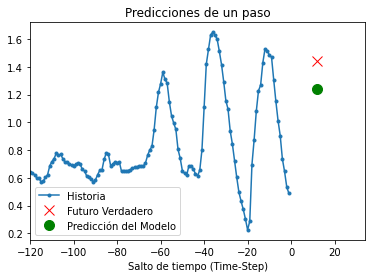

8/8 [==============================] - 0s 21ms/step


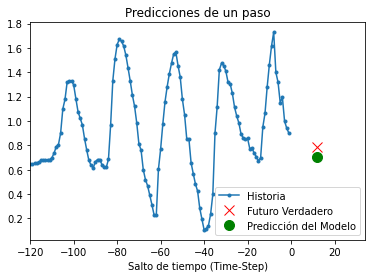

8/8 [==============================] - 0s 21ms/step


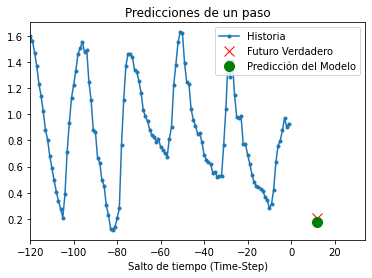

8/8 [==============================] - 0s 16ms/step


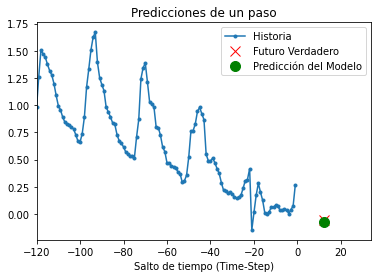

8/8 [==============================] - 0s 20ms/step


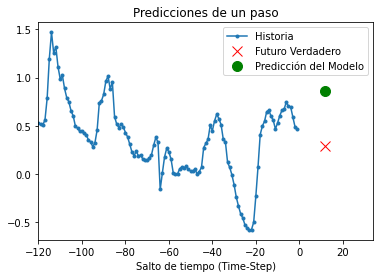

8/8 [==============================] - 0s 20ms/step


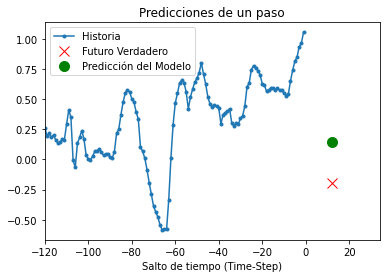

8/8 [==============================] - 0s 18ms/step


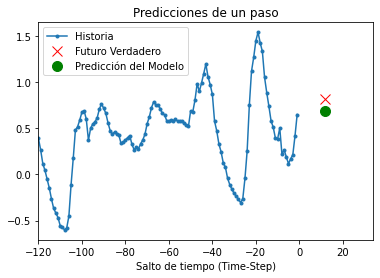

8/8 [==============================] - 0s 21ms/step


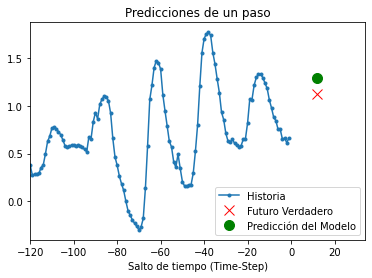

8/8 [==============================] - 0s 18ms/step


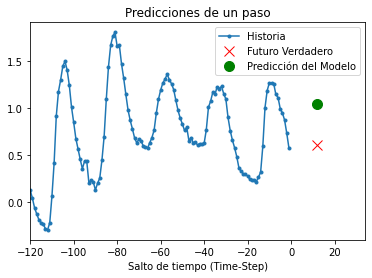

8/8 [==============================] - 0s 21ms/step


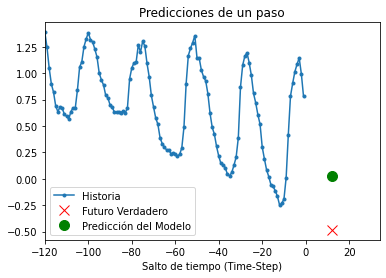

8/8 [==============================] - 0s 18ms/step


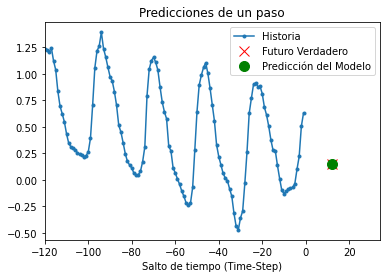

8/8 [==============================] - 0s 24ms/step


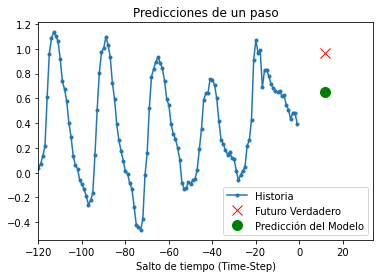

8/8 [==============================] - 0s 25ms/step


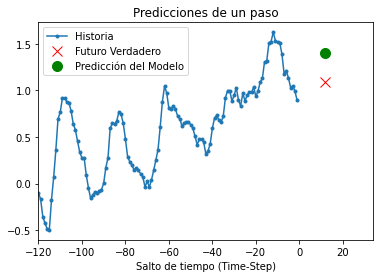

8/8 [==============================] - 0s 21ms/step


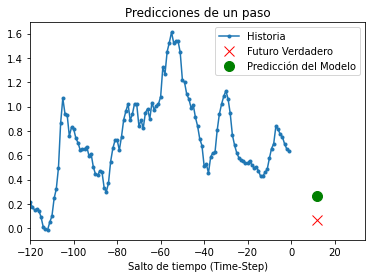

8/8 [==============================] - 0s 21ms/step


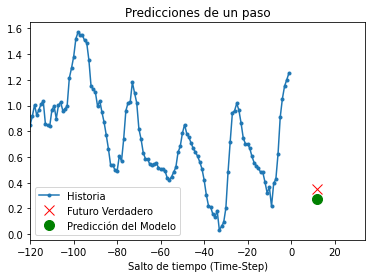

8/8 [==============================] - 0s 24ms/step


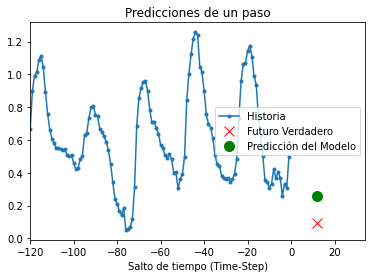

8/8 [==============================] - 0s 23ms/step


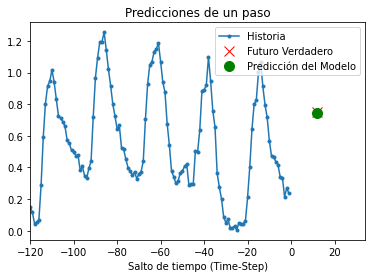

8/8 [==============================] - 0s 22ms/step


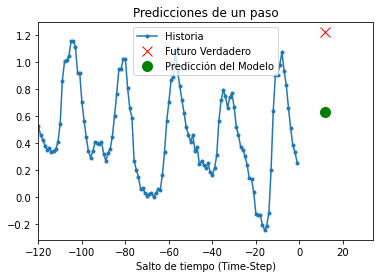

8/8 [==============================] - 0s 27ms/step


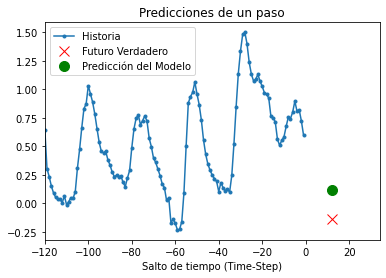

8/8 [==============================] - 0s 24ms/step


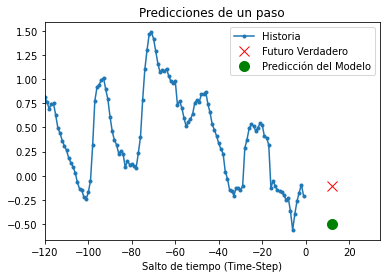

8/8 [==============================] - 0s 22ms/step


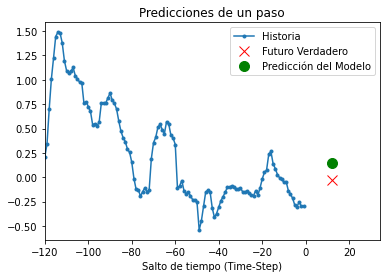

8/8 [==============================] - 0s 22ms/step


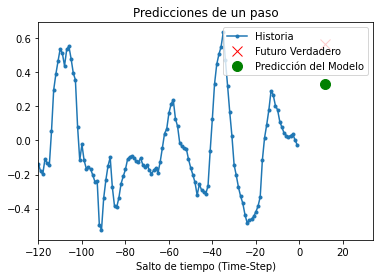

8/8 [==============================] - 0s 26ms/step


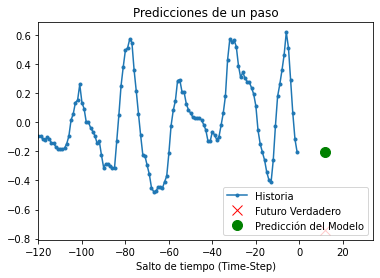

8/8 [==============================] - 0s 25ms/step


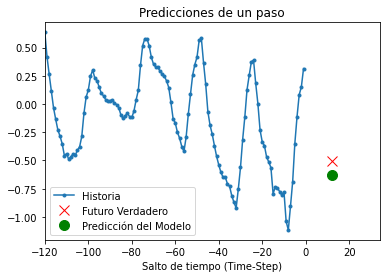

8/8 [==============================] - 0s 24ms/step


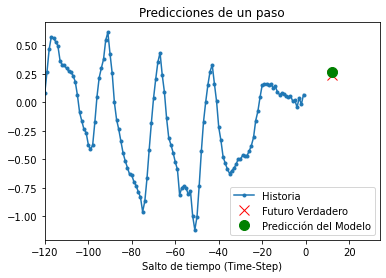

8/8 [==============================] - 0s 24ms/step


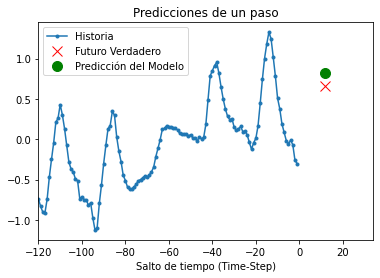

8/8 [==============================] - 0s 22ms/step


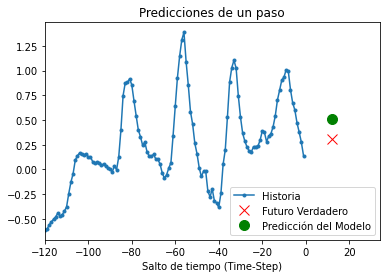

8/8 [==============================] - 0s 21ms/step


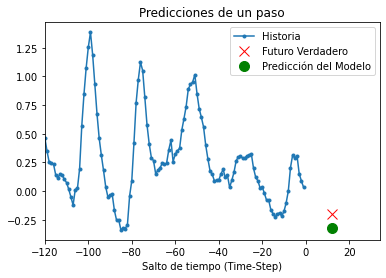

8/8 [==============================] - 0s 24ms/step


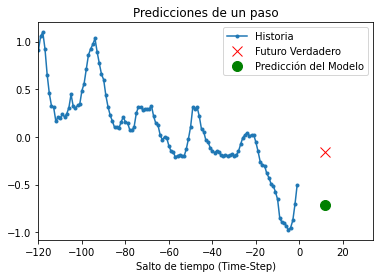

8/8 [==============================] - 0s 23ms/step


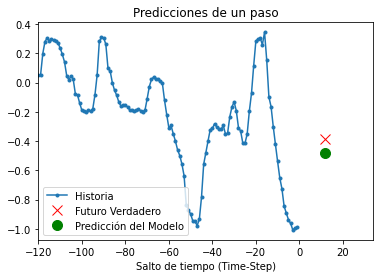

8/8 [==============================] - 0s 23ms/step


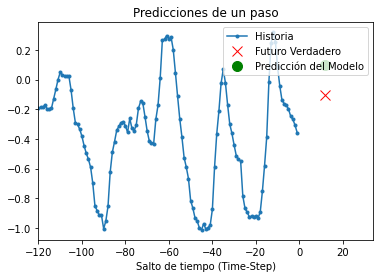

8/8 [==============================] - 0s 21ms/step


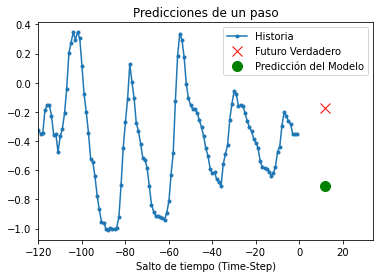

8/8 [==============================] - 0s 20ms/step


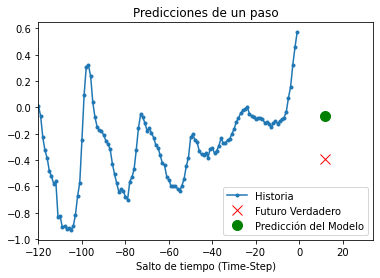

8/8 [==============================] - 0s 22ms/step


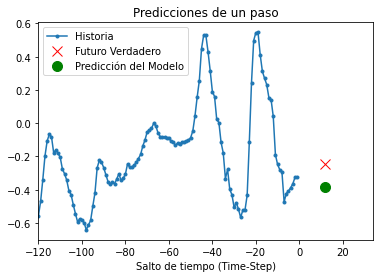

8/8 [==============================] - 0s 23ms/step


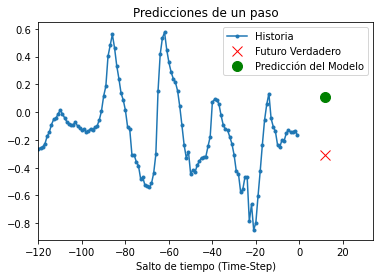

8/8 [==============================] - 0s 20ms/step


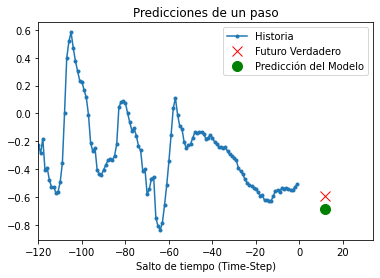

8/8 [==============================] - 0s 18ms/step


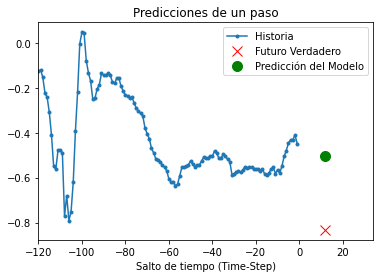

8/8 [==============================] - 0s 26ms/step


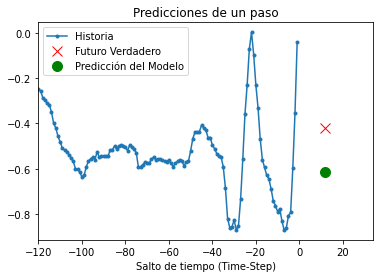

8/8 [==============================] - 0s 20ms/step


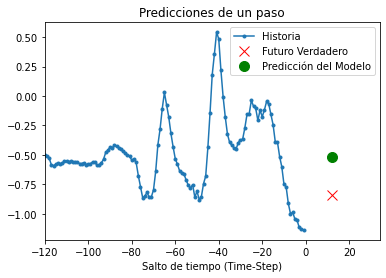

8/8 [==============================] - 0s 21ms/step


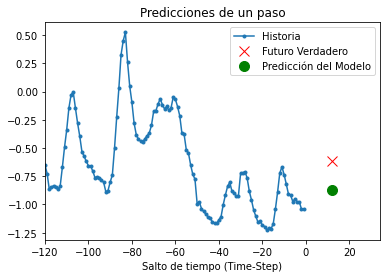

8/8 [==============================] - 0s 22ms/step


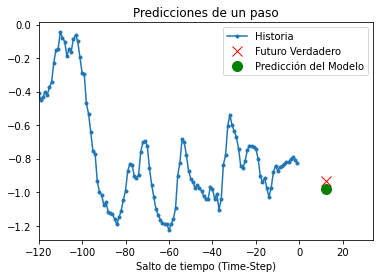

8/8 [==============================] - 0s 22ms/step


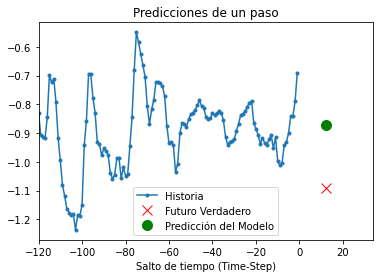

8/8 [==============================] - 0s 25ms/step


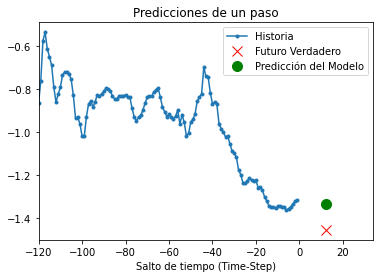

8/8 [==============================] - 0s 20ms/step


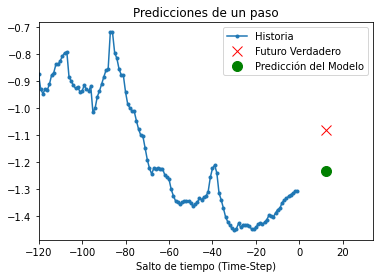

8/8 [==============================] - 0s 19ms/step


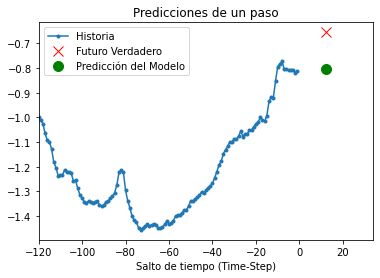

8/8 [==============================] - 0s 18ms/step


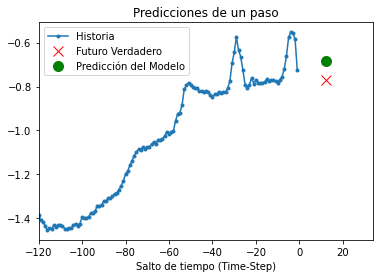

8/8 [==============================] - 0s 20ms/step


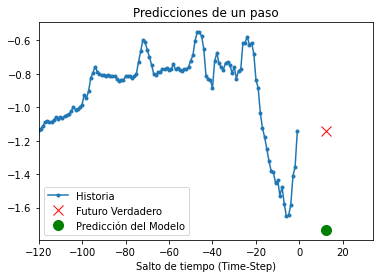

8/8 [==============================] - 0s 20ms/step


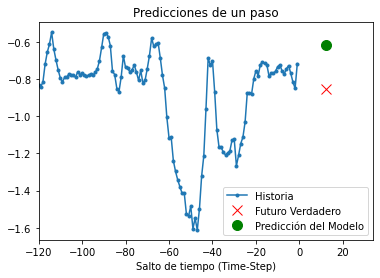

8/8 [==============================] - 0s 24ms/step


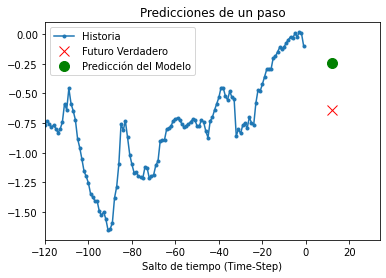

8/8 [==============================] - 0s 20ms/step


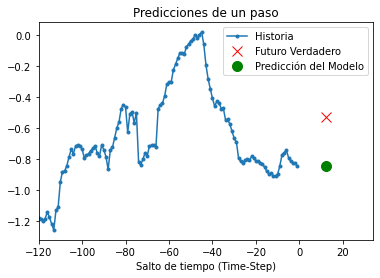

8/8 [==============================] - 0s 18ms/step


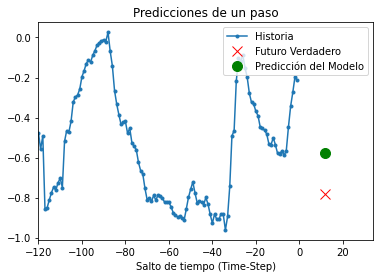

8/8 [==============================] - 0s 27ms/step


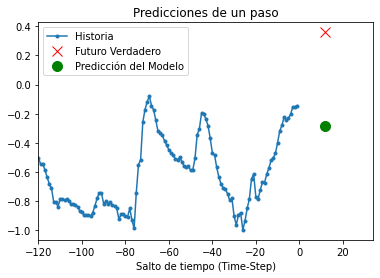

8/8 [==============================] - 0s 22ms/step


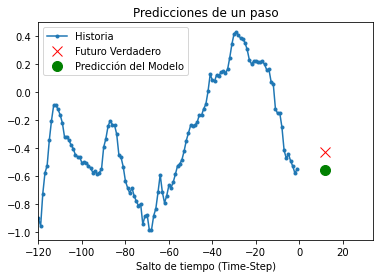

8/8 [==============================] - 0s 21ms/step


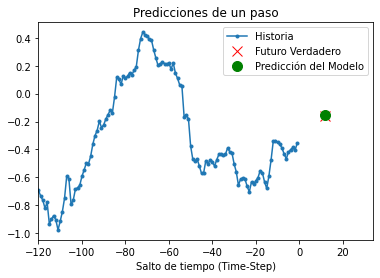

8/8 [==============================] - 0s 21ms/step


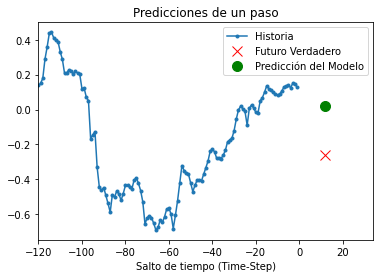

8/8 [==============================] - 0s 23ms/step


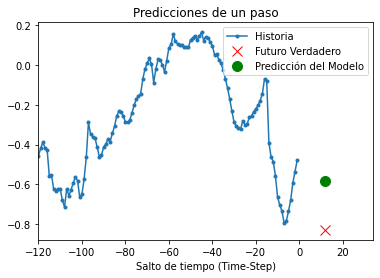

8/8 [==============================] - 0s 18ms/step


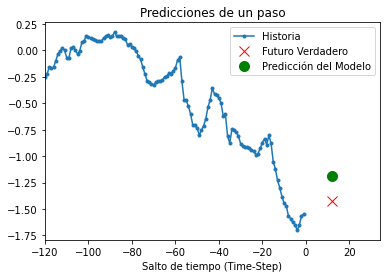

8/8 [==============================] - 0s 26ms/step


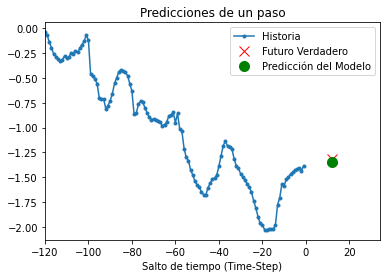

8/8 [==============================] - 0s 23ms/step


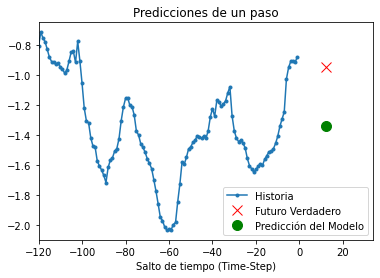

8/8 [==============================] - 0s 22ms/step


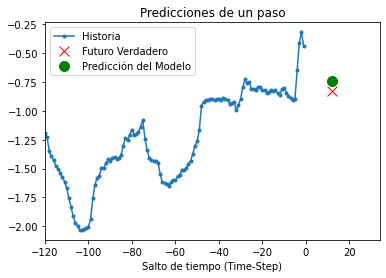

8/8 [==============================] - 0s 21ms/step


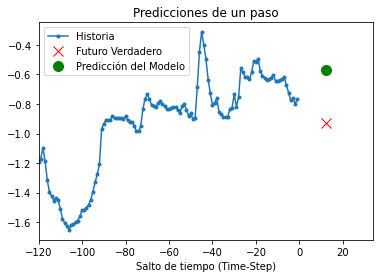

8/8 [==============================] - 0s 20ms/step


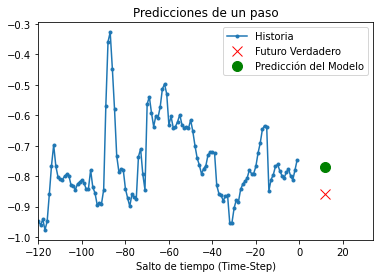

8/8 [==============================] - 0s 18ms/step


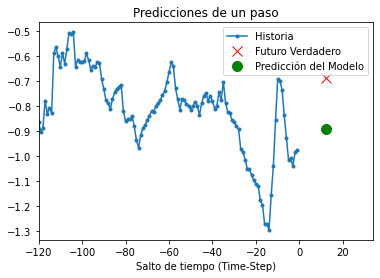

8/8 [==============================] - 0s 29ms/step


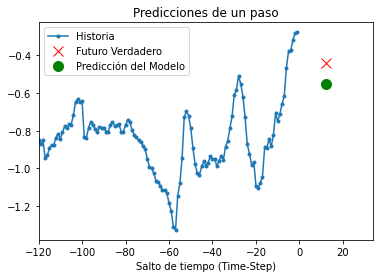

8/8 [==============================] - 0s 21ms/step


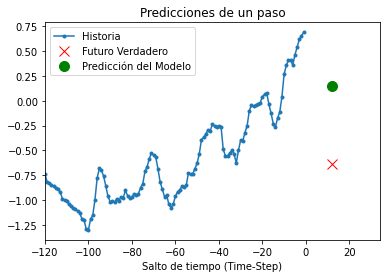

8/8 [==============================] - 0s 21ms/step


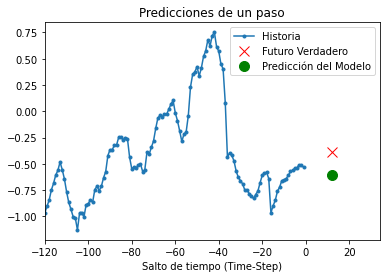

8/8 [==============================] - 0s 23ms/step


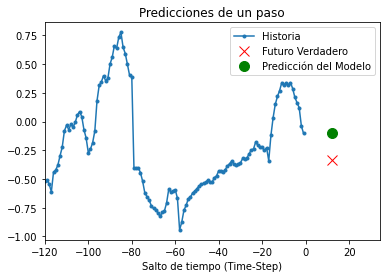

8/8 [==============================] - 0s 23ms/step


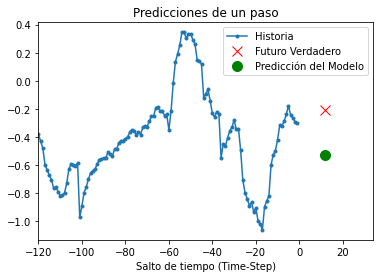

8/8 [==============================] - 0s 19ms/step


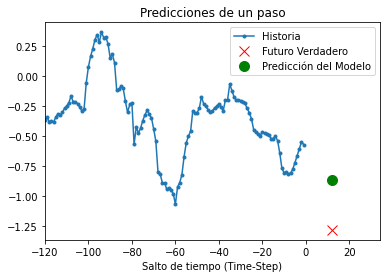

8/8 [==============================] - 0s 22ms/step


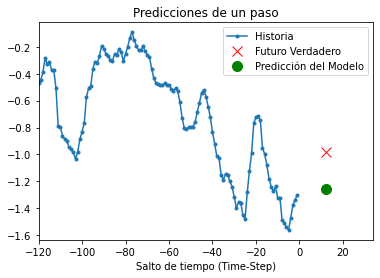

8/8 [==============================] - 0s 25ms/step


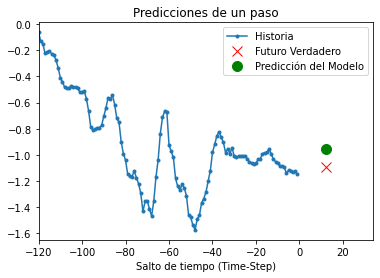

8/8 [==============================] - 0s 22ms/step


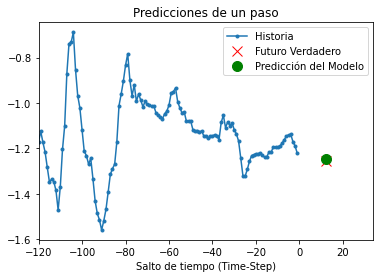

8/8 [==============================] - 0s 25ms/step


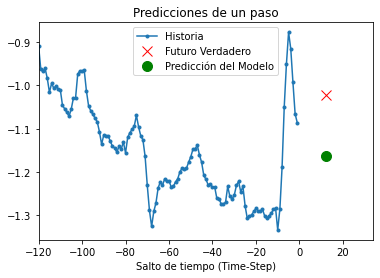

8/8 [==============================] - 0s 19ms/step


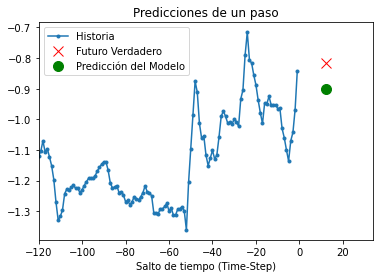

8/8 [==============================] - 0s 21ms/step


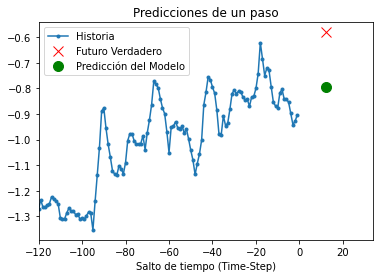

8/8 [==============================] - 0s 21ms/step


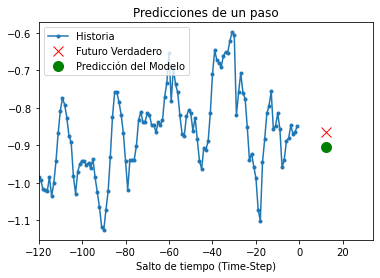

8/8 [==============================] - 0s 24ms/step


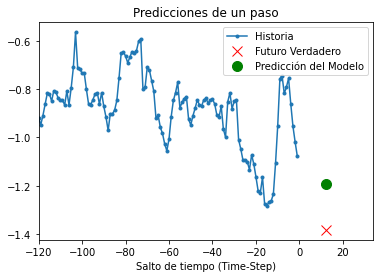

8/8 [==============================] - 0s 22ms/step


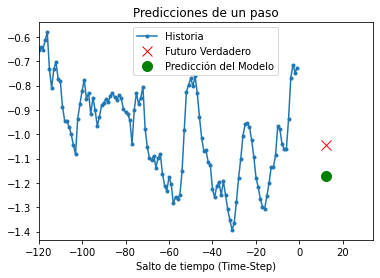

8/8 [==============================] - 0s 24ms/step


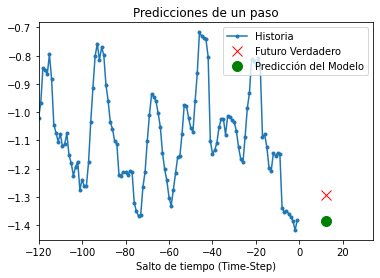

8/8 [==============================] - 0s 21ms/step


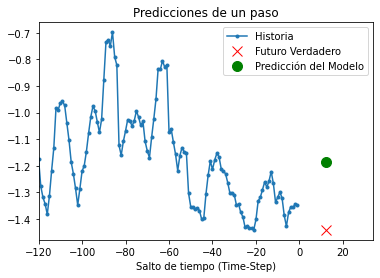

8/8 [==============================] - 0s 29ms/step


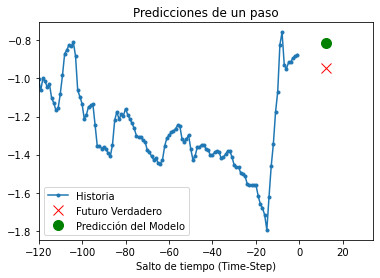

8/8 [==============================] - 0s 22ms/step


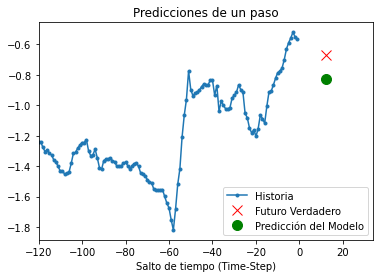

8/8 [==============================] - 0s 23ms/step


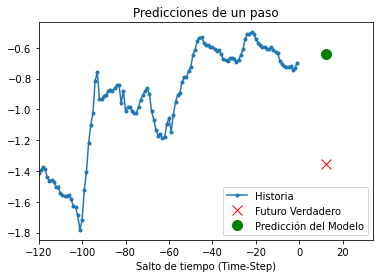

8/8 [==============================] - 0s 25ms/step


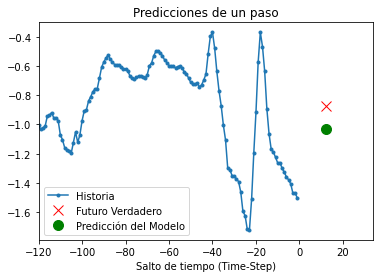

8/8 [==============================] - 0s 21ms/step


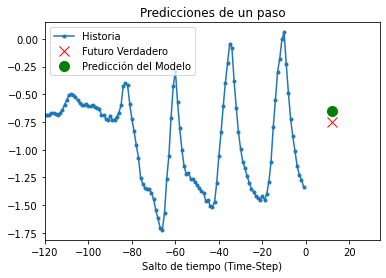

8/8 [==============================] - 0s 20ms/step


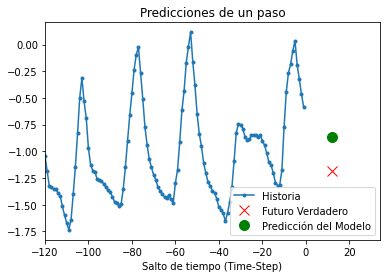

8/8 [==============================] - 0s 24ms/step


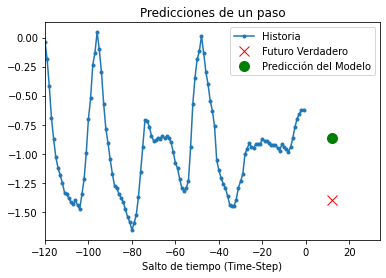

8/8 [==============================] - 0s 26ms/step


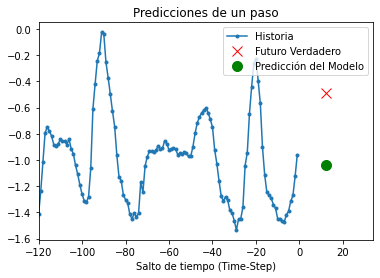

8/8 [==============================] - 0s 25ms/step


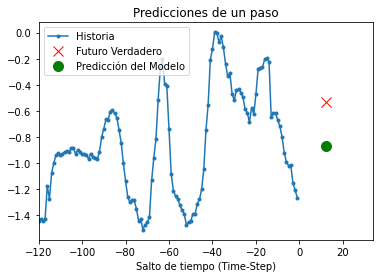

8/8 [==============================] - 0s 24ms/step


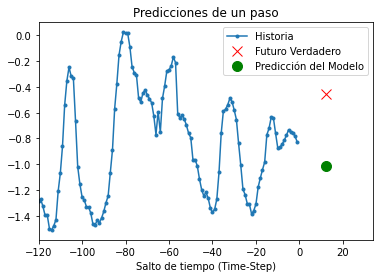

8/8 [==============================] - 0s 25ms/step


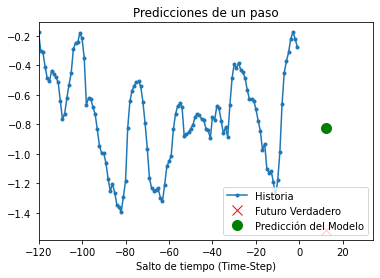

8/8 [==============================] - 0s 23ms/step


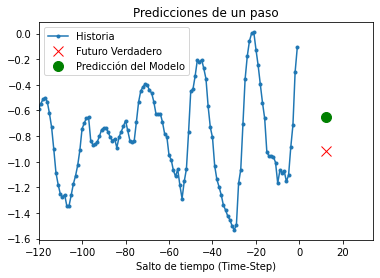

8/8 [==============================] - 0s 26ms/step


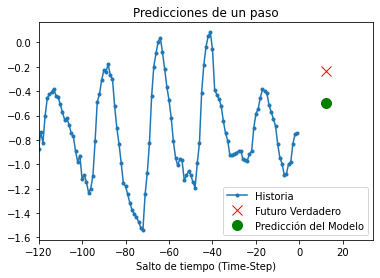

8/8 [==============================] - 0s 20ms/step


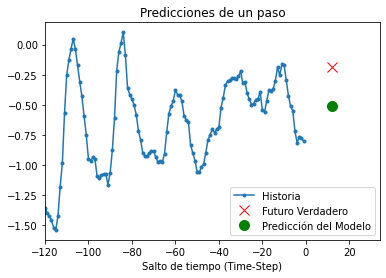

8/8 [==============================] - 0s 20ms/step


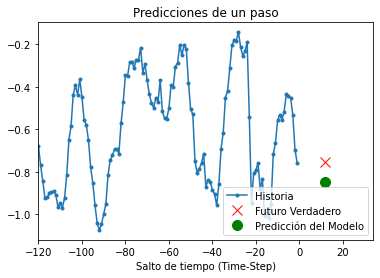

8/8 [==============================] - 0s 24ms/step


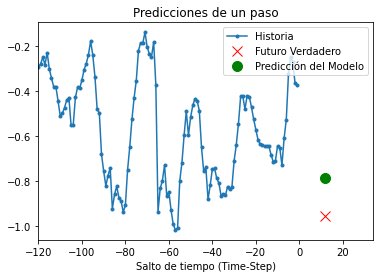

8/8 [==============================] - 0s 22ms/step


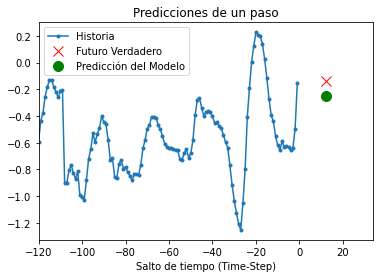

8/8 [==============================] - 0s 23ms/step


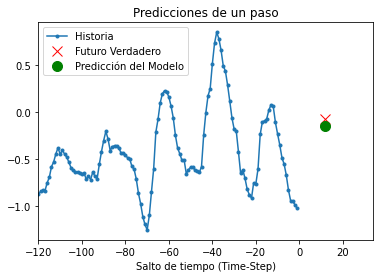

8/8 [==============================] - 0s 20ms/step


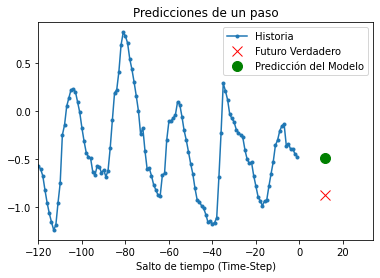

8/8 [==============================] - 0s 23ms/step


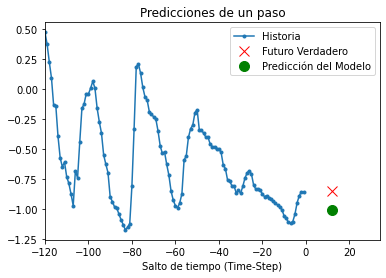

8/8 [==============================] - 0s 24ms/step


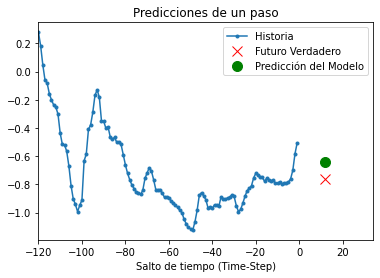

8/8 [==============================] - 0s 23ms/step


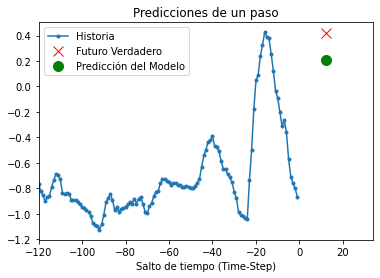

8/8 [==============================] - 0s 22ms/step


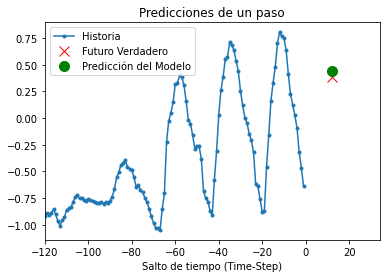

8/8 [==============================] - 0s 29ms/step


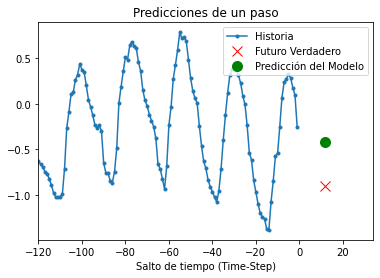

8/8 [==============================] - 0s 20ms/step


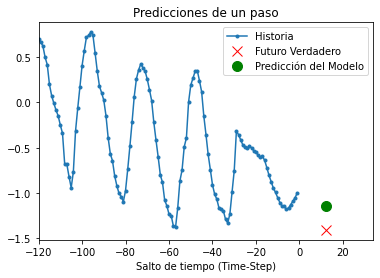

8/8 [==============================] - 0s 24ms/step


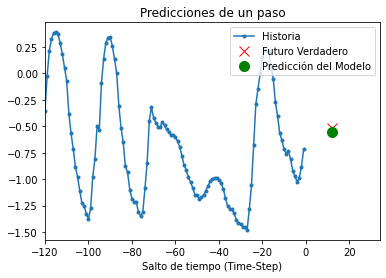

8/8 [==============================] - 0s 22ms/step


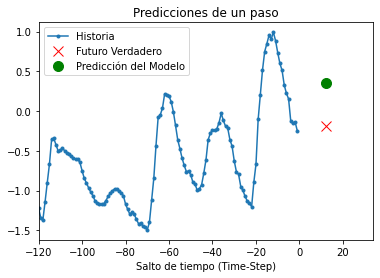

8/8 [==============================] - 0s 28ms/step


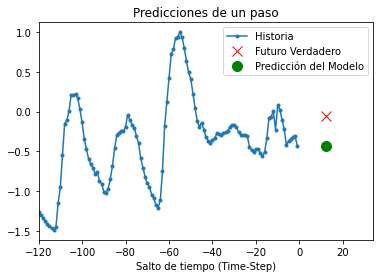

8/8 [==============================] - 0s 23ms/step


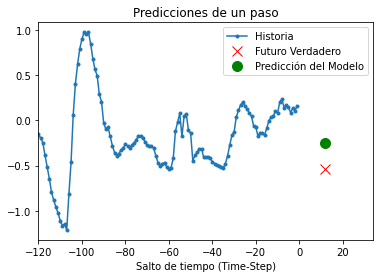

8/8 [==============================] - 0s 21ms/step


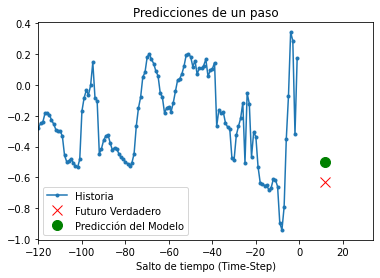

8/8 [==============================] - 0s 26ms/step


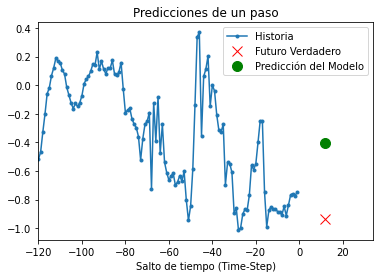

8/8 [==============================] - 0s 23ms/step


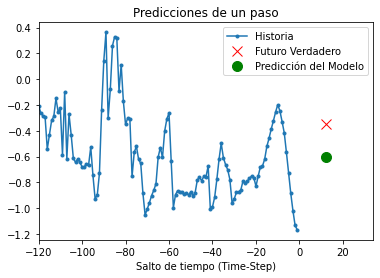

8/8 [==============================] - 0s 20ms/step


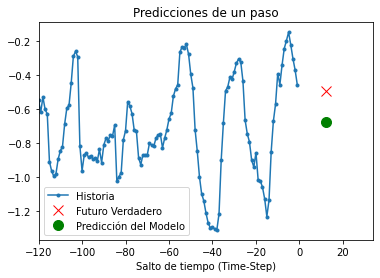

8/8 [==============================] - 0s 22ms/step


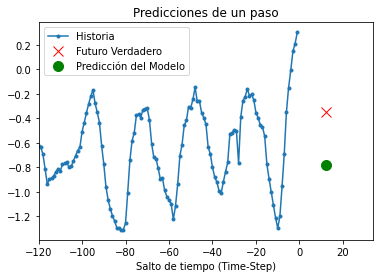

8/8 [==============================] - 0s 21ms/step


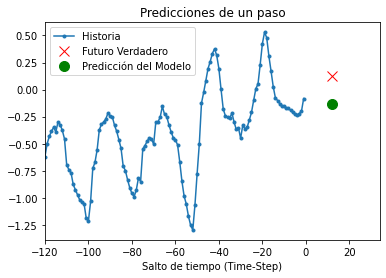

8/8 [==============================] - 0s 28ms/step


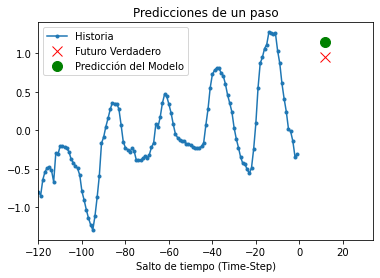

8/8 [==============================] - 0s 23ms/step


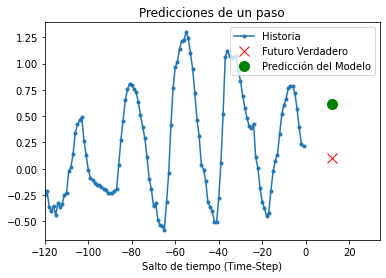

8/8 [==============================] - 0s 26ms/step


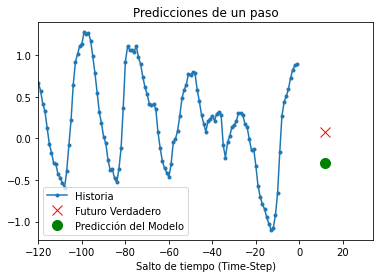

8/8 [==============================] - 0s 34ms/step


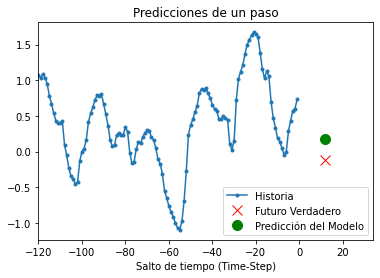

8/8 [==============================] - 0s 23ms/step


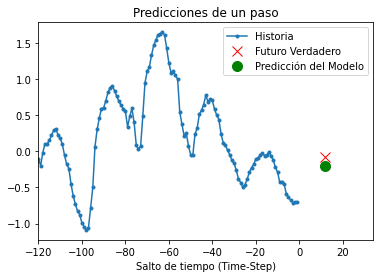

8/8 [==============================] - 0s 39ms/step


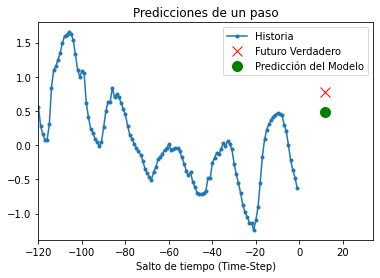

8/8 [==============================] - 0s 23ms/step


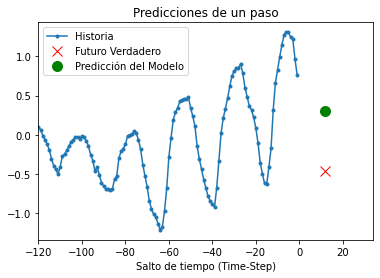

8/8 [==============================] - 0s 21ms/step


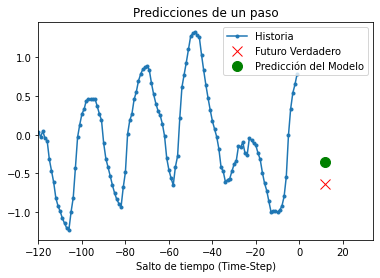

8/8 [==============================] - 0s 24ms/step


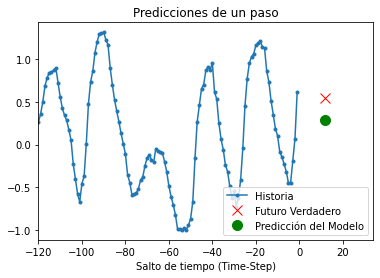

8/8 [==============================] - 0s 23ms/step


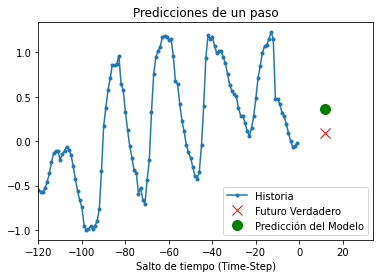

8/8 [==============================] - 0s 20ms/step


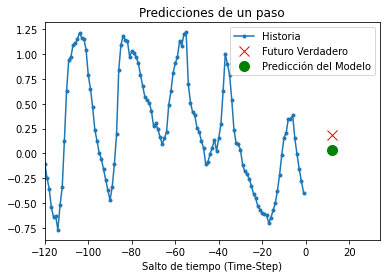

8/8 [==============================] - 0s 27ms/step


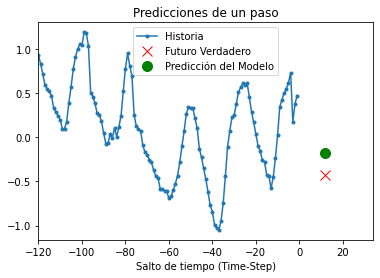

8/8 [==============================] - 0s 20ms/step


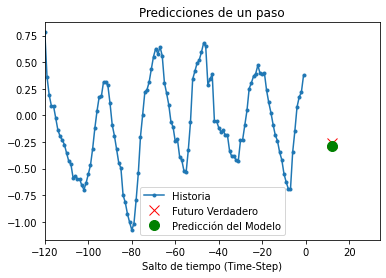

8/8 [==============================] - 0s 23ms/step


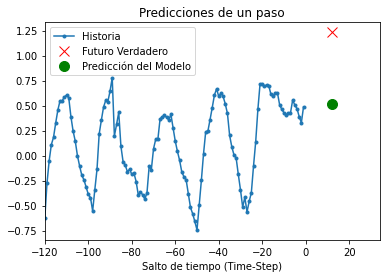

8/8 [==============================] - 0s 22ms/step


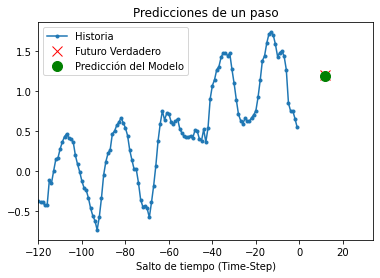

8/8 [==============================] - 0s 21ms/step


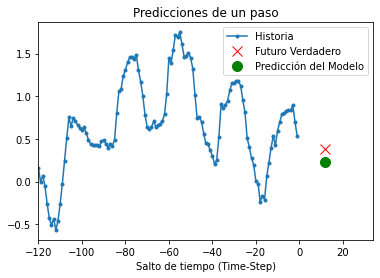

8/8 [==============================] - 0s 31ms/step


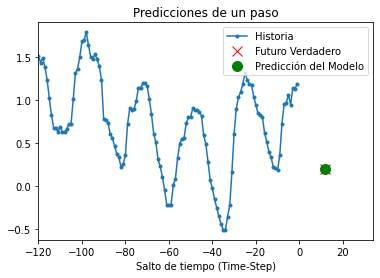

8/8 [==============================] - 0s 21ms/step


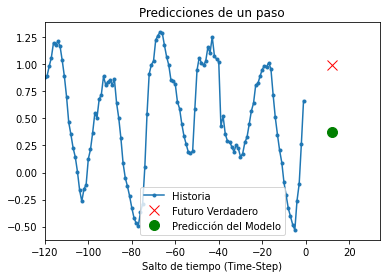

8/8 [==============================] - 0s 24ms/step


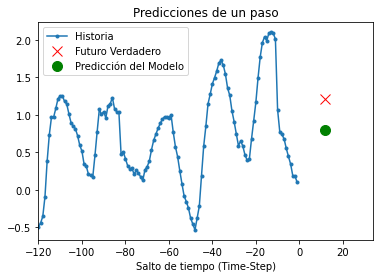

8/8 [==============================] - 0s 20ms/step


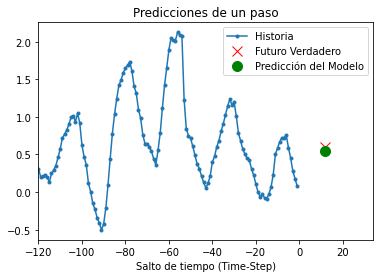

8/8 [==============================] - 0s 19ms/step


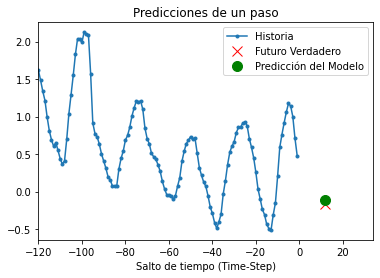

8/8 [==============================] - 0s 30ms/step


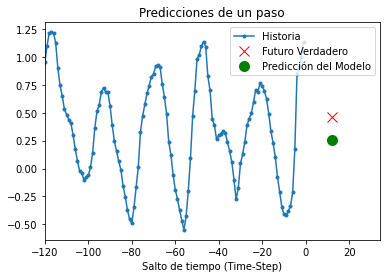

8/8 [==============================] - 0s 24ms/step


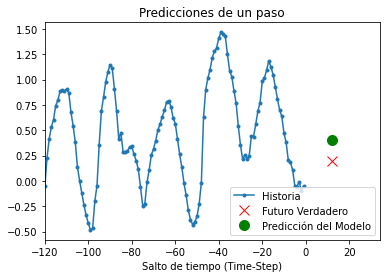

8/8 [==============================] - 0s 21ms/step


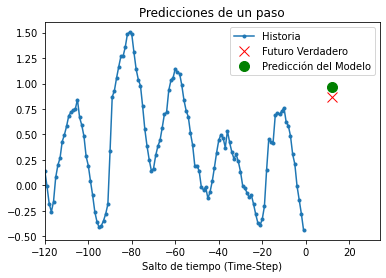

8/8 [==============================] - 0s 21ms/step


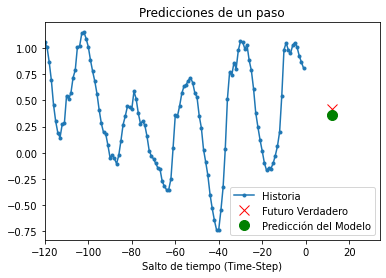

8/8 [==============================] - 0s 35ms/step


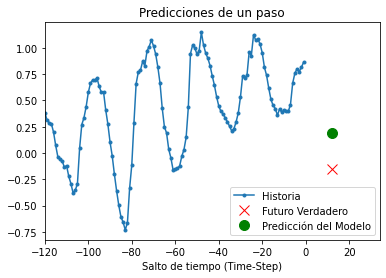

8/8 [==============================] - 0s 25ms/step


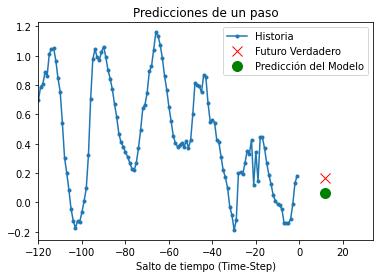

8/8 [==============================] - 0s 26ms/step


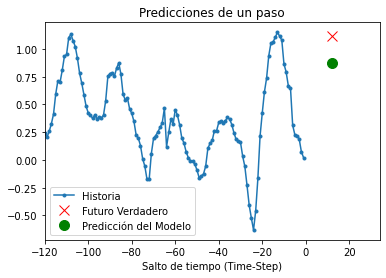

8/8 [==============================] - 0s 21ms/step


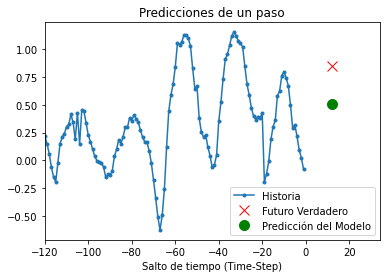

8/8 [==============================] - 0s 21ms/step


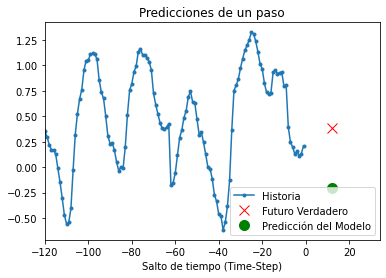

8/8 [==============================] - 0s 27ms/step


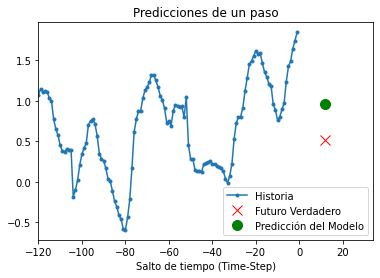

8/8 [==============================] - 0s 18ms/step


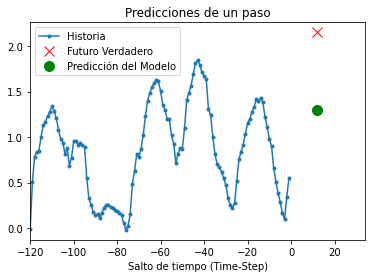

8/8 [==============================] - 0s 21ms/step


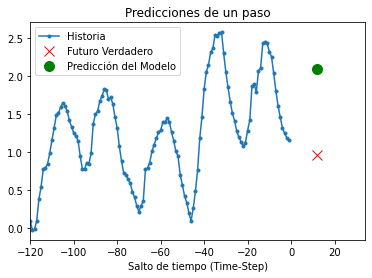

8/8 [==============================] - 0s 21ms/step


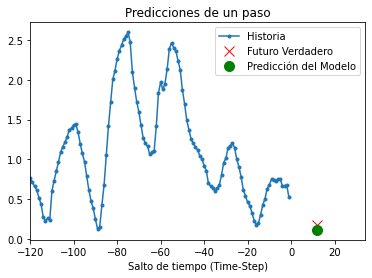

8/8 [==============================] - 0s 22ms/step


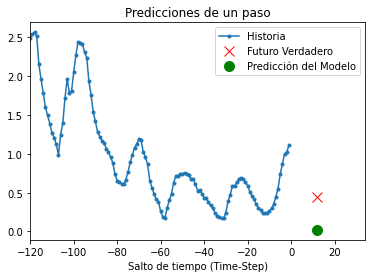

8/8 [==============================] - 0s 26ms/step


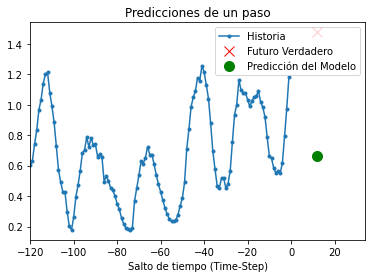

8/8 [==============================] - 0s 24ms/step


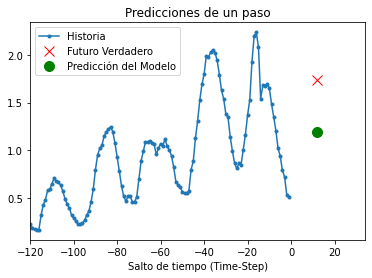

8/8 [==============================] - 0s 25ms/step


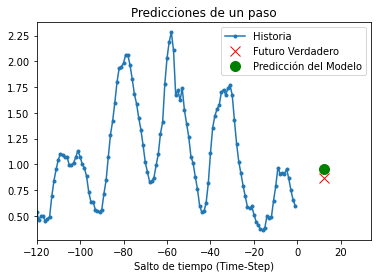

8/8 [==============================] - 0s 24ms/step


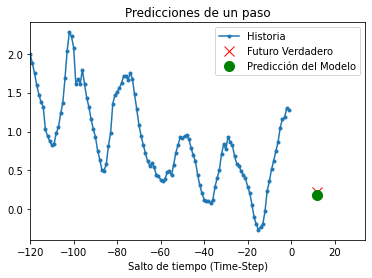

8/8 [==============================] - 0s 19ms/step


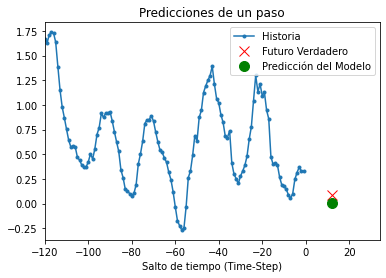

8/8 [==============================] - 0s 18ms/step


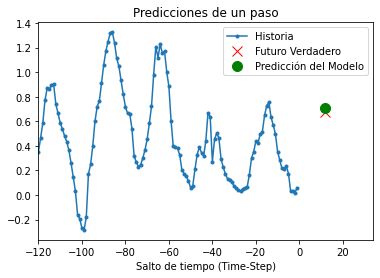

8/8 [==============================] - 0s 23ms/step


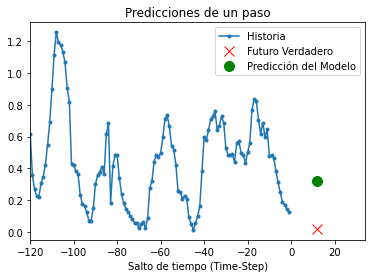

8/8 [==============================] - 0s 22ms/step


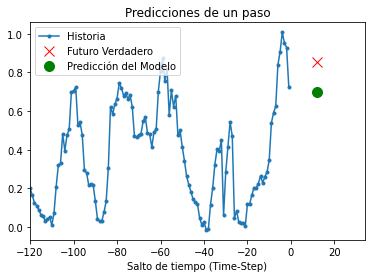

8/8 [==============================] - 0s 23ms/step


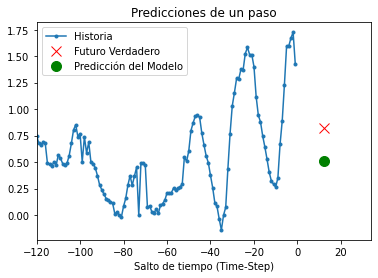

8/8 [==============================] - 0s 25ms/step


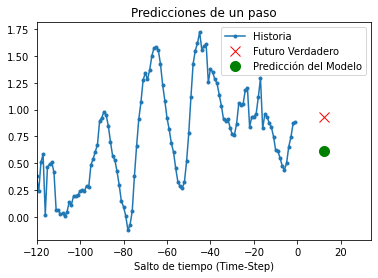

8/8 [==============================] - 0s 30ms/step


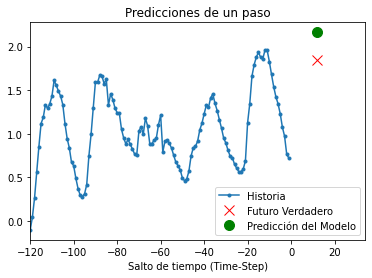

8/8 [==============================] - 0s 18ms/step


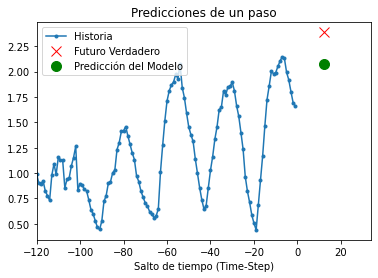

8/8 [==============================] - 0s 23ms/step


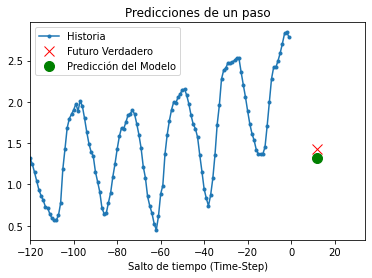

8/8 [==============================] - 0s 22ms/step


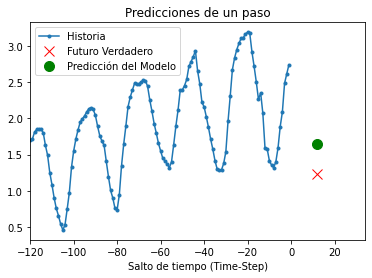

8/8 [==============================] - 0s 23ms/step


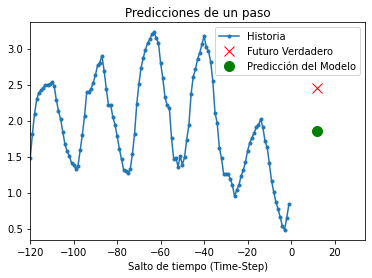

8/8 [==============================] - 0s 23ms/step


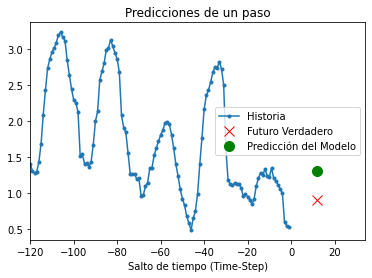

8/8 [==============================] - 0s 19ms/step


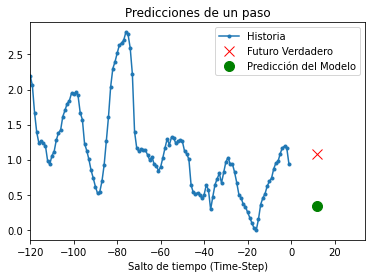

8/8 [==============================] - 0s 21ms/step


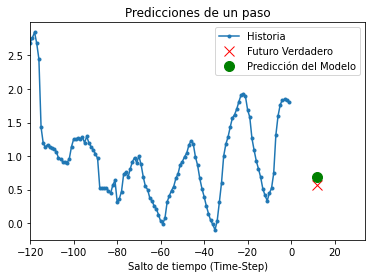

8/8 [==============================] - 0s 25ms/step


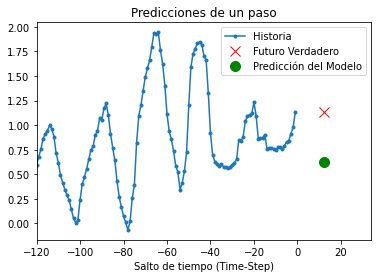

8/8 [==============================] - 0s 23ms/step


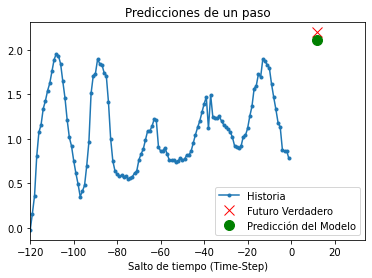

8/8 [==============================] - 0s 20ms/step


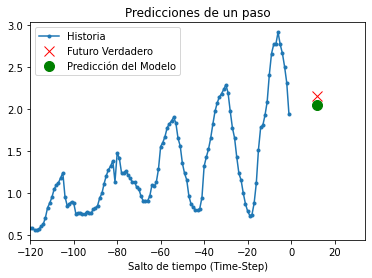

8/8 [==============================] - 0s 20ms/step


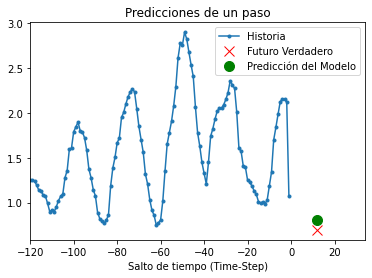

8/8 [==============================] - 0s 20ms/step


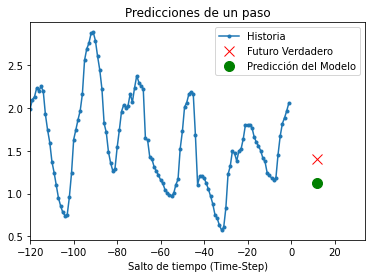

8/8 [==============================] - 0s 20ms/step


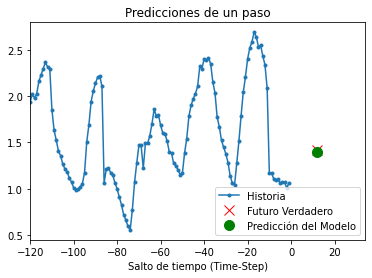

8/8 [==============================] - 0s 21ms/step


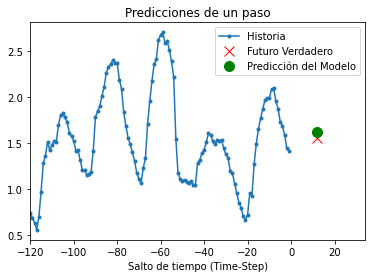

8/8 [==============================] - 0s 19ms/step


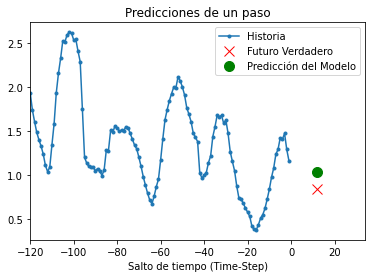

8/8 [==============================] - 0s 20ms/step


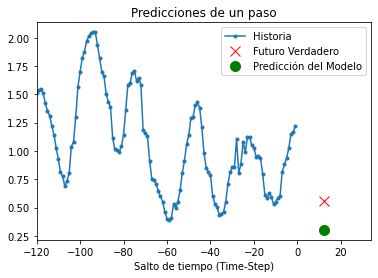

8/8 [==============================] - 0s 20ms/step


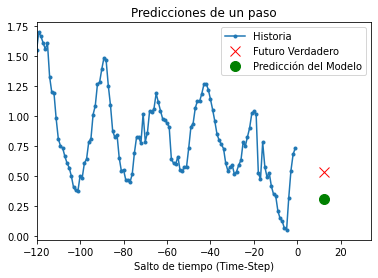

8/8 [==============================] - 0s 22ms/step


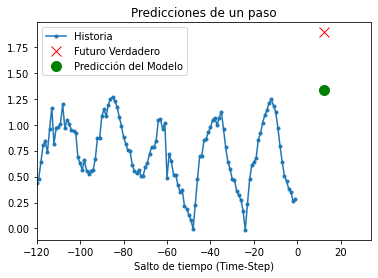

8/8 [==============================] - 0s 21ms/step


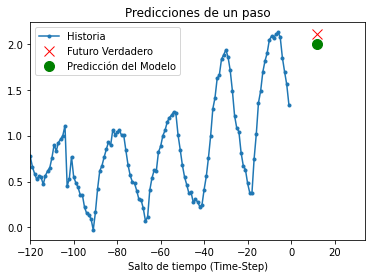

8/8 [==============================] - 0s 17ms/step


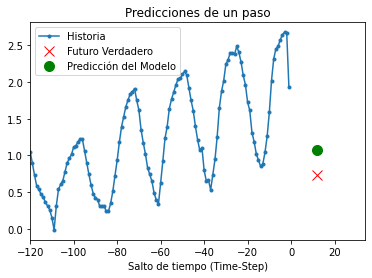

8/8 [==============================] - 0s 20ms/step


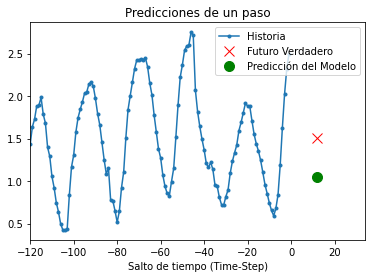

8/8 [==============================] - 0s 29ms/step


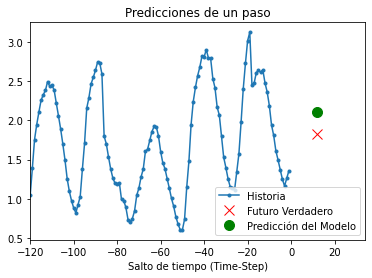

8/8 [==============================] - 0s 22ms/step


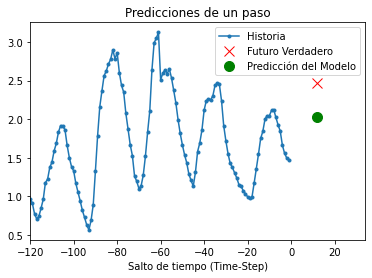

8/8 [==============================] - 0s 31ms/step


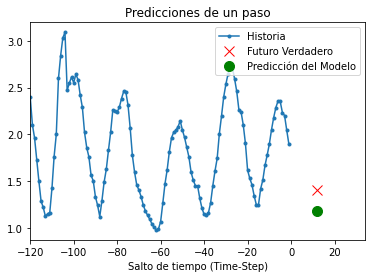

8/8 [==============================] - 0s 29ms/step


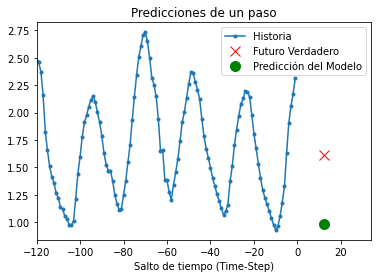

8/8 [==============================] - 0s 22ms/step


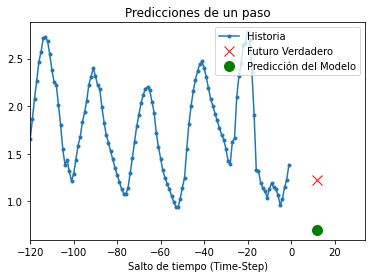

8/8 [==============================] - 0s 23ms/step


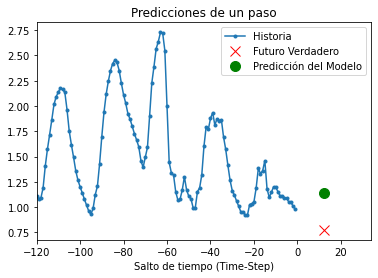

8/8 [==============================] - 0s 20ms/step


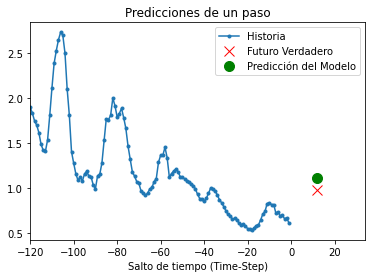

8/8 [==============================] - 0s 22ms/step


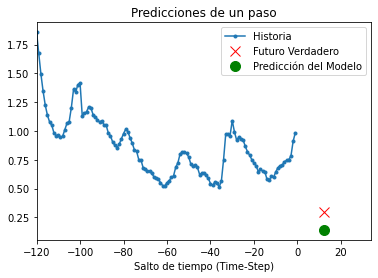

8/8 [==============================] - 0s 18ms/step


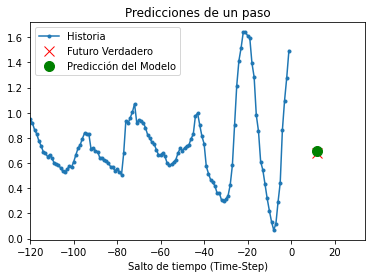

8/8 [==============================] - 0s 25ms/step


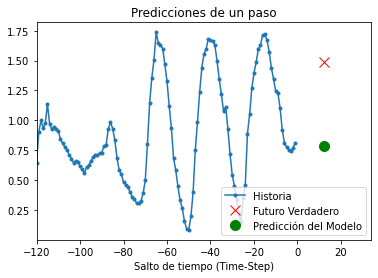

8/8 [==============================] - 0s 20ms/step


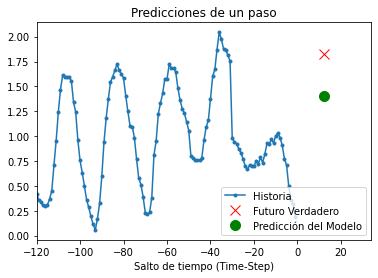

8/8 [==============================] - 0s 29ms/step


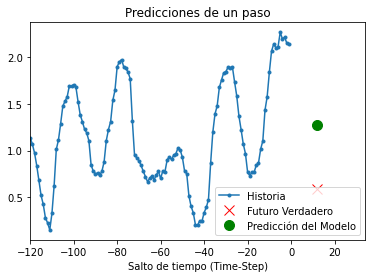

8/8 [==============================] - 0s 21ms/step


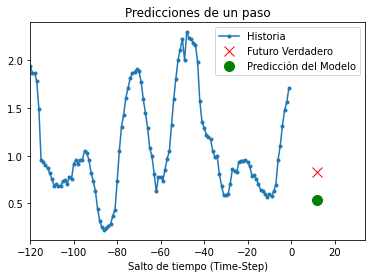

8/8 [==============================] - 0s 25ms/step


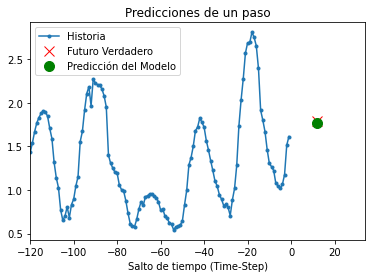

8/8 [==============================] - 0s 21ms/step


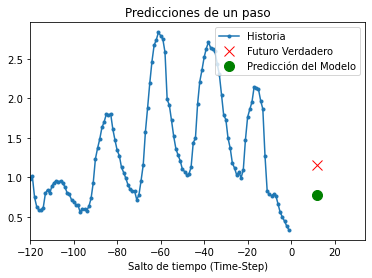

8/8 [==============================] - 0s 23ms/step


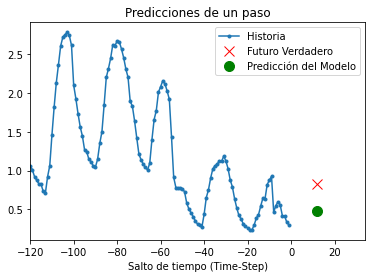

8/8 [==============================] - 0s 25ms/step


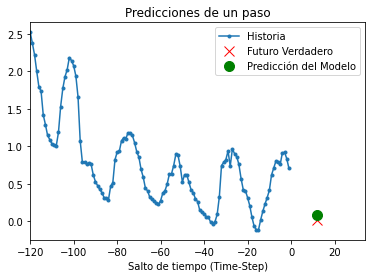

8/8 [==============================] - 0s 26ms/step


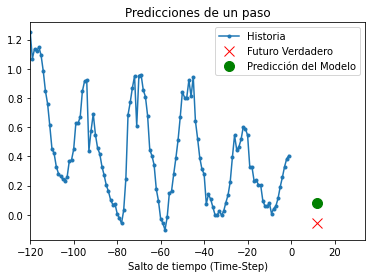

8/8 [==============================] - 0s 24ms/step


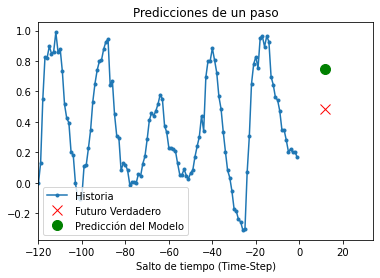

8/8 [==============================] - 0s 21ms/step


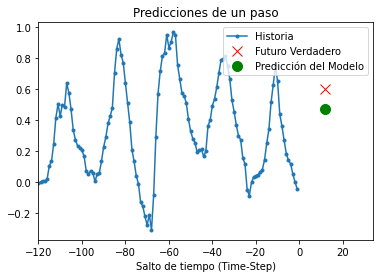

8/8 [==============================] - 0s 25ms/step


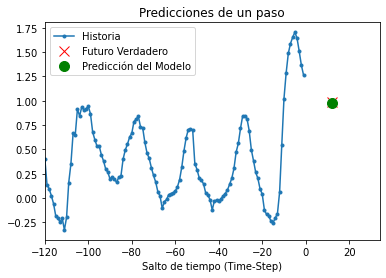

8/8 [==============================] - 0s 21ms/step


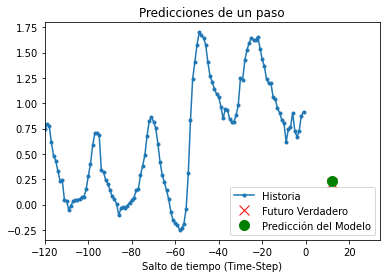

8/8 [==============================] - 0s 19ms/step


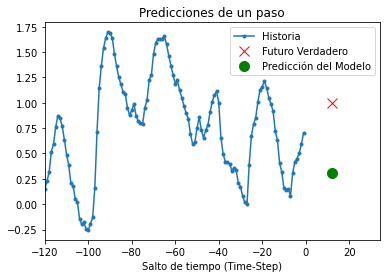

8/8 [==============================] - 0s 26ms/step


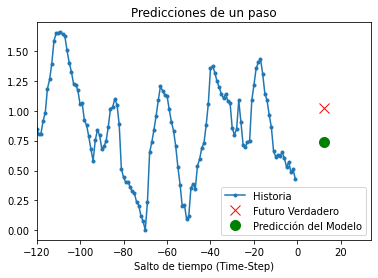

8/8 [==============================] - 0s 24ms/step


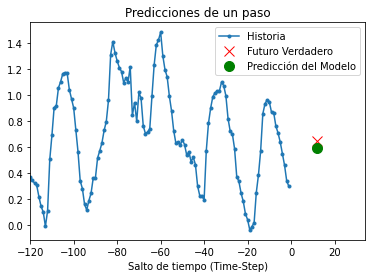

8/8 [==============================] - 0s 22ms/step


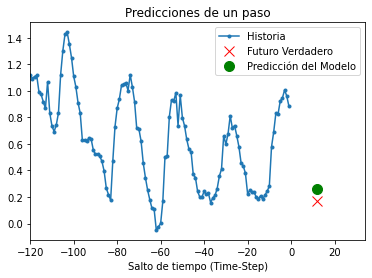

8/8 [==============================] - 0s 22ms/step


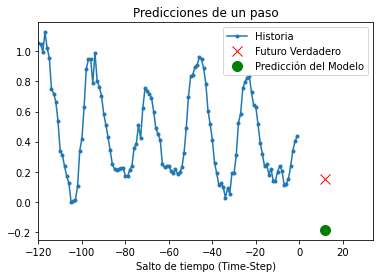

8/8 [==============================] - 0s 18ms/step


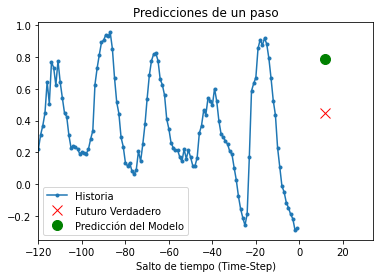

8/8 [==============================] - 0s 24ms/step


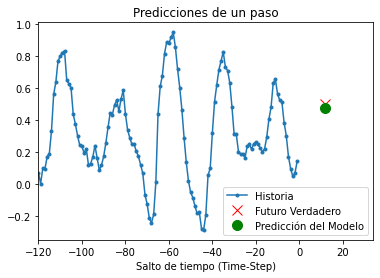

8/8 [==============================] - 0s 18ms/step


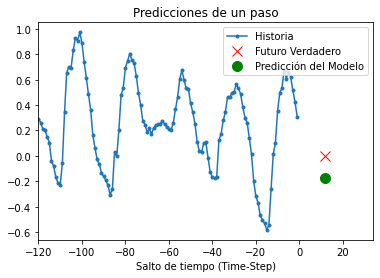

8/8 [==============================] - 0s 22ms/step


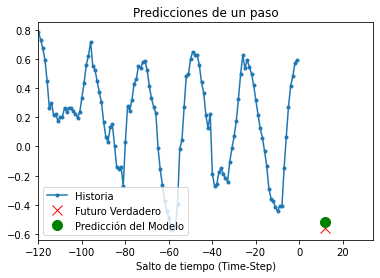

8/8 [==============================] - 0s 18ms/step


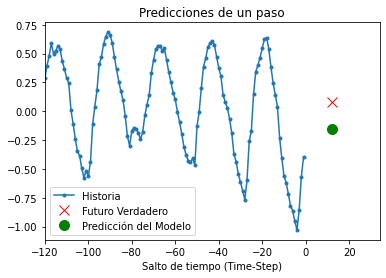

8/8 [==============================] - 0s 20ms/step


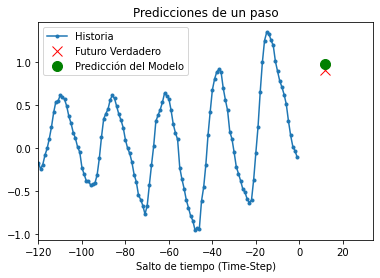

8/8 [==============================] - 0s 20ms/step


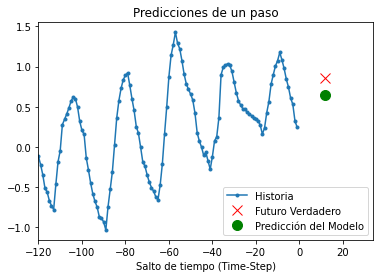

8/8 [==============================] - 0s 17ms/step


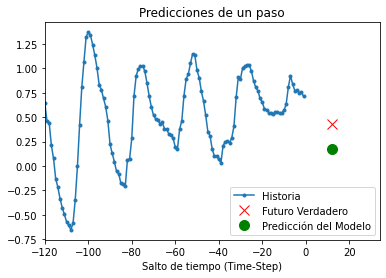

8/8 [==============================] - 0s 20ms/step


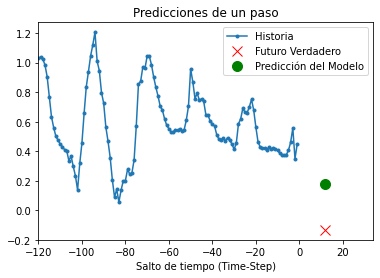

8/8 [==============================] - 0s 18ms/step


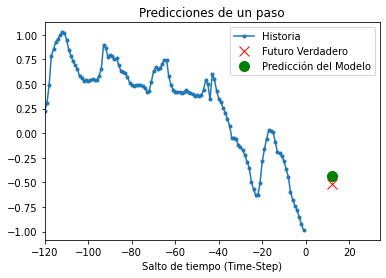

8/8 [==============================] - 0s 20ms/step


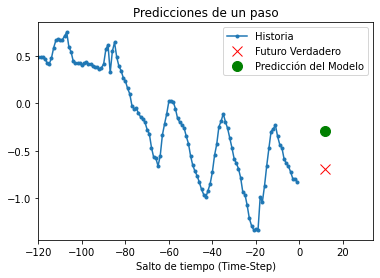

8/8 [==============================] - 0s 22ms/step


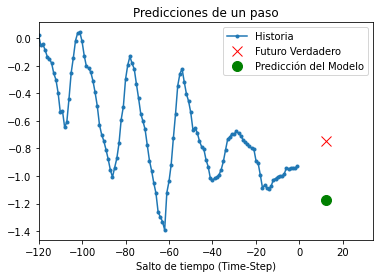

8/8 [==============================] - 0s 20ms/step


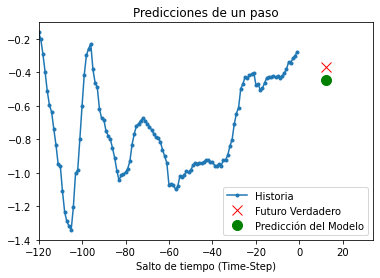

8/8 [==============================] - 0s 25ms/step


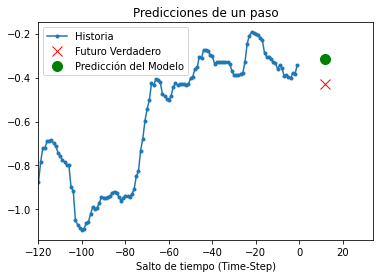

8/8 [==============================] - 0s 20ms/step


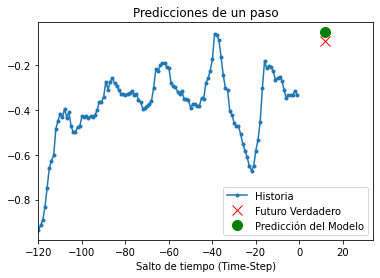

8/8 [==============================] - 0s 26ms/step


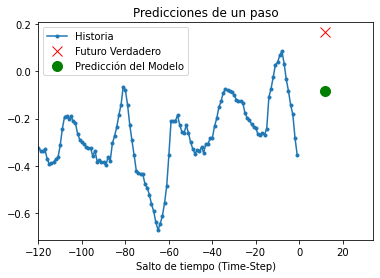

8/8 [==============================] - 0s 23ms/step


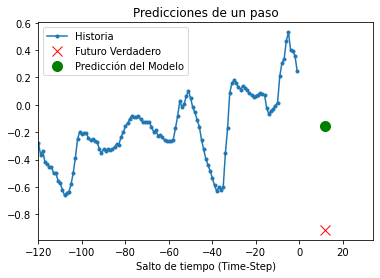

8/8 [==============================] - 0s 24ms/step


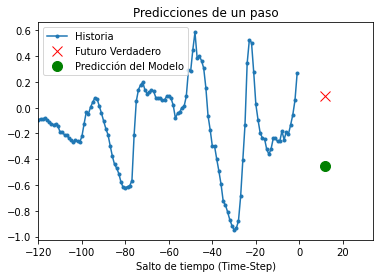

8/8 [==============================] - 0s 23ms/step


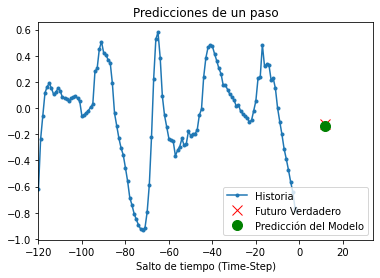

8/8 [==============================] - 0s 25ms/step


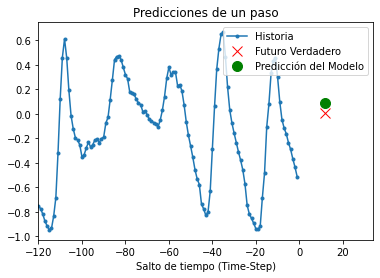

8/8 [==============================] - 0s 20ms/step


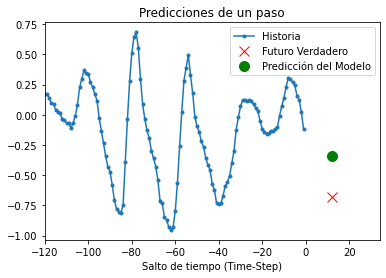

8/8 [==============================] - 0s 22ms/step


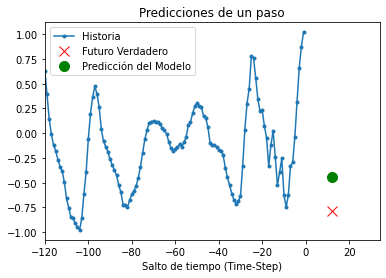

8/8 [==============================] - 0s 21ms/step


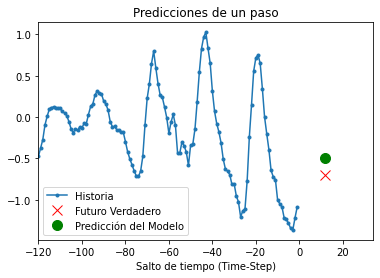

8/8 [==============================] - 0s 22ms/step


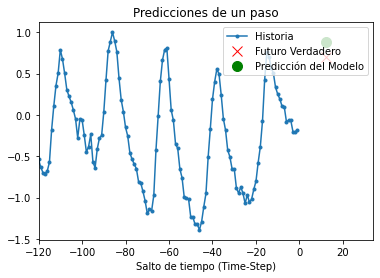

8/8 [==============================] - 0s 28ms/step


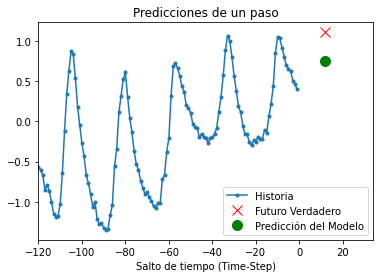

8/8 [==============================] - 0s 25ms/step


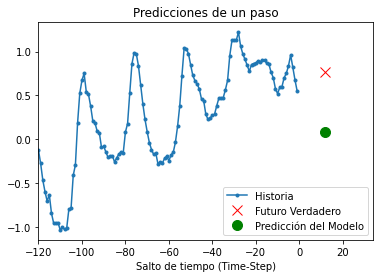

8/8 [==============================] - 0s 21ms/step


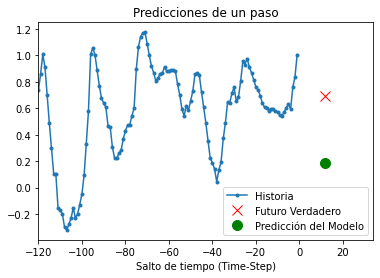

8/8 [==============================] - 0s 25ms/step


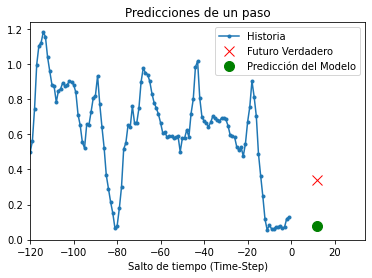

8/8 [==============================] - 0s 20ms/step


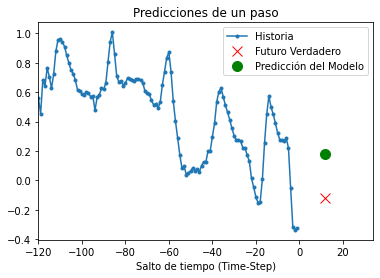

8/8 [==============================] - 0s 24ms/step


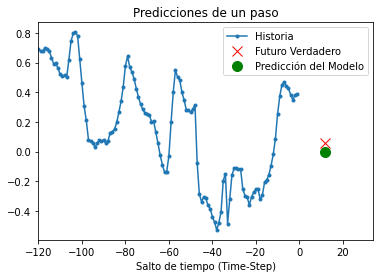

8/8 [==============================] - 0s 24ms/step


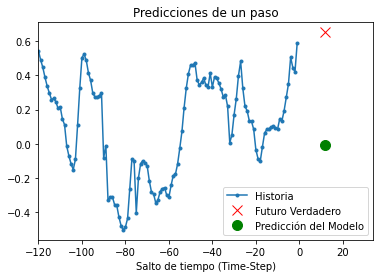

8/8 [==============================] - 0s 25ms/step


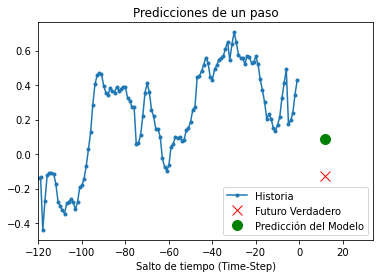

8/8 [==============================] - 0s 20ms/step


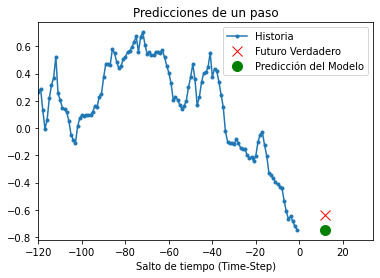

8/8 [==============================] - 0s 18ms/step


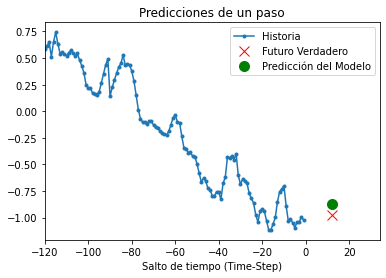

8/8 [==============================] - 0s 27ms/step


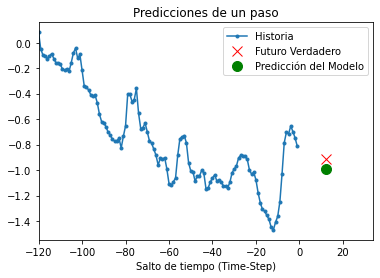

8/8 [==============================] - 0s 22ms/step


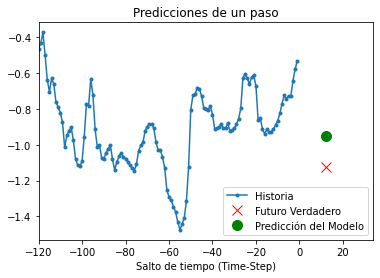

8/8 [==============================] - 0s 27ms/step


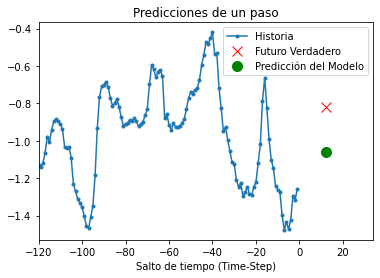

8/8 [==============================] - 0s 19ms/step


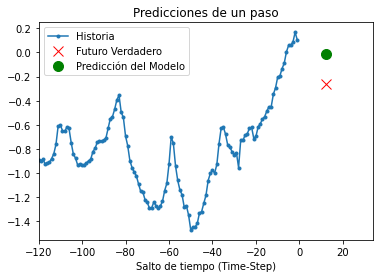

8/8 [==============================] - 0s 18ms/step


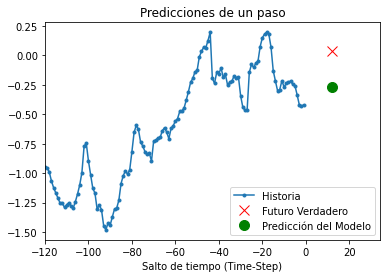

8/8 [==============================] - 0s 20ms/step


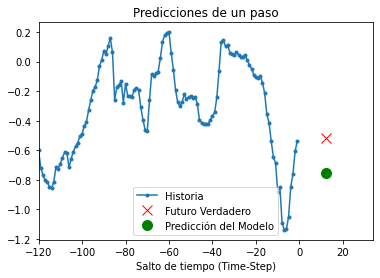

8/8 [==============================] - 0s 18ms/step


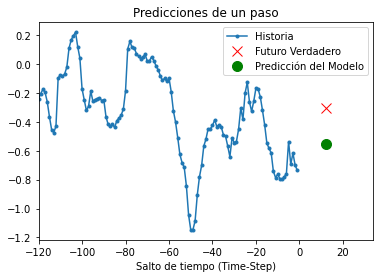

8/8 [==============================] - 0s 36ms/step


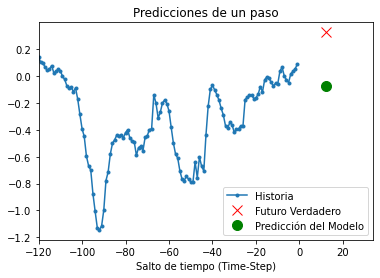

8/8 [==============================] - 0s 29ms/step


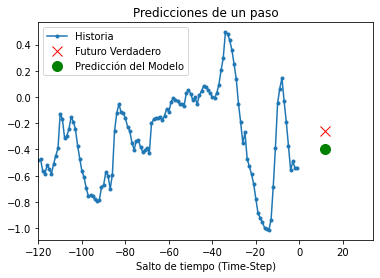

8/8 [==============================] - 0s 25ms/step


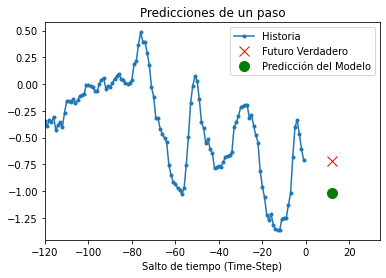

8/8 [==============================] - 0s 27ms/step


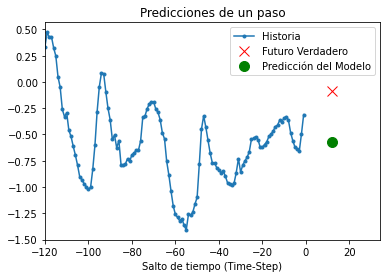

8/8 [==============================] - 0s 25ms/step


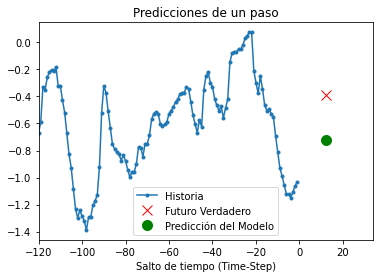

8/8 [==============================] - 0s 25ms/step


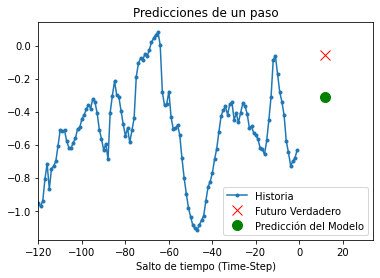

8/8 [==============================] - 0s 28ms/step


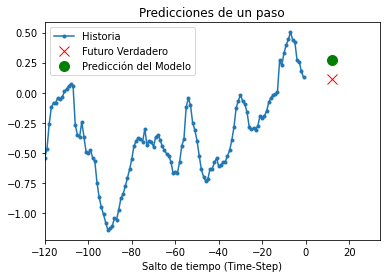

8/8 [==============================] - 0s 32ms/step


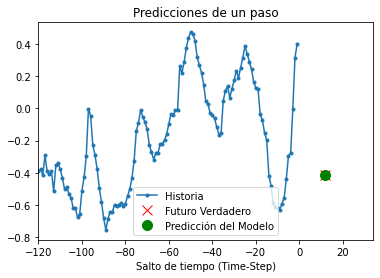

8/8 [==============================] - 0s 30ms/step


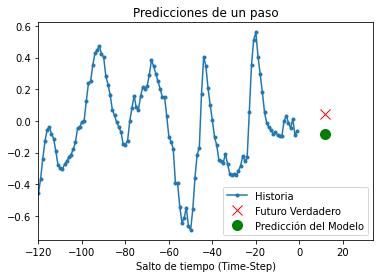

8/8 [==============================] - 0s 23ms/step


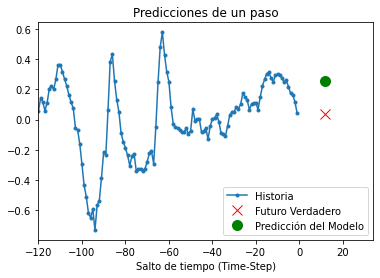

8/8 [==============================] - 0s 20ms/step


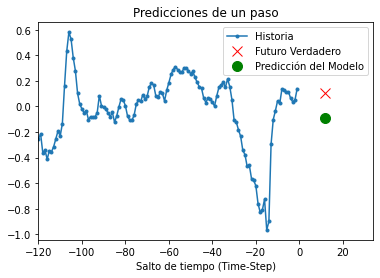

8/8 [==============================] - 0s 21ms/step


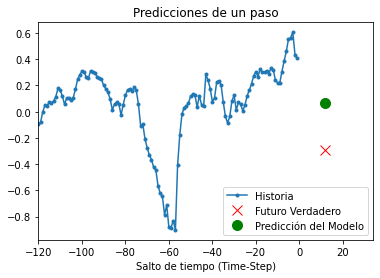

8/8 [==============================] - 0s 31ms/step


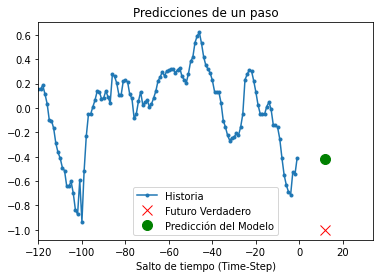

8/8 [==============================] - 0s 22ms/step


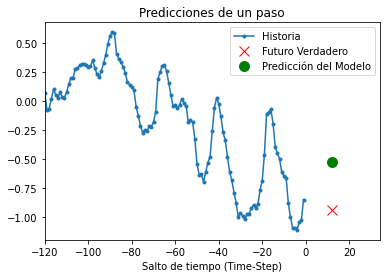

8/8 [==============================] - 0s 26ms/step


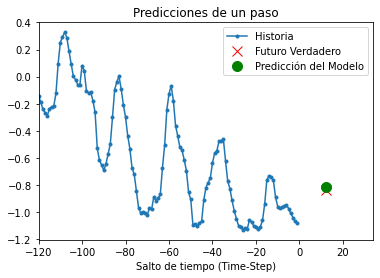

8/8 [==============================] - 0s 23ms/step


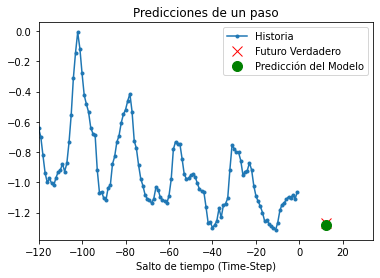

8/8 [==============================] - 0s 27ms/step


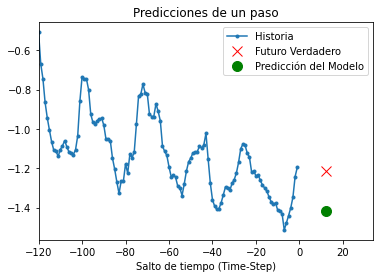

8/8 [==============================] - 0s 30ms/step


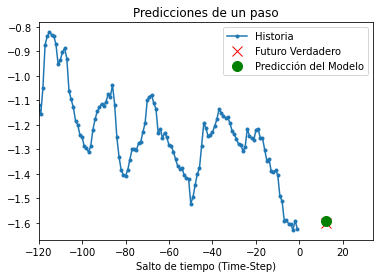

8/8 [==============================] - 0s 24ms/step


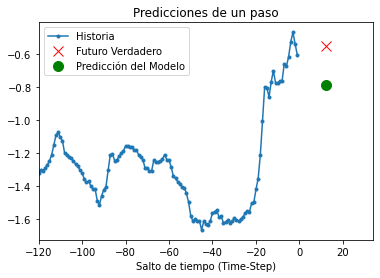

8/8 [==============================] - 0s 21ms/step


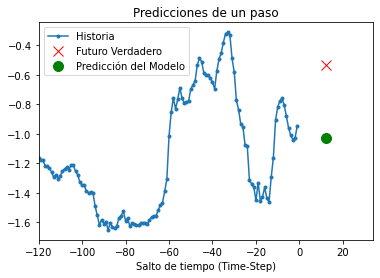

8/8 [==============================] - 0s 24ms/step


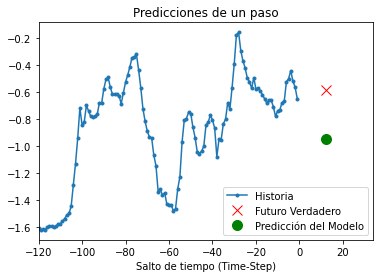

8/8 [==============================] - 0s 25ms/step


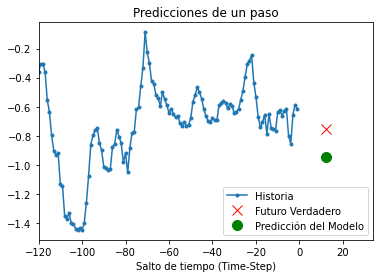

8/8 [==============================] - 0s 31ms/step


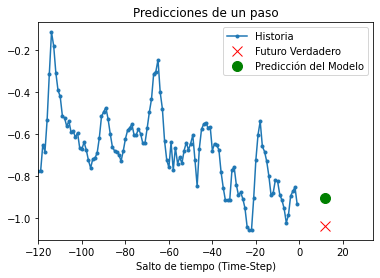

8/8 [==============================] - 0s 27ms/step


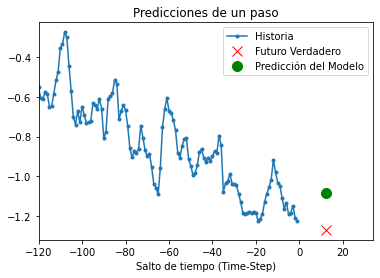

8/8 [==============================] - 0s 24ms/step


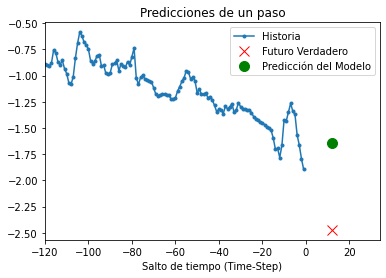

8/8 [==============================] - 0s 23ms/step


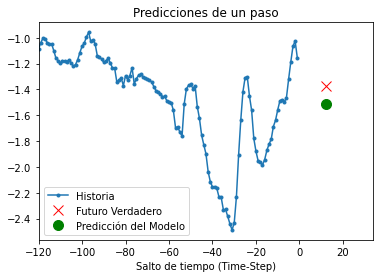

8/8 [==============================] - 0s 28ms/step


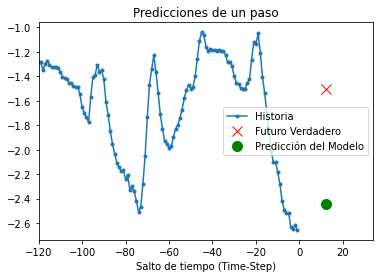

8/8 [==============================] - 0s 22ms/step


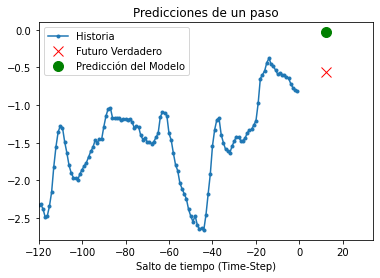

8/8 [==============================] - 0s 25ms/step


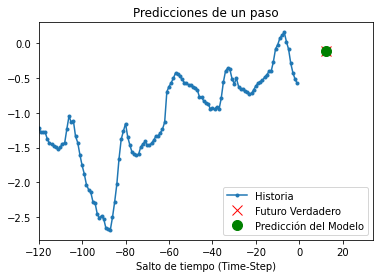

8/8 [==============================] - 0s 23ms/step


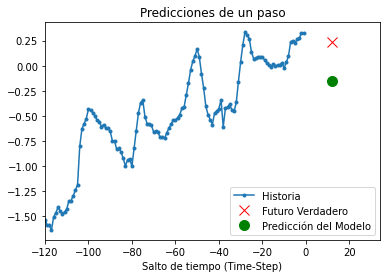

8/8 [==============================] - 0s 22ms/step


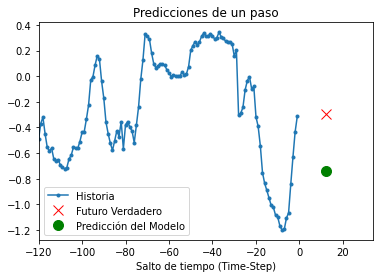

8/8 [==============================] - 0s 24ms/step


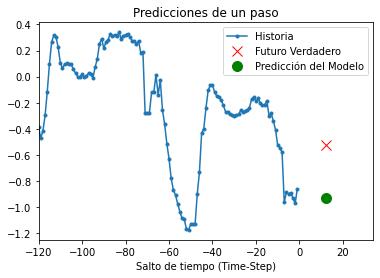

8/8 [==============================] - 0s 25ms/step


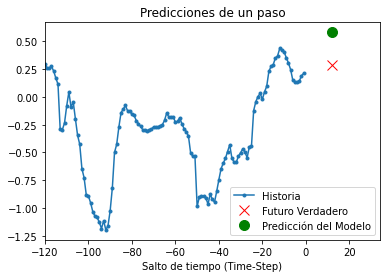

8/8 [==============================] - 0s 19ms/step


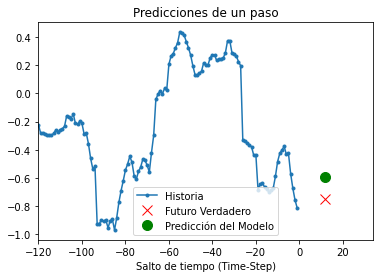

8/8 [==============================] - 0s 31ms/step


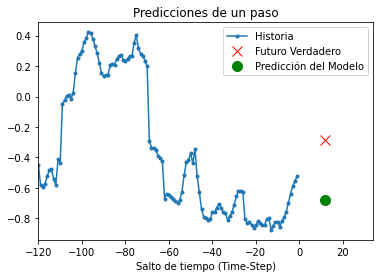

8/8 [==============================] - 0s 22ms/step


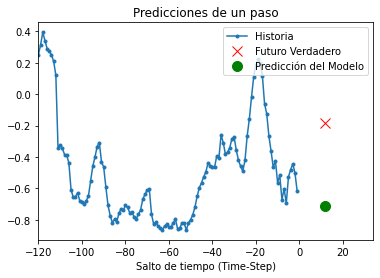

8/8 [==============================] - 0s 23ms/step


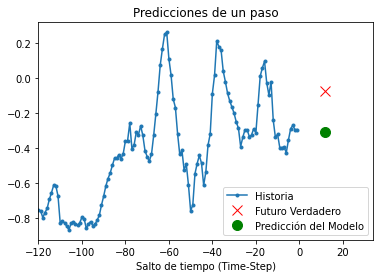

8/8 [==============================] - 0s 26ms/step


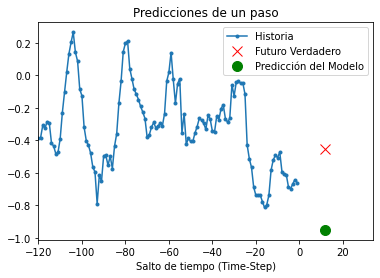

8/8 [==============================] - 0s 25ms/step


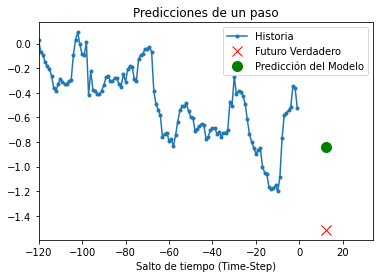

8/8 [==============================] - 0s 24ms/step


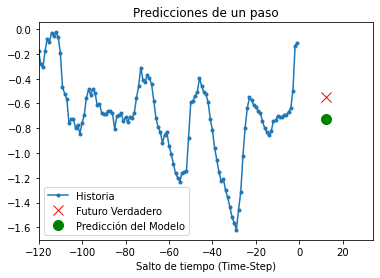

8/8 [==============================] - 0s 26ms/step


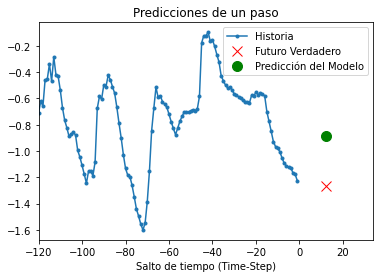

8/8 [==============================] - 0s 24ms/step


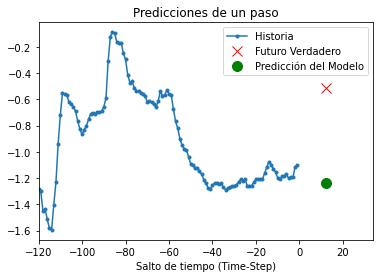

8/8 [==============================] - 0s 27ms/step


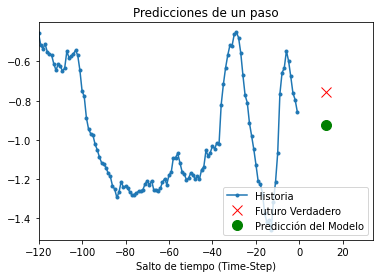

8/8 [==============================] - 0s 30ms/step


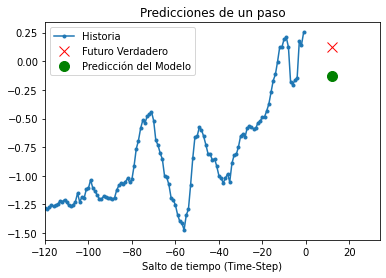

8/8 [==============================] - 0s 26ms/step


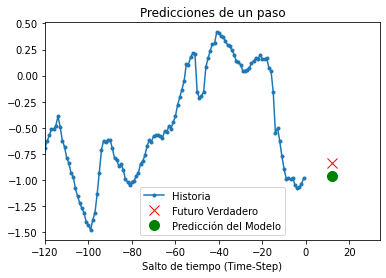

8/8 [==============================] - 0s 24ms/step


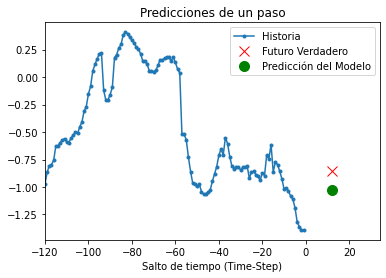

8/8 [==============================] - 0s 24ms/step


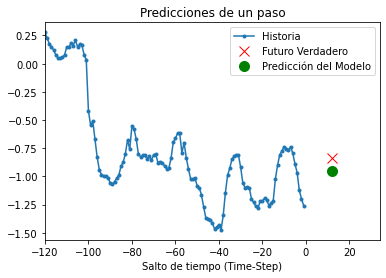

8/8 [==============================] - 0s 23ms/step


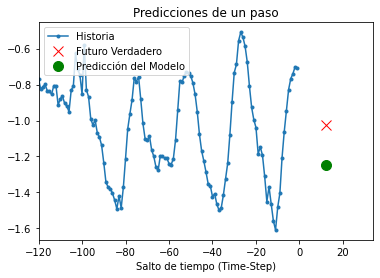

8/8 [==============================] - 0s 28ms/step


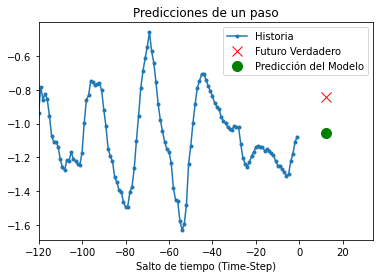

8/8 [==============================] - 0s 24ms/step


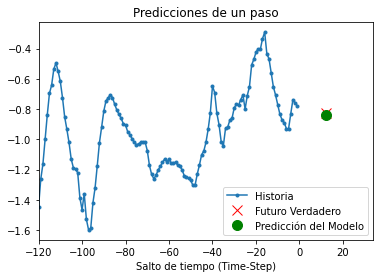

8/8 [==============================] - 0s 29ms/step


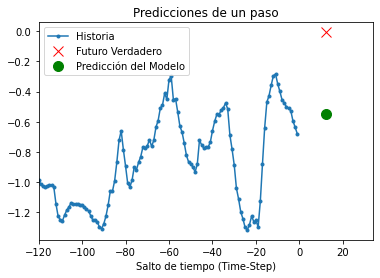

8/8 [==============================] - 0s 26ms/step


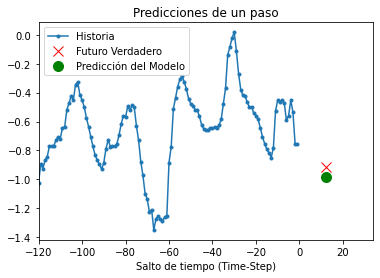

8/8 [==============================] - 0s 23ms/step


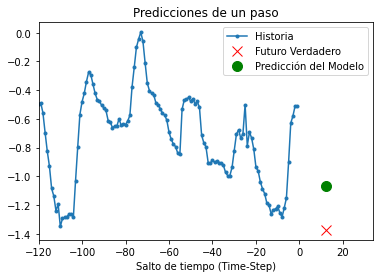

8/8 [==============================] - 0s 25ms/step


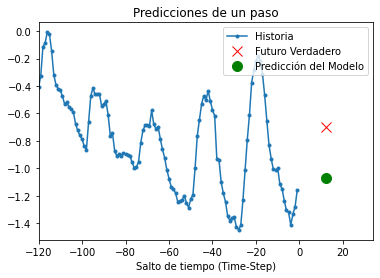

8/8 [==============================] - 0s 21ms/step


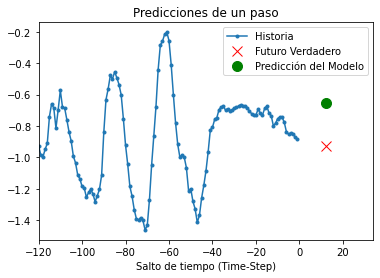

8/8 [==============================] - 0s 30ms/step


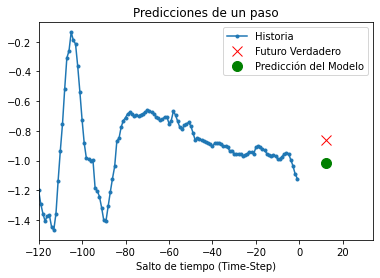

8/8 [==============================] - 0s 25ms/step


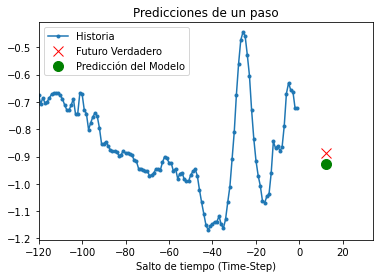

8/8 [==============================] - 0s 25ms/step


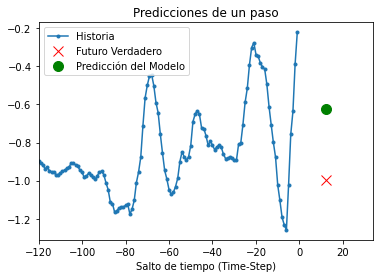

8/8 [==============================] - 0s 23ms/step


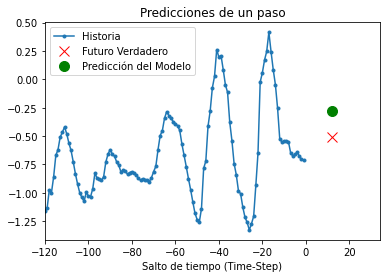

8/8 [==============================] - 0s 23ms/step


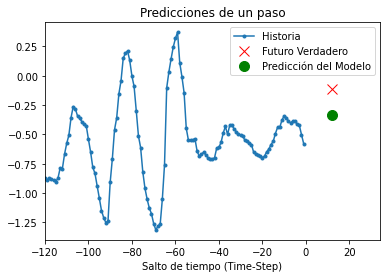

8/8 [==============================] - 0s 22ms/step


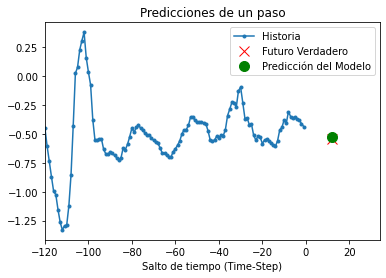

8/8 [==============================] - 0s 23ms/step


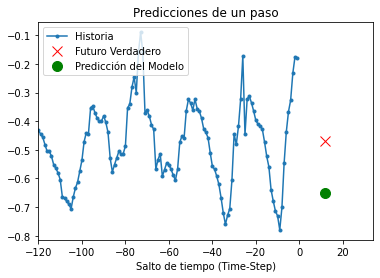

8/8 [==============================] - 0s 26ms/step


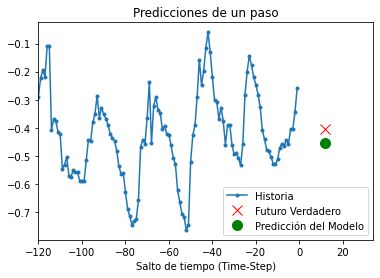

8/8 [==============================] - 0s 23ms/step


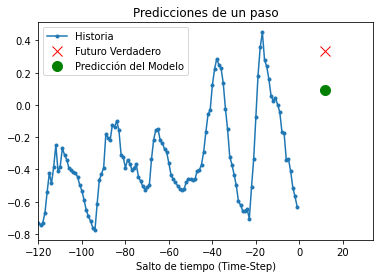

8/8 [==============================] - 0s 21ms/step


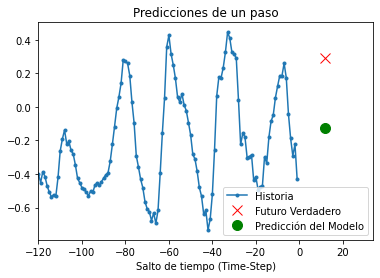

8/8 [==============================] - 0s 22ms/step


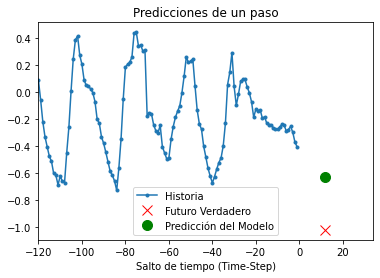

8/8 [==============================] - 0s 22ms/step


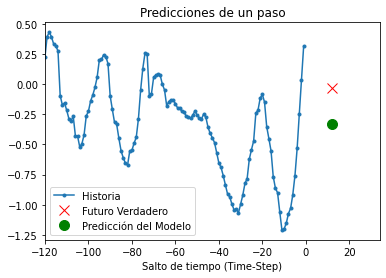

8/8 [==============================] - 0s 29ms/step


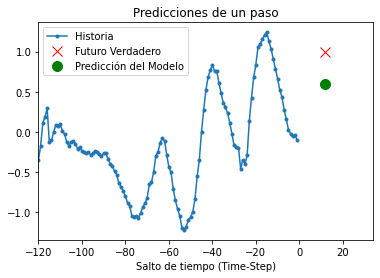

8/8 [==============================] - 0s 23ms/step


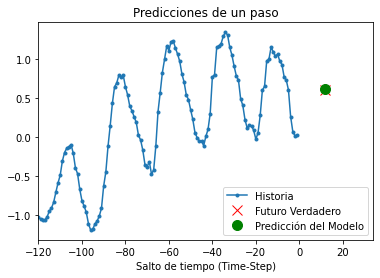

8/8 [==============================] - 0s 22ms/step


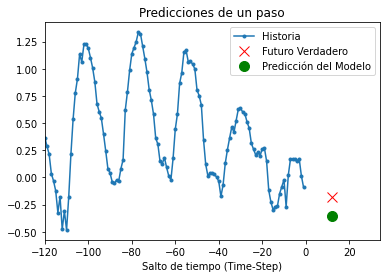

8/8 [==============================] - 0s 25ms/step


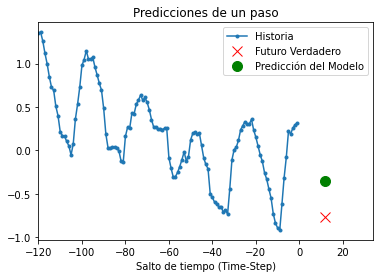

8/8 [==============================] - 0s 24ms/step


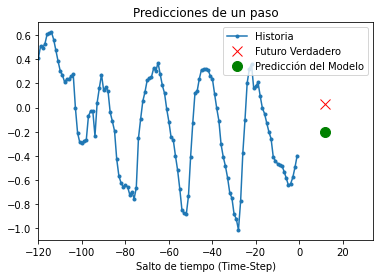

8/8 [==============================] - 0s 25ms/step


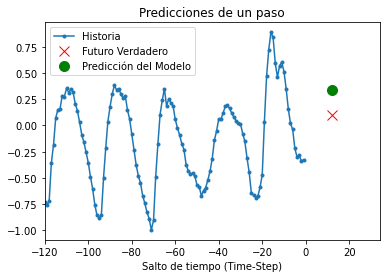

8/8 [==============================] - 0s 32ms/step


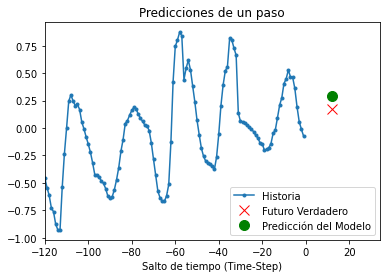

8/8 [==============================] - 0s 26ms/step


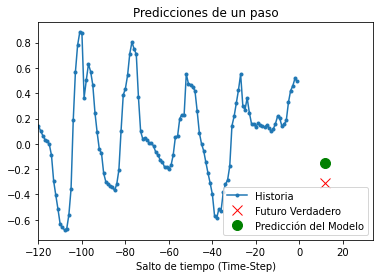

8/8 [==============================] - 0s 34ms/step


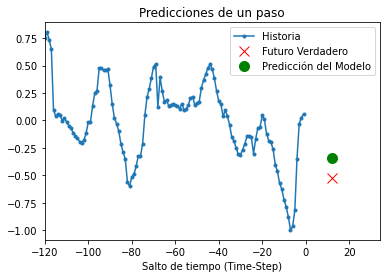

8/8 [==============================] - 0s 26ms/step


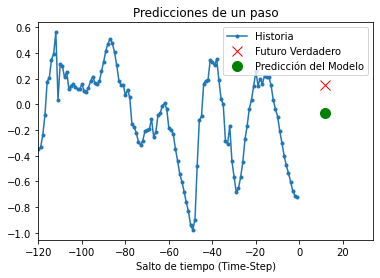

8/8 [==============================] - 0s 20ms/step


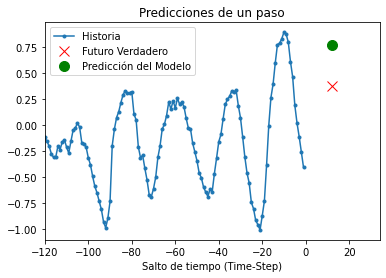

8/8 [==============================] - 0s 22ms/step


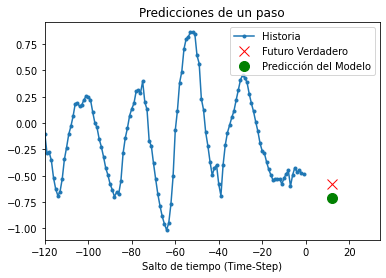

8/8 [==============================] - 0s 18ms/step


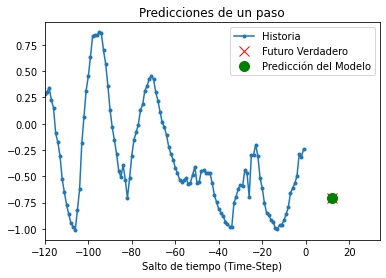

8/8 [==============================] - 0s 29ms/step


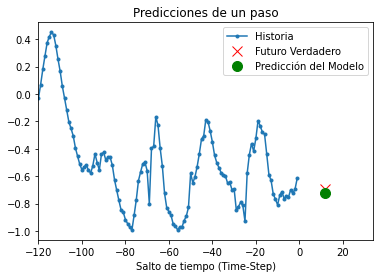

8/8 [==============================] - 0s 21ms/step


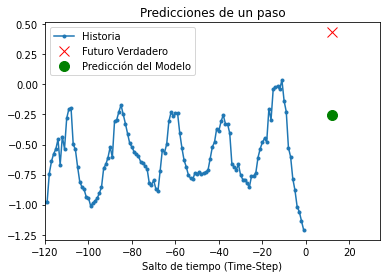

8/8 [==============================] - 0s 33ms/step


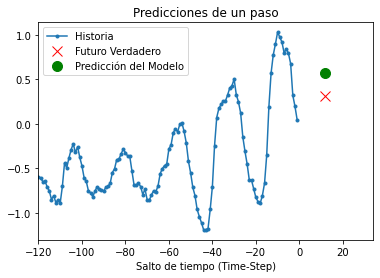

8/8 [==============================] - 0s 25ms/step


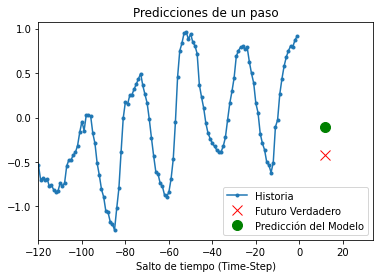

8/8 [==============================] - 0s 22ms/step


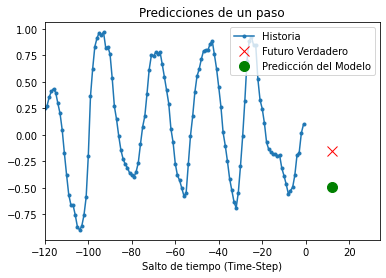

8/8 [==============================] - 0s 19ms/step


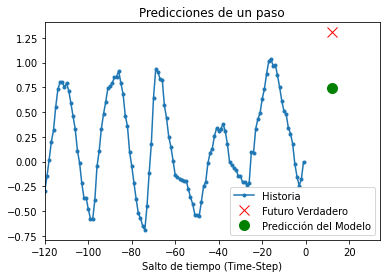

8/8 [==============================] - 0s 26ms/step


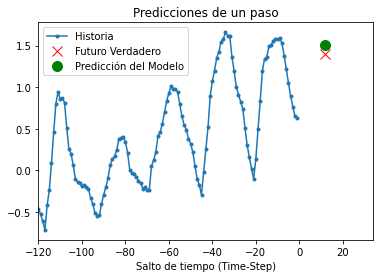

8/8 [==============================] - 0s 21ms/step


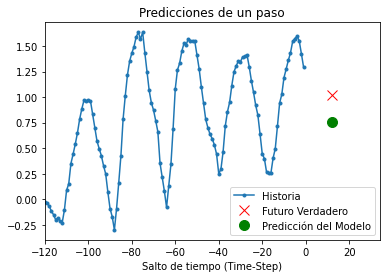

8/8 [==============================] - 0s 22ms/step


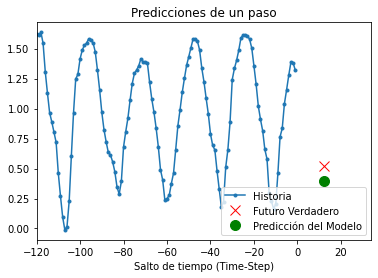

8/8 [==============================] - 0s 25ms/step


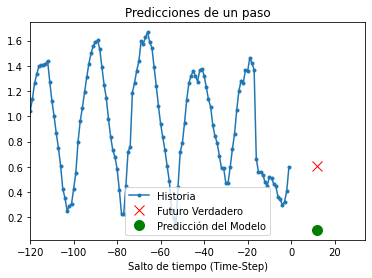

8/8 [==============================] - 0s 21ms/step


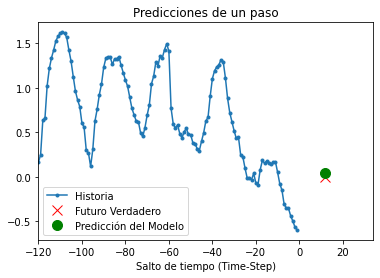

8/8 [==============================] - 0s 21ms/step


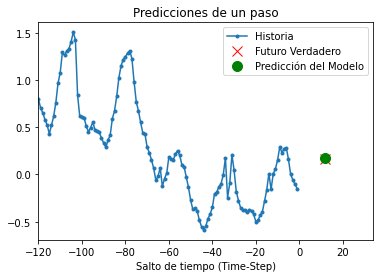

8/8 [==============================] - 0s 19ms/step


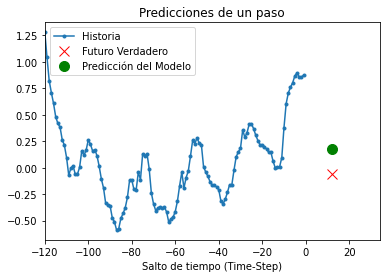

8/8 [==============================] - 0s 21ms/step


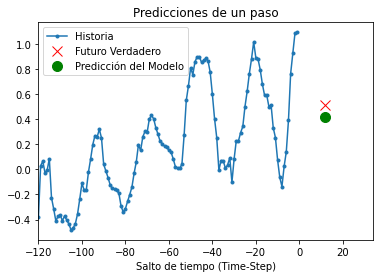

8/8 [==============================] - 0s 19ms/step


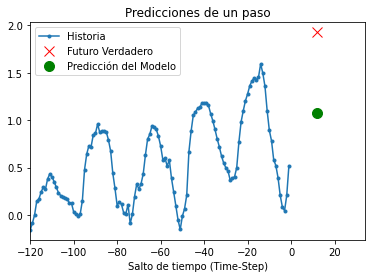

8/8 [==============================] - 0s 21ms/step


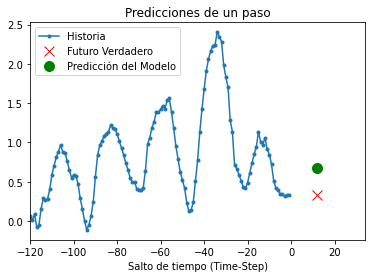

8/8 [==============================] - 0s 22ms/step


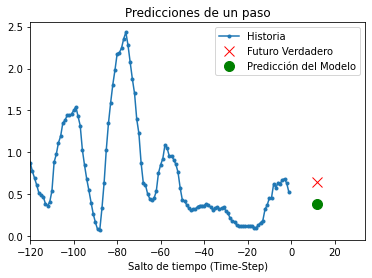

8/8 [==============================] - 0s 26ms/step


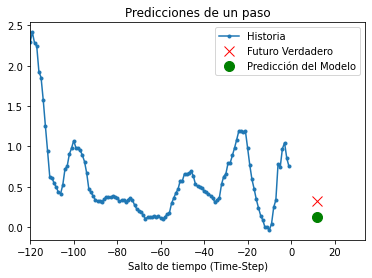

8/8 [==============================] - 0s 27ms/step


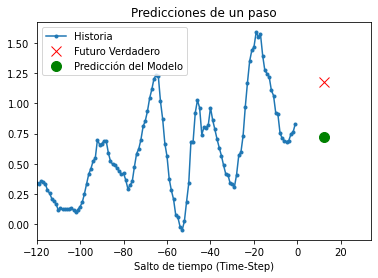

8/8 [==============================] - 0s 30ms/step


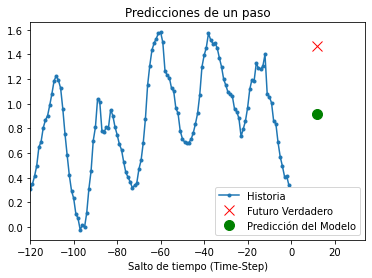

8/8 [==============================] - 0s 22ms/step


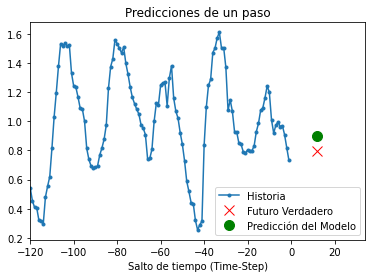

8/8 [==============================] - 0s 23ms/step


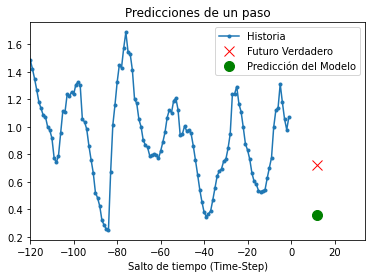

8/8 [==============================] - 0s 29ms/step


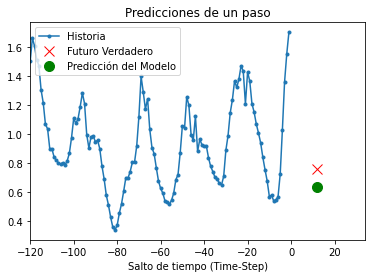

8/8 [==============================] - 0s 22ms/step


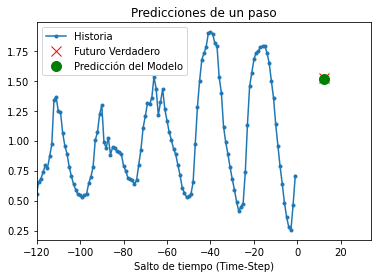

8/8 [==============================] - 0s 22ms/step


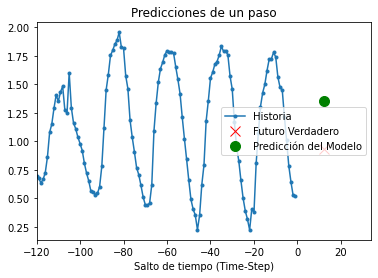

8/8 [==============================] - 0s 22ms/step


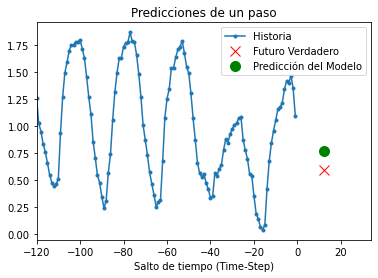

8/8 [==============================] - 0s 23ms/step


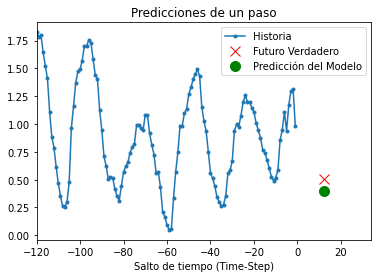

8/8 [==============================] - 0s 29ms/step


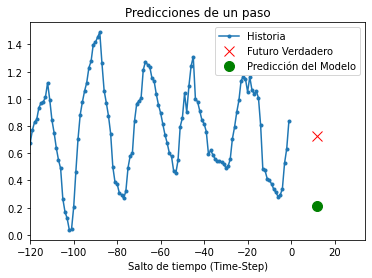

8/8 [==============================] - 0s 25ms/step


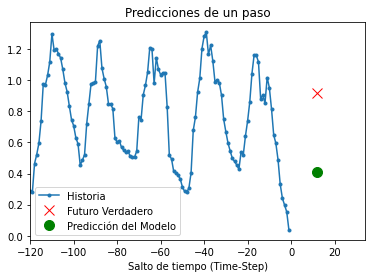

8/8 [==============================] - 0s 20ms/step


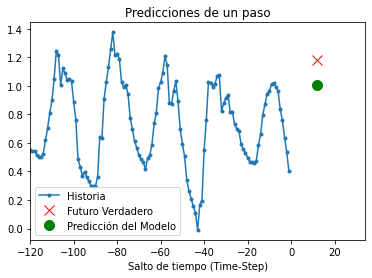

8/8 [==============================] - 0s 35ms/step


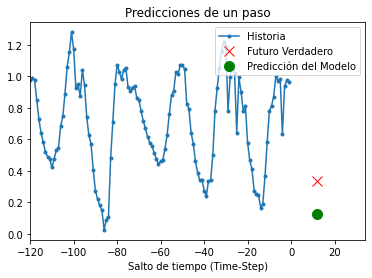

8/8 [==============================] - 0s 22ms/step


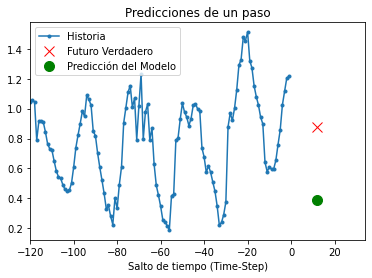

8/8 [==============================] - 0s 24ms/step


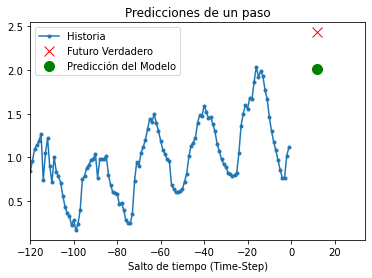

8/8 [==============================] - 0s 23ms/step


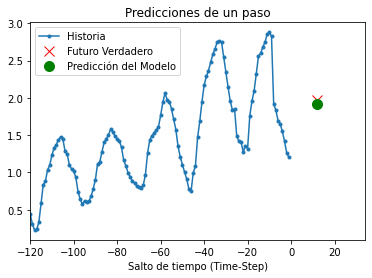

8/8 [==============================] - 0s 20ms/step


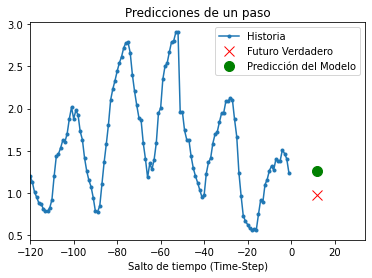

8/8 [==============================] - 0s 21ms/step


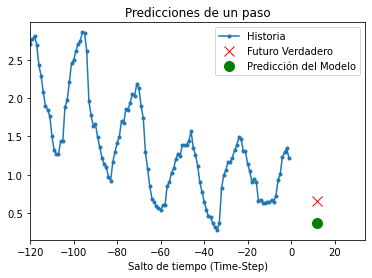

8/8 [==============================] - 0s 23ms/step


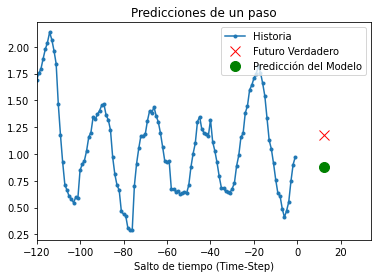

8/8 [==============================] - 0s 22ms/step


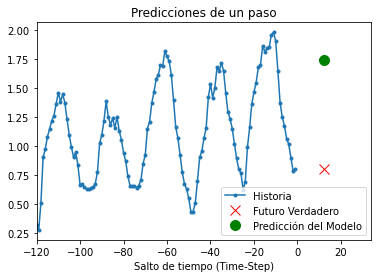

8/8 [==============================] - 0s 23ms/step


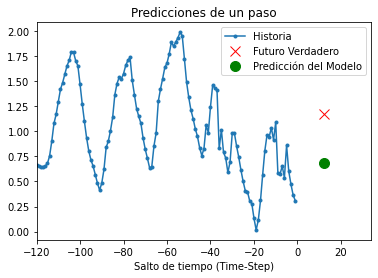

8/8 [==============================] - 0s 18ms/step


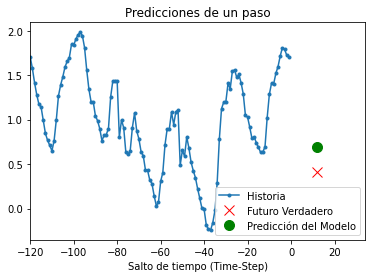

8/8 [==============================] - 0s 25ms/step


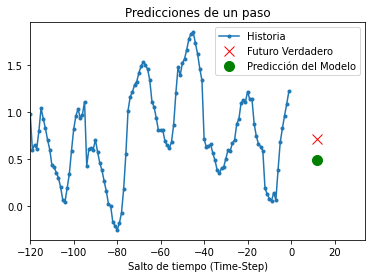

8/8 [==============================] - 0s 23ms/step


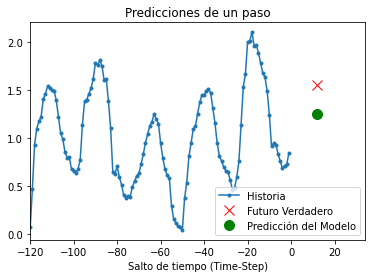

8/8 [==============================] - 0s 21ms/step


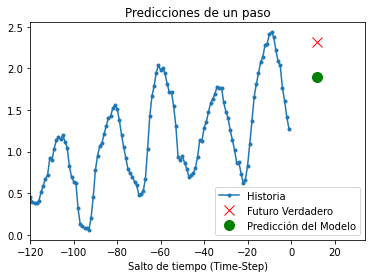

8/8 [==============================] - 0s 24ms/step


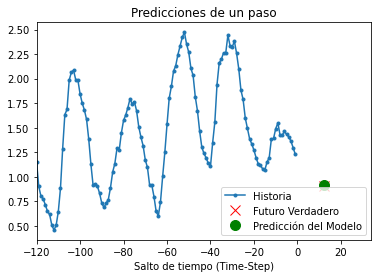

8/8 [==============================] - 0s 26ms/step


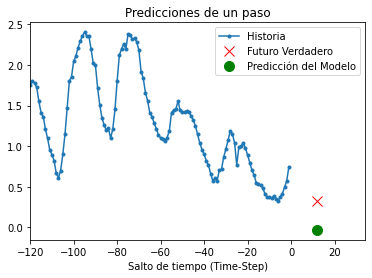

8/8 [==============================] - 0s 29ms/step


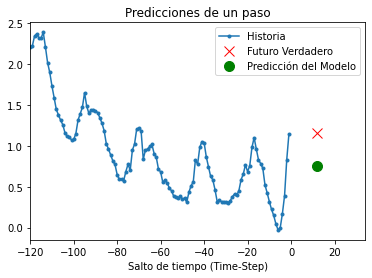

8/8 [==============================] - 0s 19ms/step


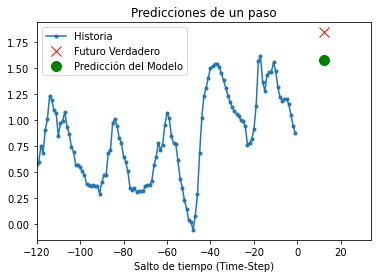

8/8 [==============================] - 0s 22ms/step


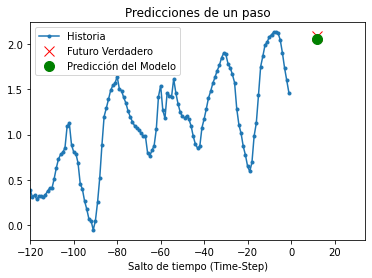

8/8 [==============================] - 0s 18ms/step


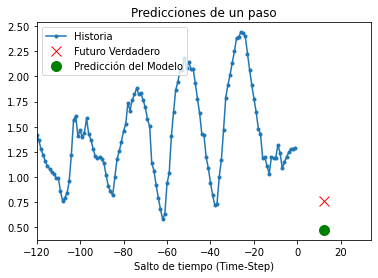

8/8 [==============================] - 0s 28ms/step


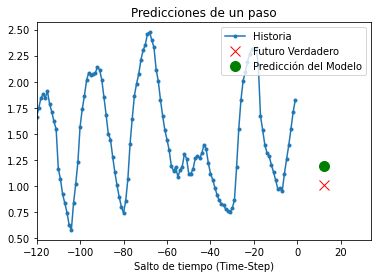

8/8 [==============================] - 0s 25ms/step


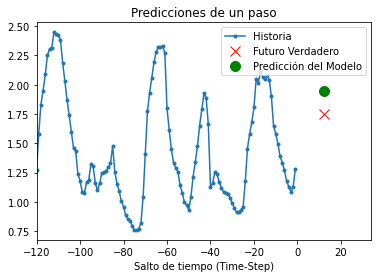

8/8 [==============================] - 0s 21ms/step


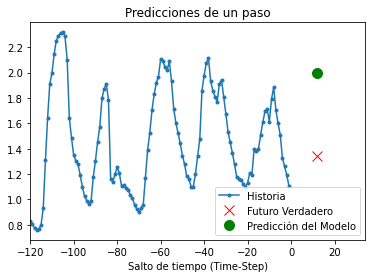

8/8 [==============================] - 0s 24ms/step


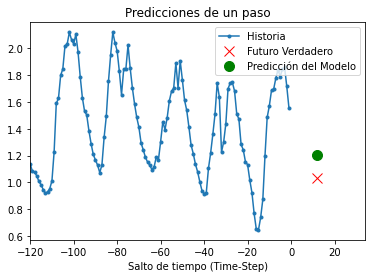

8/8 [==============================] - 0s 22ms/step


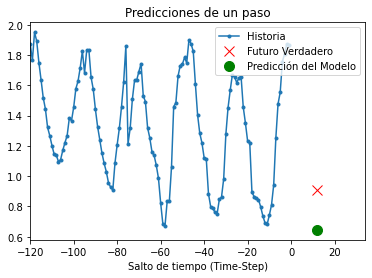

8/8 [==============================] - 0s 20ms/step


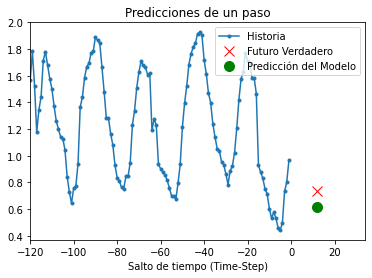

8/8 [==============================] - 0s 23ms/step


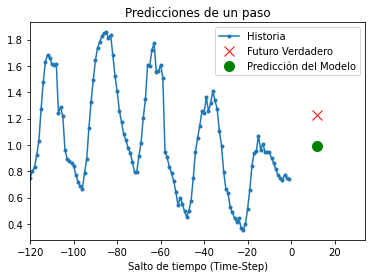

8/8 [==============================] - 0s 29ms/step


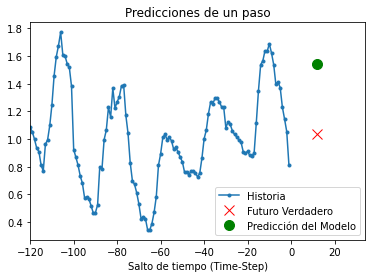

8/8 [==============================] - 0s 26ms/step


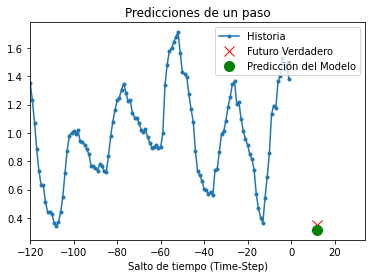

8/8 [==============================] - 0s 17ms/step


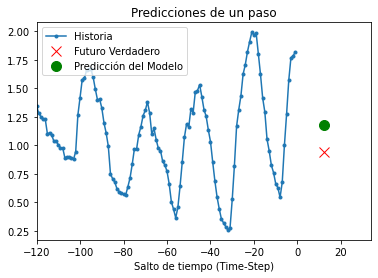

8/8 [==============================] - 0s 20ms/step


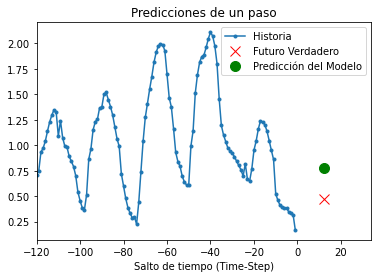

8/8 [==============================] - 0s 23ms/step


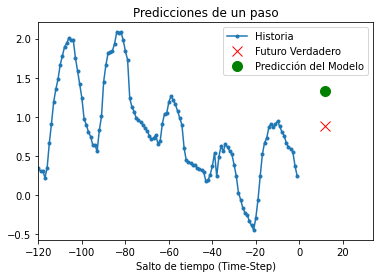

8/8 [==============================] - 0s 25ms/step


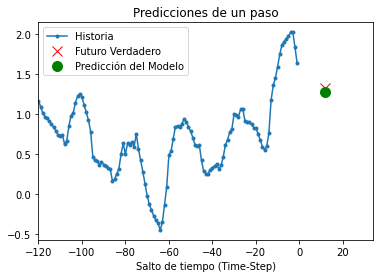

8/8 [==============================] - 0s 21ms/step


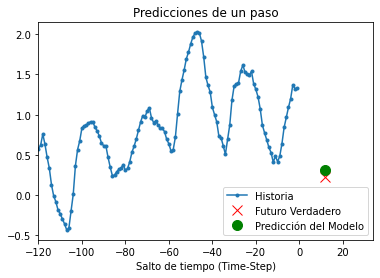

8/8 [==============================] - 0s 19ms/step


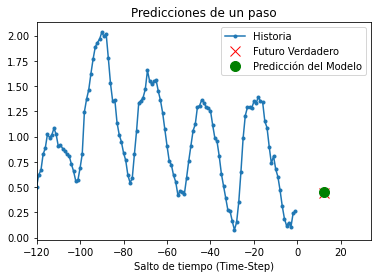

8/8 [==============================] - 0s 29ms/step


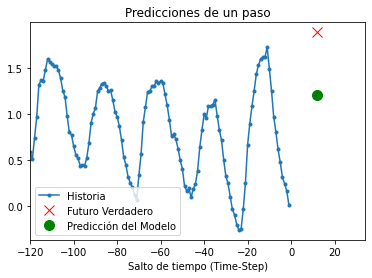

8/8 [==============================] - 0s 21ms/step


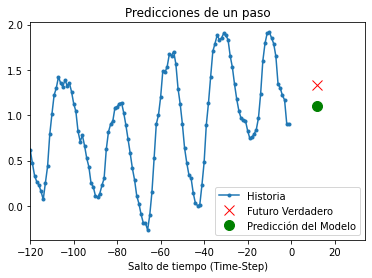

8/8 [==============================] - 0s 28ms/step


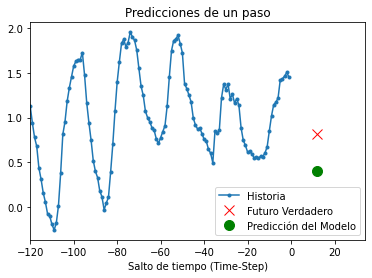

8/8 [==============================] - 0s 23ms/step


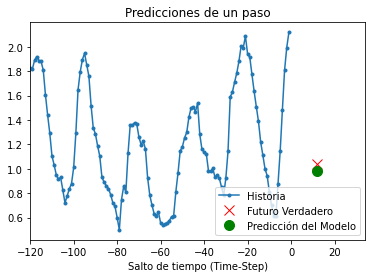

8/8 [==============================] - 0s 26ms/step


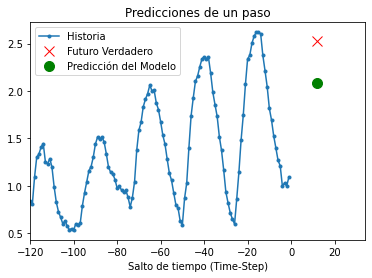

8/8 [==============================] - 0s 25ms/step


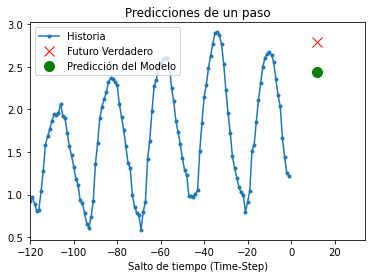

8/8 [==============================] - 0s 22ms/step


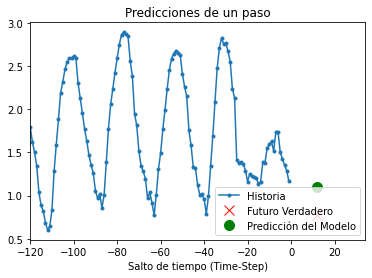

8/8 [==============================] - 0s 22ms/step


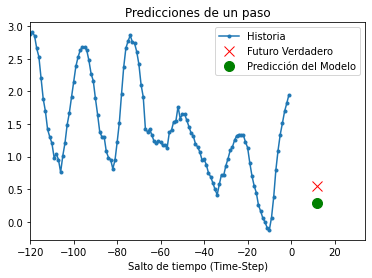

8/8 [==============================] - 0s 23ms/step


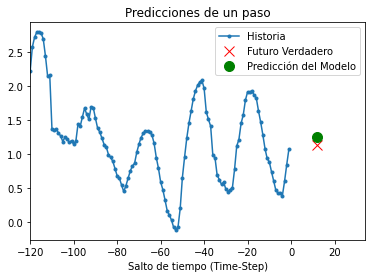

8/8 [==============================] - 0s 26ms/step


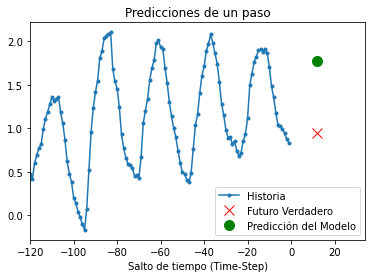

8/8 [==============================] - 0s 23ms/step


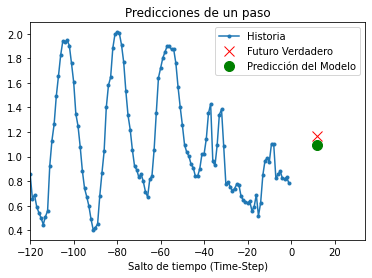

8/8 [==============================] - 0s 22ms/step


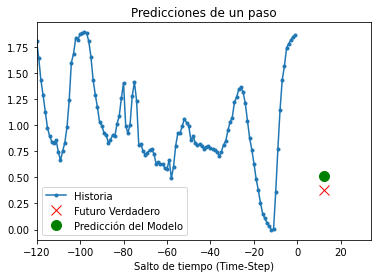

8/8 [==============================] - 0s 25ms/step


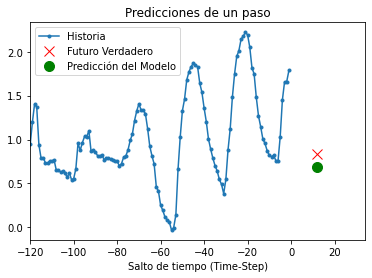

8/8 [==============================] - 0s 26ms/step


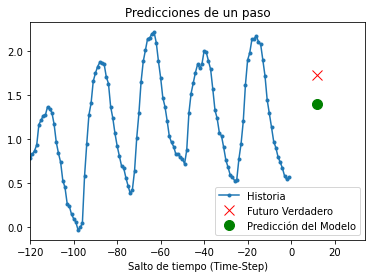

8/8 [==============================] - 0s 21ms/step


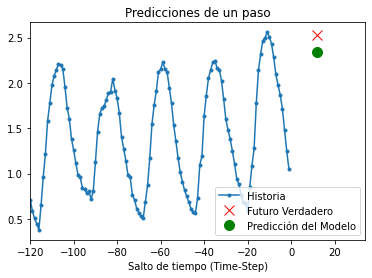

8/8 [==============================] - 0s 21ms/step


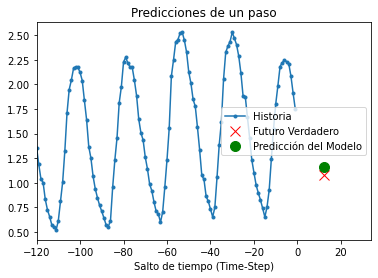

8/8 [==============================] - 0s 21ms/step


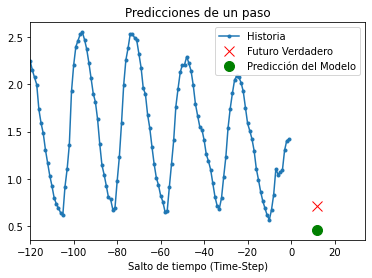

8/8 [==============================] - 0s 18ms/step


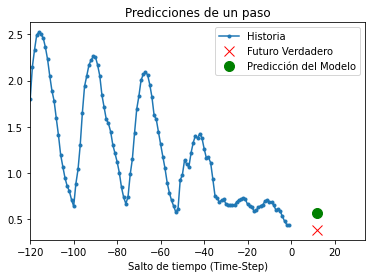

8/8 [==============================] - 0s 20ms/step


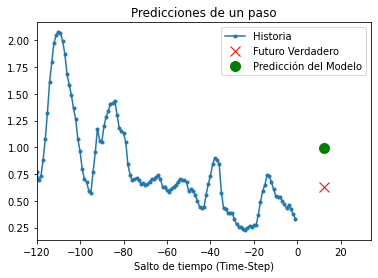

8/8 [==============================] - 0s 17ms/step


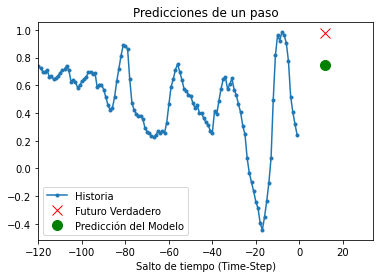

8/8 [==============================] - 0s 24ms/step


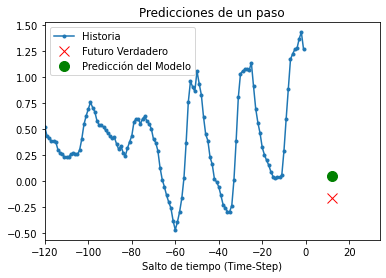

8/8 [==============================] - 0s 19ms/step


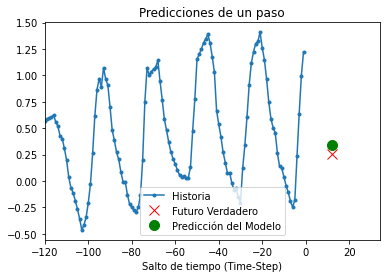

8/8 [==============================] - 0s 19ms/step


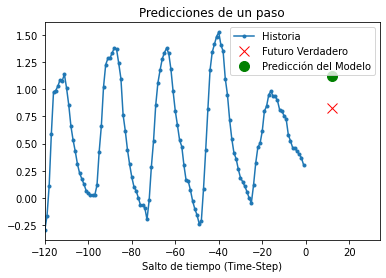

8/8 [==============================] - 0s 21ms/step


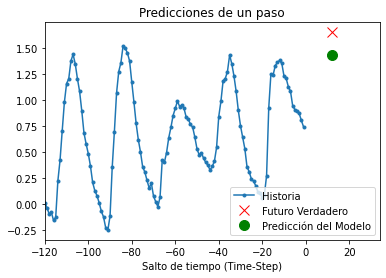

8/8 [==============================] - 0s 20ms/step


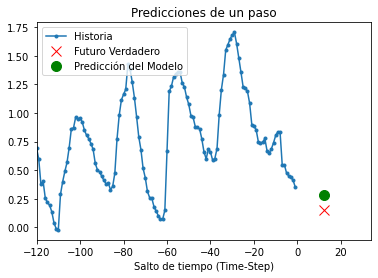

8/8 [==============================] - 0s 19ms/step


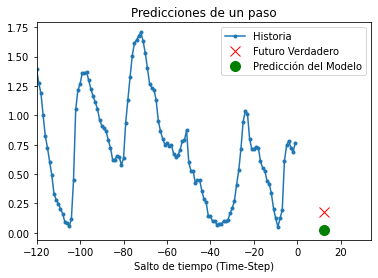

8/8 [==============================] - 0s 19ms/step


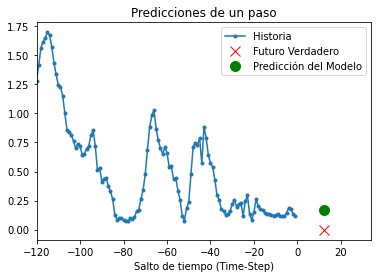

8/8 [==============================] - 0s 19ms/step


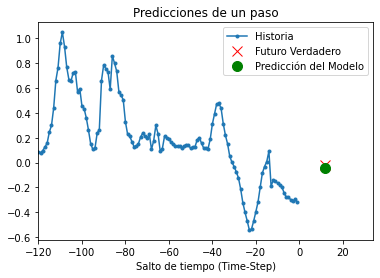

8/8 [==============================] - 0s 18ms/step


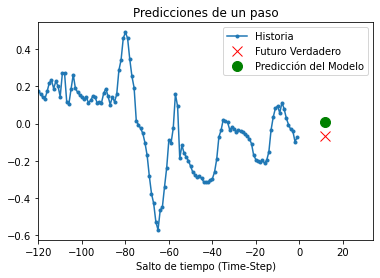

8/8 [==============================] - 0s 24ms/step


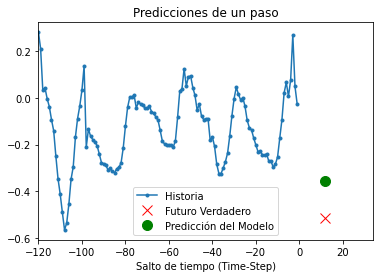

8/8 [==============================] - 0s 21ms/step


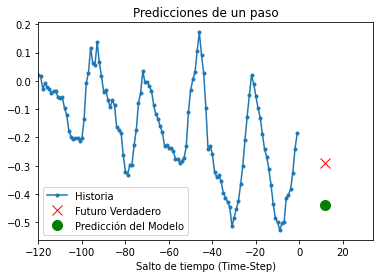

8/8 [==============================] - 0s 21ms/step


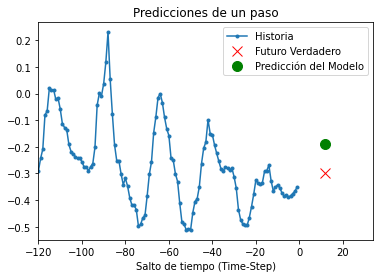

8/8 [==============================] - 0s 25ms/step


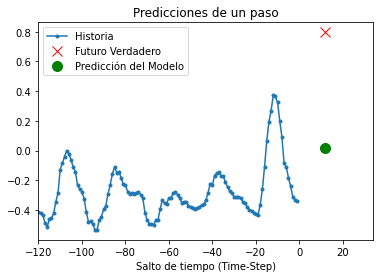

8/8 [==============================] - 0s 25ms/step


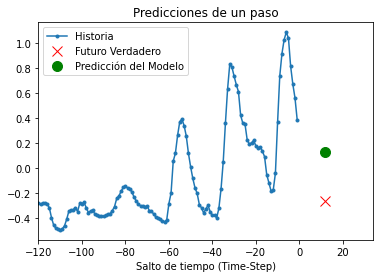

8/8 [==============================] - 0s 22ms/step


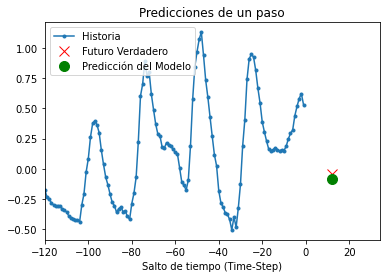

8/8 [==============================] - 0s 27ms/step


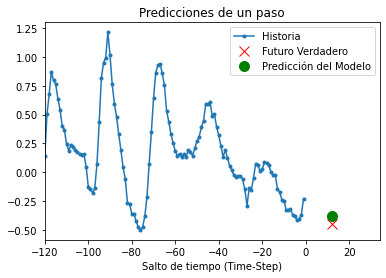

8/8 [==============================] - 0s 23ms/step


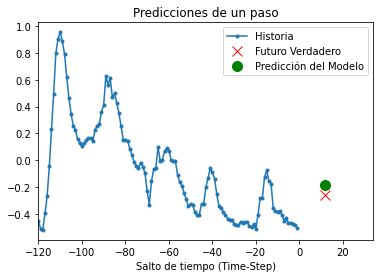

8/8 [==============================] - 0s 22ms/step


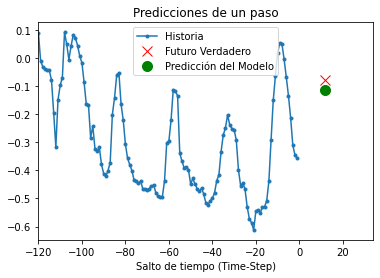

8/8 [==============================] - 0s 23ms/step


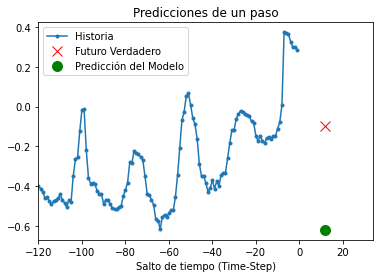

8/8 [==============================] - 0s 21ms/step


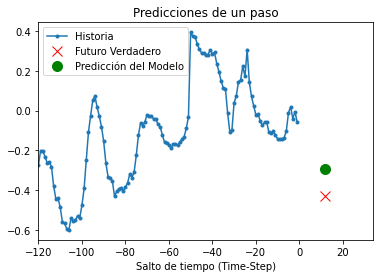

8/8 [==============================] - 0s 23ms/step


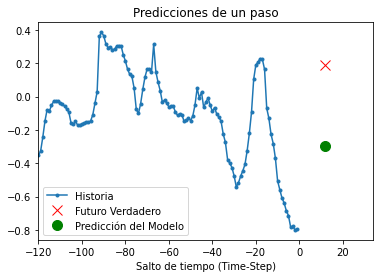

8/8 [==============================] - 0s 19ms/step


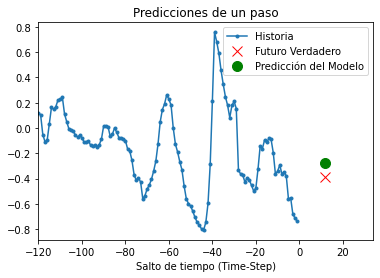

8/8 [==============================] - 0s 27ms/step


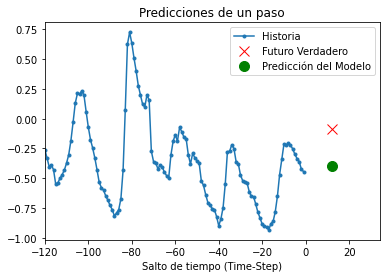

8/8 [==============================] - 0s 22ms/step


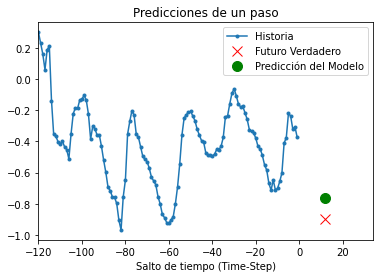

8/8 [==============================] - 0s 21ms/step


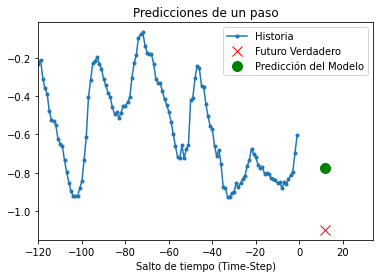

8/8 [==============================] - 0s 18ms/step


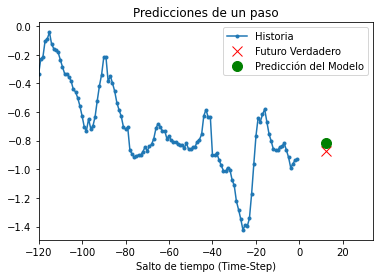

8/8 [==============================] - 0s 23ms/step


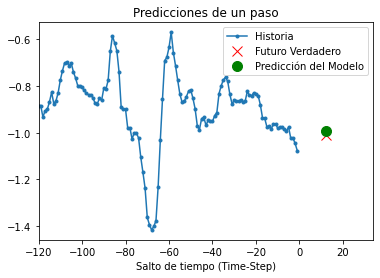

8/8 [==============================] - 0s 18ms/step


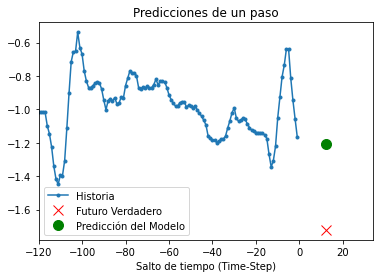

8/8 [==============================] - 0s 21ms/step


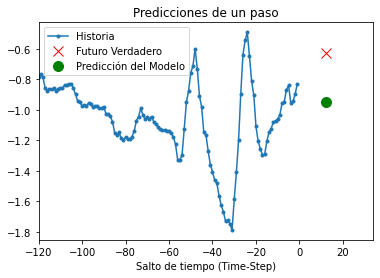

8/8 [==============================] - 0s 26ms/step


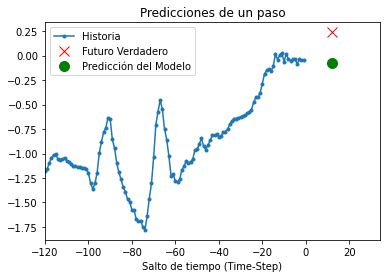

8/8 [==============================] - 0s 24ms/step


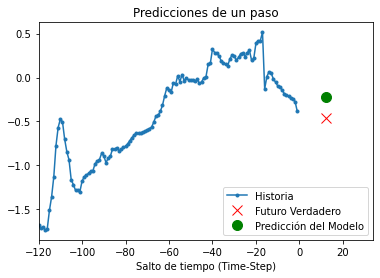

8/8 [==============================] - 0s 25ms/step


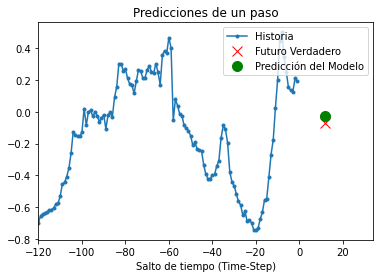

8/8 [==============================] - 0s 23ms/step


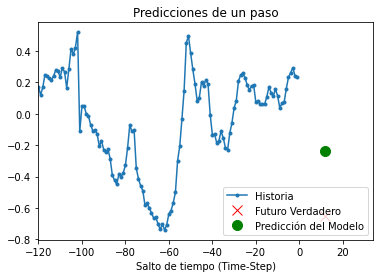

8/8 [==============================] - 0s 25ms/step


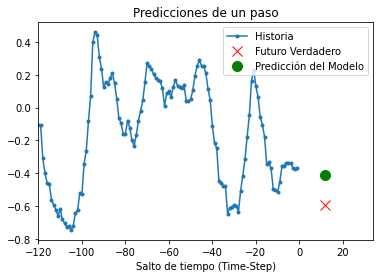

8/8 [==============================] - 0s 26ms/step


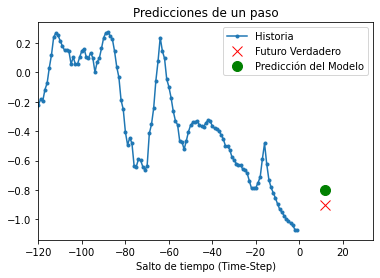

8/8 [==============================] - 0s 24ms/step


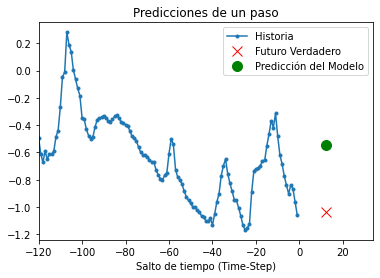

8/8 [==============================] - 0s 19ms/step


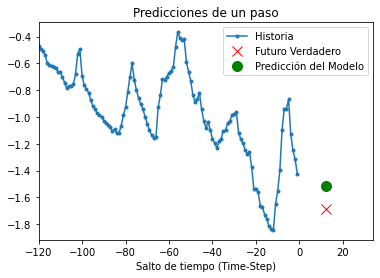

8/8 [==============================] - 0s 24ms/step


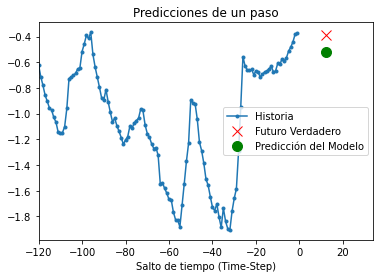

8/8 [==============================] - 0s 29ms/step


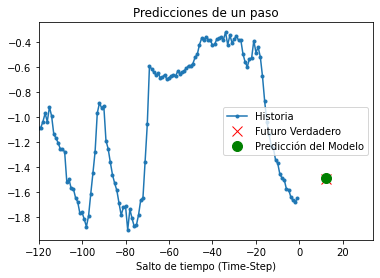

8/8 [==============================] - 0s 22ms/step


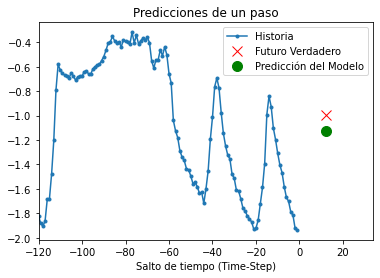

8/8 [==============================] - 0s 26ms/step


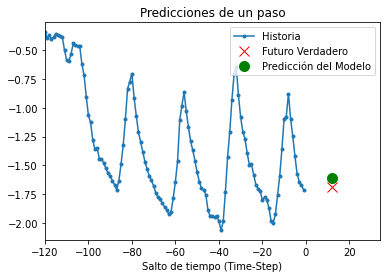

8/8 [==============================] - 0s 21ms/step


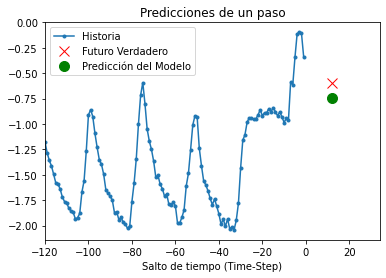

8/8 [==============================] - 0s 19ms/step


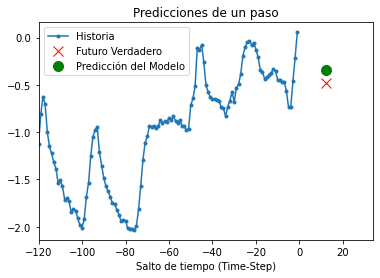

8/8 [==============================] - 0s 23ms/step


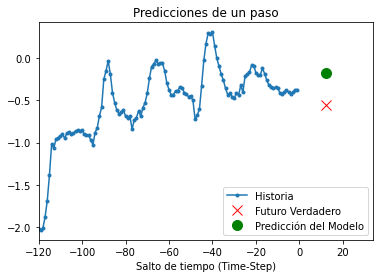

8/8 [==============================] - 0s 31ms/step


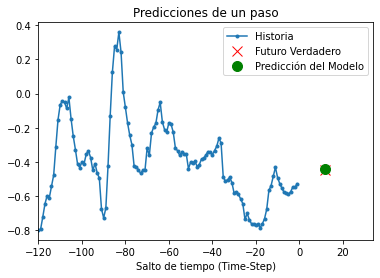

8/8 [==============================] - 0s 19ms/step


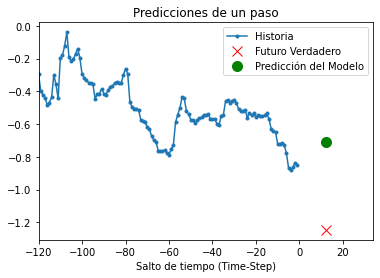

8/8 [==============================] - 0s 25ms/step


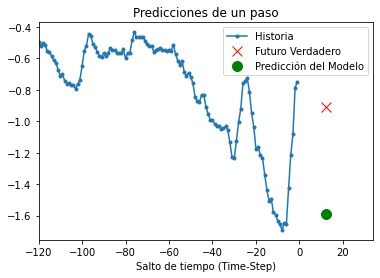

8/8 [==============================] - 0s 22ms/step


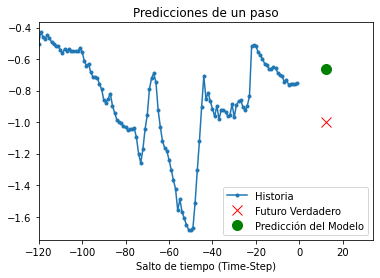

8/8 [==============================] - 0s 29ms/step


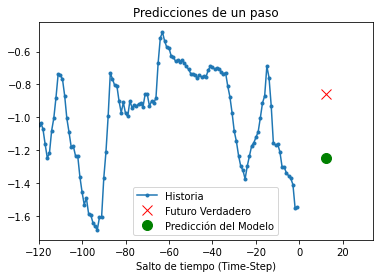

8/8 [==============================] - 0s 24ms/step


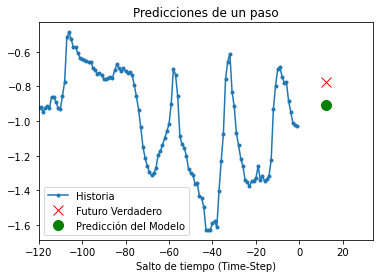

8/8 [==============================] - 0s 23ms/step


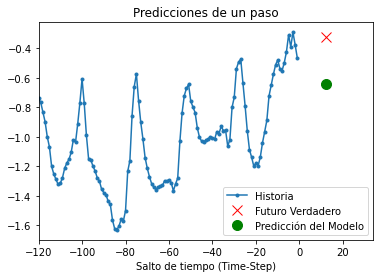

8/8 [==============================] - 0s 23ms/step


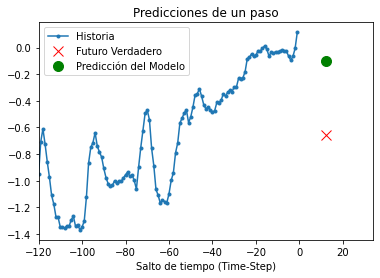

8/8 [==============================] - 0s 23ms/step


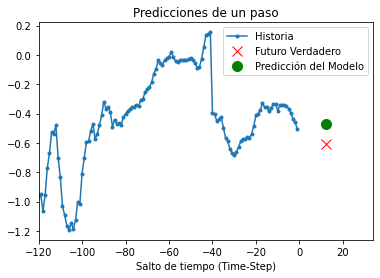

7/7 [==============================] - 0s 29ms/step


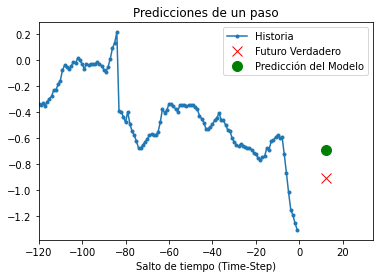

8/8 [==============================] - 0s 21ms/step


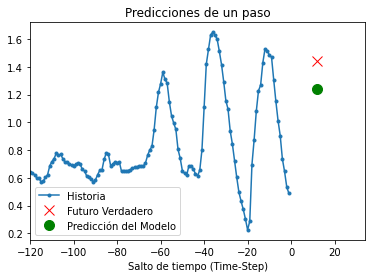

8/8 [==============================] - 0s 24ms/step


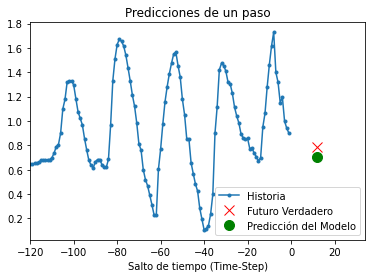

8/8 [==============================] - 0s 22ms/step


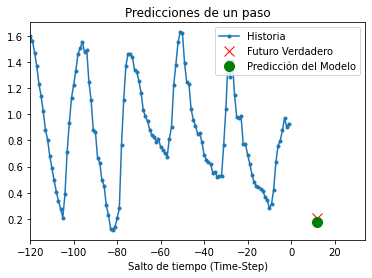

8/8 [==============================] - 0s 25ms/step


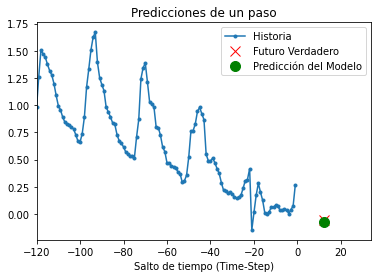

8/8 [==============================] - 0s 24ms/step


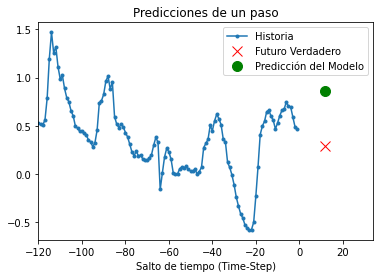

8/8 [==============================] - 0s 21ms/step


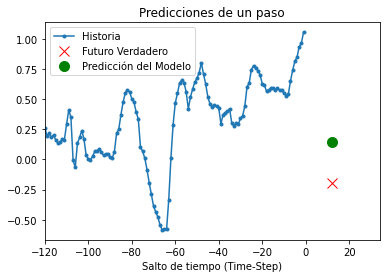

8/8 [==============================] - 0s 25ms/step


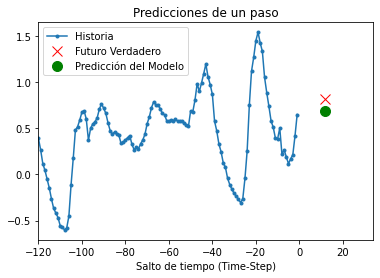

8/8 [==============================] - 0s 21ms/step


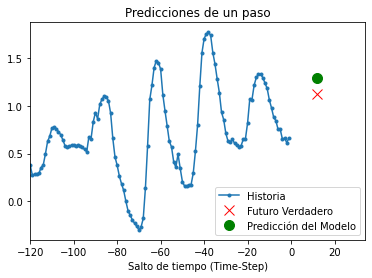

8/8 [==============================] - 0s 19ms/step


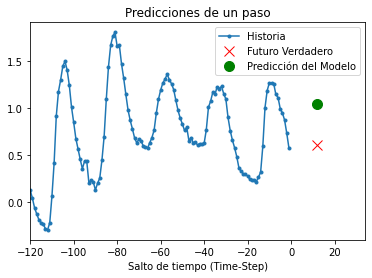

8/8 [==============================] - 0s 23ms/step


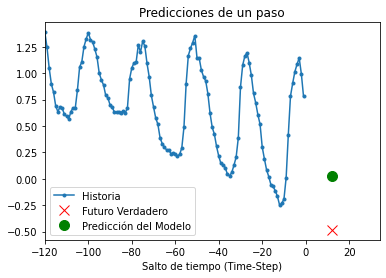

8/8 [==============================] - 0s 22ms/step


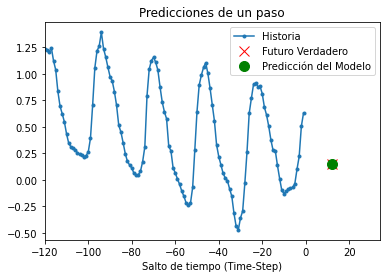

8/8 [==============================] - 0s 21ms/step


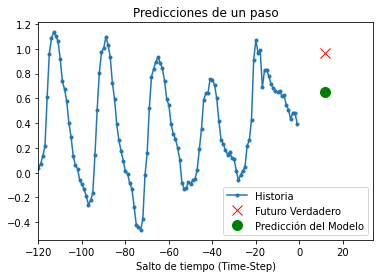

8/8 [==============================] - 0s 22ms/step


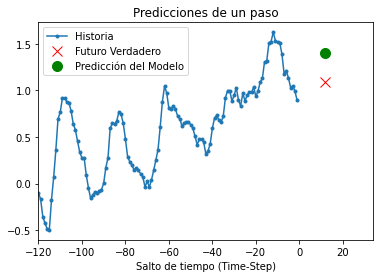

8/8 [==============================] - 0s 22ms/step


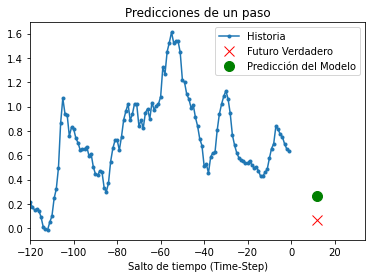

8/8 [==============================] - 0s 31ms/step


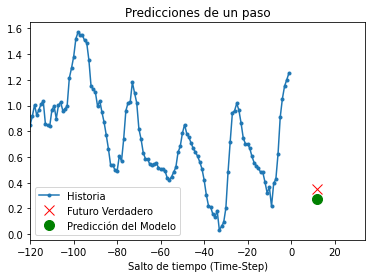

8/8 [==============================] - 0s 32ms/step


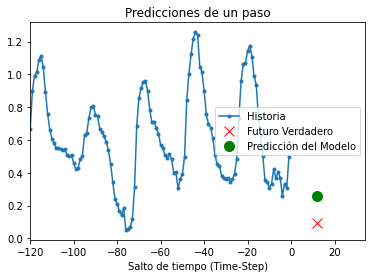

8/8 [==============================] - 0s 19ms/step


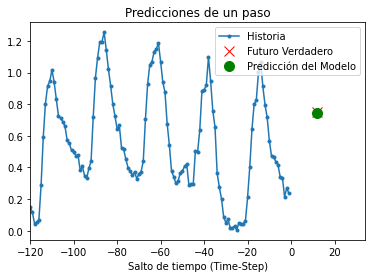

8/8 [==============================] - 0s 24ms/step


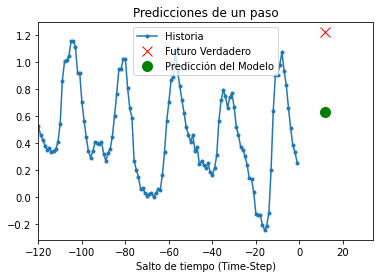

8/8 [==============================] - 0s 26ms/step


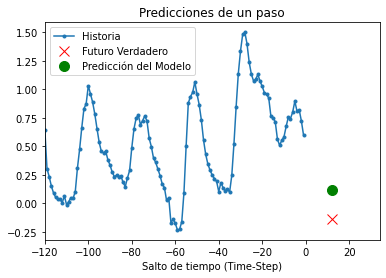

8/8 [==============================] - 0s 21ms/step


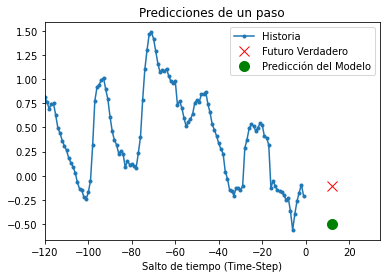

8/8 [==============================] - 0s 23ms/step


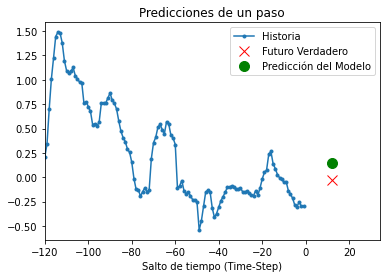

8/8 [==============================] - 0s 26ms/step


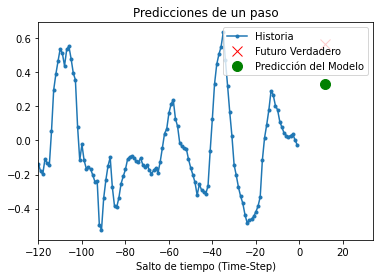

8/8 [==============================] - 0s 22ms/step


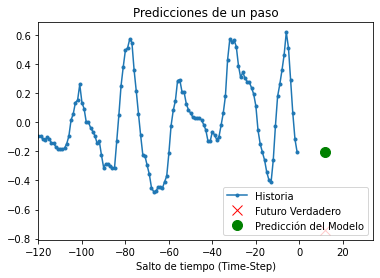

8/8 [==============================] - 0s 23ms/step


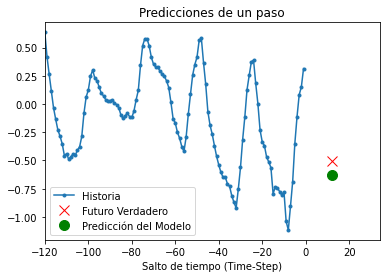

8/8 [==============================] - 0s 25ms/step


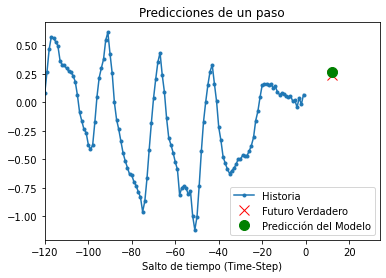

8/8 [==============================] - 0s 23ms/step


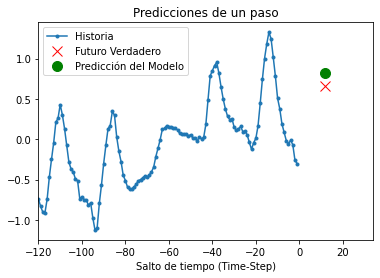

8/8 [==============================] - 0s 25ms/step


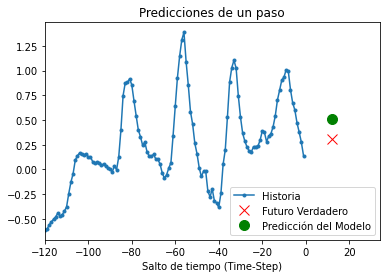

8/8 [==============================] - 0s 26ms/step


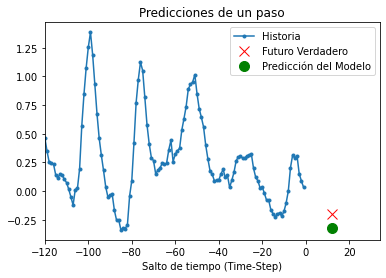

8/8 [==============================] - 0s 22ms/step


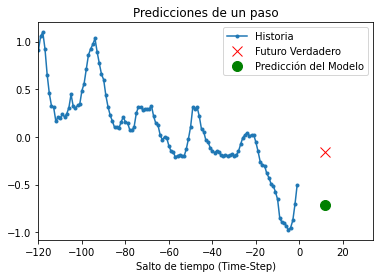

8/8 [==============================] - 0s 25ms/step


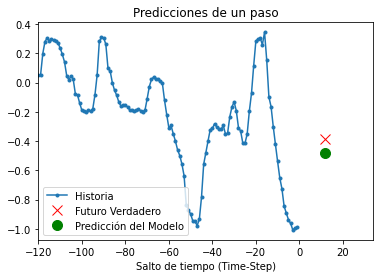

8/8 [==============================] - 0s 22ms/step


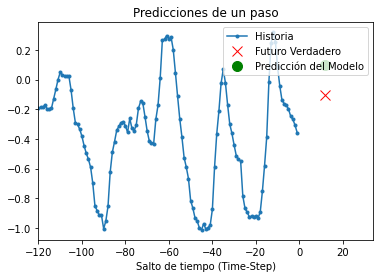

8/8 [==============================] - 0s 22ms/step


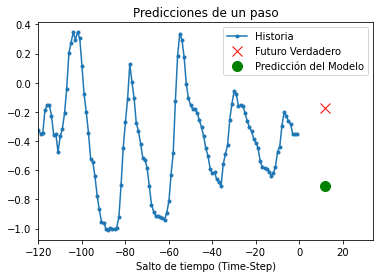

8/8 [==============================] - 0s 22ms/step


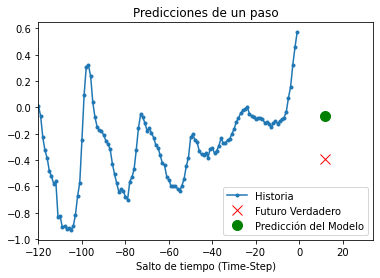

8/8 [==============================] - 0s 23ms/step


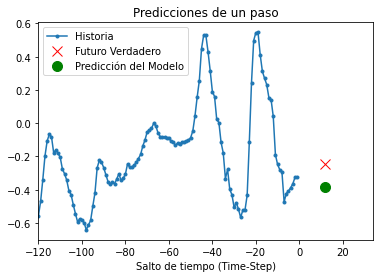

8/8 [==============================] - 0s 21ms/step


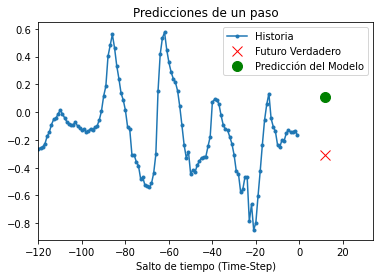

8/8 [==============================] - 0s 23ms/step


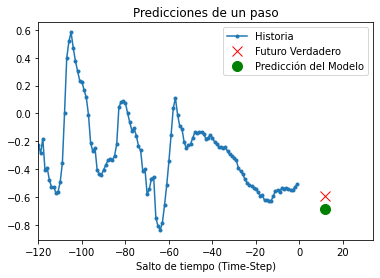

8/8 [==============================] - 0s 20ms/step


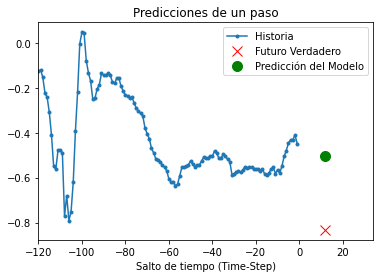

8/8 [==============================] - 0s 21ms/step


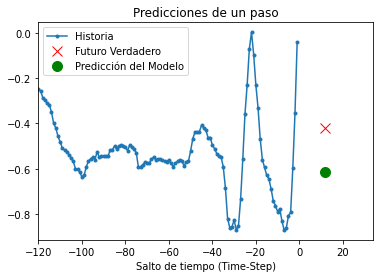

8/8 [==============================] - 0s 23ms/step


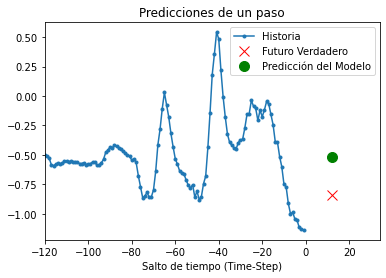

8/8 [==============================] - 0s 26ms/step


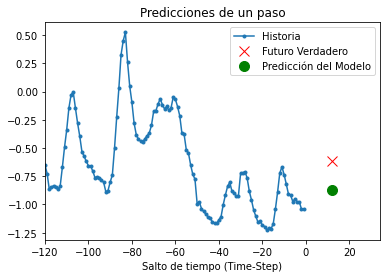

8/8 [==============================] - 0s 29ms/step


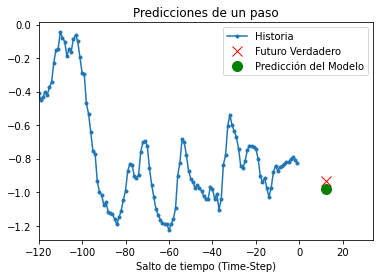

8/8 [==============================] - 0s 22ms/step


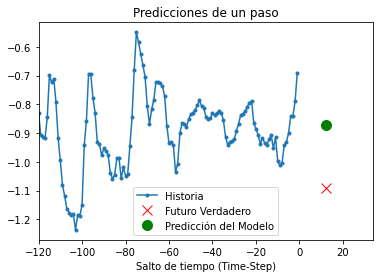

8/8 [==============================] - 0s 33ms/step


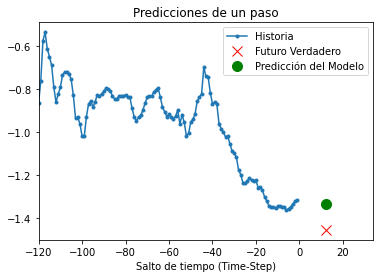

8/8 [==============================] - 0s 28ms/step


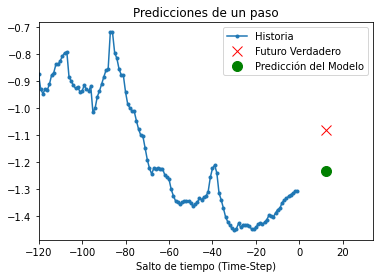

8/8 [==============================] - 0s 26ms/step


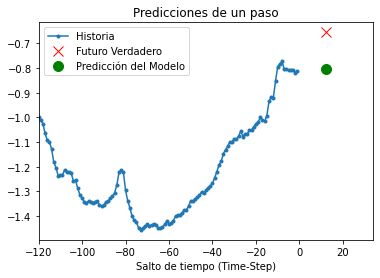

8/8 [==============================] - 0s 24ms/step


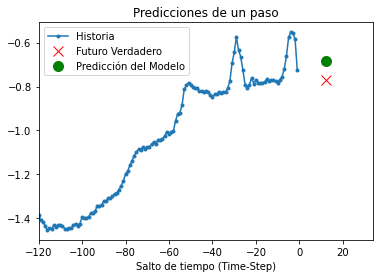

8/8 [==============================] - 0s 28ms/step


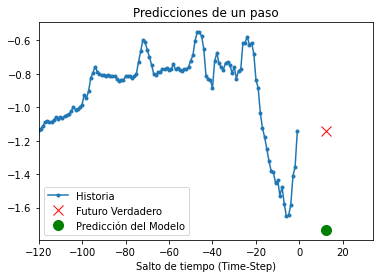

8/8 [==============================] - 0s 24ms/step


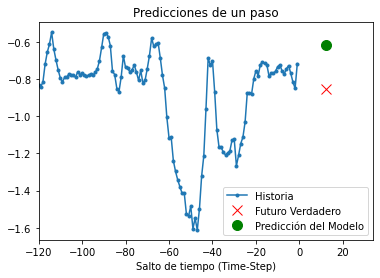

8/8 [==============================] - 0s 28ms/step


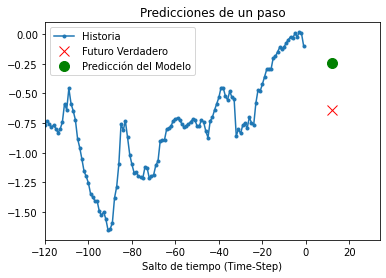

8/8 [==============================] - 0s 26ms/step


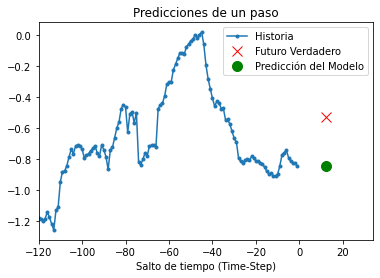

8/8 [==============================] - 0s 23ms/step


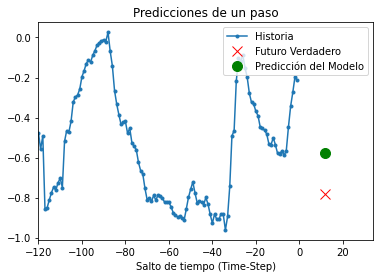

8/8 [==============================] - 0s 24ms/step


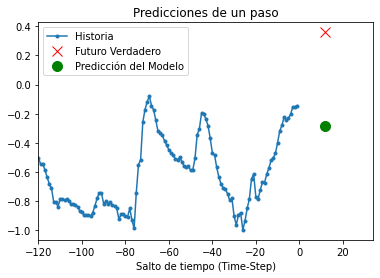

8/8 [==============================] - 0s 18ms/step


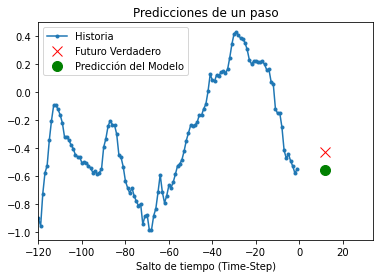

8/8 [==============================] - 0s 25ms/step


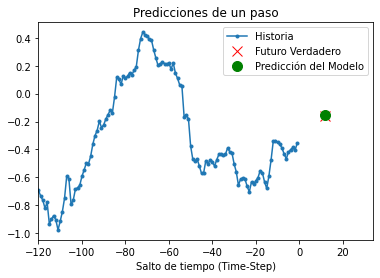

8/8 [==============================] - 0s 44ms/step


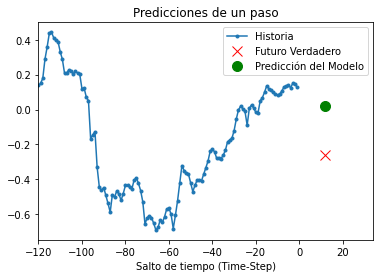

8/8 [==============================] - 0s 25ms/step


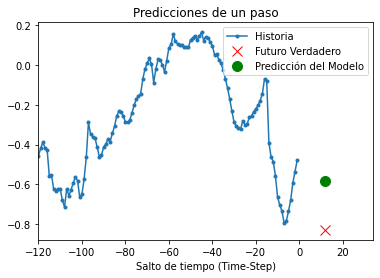

8/8 [==============================] - 0s 22ms/step


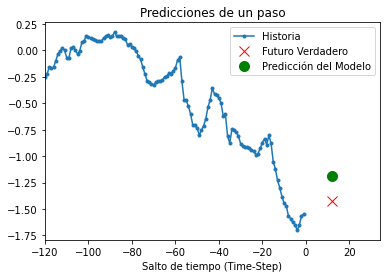

8/8 [==============================] - 0s 27ms/step


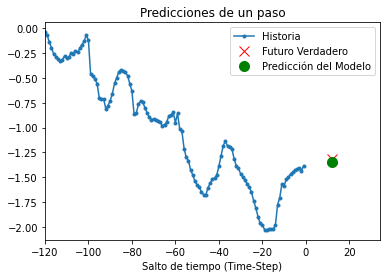

8/8 [==============================] - 0s 23ms/step


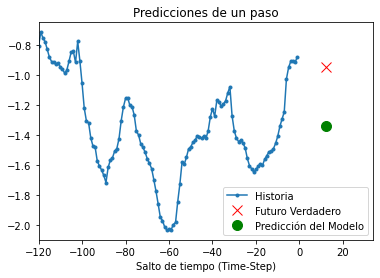

8/8 [==============================] - 0s 24ms/step


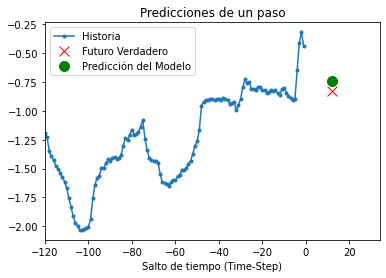

8/8 [==============================] - 0s 32ms/step


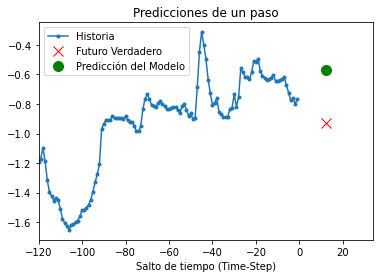

8/8 [==============================] - 0s 24ms/step


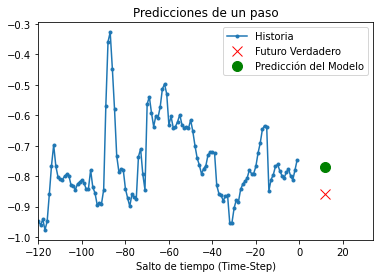

8/8 [==============================] - 0s 24ms/step


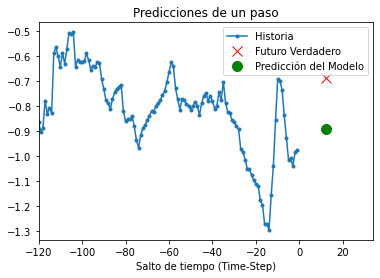

8/8 [==============================] - 0s 21ms/step


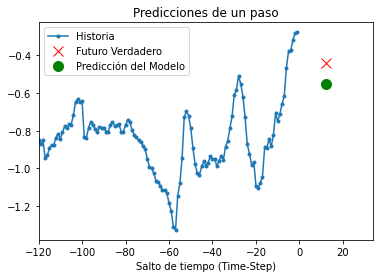

8/8 [==============================] - 0s 21ms/step


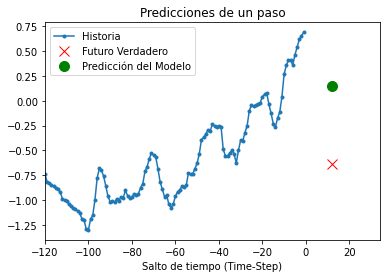

8/8 [==============================] - 0s 25ms/step


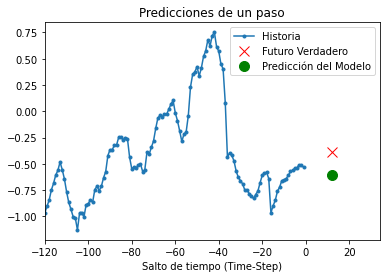

8/8 [==============================] - 0s 21ms/step


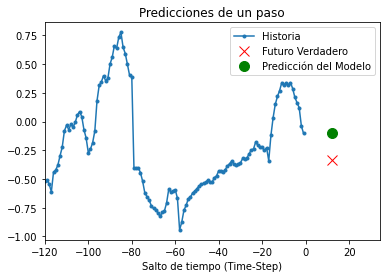

8/8 [==============================] - 0s 19ms/step


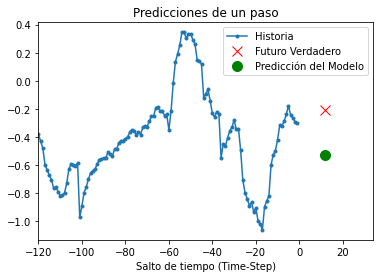

8/8 [==============================] - 0s 24ms/step


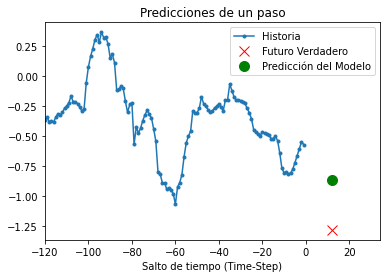

8/8 [==============================] - 0s 20ms/step


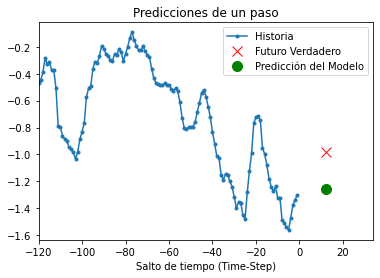

8/8 [==============================] - 0s 23ms/step


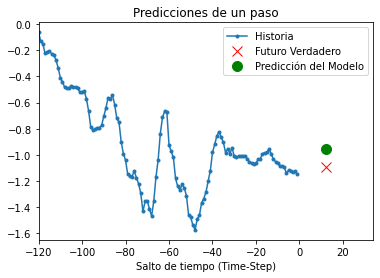

8/8 [==============================] - 0s 27ms/step


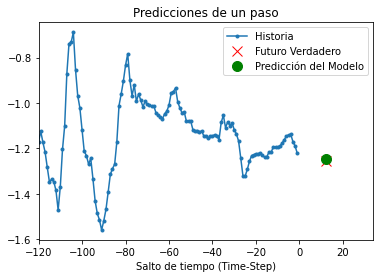

8/8 [==============================] - 0s 24ms/step


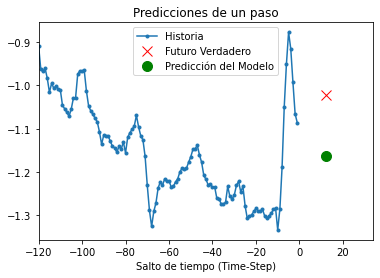

8/8 [==============================] - 0s 26ms/step


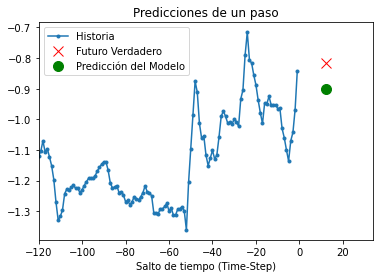

8/8 [==============================] - 0s 22ms/step


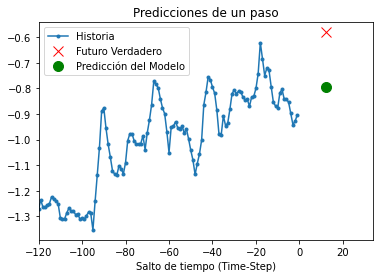

8/8 [==============================] - 0s 29ms/step


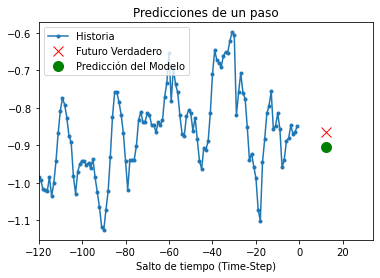

8/8 [==============================] - 0s 21ms/step


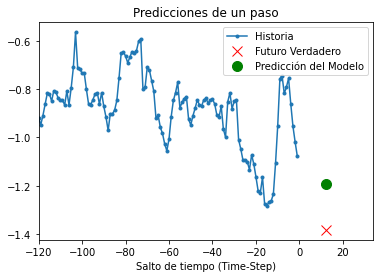

8/8 [==============================] - 0s 25ms/step


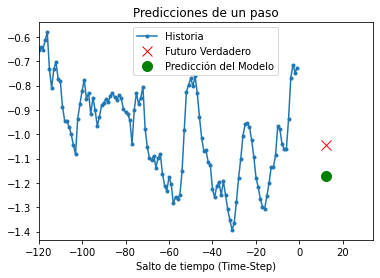

8/8 [==============================] - 0s 25ms/step


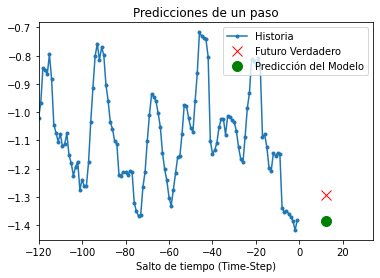

8/8 [==============================] - 0s 23ms/step


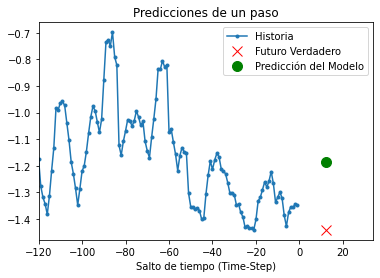

8/8 [==============================] - 0s 24ms/step


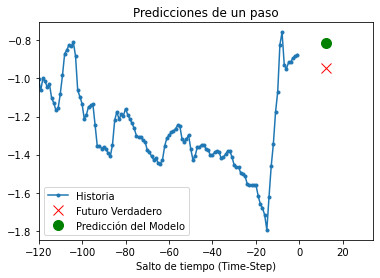

8/8 [==============================] - 0s 32ms/step


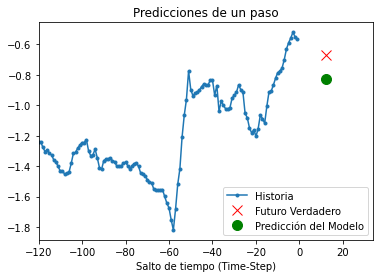

8/8 [==============================] - 0s 26ms/step


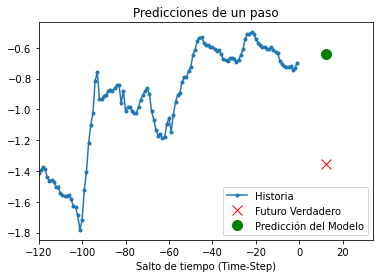

8/8 [==============================] - 0s 29ms/step


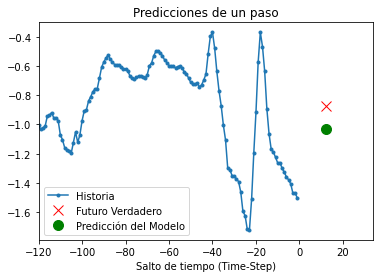

8/8 [==============================] - 0s 22ms/step


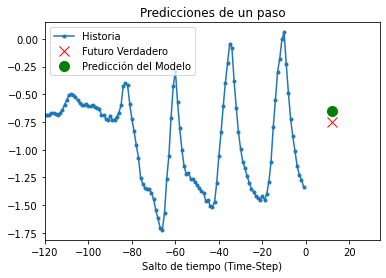

8/8 [==============================] - 0s 30ms/step


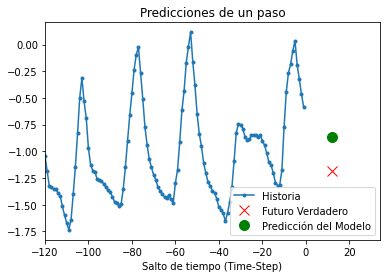

8/8 [==============================] - 0s 24ms/step


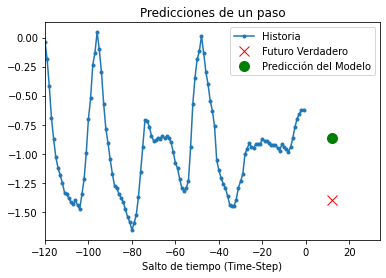

8/8 [==============================] - 0s 24ms/step


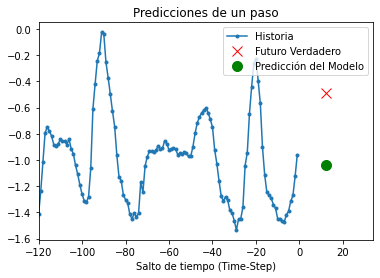

8/8 [==============================] - 0s 23ms/step


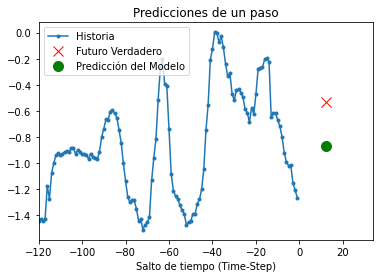

8/8 [==============================] - 0s 21ms/step


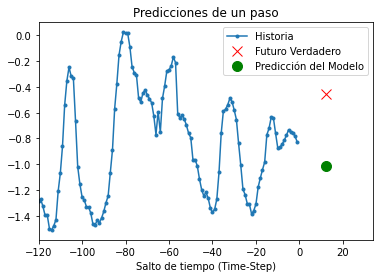

8/8 [==============================] - 0s 25ms/step


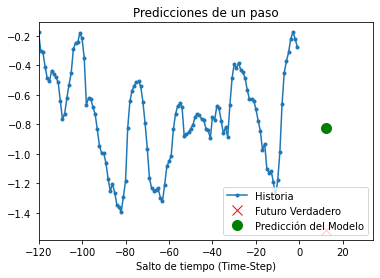

8/8 [==============================] - 0s 32ms/step


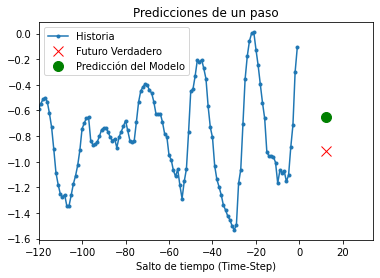

8/8 [==============================] - 0s 32ms/step


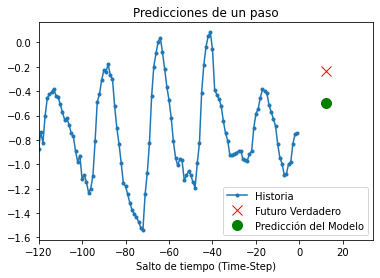

8/8 [==============================] - 0s 25ms/step


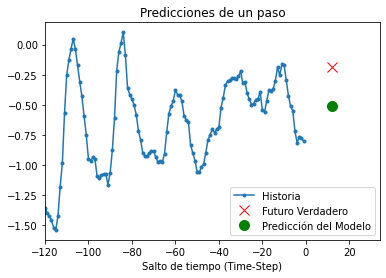

8/8 [==============================] - 0s 26ms/step


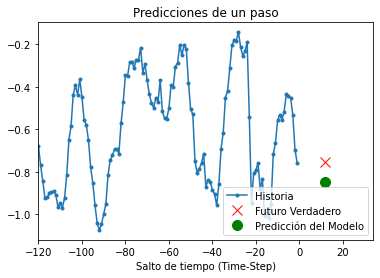

8/8 [==============================] - 0s 22ms/step


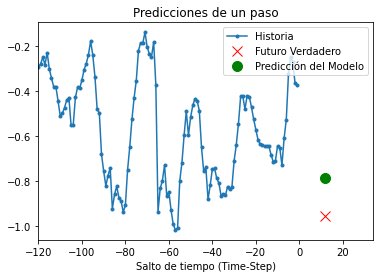

8/8 [==============================] - 0s 29ms/step


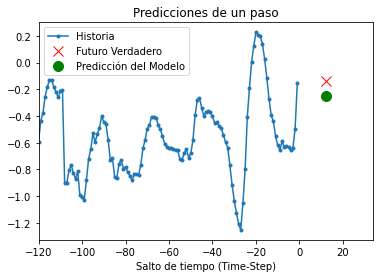

8/8 [==============================] - 0s 21ms/step


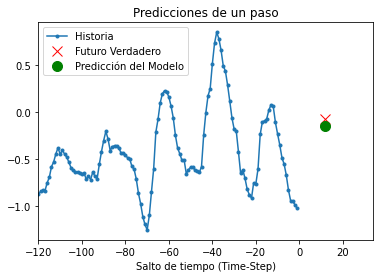

8/8 [==============================] - 0s 21ms/step


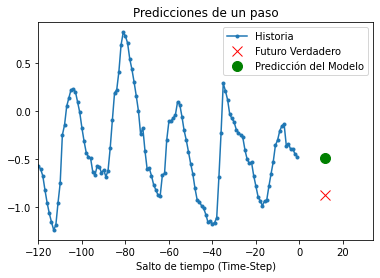

8/8 [==============================] - 0s 22ms/step


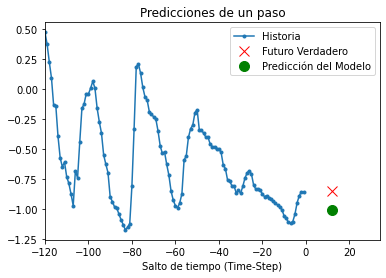

8/8 [==============================] - 0s 27ms/step


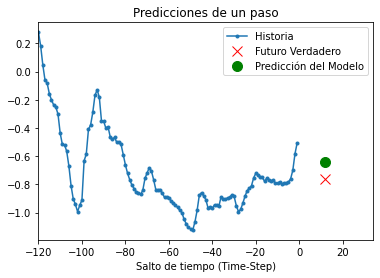

8/8 [==============================] - 0s 23ms/step


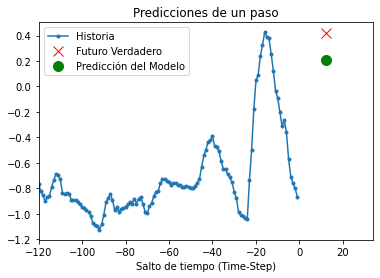

8/8 [==============================] - 0s 25ms/step


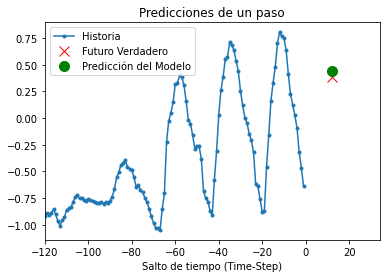

8/8 [==============================] - 0s 30ms/step


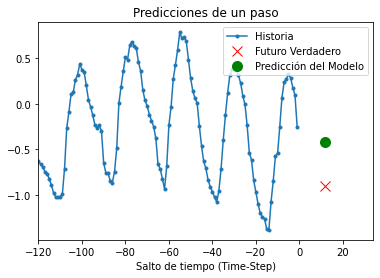

8/8 [==============================] - 0s 23ms/step


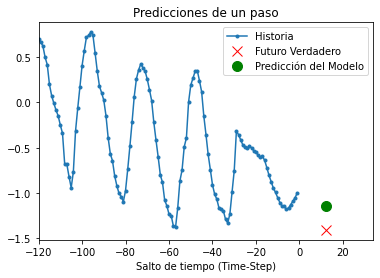

8/8 [==============================] - 0s 21ms/step


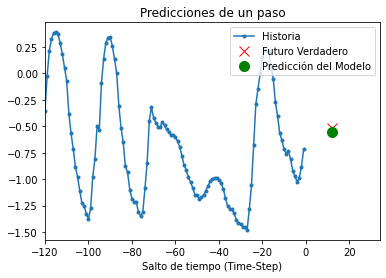

8/8 [==============================] - 0s 22ms/step


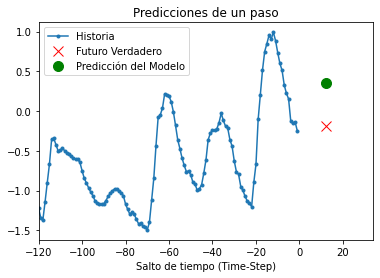

8/8 [==============================] - 0s 30ms/step


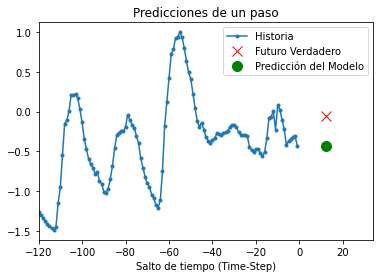

8/8 [==============================] - 0s 25ms/step


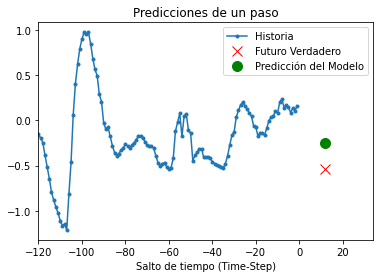

8/8 [==============================] - 0s 29ms/step


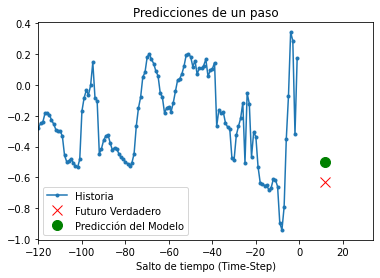

8/8 [==============================] - 0s 31ms/step


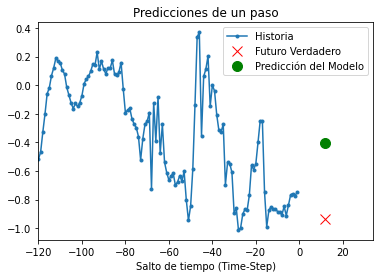

8/8 [==============================] - 0s 23ms/step


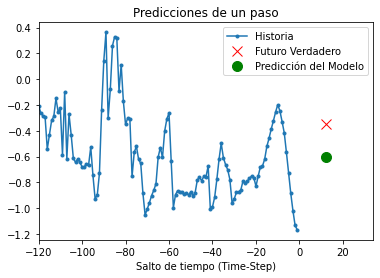

8/8 [==============================] - 0s 22ms/step


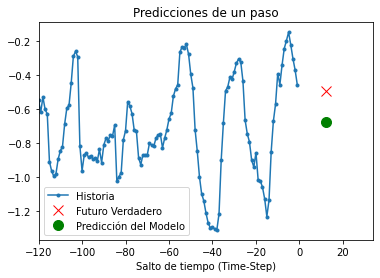

8/8 [==============================] - 0s 22ms/step


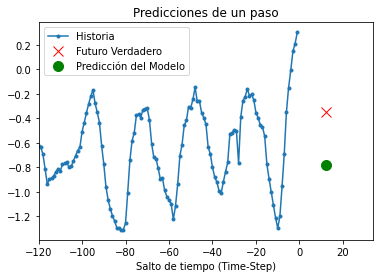

8/8 [==============================] - 0s 22ms/step


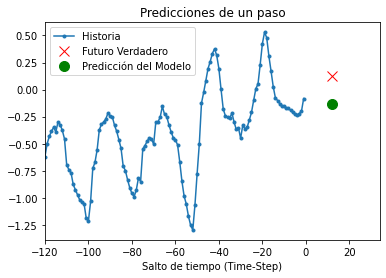

8/8 [==============================] - 0s 22ms/step


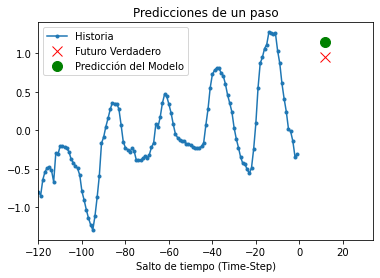

8/8 [==============================] - 0s 18ms/step


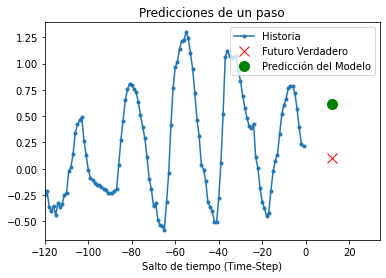

8/8 [==============================] - 0s 22ms/step


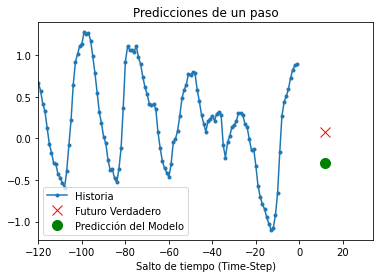

8/8 [==============================] - 0s 22ms/step


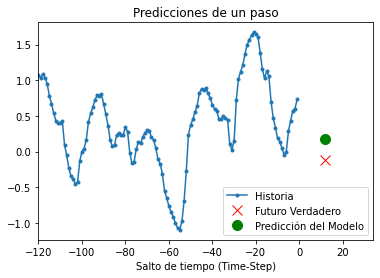

8/8 [==============================] - 0s 24ms/step


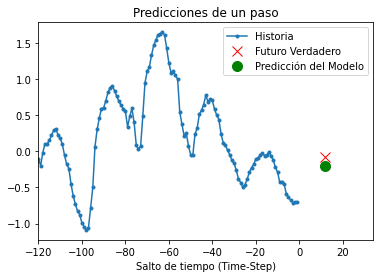

8/8 [==============================] - 0s 27ms/step


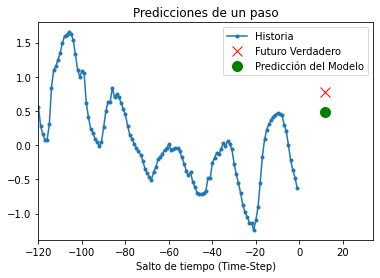

8/8 [==============================] - 0s 25ms/step


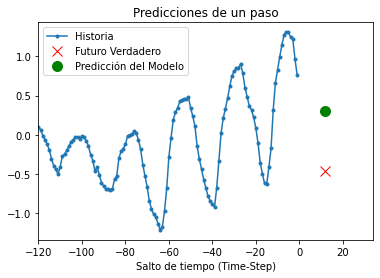

8/8 [==============================] - 0s 20ms/step


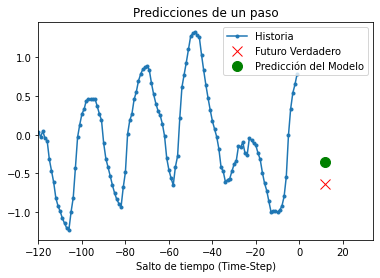

8/8 [==============================] - 0s 19ms/step


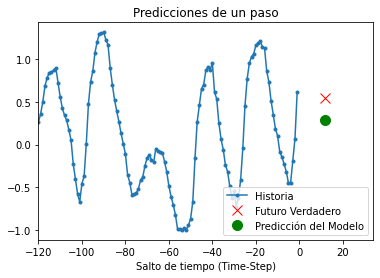

8/8 [==============================] - 0s 20ms/step


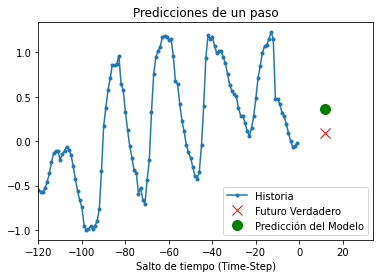

8/8 [==============================] - 0s 22ms/step


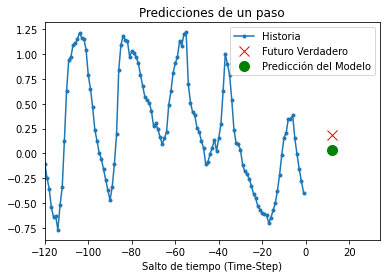

8/8 [==============================] - 0s 23ms/step


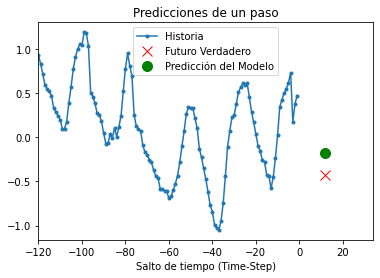

8/8 [==============================] - 0s 21ms/step


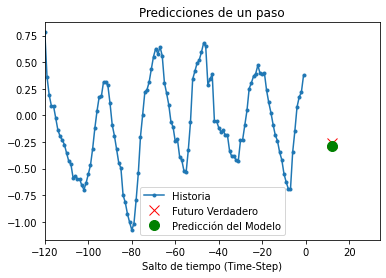

8/8 [==============================] - 0s 23ms/step


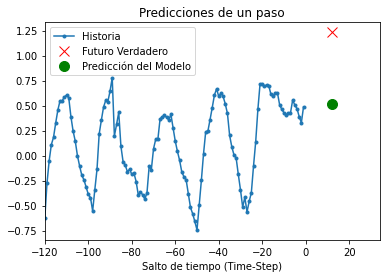

8/8 [==============================] - 0s 23ms/step


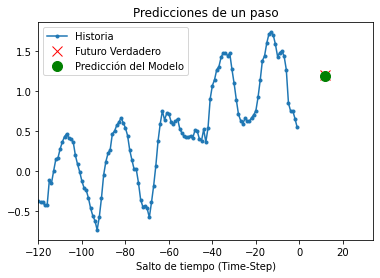

8/8 [==============================] - 0s 20ms/step


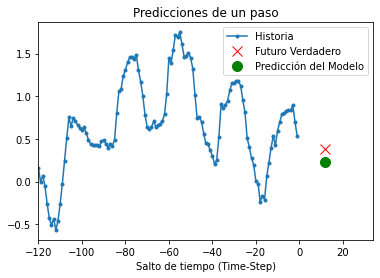

8/8 [==============================] - 0s 20ms/step


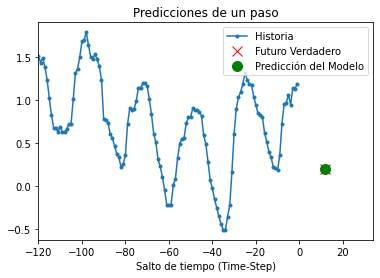

8/8 [==============================] - 0s 21ms/step


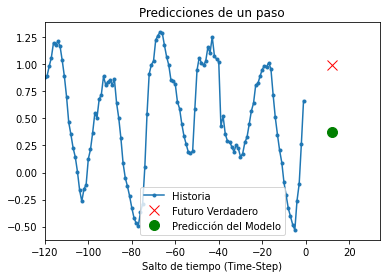

8/8 [==============================] - 0s 24ms/step


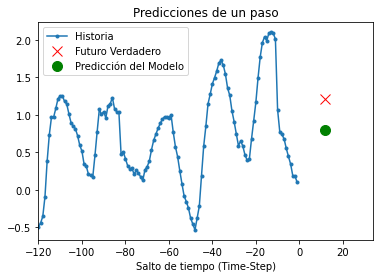

8/8 [==============================] - 0s 23ms/step


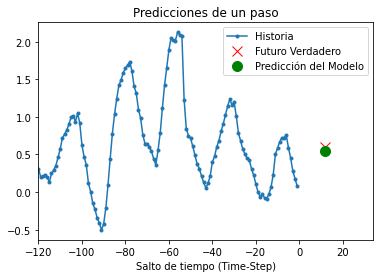

8/8 [==============================] - 0s 24ms/step


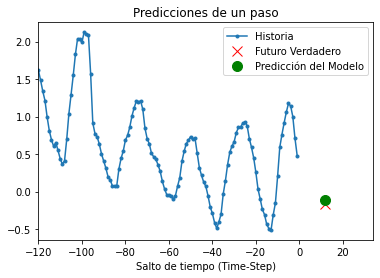

8/8 [==============================] - 0s 24ms/step


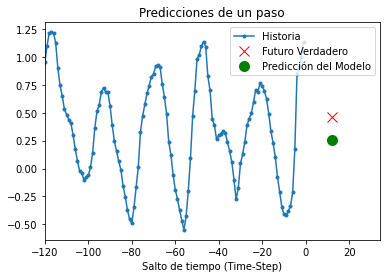

8/8 [==============================] - 0s 22ms/step


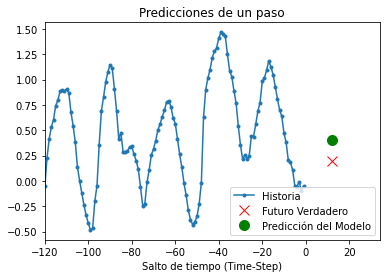

8/8 [==============================] - 0s 22ms/step


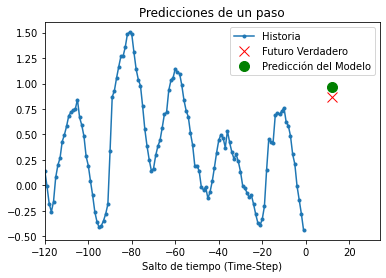

8/8 [==============================] - 0s 24ms/step


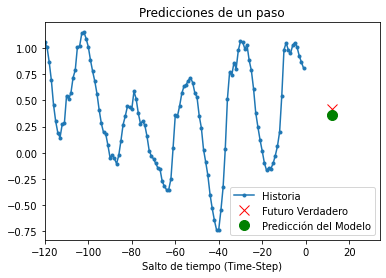

8/8 [==============================] - 0s 23ms/step


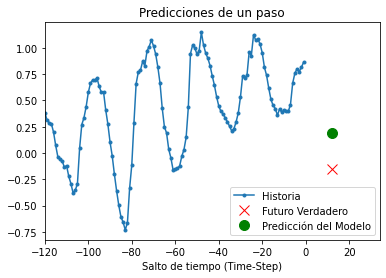

8/8 [==============================] - 0s 25ms/step


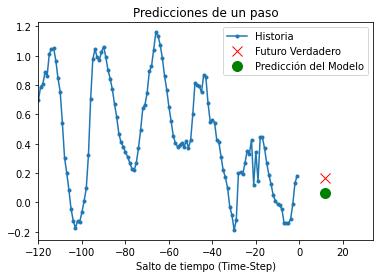

8/8 [==============================] - 0s 21ms/step


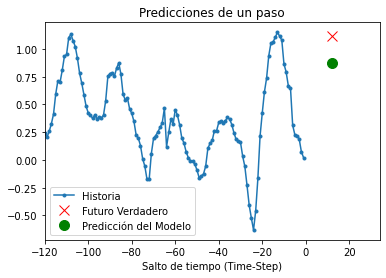

8/8 [==============================] - 0s 27ms/step


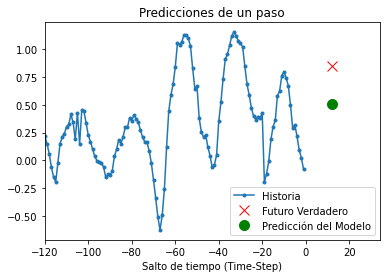

8/8 [==============================] - 0s 25ms/step


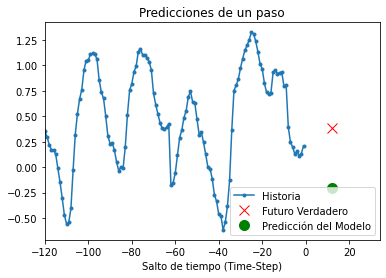

8/8 [==============================] - 0s 22ms/step


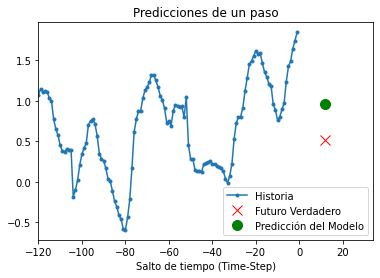

8/8 [==============================] - 0s 22ms/step


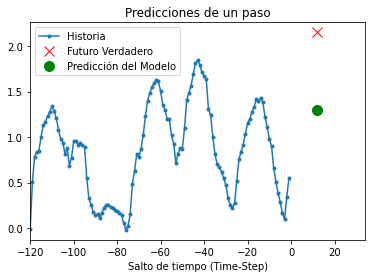

8/8 [==============================] - 0s 22ms/step


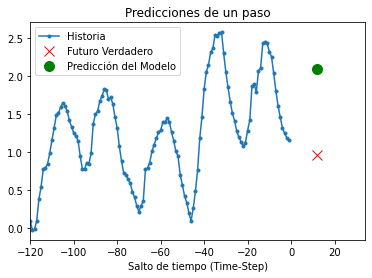

8/8 [==============================] - 0s 29ms/step


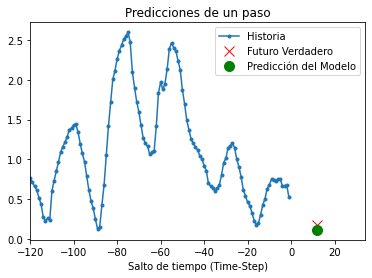

8/8 [==============================] - 0s 29ms/step


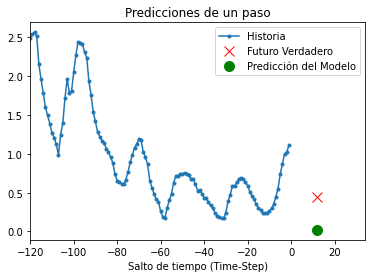

8/8 [==============================] - 0s 24ms/step


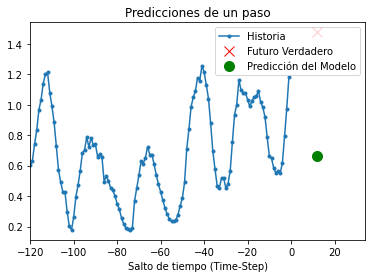

8/8 [==============================] - 0s 25ms/step


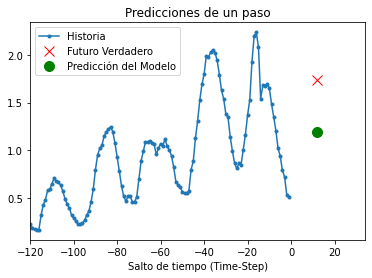

8/8 [==============================] - 0s 27ms/step


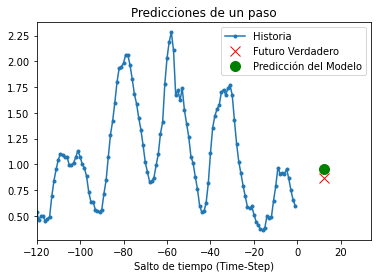

8/8 [==============================] - 0s 24ms/step


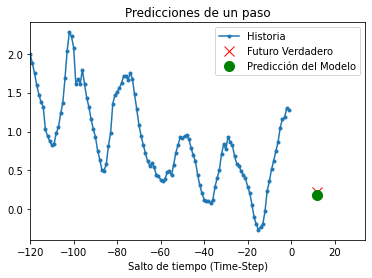

8/8 [==============================] - 0s 23ms/step


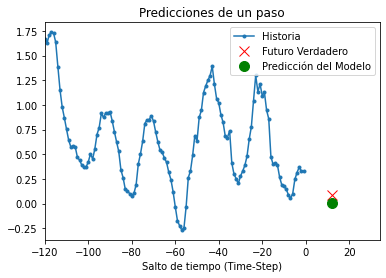

8/8 [==============================] - 0s 25ms/step


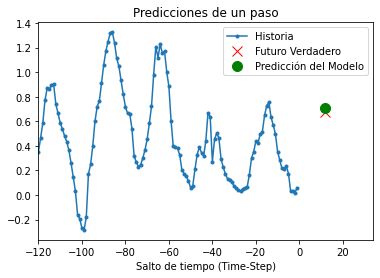

8/8 [==============================] - 0s 21ms/step


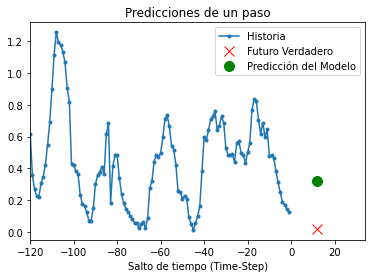

8/8 [==============================] - 0s 27ms/step


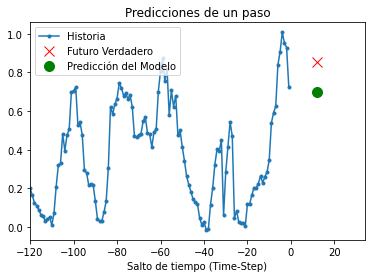

8/8 [==============================] - 0s 22ms/step


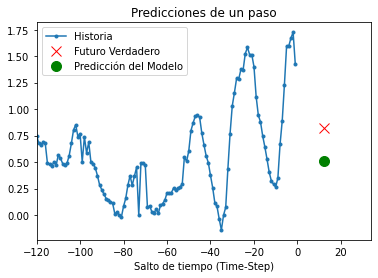

8/8 [==============================] - 0s 23ms/step


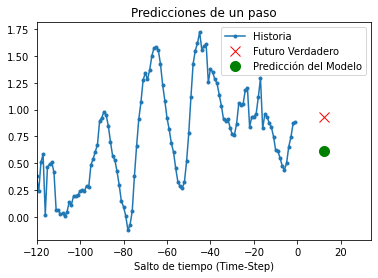

8/8 [==============================] - 0s 22ms/step


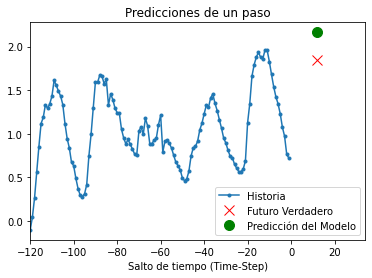

8/8 [==============================] - 0s 22ms/step


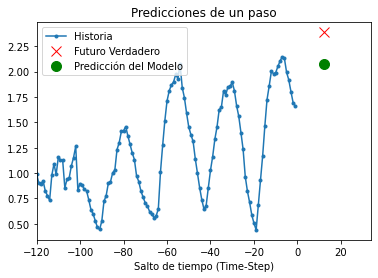

8/8 [==============================] - 0s 21ms/step


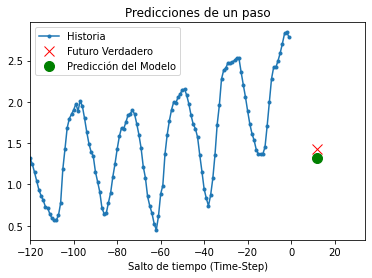

8/8 [==============================] - 0s 22ms/step


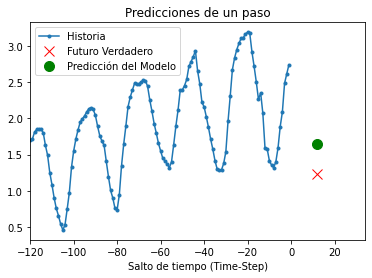

8/8 [==============================] - 0s 21ms/step


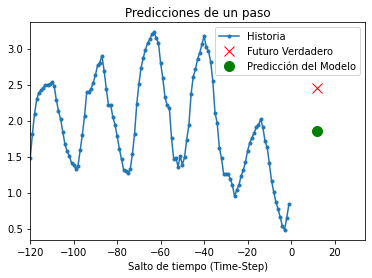

8/8 [==============================] - 0s 21ms/step


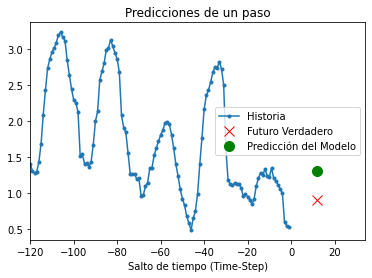

8/8 [==============================] - 0s 22ms/step


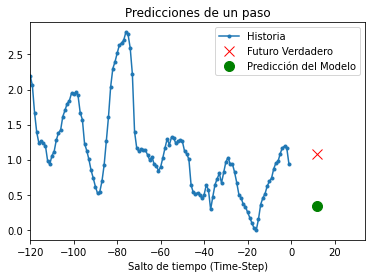

8/8 [==============================] - 0s 22ms/step


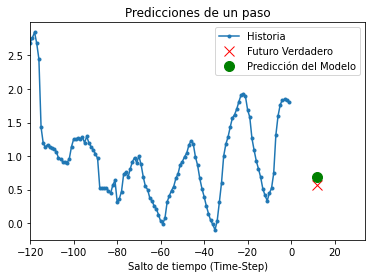

8/8 [==============================] - 0s 22ms/step


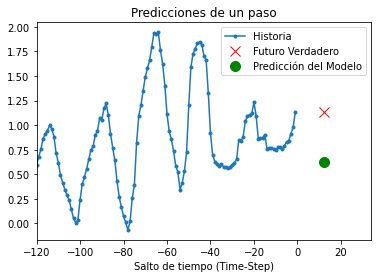

8/8 [==============================] - 0s 20ms/step


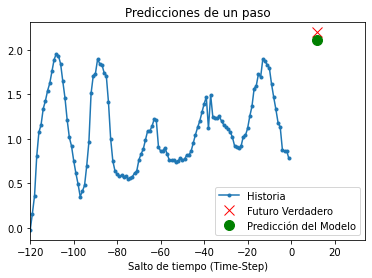

8/8 [==============================] - 0s 20ms/step


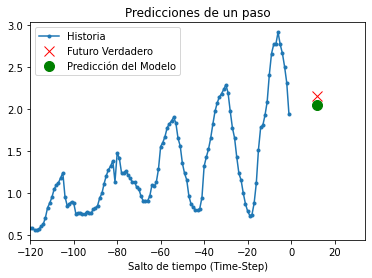

8/8 [==============================] - 0s 20ms/step


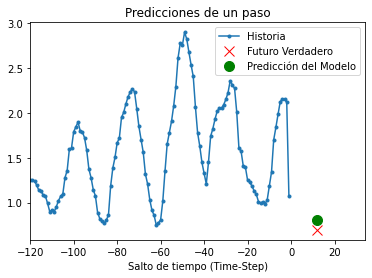

8/8 [==============================] - 0s 18ms/step


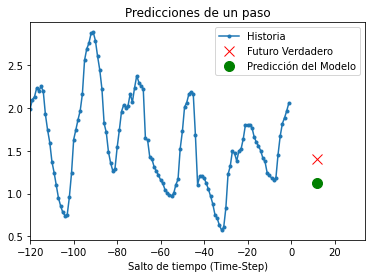

8/8 [==============================] - 0s 24ms/step


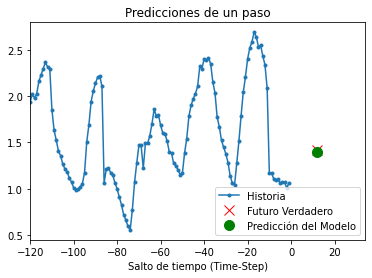

8/8 [==============================] - 0s 21ms/step


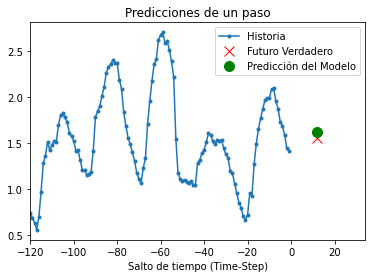

8/8 [==============================] - 0s 22ms/step


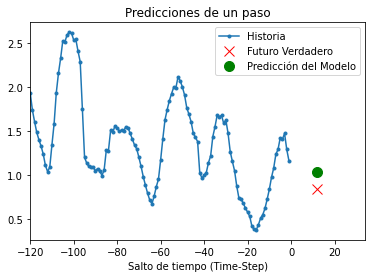

8/8 [==============================] - 0s 23ms/step


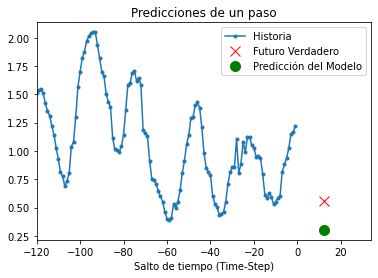

8/8 [==============================] - 0s 25ms/step


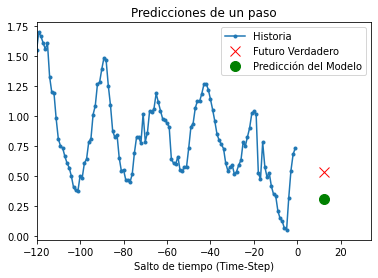

8/8 [==============================] - 0s 19ms/step


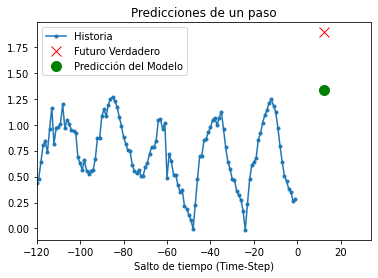

8/8 [==============================] - 0s 26ms/step


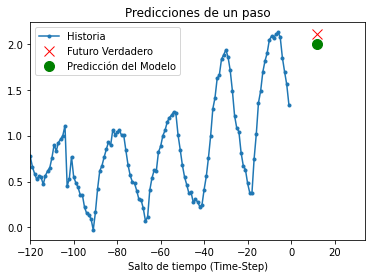

8/8 [==============================] - 0s 21ms/step


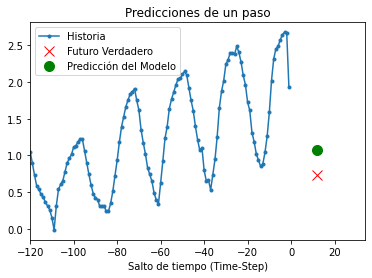

8/8 [==============================] - 0s 27ms/step


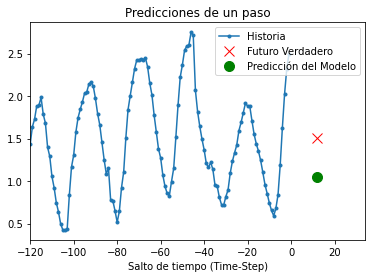

8/8 [==============================] - 0s 22ms/step


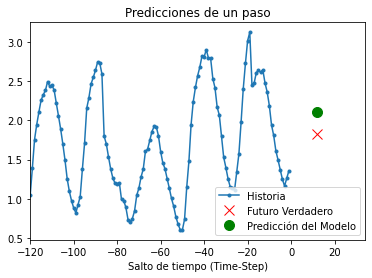

8/8 [==============================] - 0s 23ms/step


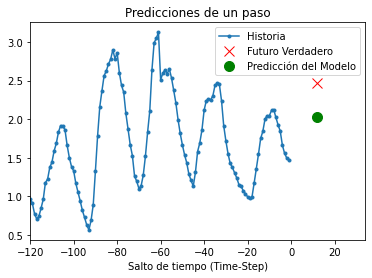

8/8 [==============================] - 0s 23ms/step


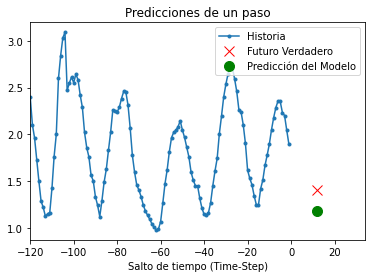

8/8 [==============================] - 0s 20ms/step


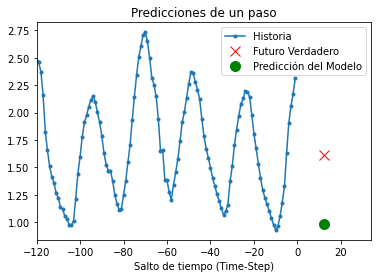

8/8 [==============================] - 0s 20ms/step


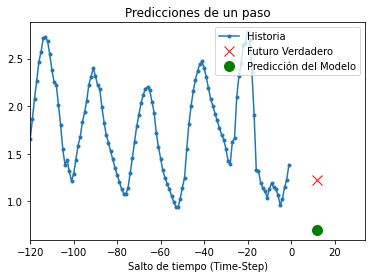

8/8 [==============================] - 0s 20ms/step


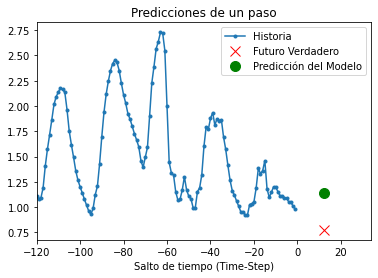

8/8 [==============================] - 0s 20ms/step


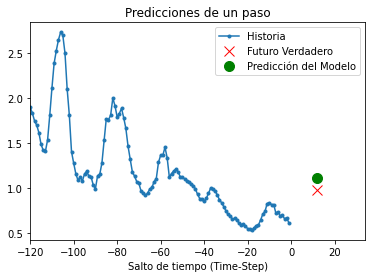

8/8 [==============================] - 0s 20ms/step


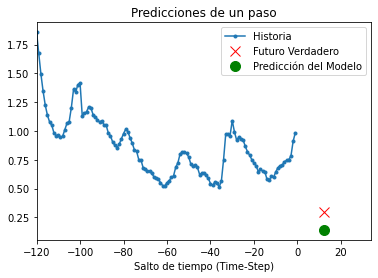

8/8 [==============================] - 0s 22ms/step


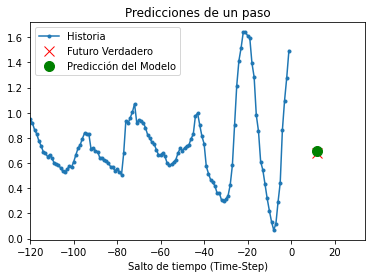

8/8 [==============================] - 0s 20ms/step


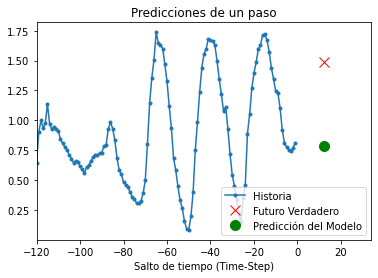

8/8 [==============================] - 0s 20ms/step


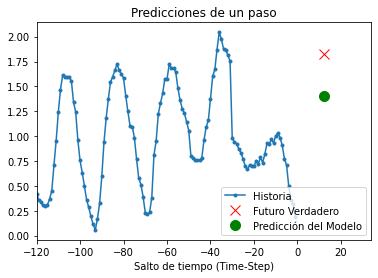

8/8 [==============================] - 0s 20ms/step


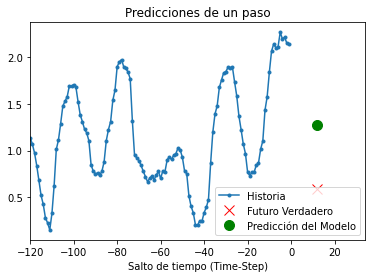

8/8 [==============================] - 0s 23ms/step


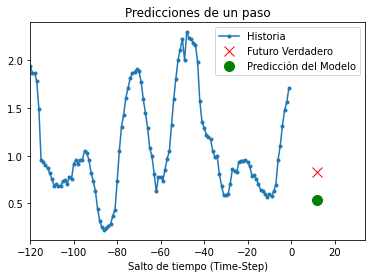

8/8 [==============================] - 0s 19ms/step


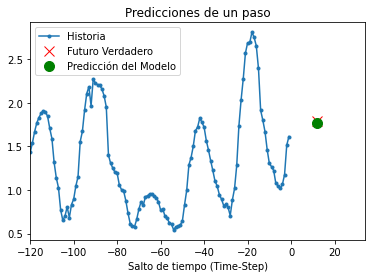

8/8 [==============================] - 0s 24ms/step


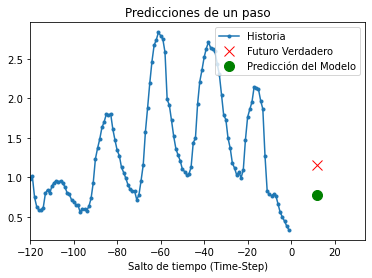

8/8 [==============================] - 0s 23ms/step


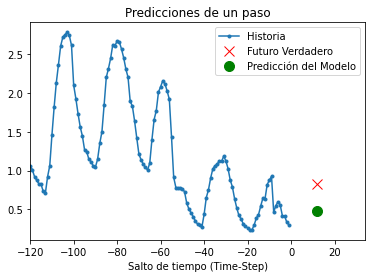

8/8 [==============================] - 0s 20ms/step


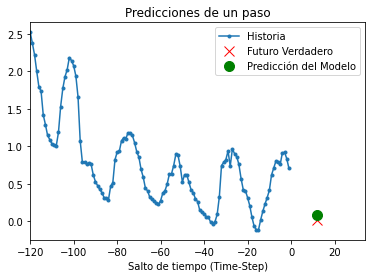

8/8 [==============================] - 0s 24ms/step


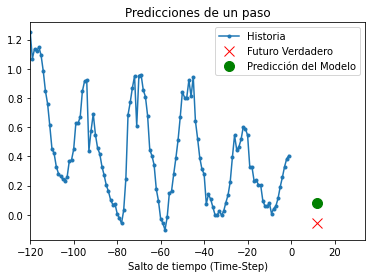

8/8 [==============================] - 0s 21ms/step


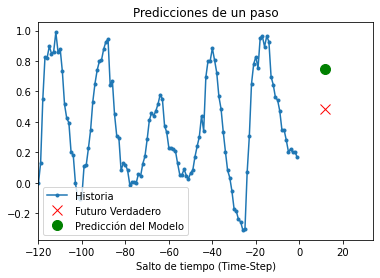

8/8 [==============================] - 0s 26ms/step


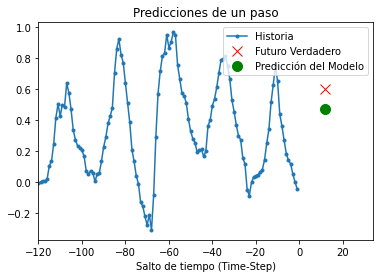

8/8 [==============================] - 0s 27ms/step


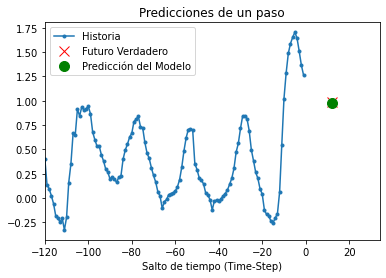

8/8 [==============================] - 0s 22ms/step


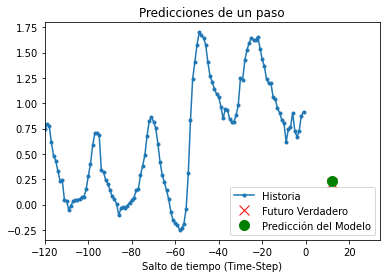

8/8 [==============================] - 0s 25ms/step


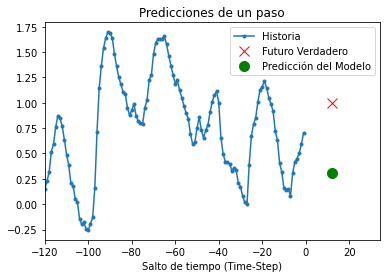

8/8 [==============================] - 0s 27ms/step


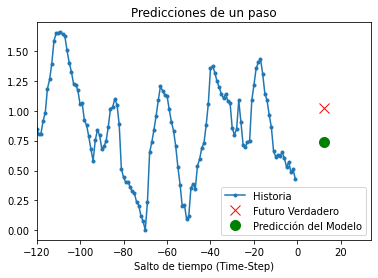

8/8 [==============================] - 0s 27ms/step


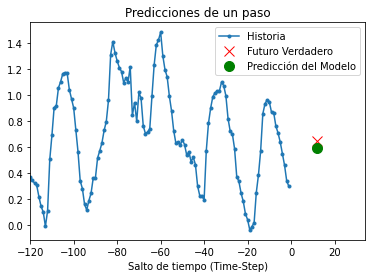

8/8 [==============================] - 0s 29ms/step


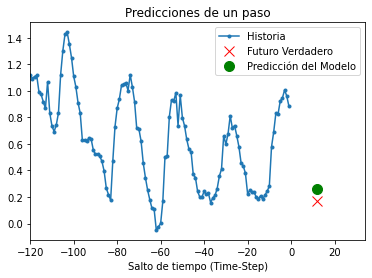

8/8 [==============================] - 0s 23ms/step


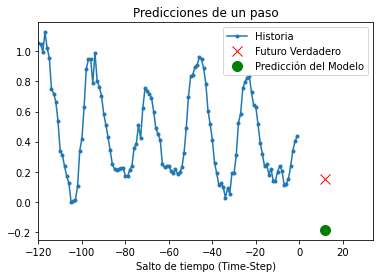

8/8 [==============================] - 0s 23ms/step


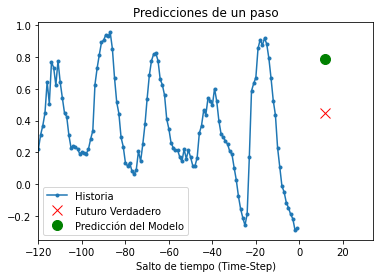

8/8 [==============================] - 0s 22ms/step


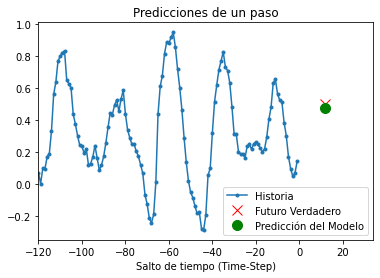

8/8 [==============================] - 0s 20ms/step


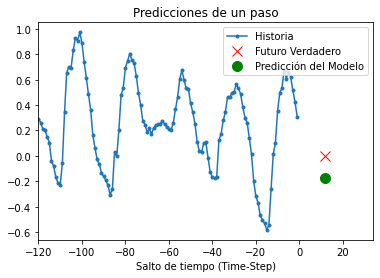

8/8 [==============================] - 0s 21ms/step


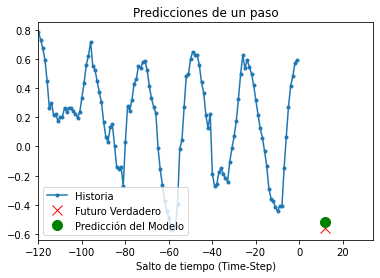

8/8 [==============================] - 0s 21ms/step


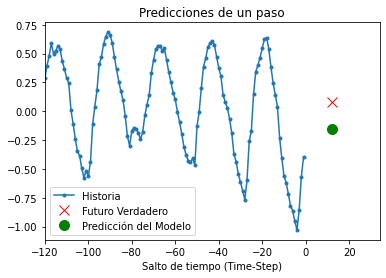

8/8 [==============================] - 0s 21ms/step


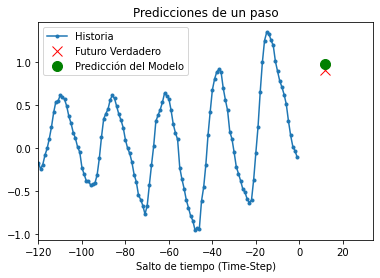

8/8 [==============================] - 0s 20ms/step


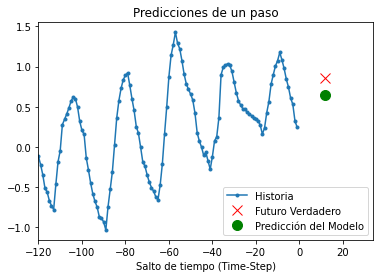

8/8 [==============================] - 0s 26ms/step


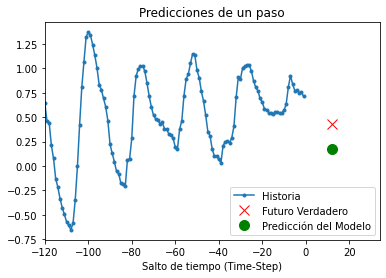

8/8 [==============================] - 0s 23ms/step


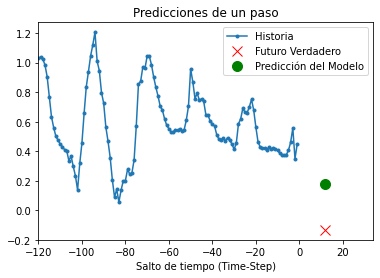

8/8 [==============================] - 0s 22ms/step


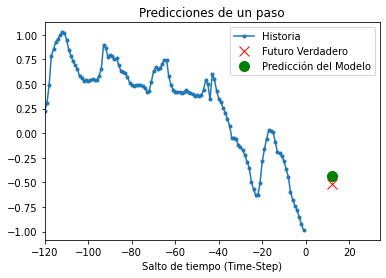

8/8 [==============================] - 0s 22ms/step


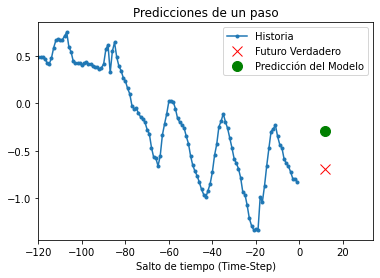

8/8 [==============================] - 0s 20ms/step


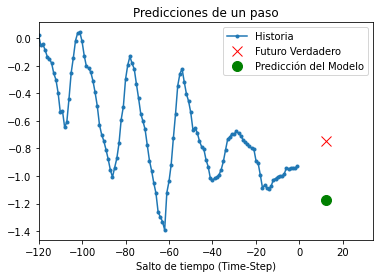

8/8 [==============================] - 0s 20ms/step


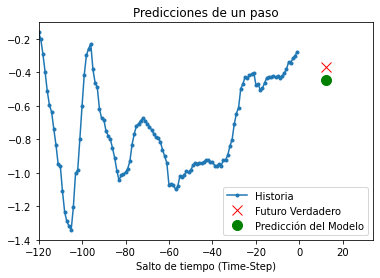

8/8 [==============================] - 0s 25ms/step


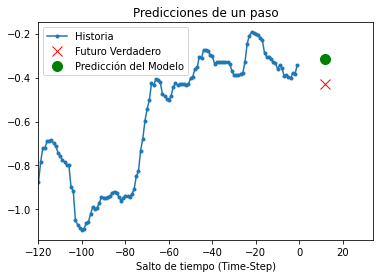

8/8 [==============================] - 0s 21ms/step


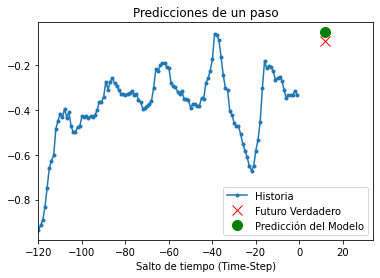

8/8 [==============================] - 0s 24ms/step


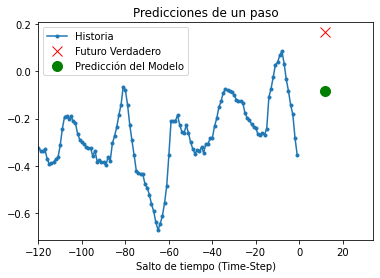

8/8 [==============================] - 0s 22ms/step


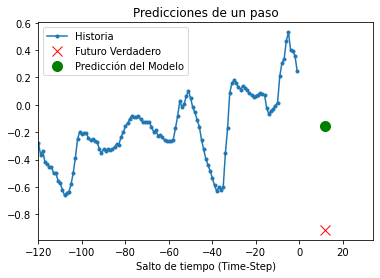

8/8 [==============================] - 0s 21ms/step


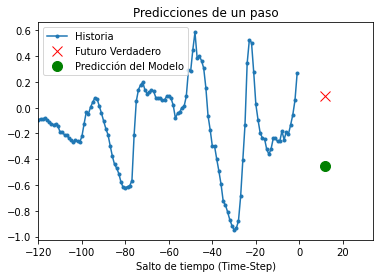

8/8 [==============================] - 0s 21ms/step


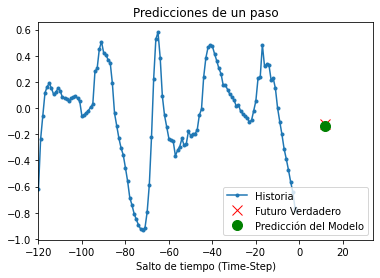

8/8 [==============================] - 0s 22ms/step


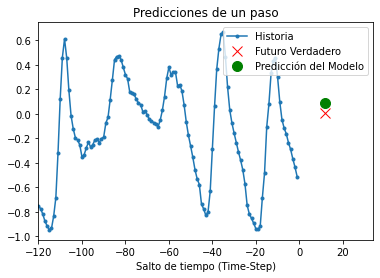

8/8 [==============================] - 0s 20ms/step


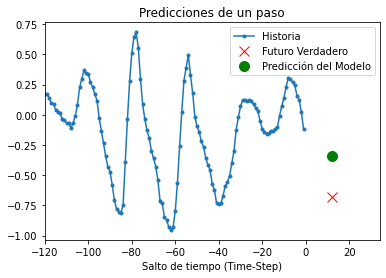

8/8 [==============================] - 0s 25ms/step


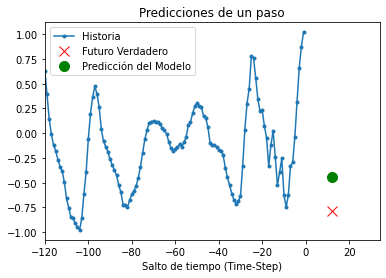

8/8 [==============================] - 0s 21ms/step


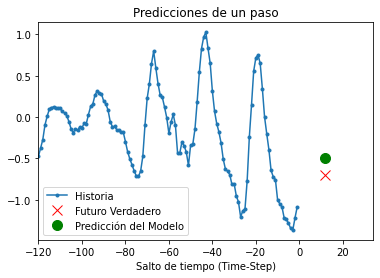

8/8 [==============================] - 0s 24ms/step


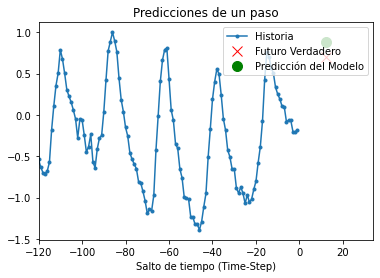

8/8 [==============================] - 0s 22ms/step


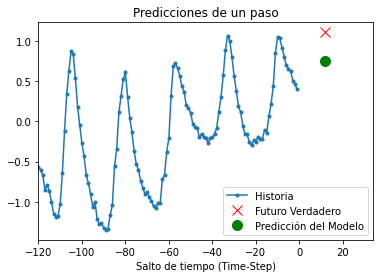

8/8 [==============================] - 0s 21ms/step


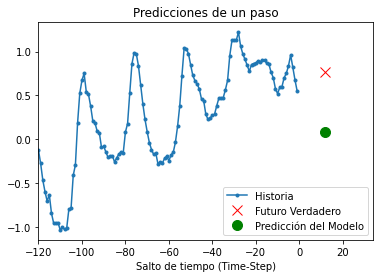

8/8 [==============================] - 0s 20ms/step


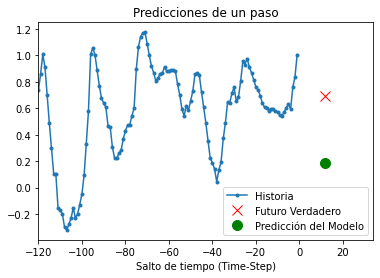

8/8 [==============================] - 0s 21ms/step


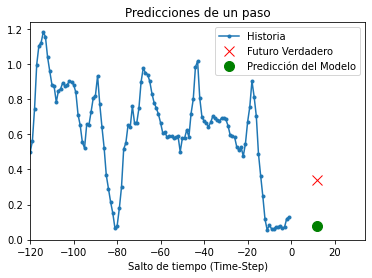

8/8 [==============================] - 0s 20ms/step


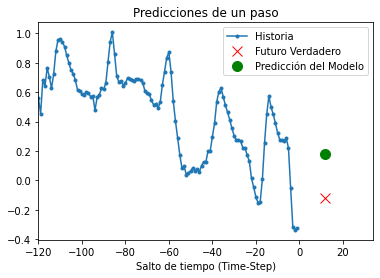

8/8 [==============================] - 0s 20ms/step


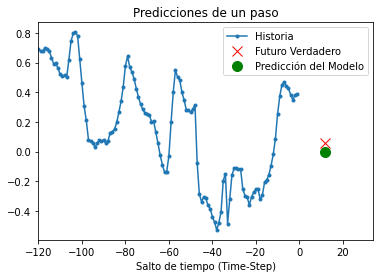

8/8 [==============================] - 0s 23ms/step


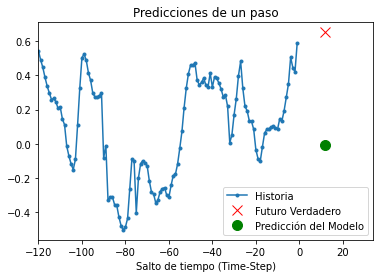

8/8 [==============================] - 0s 21ms/step


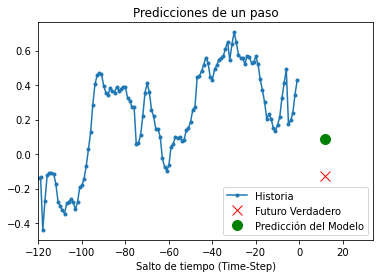

8/8 [==============================] - 0s 23ms/step


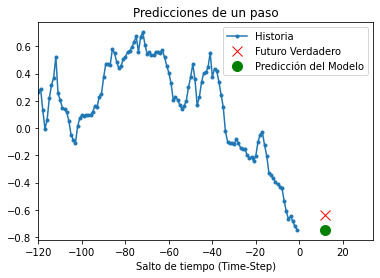

8/8 [==============================] - 0s 21ms/step


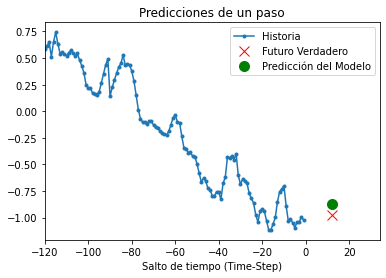

8/8 [==============================] - 0s 20ms/step


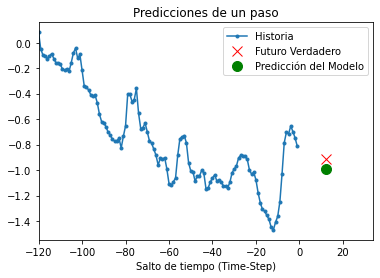

8/8 [==============================] - 0s 22ms/step


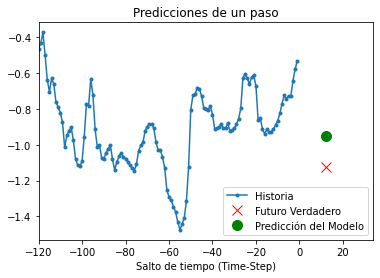

8/8 [==============================] - 0s 24ms/step


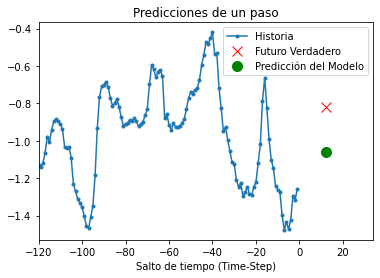

8/8 [==============================] - 0s 20ms/step


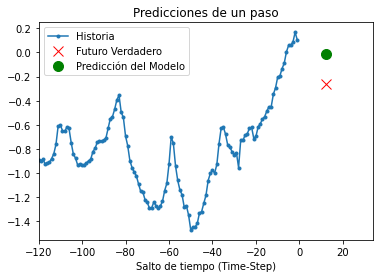

8/8 [==============================] - 0s 29ms/step


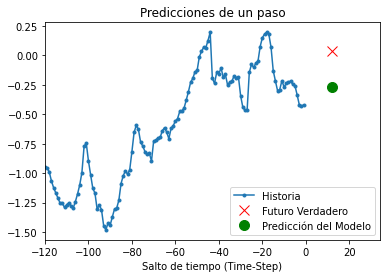

8/8 [==============================] - 0s 23ms/step


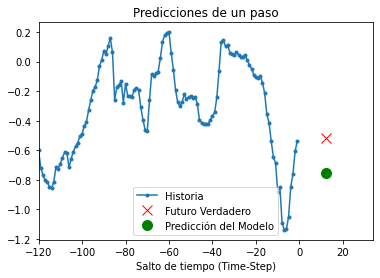

8/8 [==============================] - 0s 22ms/step


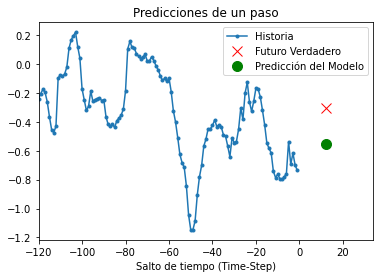

8/8 [==============================] - 0s 23ms/step


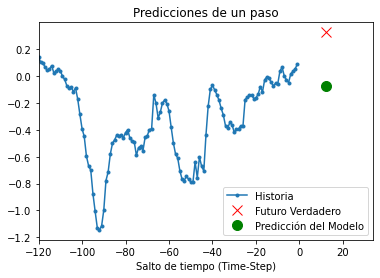

8/8 [==============================] - 0s 21ms/step


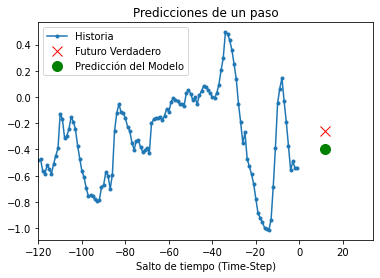

8/8 [==============================] - 0s 21ms/step


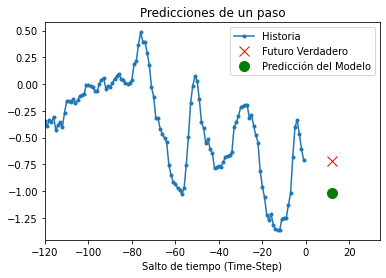

8/8 [==============================] - 0s 23ms/step


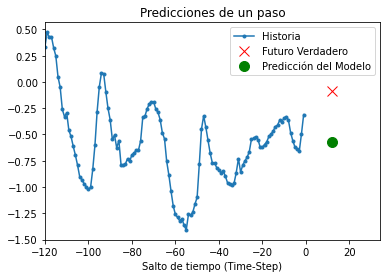

8/8 [==============================] - 0s 18ms/step


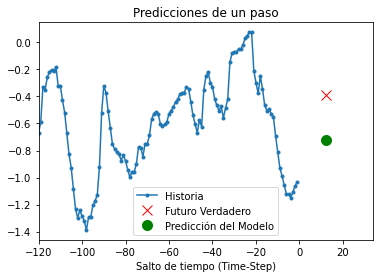

8/8 [==============================] - 0s 23ms/step


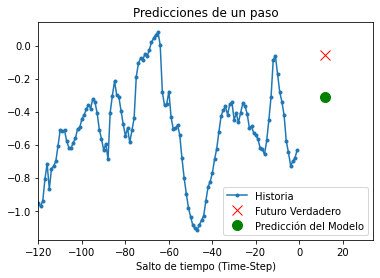

8/8 [==============================] - 0s 22ms/step


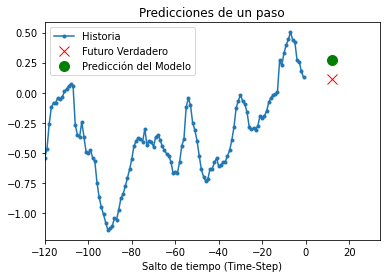

8/8 [==============================] - 0s 19ms/step


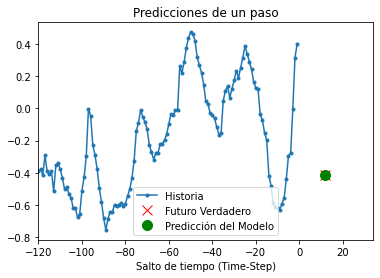

8/8 [==============================] - 0s 24ms/step


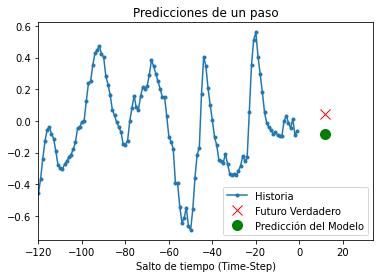

8/8 [==============================] - 0s 24ms/step


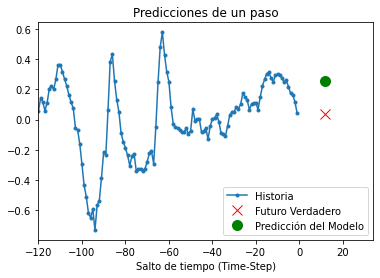

8/8 [==============================] - 0s 25ms/step


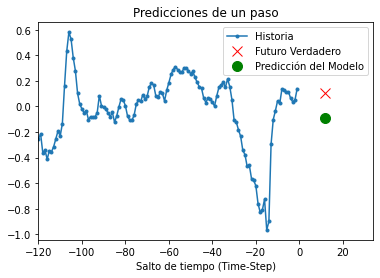

8/8 [==============================] - 0s 24ms/step


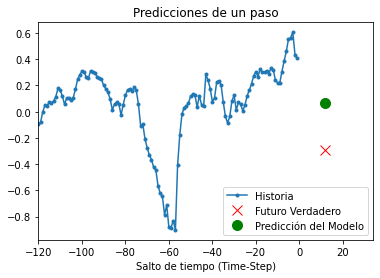

8/8 [==============================] - 0s 20ms/step


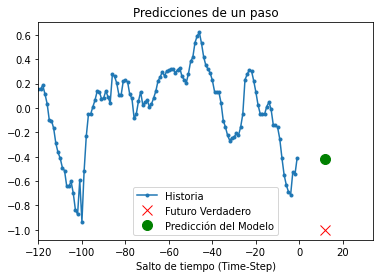

8/8 [==============================] - 0s 23ms/step


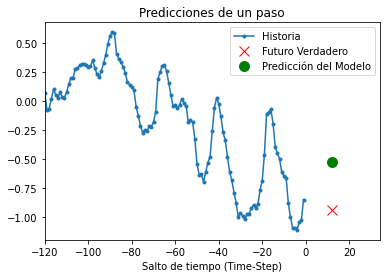

8/8 [==============================] - 0s 24ms/step


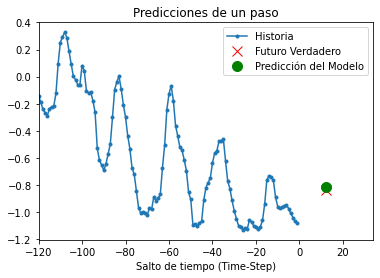

8/8 [==============================] - 0s 20ms/step


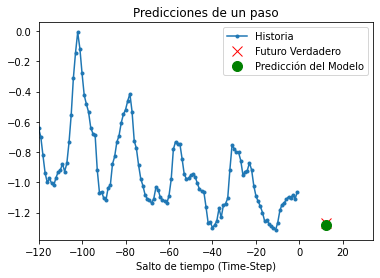

8/8 [==============================] - 0s 26ms/step


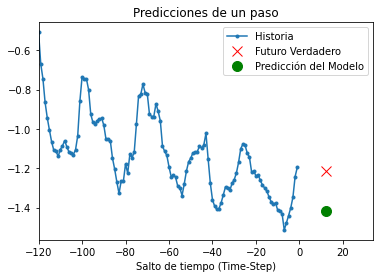

8/8 [==============================] - 0s 31ms/step


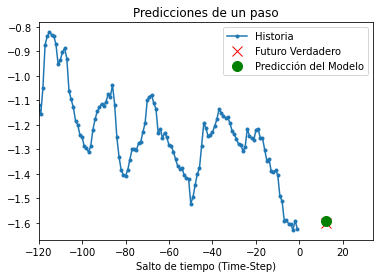

8/8 [==============================] - 0s 23ms/step


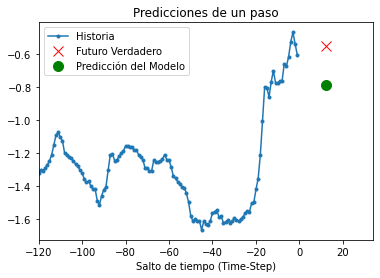

8/8 [==============================] - 0s 22ms/step


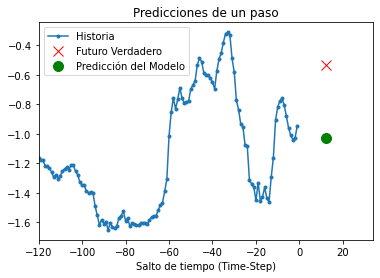

8/8 [==============================] - 0s 27ms/step


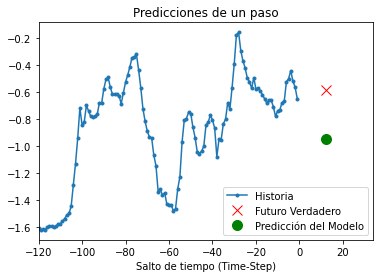

8/8 [==============================] - 0s 22ms/step


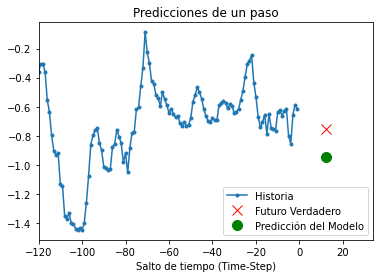

8/8 [==============================] - 0s 23ms/step


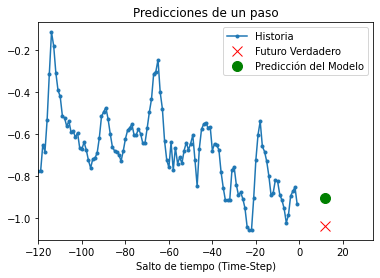

8/8 [==============================] - 0s 24ms/step


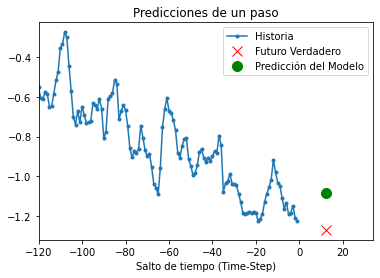

8/8 [==============================] - 0s 22ms/step


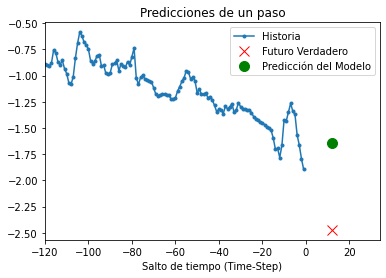

8/8 [==============================] - 0s 18ms/step


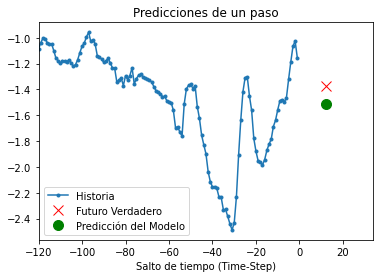

8/8 [==============================] - 0s 21ms/step


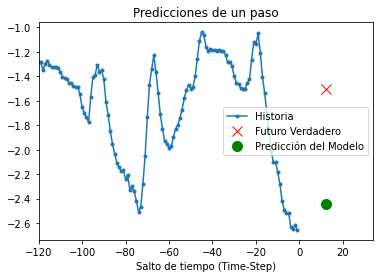

8/8 [==============================] - 0s 22ms/step


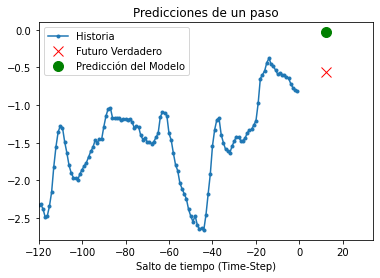

8/8 [==============================] - 0s 22ms/step


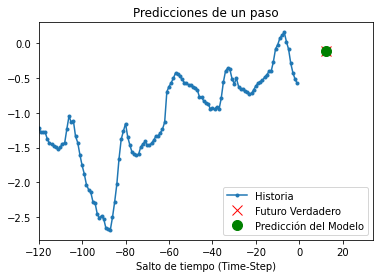

8/8 [==============================] - 0s 19ms/step


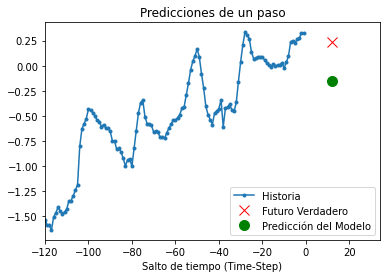

8/8 [==============================] - 0s 19ms/step


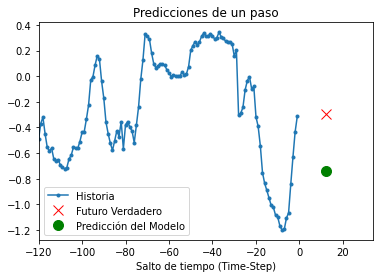

8/8 [==============================] - 0s 20ms/step


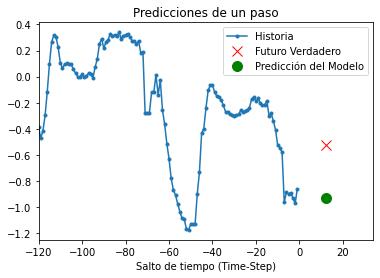

8/8 [==============================] - 0s 23ms/step


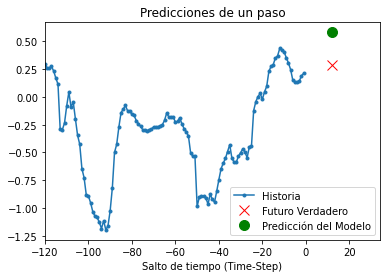

8/8 [==============================] - 0s 23ms/step


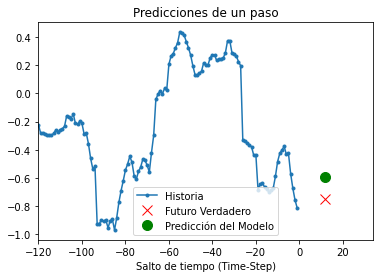

8/8 [==============================] - 0s 20ms/step


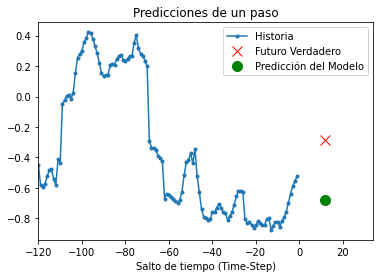

8/8 [==============================] - 0s 22ms/step


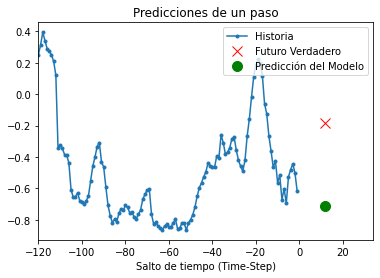

8/8 [==============================] - 0s 21ms/step


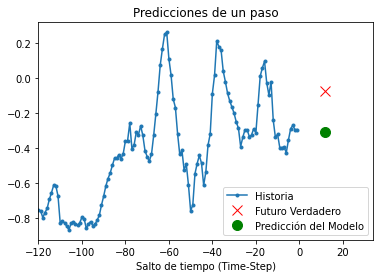

8/8 [==============================] - 0s 22ms/step


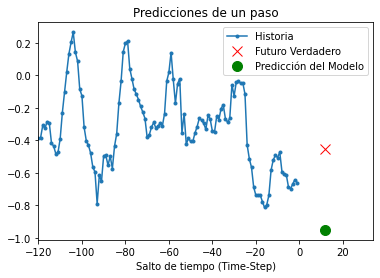

8/8 [==============================] - 0s 22ms/step


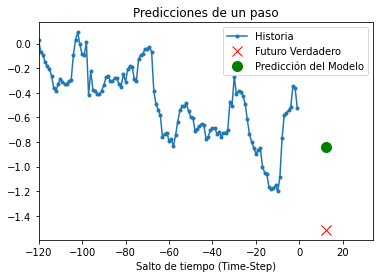

8/8 [==============================] - 0s 22ms/step


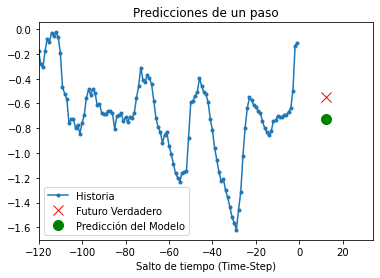

8/8 [==============================] - 0s 23ms/step


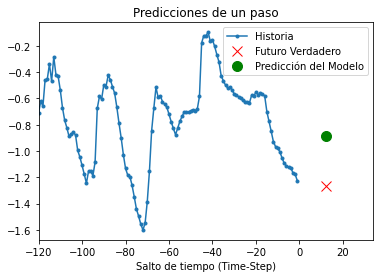

8/8 [==============================] - 0s 21ms/step


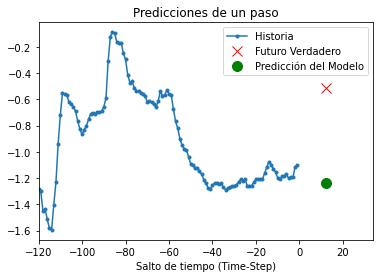

8/8 [==============================] - 0s 19ms/step


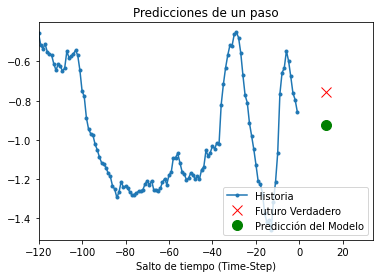

8/8 [==============================] - 0s 20ms/step


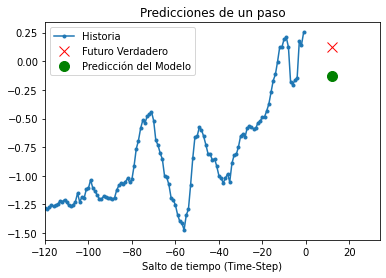

8/8 [==============================] - 0s 22ms/step


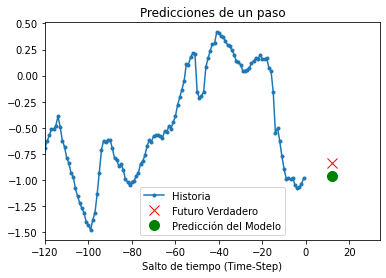

8/8 [==============================] - 0s 23ms/step


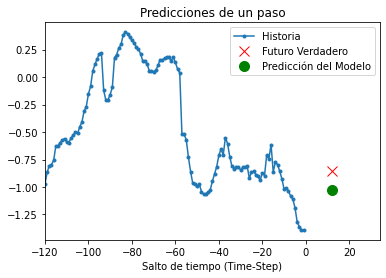

8/8 [==============================] - 0s 16ms/step


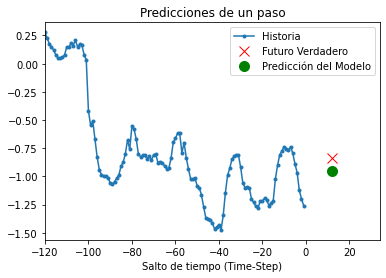

8/8 [==============================] - 0s 23ms/step


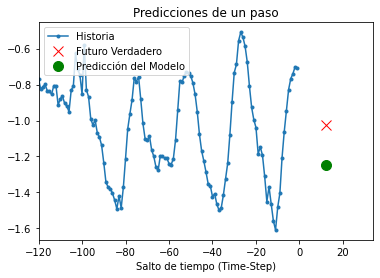

8/8 [==============================] - 0s 22ms/step


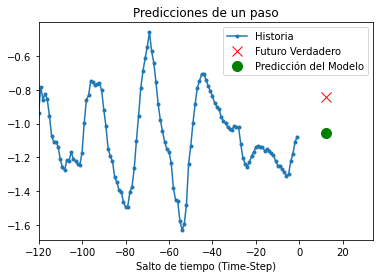

8/8 [==============================] - 0s 21ms/step


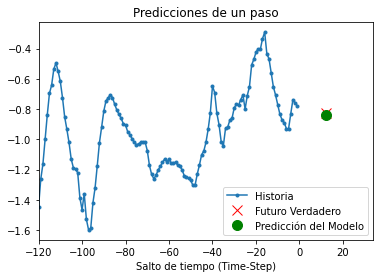

8/8 [==============================] - 0s 25ms/step


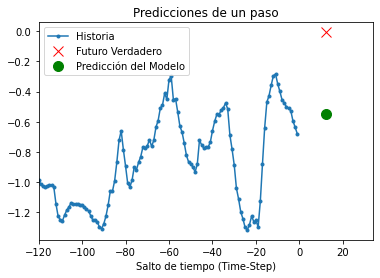

8/8 [==============================] - 0s 23ms/step


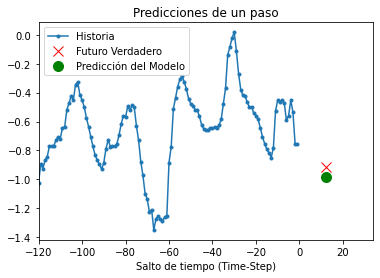

8/8 [==============================] - 0s 21ms/step


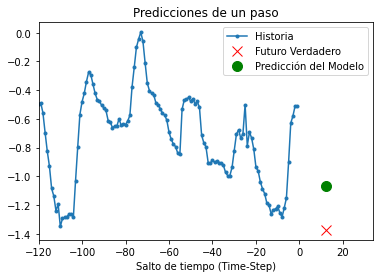

8/8 [==============================] - 0s 22ms/step


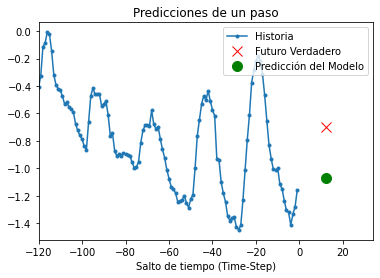

8/8 [==============================] - 0s 18ms/step


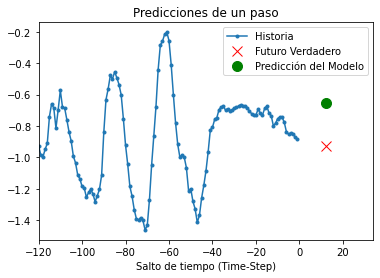

8/8 [==============================] - 0s 17ms/step


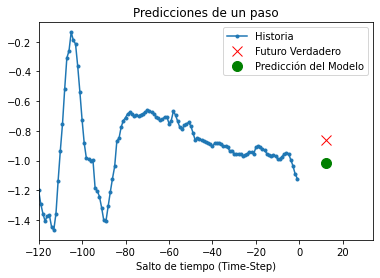

8/8 [==============================] - 0s 19ms/step


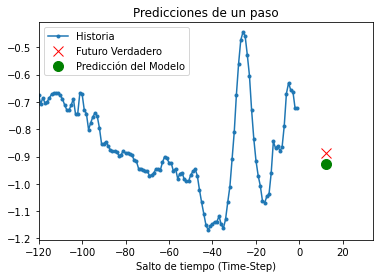

8/8 [==============================] - 0s 19ms/step


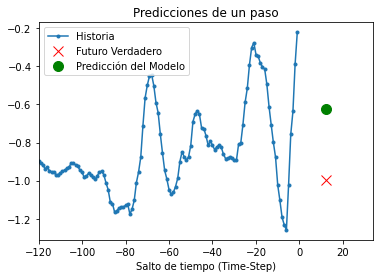

8/8 [==============================] - 0s 22ms/step


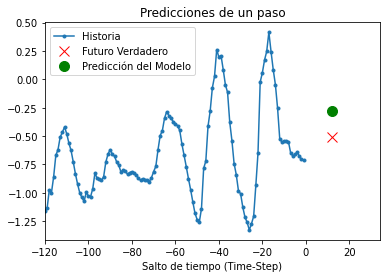

8/8 [==============================] - 0s 22ms/step


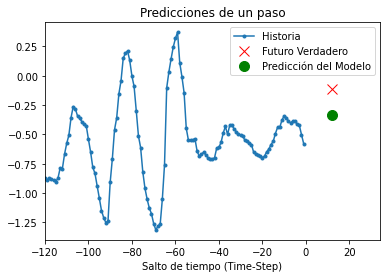

8/8 [==============================] - 0s 23ms/step


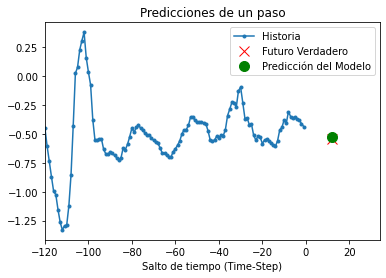

8/8 [==============================] - 0s 22ms/step


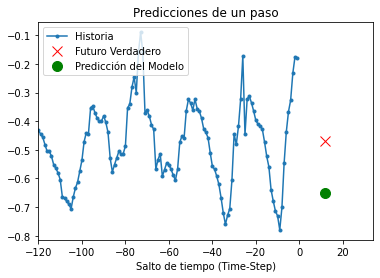

8/8 [==============================] - 0s 23ms/step


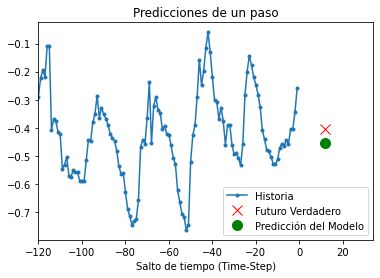

8/8 [==============================] - 0s 23ms/step


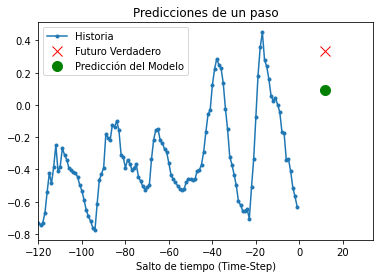

8/8 [==============================] - 0s 23ms/step


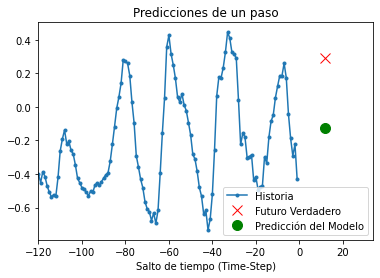

8/8 [==============================] - 0s 22ms/step


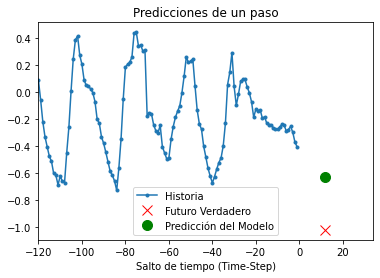

8/8 [==============================] - 0s 24ms/step


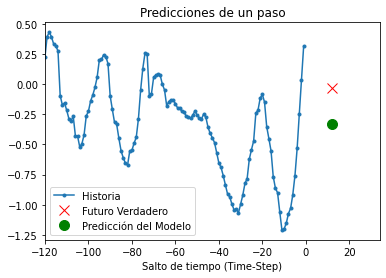

8/8 [==============================] - 0s 23ms/step


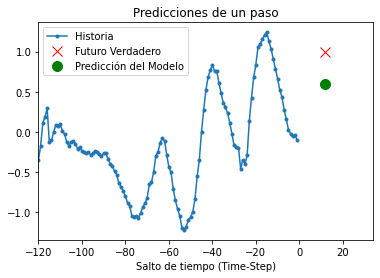

8/8 [==============================] - 0s 24ms/step


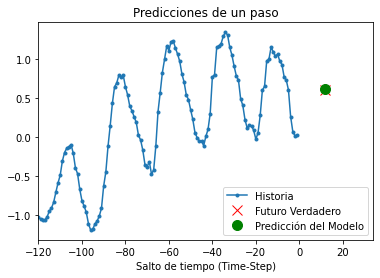

8/8 [==============================] - 0s 24ms/step


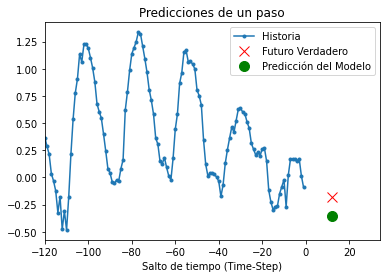

8/8 [==============================] - 0s 23ms/step


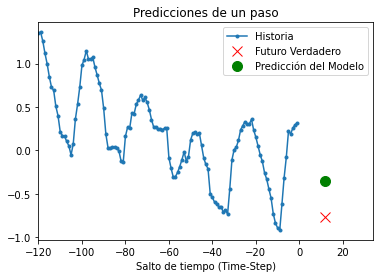

8/8 [==============================] - 0s 22ms/step


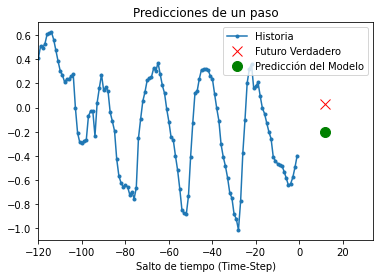

8/8 [==============================] - 0s 21ms/step


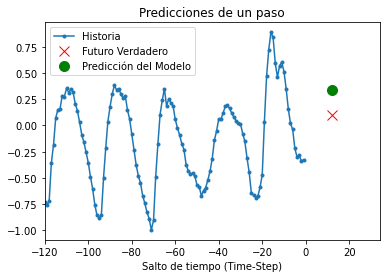

8/8 [==============================] - 0s 23ms/step


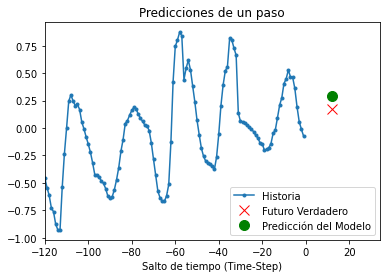

8/8 [==============================] - 0s 22ms/step


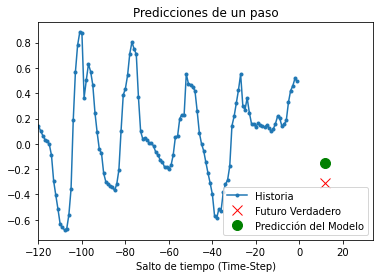

8/8 [==============================] - 0s 23ms/step


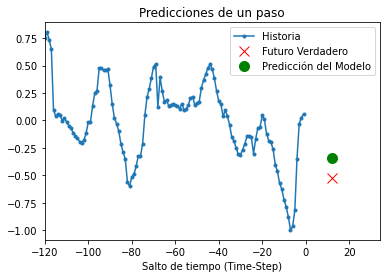

8/8 [==============================] - 0s 22ms/step


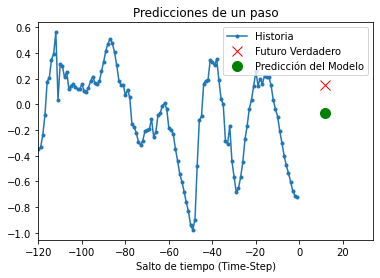

8/8 [==============================] - 0s 23ms/step


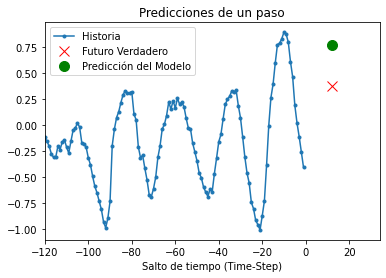

8/8 [==============================] - 0s 21ms/step


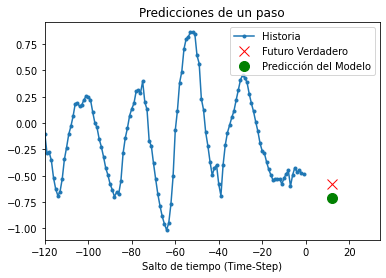

8/8 [==============================] - 0s 23ms/step


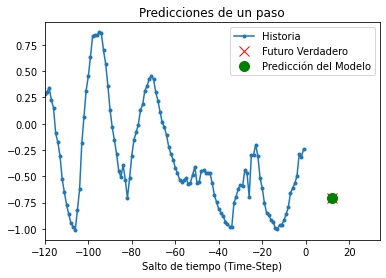

8/8 [==============================] - 0s 21ms/step


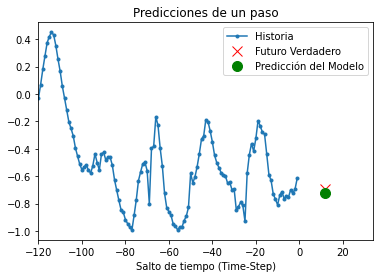

8/8 [==============================] - 0s 23ms/step


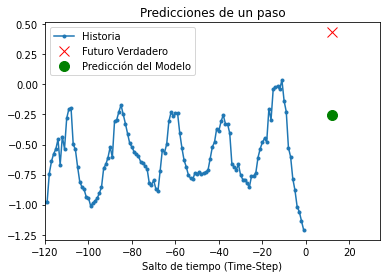

8/8 [==============================] - 0s 25ms/step


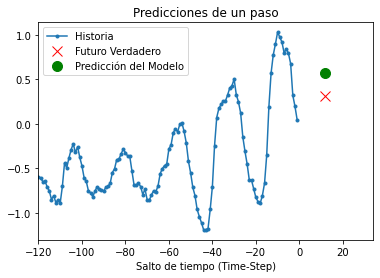

8/8 [==============================] - 0s 22ms/step


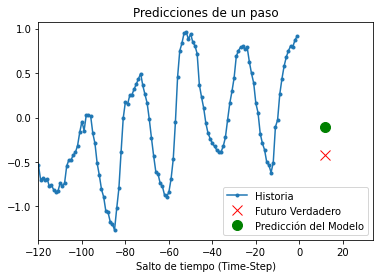

8/8 [==============================] - 0s 19ms/step


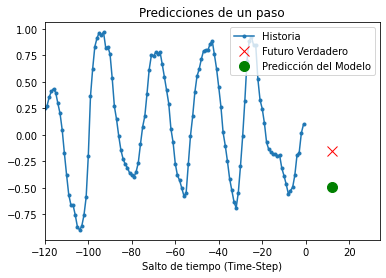

8/8 [==============================] - 0s 21ms/step


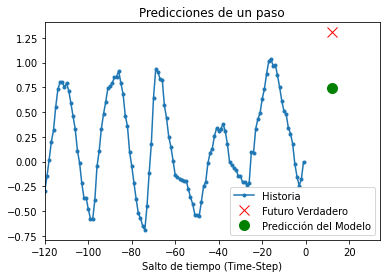

8/8 [==============================] - 0s 19ms/step


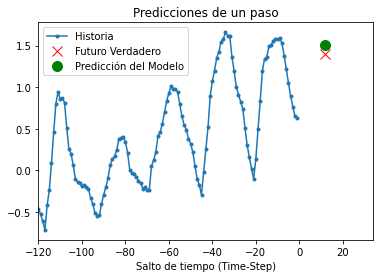

8/8 [==============================] - 0s 19ms/step


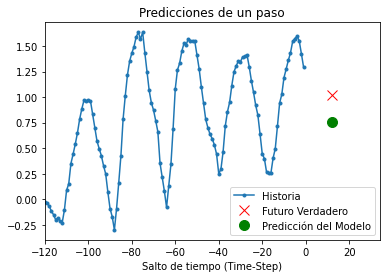

8/8 [==============================] - 0s 21ms/step


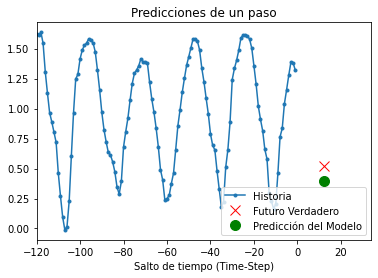

8/8 [==============================] - 0s 23ms/step


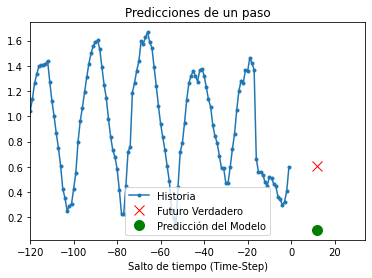

8/8 [==============================] - 0s 20ms/step


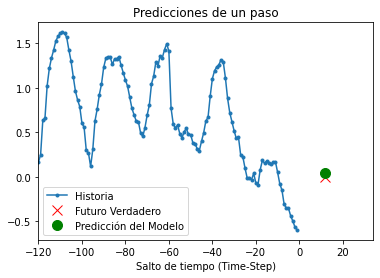

8/8 [==============================] - 0s 20ms/step


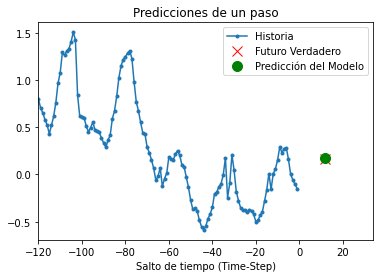

8/8 [==============================] - 0s 22ms/step


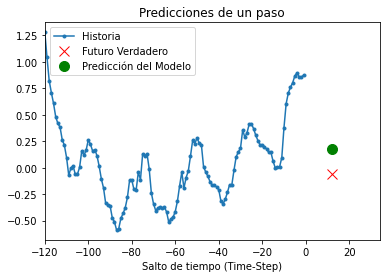

8/8 [==============================] - 0s 20ms/step


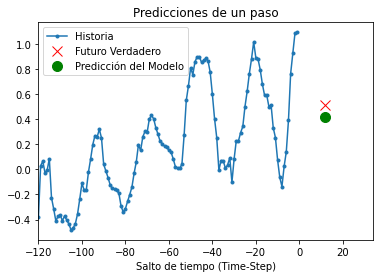

8/8 [==============================] - 0s 20ms/step


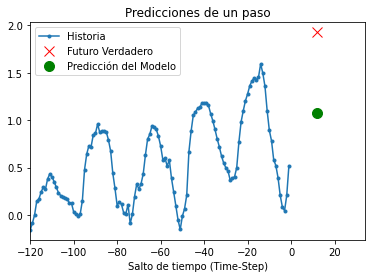

8/8 [==============================] - 0s 23ms/step


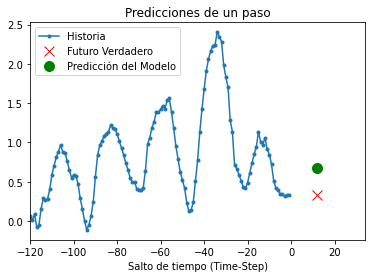

8/8 [==============================] - 0s 23ms/step


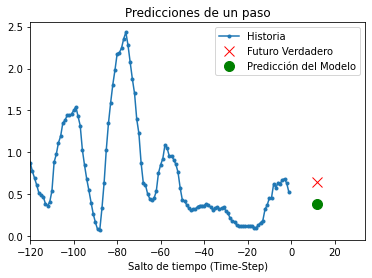

8/8 [==============================] - 0s 20ms/step


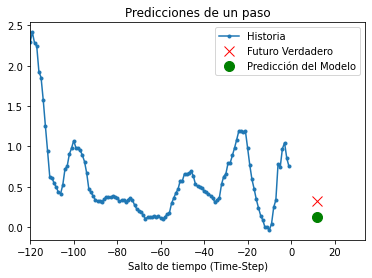

8/8 [==============================] - 0s 25ms/step


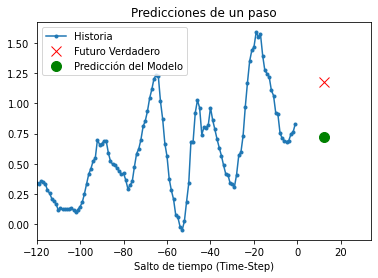

8/8 [==============================] - 0s 26ms/step


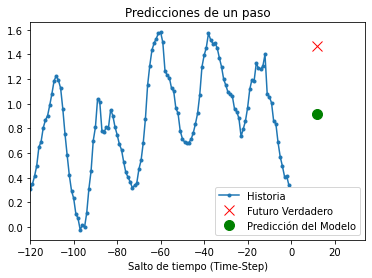

8/8 [==============================] - 0s 25ms/step


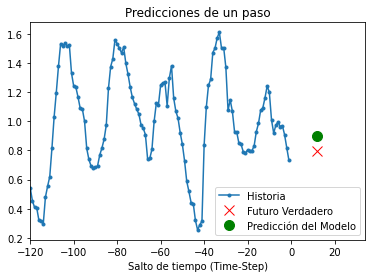

8/8 [==============================] - 0s 29ms/step


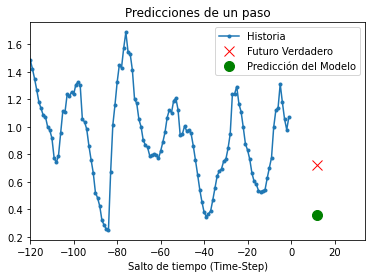

8/8 [==============================] - 0s 20ms/step


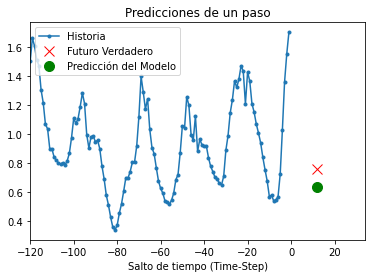

8/8 [==============================] - 0s 20ms/step


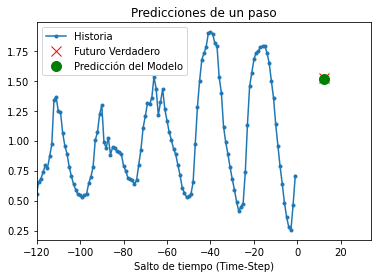

8/8 [==============================] - 0s 20ms/step


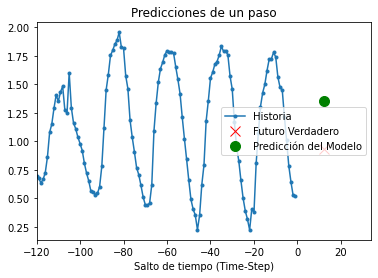

8/8 [==============================] - 0s 20ms/step


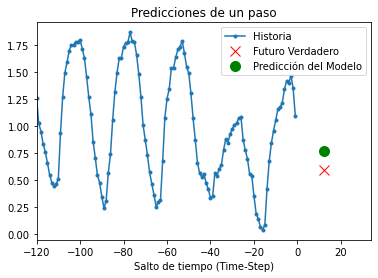

8/8 [==============================] - 0s 19ms/step


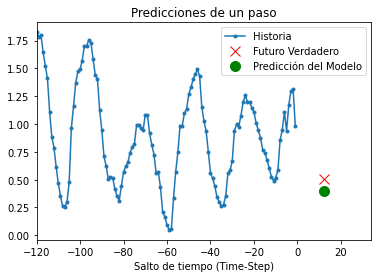

8/8 [==============================] - 0s 25ms/step


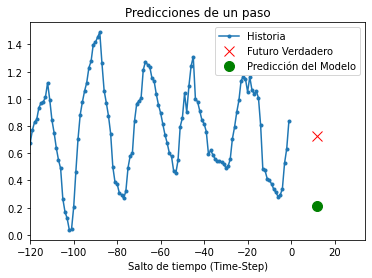

8/8 [==============================] - 0s 20ms/step


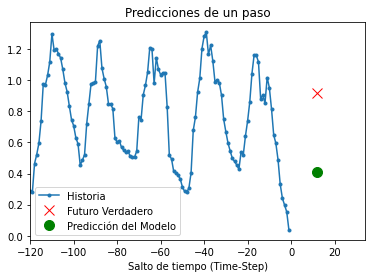

8/8 [==============================] - 1s 26ms/step


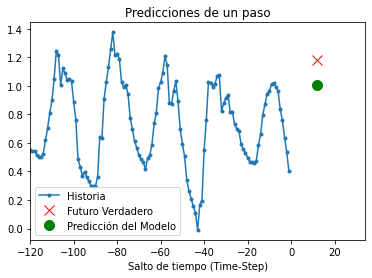

8/8 [==============================] - 0s 26ms/step


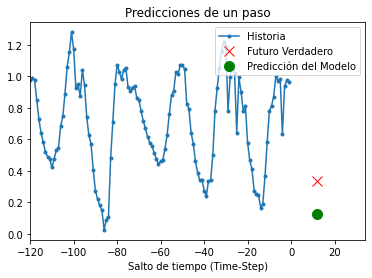

8/8 [==============================] - 0s 24ms/step


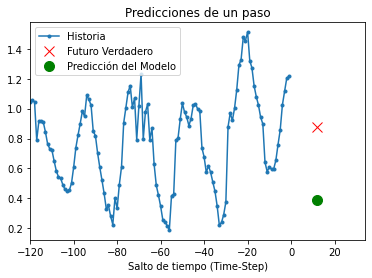

8/8 [==============================] - 0s 22ms/step


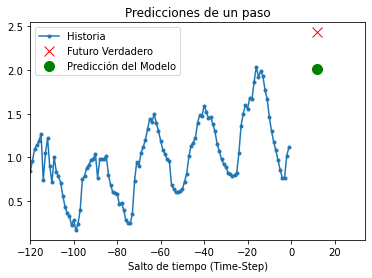

8/8 [==============================] - 0s 19ms/step


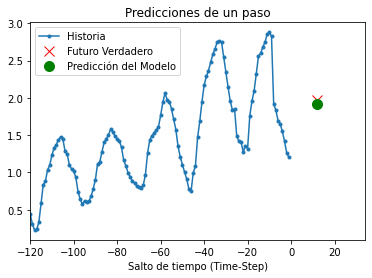

8/8 [==============================] - 0s 22ms/step


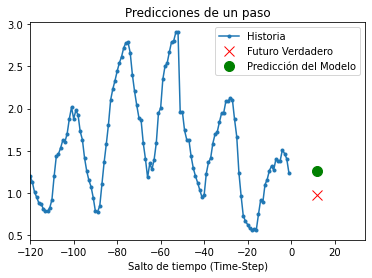

8/8 [==============================] - 0s 20ms/step


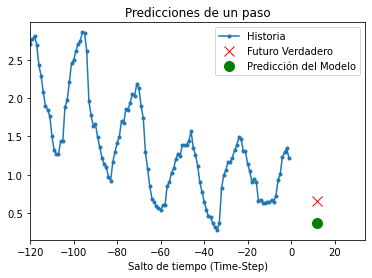

8/8 [==============================] - 0s 21ms/step


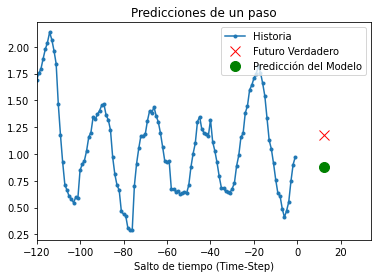

8/8 [==============================] - 0s 22ms/step


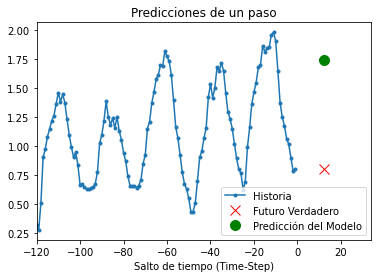

8/8 [==============================] - 0s 21ms/step


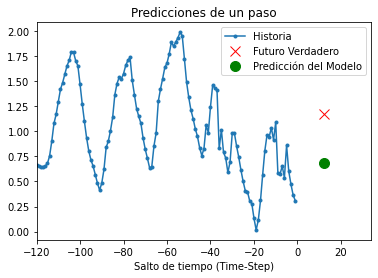

8/8 [==============================] - 0s 20ms/step


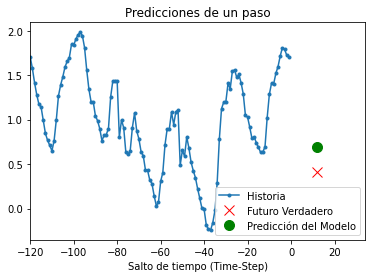

8/8 [==============================] - 0s 21ms/step


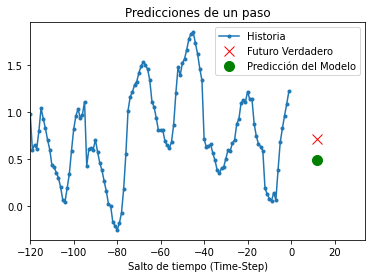

8/8 [==============================] - 0s 19ms/step


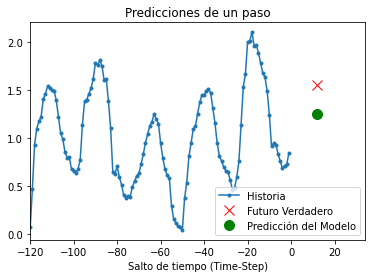

8/8 [==============================] - 0s 21ms/step


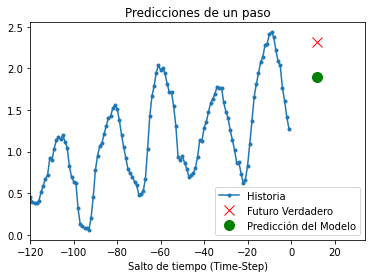

8/8 [==============================] - 0s 20ms/step


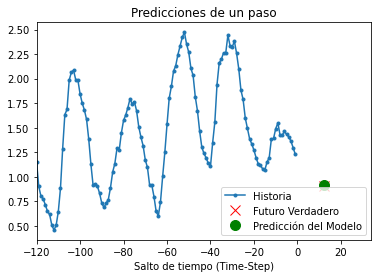

8/8 [==============================] - 0s 20ms/step


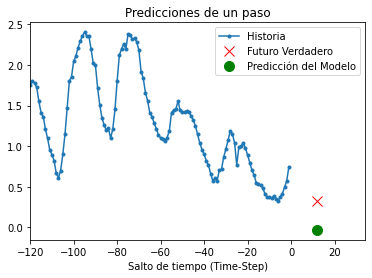

8/8 [==============================] - 0s 19ms/step


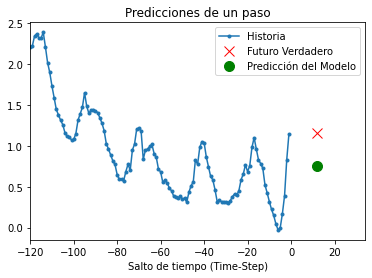

8/8 [==============================] - 0s 18ms/step


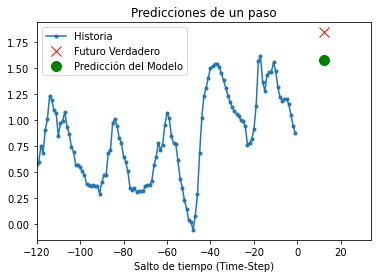

8/8 [==============================] - 0s 19ms/step


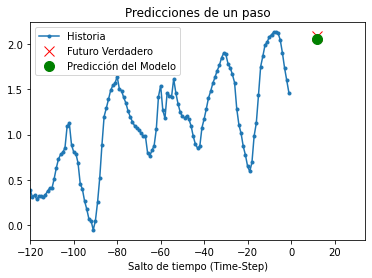

8/8 [==============================] - 0s 19ms/step


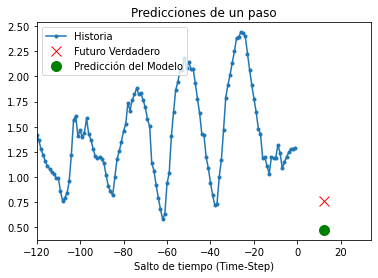

8/8 [==============================] - 0s 20ms/step


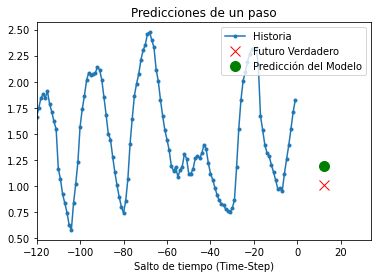

8/8 [==============================] - 0s 20ms/step


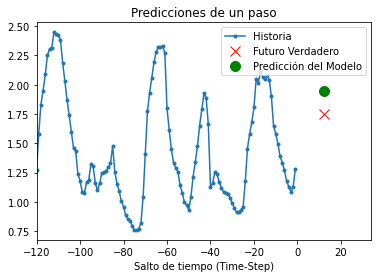

8/8 [==============================] - 0s 18ms/step


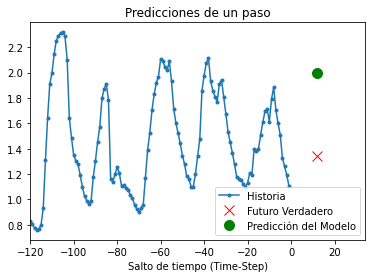

8/8 [==============================] - 0s 20ms/step


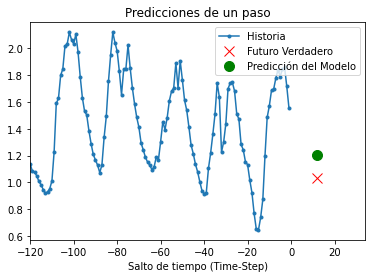

8/8 [==============================] - 0s 21ms/step


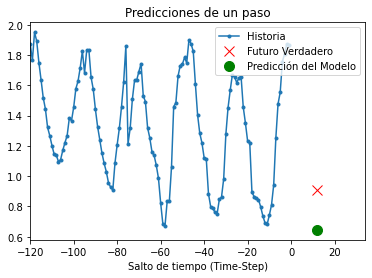

8/8 [==============================] - 0s 19ms/step


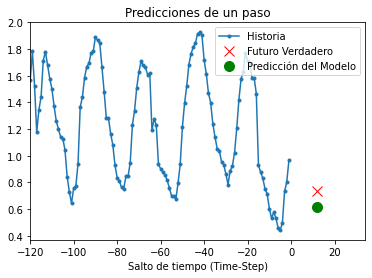

8/8 [==============================] - 0s 20ms/step


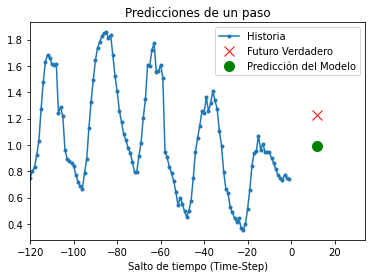

8/8 [==============================] - 0s 19ms/step


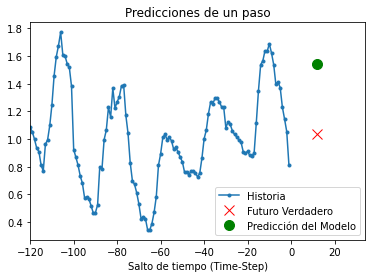

8/8 [==============================] - 0s 18ms/step


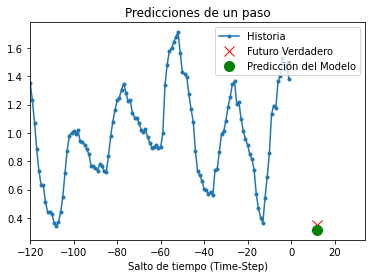

8/8 [==============================] - 0s 18ms/step


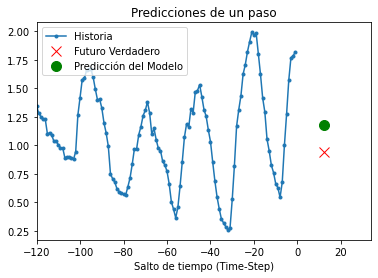

8/8 [==============================] - 0s 18ms/step


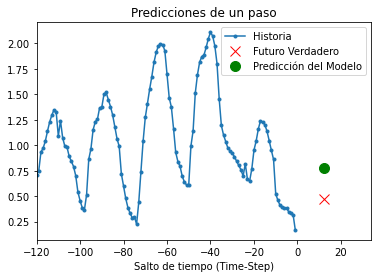

8/8 [==============================] - 0s 19ms/step


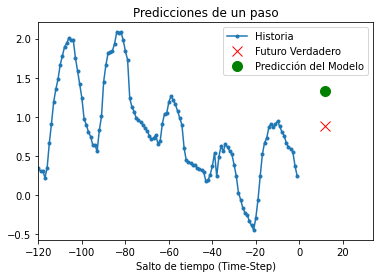

8/8 [==============================] - 0s 19ms/step


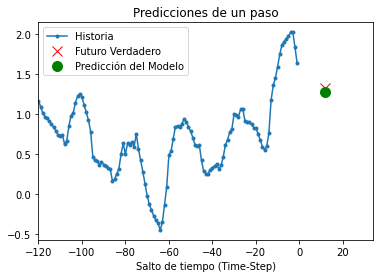

8/8 [==============================] - 0s 19ms/step


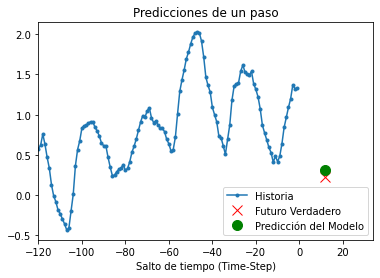

8/8 [==============================] - 0s 19ms/step


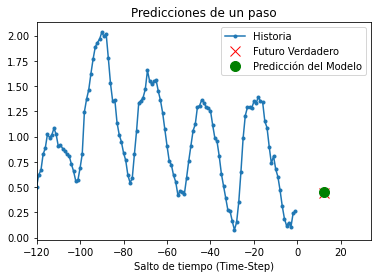

8/8 [==============================] - 0s 21ms/step


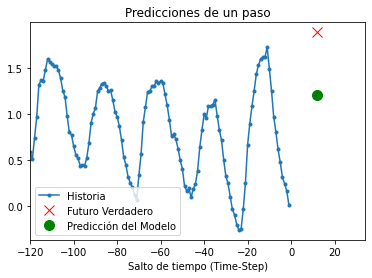

8/8 [==============================] - 0s 22ms/step


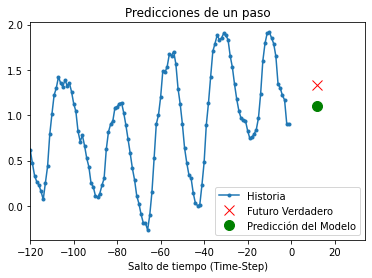

8/8 [==============================] - 0s 21ms/step


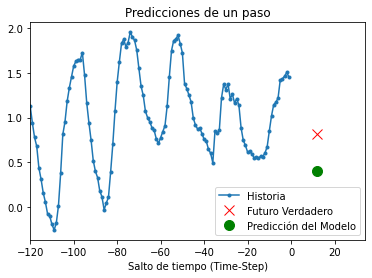

8/8 [==============================] - 0s 23ms/step


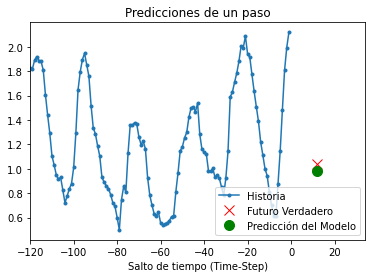

8/8 [==============================] - 0s 21ms/step


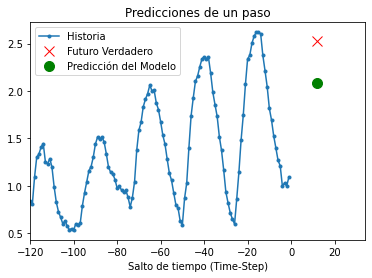

8/8 [==============================] - 0s 23ms/step


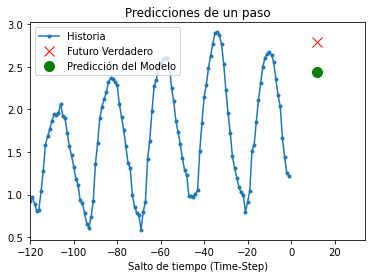

8/8 [==============================] - 0s 23ms/step


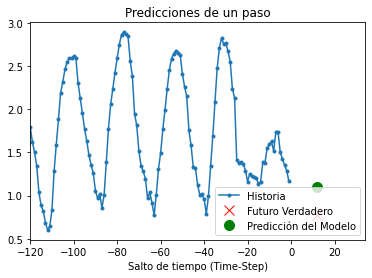

8/8 [==============================] - 0s 22ms/step


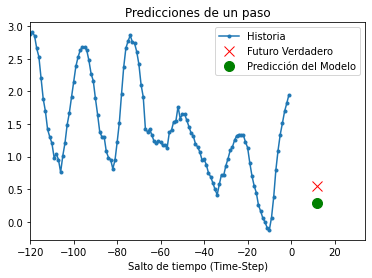

8/8 [==============================] - 0s 23ms/step


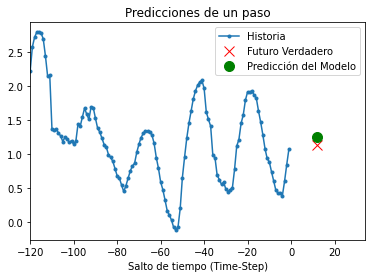

8/8 [==============================] - 0s 19ms/step


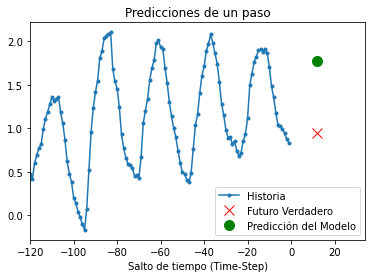

8/8 [==============================] - 0s 21ms/step


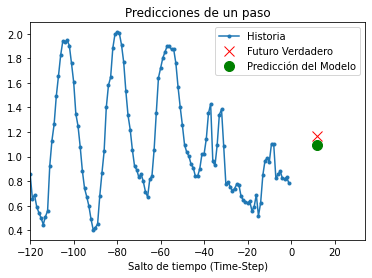

8/8 [==============================] - 0s 23ms/step


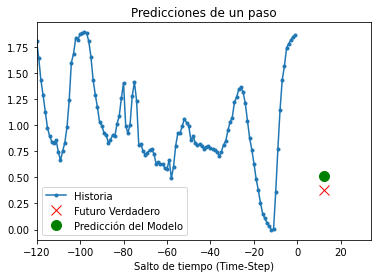

8/8 [==============================] - 0s 22ms/step


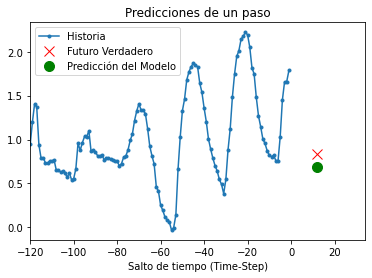

8/8 [==============================] - 0s 21ms/step


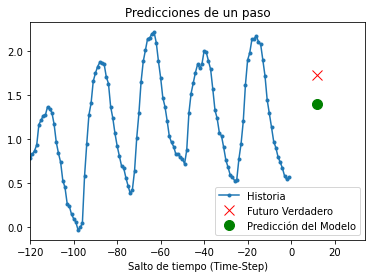

8/8 [==============================] - 0s 21ms/step


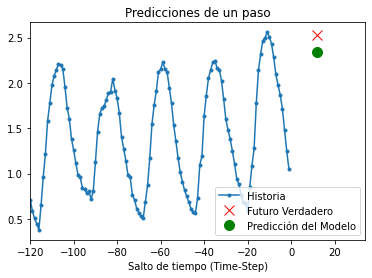

8/8 [==============================] - 0s 21ms/step


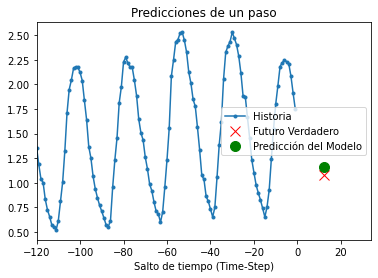

8/8 [==============================] - 0s 18ms/step


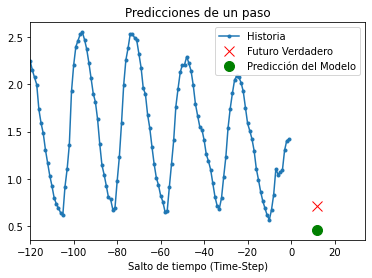

8/8 [==============================] - 0s 22ms/step


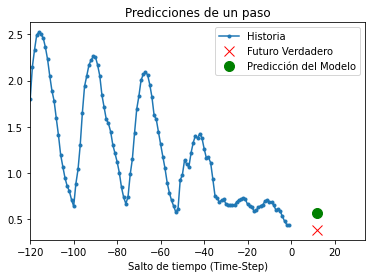

8/8 [==============================] - 0s 21ms/step


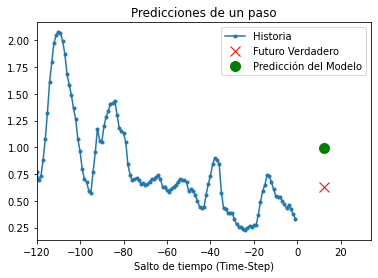

8/8 [==============================] - 0s 24ms/step


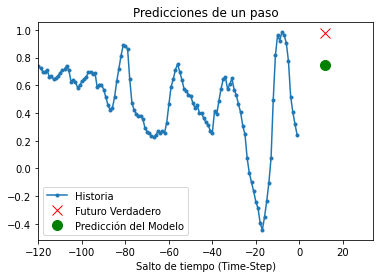

8/8 [==============================] - 0s 22ms/step


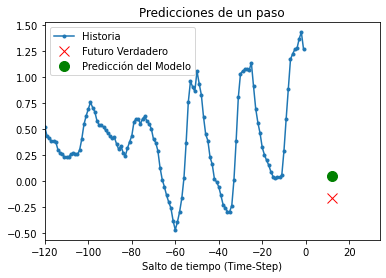

8/8 [==============================] - 0s 24ms/step


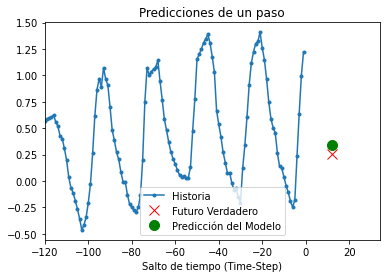

8/8 [==============================] - 0s 22ms/step


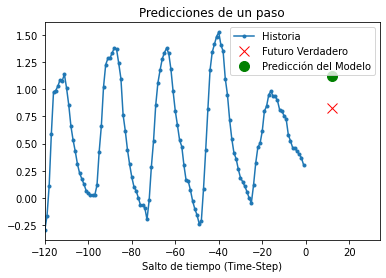

8/8 [==============================] - 0s 21ms/step


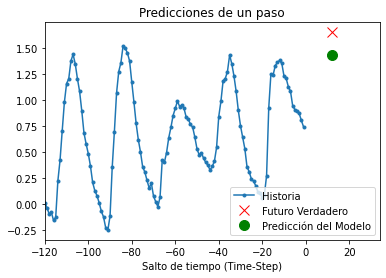

8/8 [==============================] - 0s 24ms/step


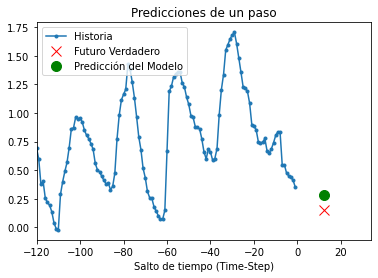

8/8 [==============================] - 0s 23ms/step


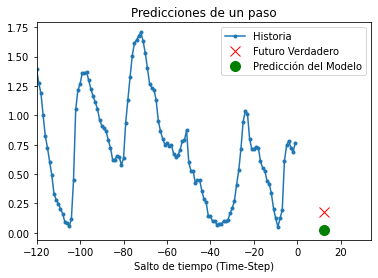

8/8 [==============================] - 0s 19ms/step


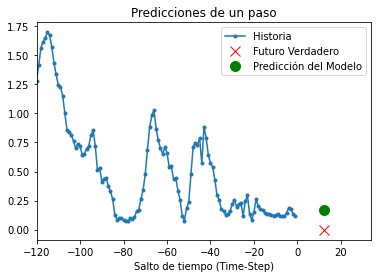

8/8 [==============================] - 0s 21ms/step


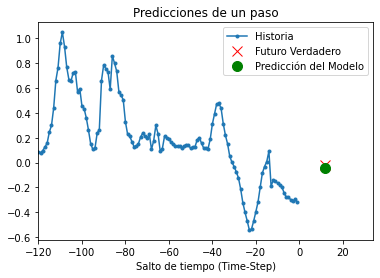

8/8 [==============================] - 0s 21ms/step


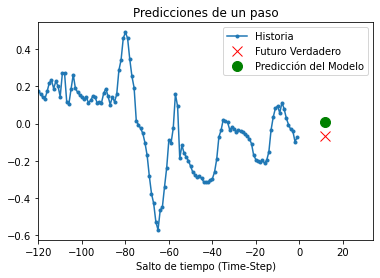

8/8 [==============================] - 0s 23ms/step


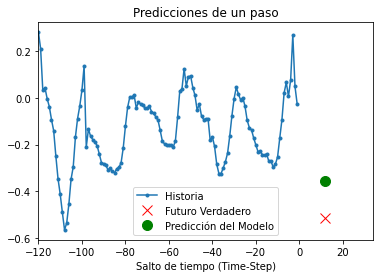

8/8 [==============================] - 0s 22ms/step


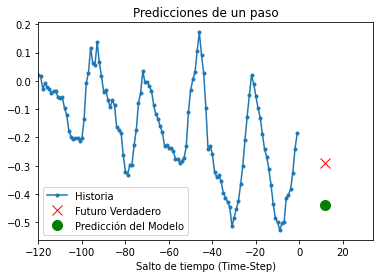

8/8 [==============================] - 0s 22ms/step


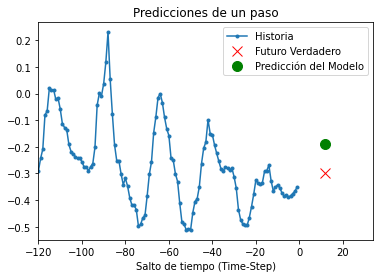

8/8 [==============================] - 0s 21ms/step


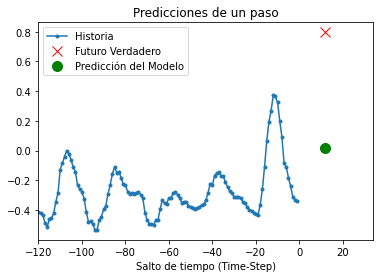

8/8 [==============================] - 0s 23ms/step


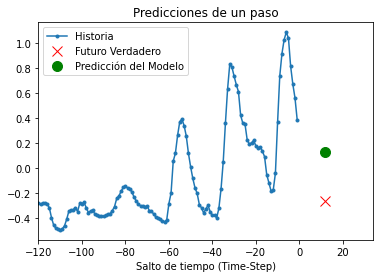

8/8 [==============================] - 0s 21ms/step


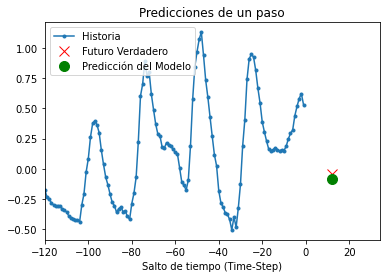

8/8 [==============================] - 0s 21ms/step


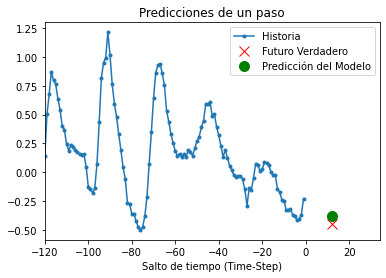

8/8 [==============================] - 0s 23ms/step


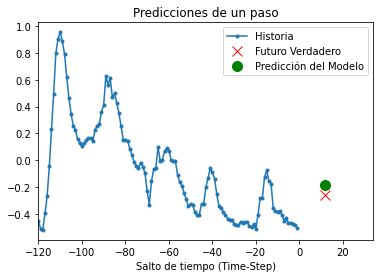

8/8 [==============================] - 0s 19ms/step


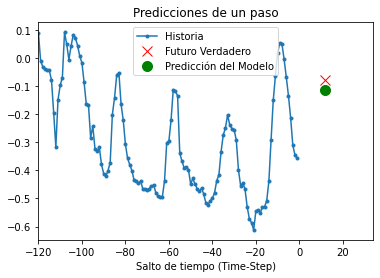

8/8 [==============================] - 0s 23ms/step


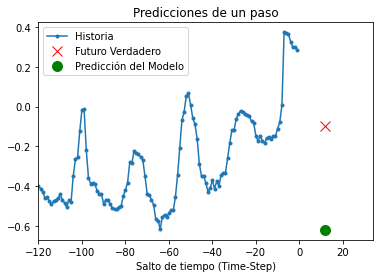

8/8 [==============================] - 0s 25ms/step


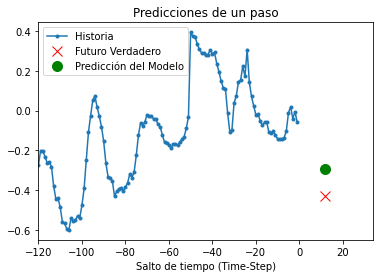

8/8 [==============================] - 0s 23ms/step


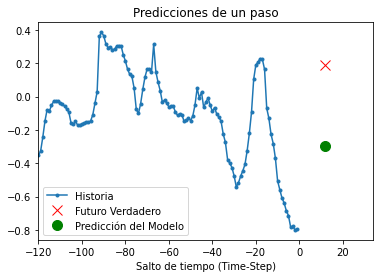

8/8 [==============================] - 0s 24ms/step


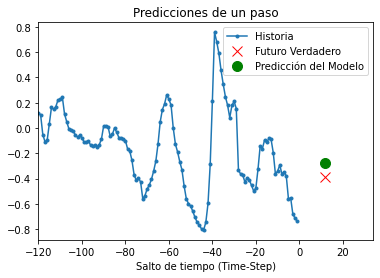

8/8 [==============================] - 0s 23ms/step


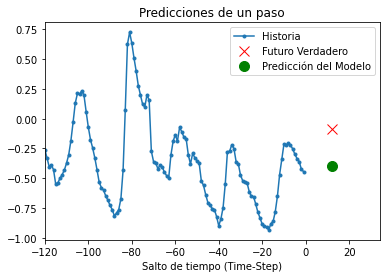

8/8 [==============================] - 0s 22ms/step


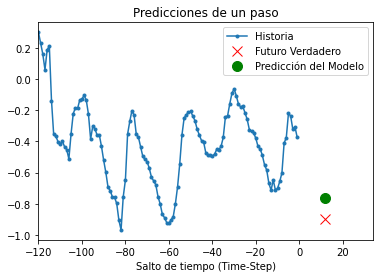

8/8 [==============================] - 0s 22ms/step


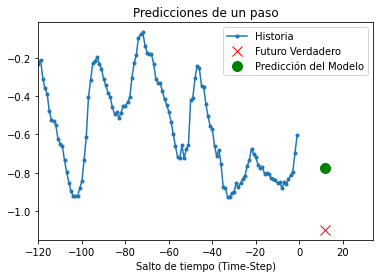

8/8 [==============================] - 0s 21ms/step


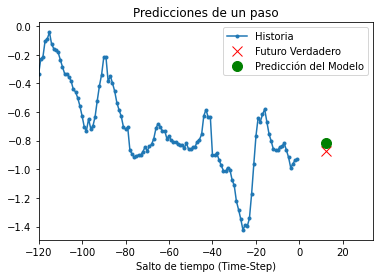

8/8 [==============================] - 0s 27ms/step


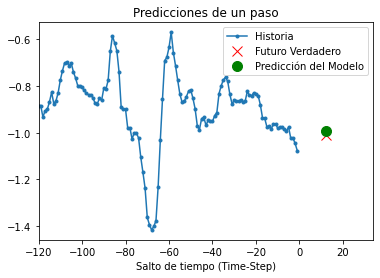

8/8 [==============================] - 0s 25ms/step


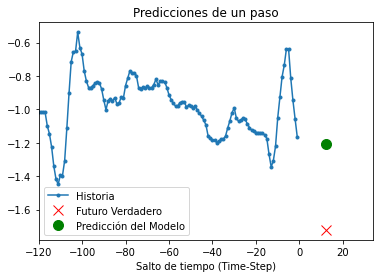

8/8 [==============================] - 0s 25ms/step


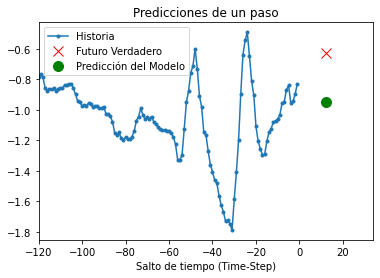

8/8 [==============================] - 0s 25ms/step


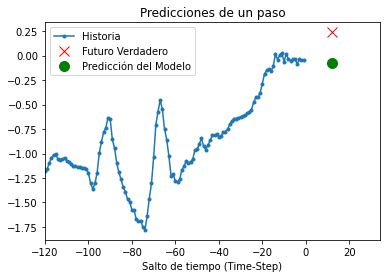

8/8 [==============================] - 0s 24ms/step


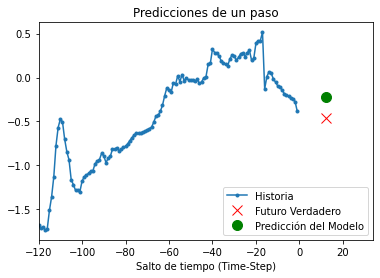

8/8 [==============================] - 0s 25ms/step


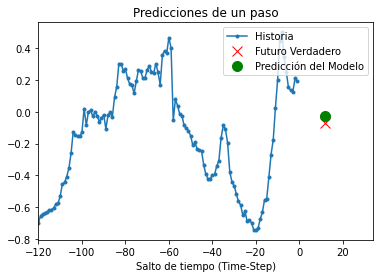

8/8 [==============================] - 0s 23ms/step


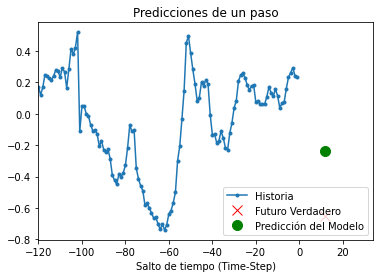

8/8 [==============================] - 0s 26ms/step


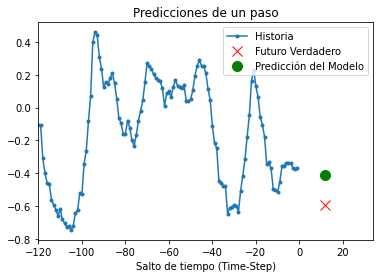

8/8 [==============================] - 0s 23ms/step


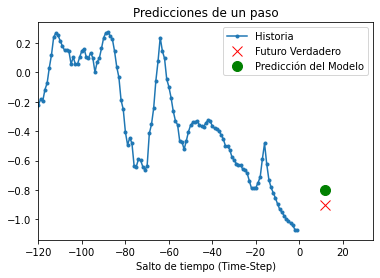

8/8 [==============================] - 0s 23ms/step


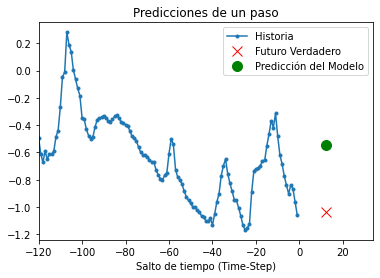

8/8 [==============================] - 0s 29ms/step


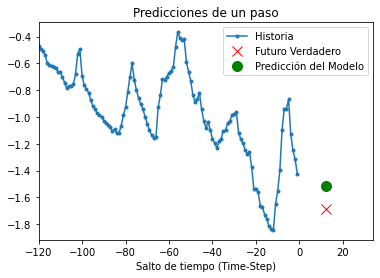

8/8 [==============================] - 0s 25ms/step


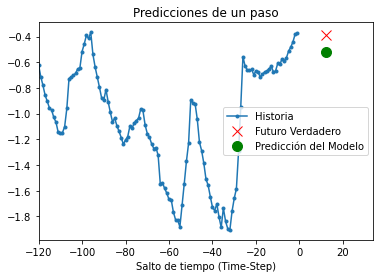

8/8 [==============================] - 0s 27ms/step


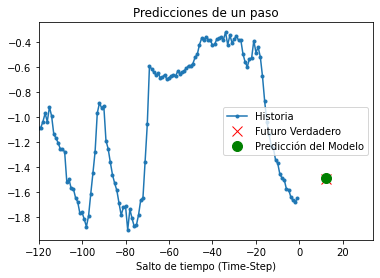

8/8 [==============================] - 0s 26ms/step


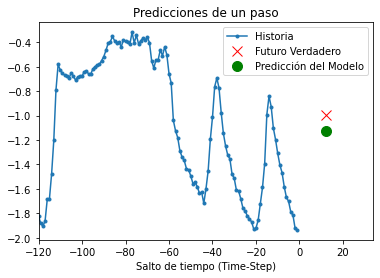

8/8 [==============================] - 0s 23ms/step


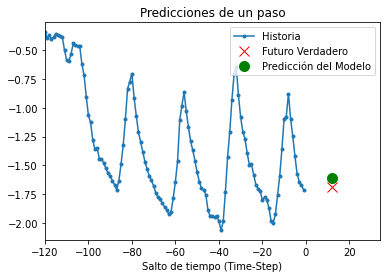

8/8 [==============================] - 0s 23ms/step


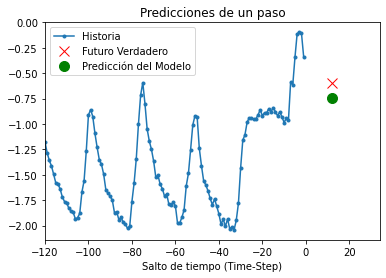

8/8 [==============================] - 0s 27ms/step


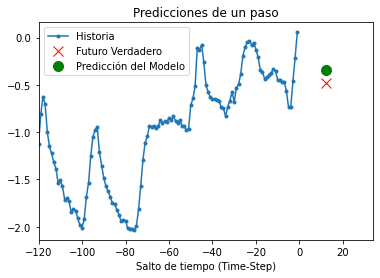

8/8 [==============================] - 0s 28ms/step


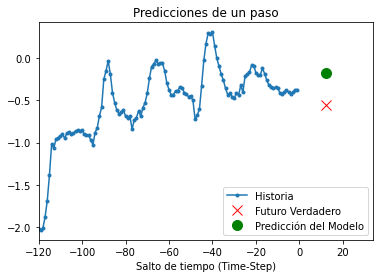

8/8 [==============================] - 0s 25ms/step


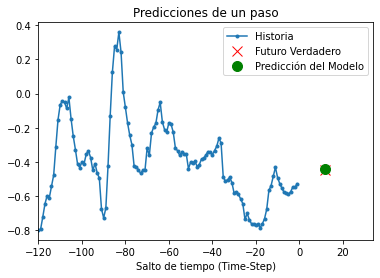

8/8 [==============================] - 0s 23ms/step


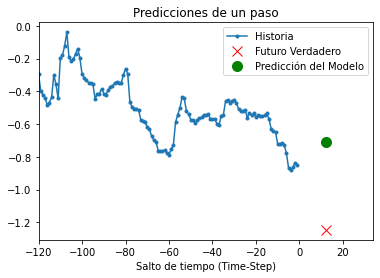

8/8 [==============================] - 0s 23ms/step


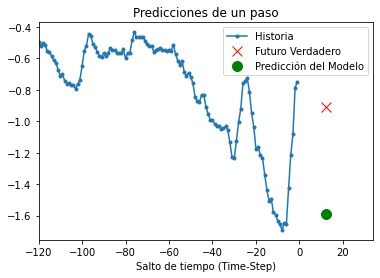

8/8 [==============================] - 0s 26ms/step


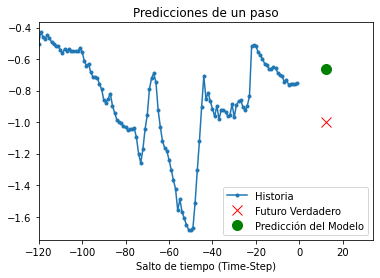

8/8 [==============================] - 0s 23ms/step


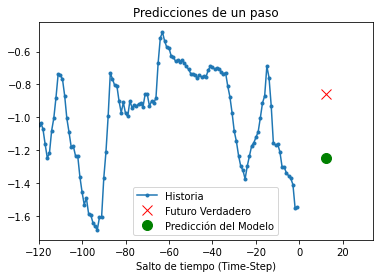

8/8 [==============================] - 0s 23ms/step


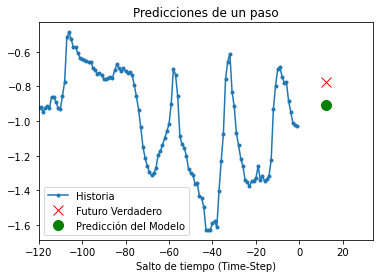

8/8 [==============================] - 0s 27ms/step


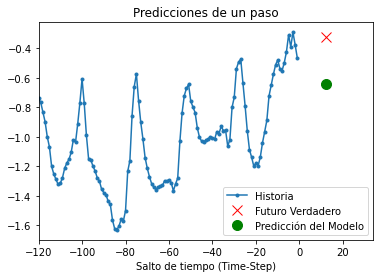

8/8 [==============================] - 0s 24ms/step


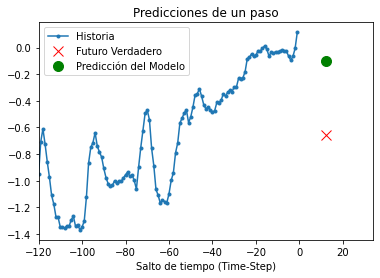

8/8 [==============================] - 0s 22ms/step


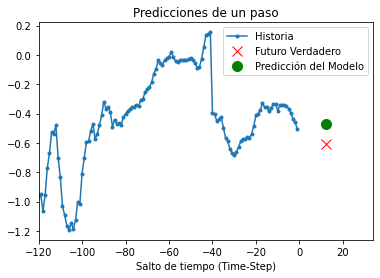

7/7 [==============================] - 0s 21ms/step


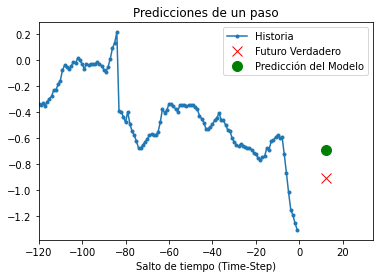

8/8 [==============================] - 0s 26ms/step


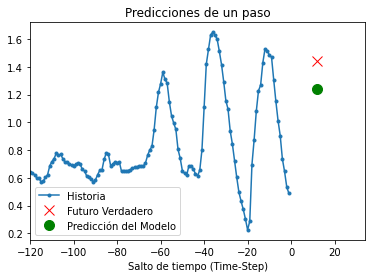

8/8 [==============================] - 0s 23ms/step


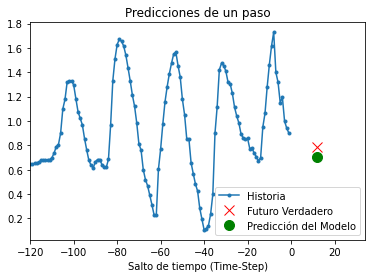

8/8 [==============================] - 0s 22ms/step


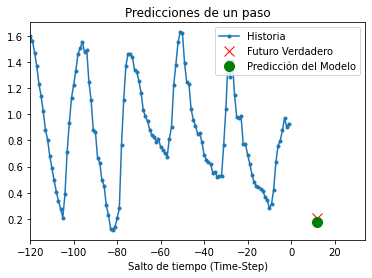

8/8 [==============================] - 0s 23ms/step


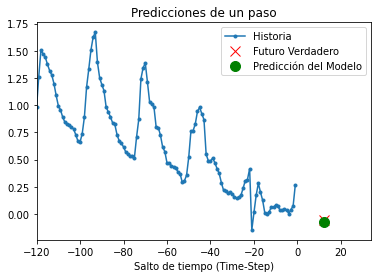

8/8 [==============================] - 0s 22ms/step


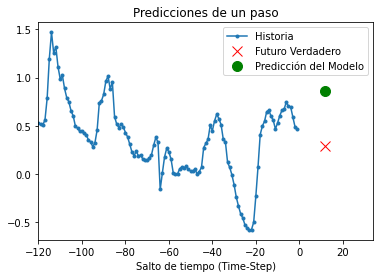

8/8 [==============================] - 0s 29ms/step


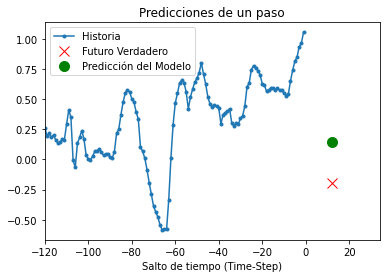

8/8 [==============================] - 0s 22ms/step


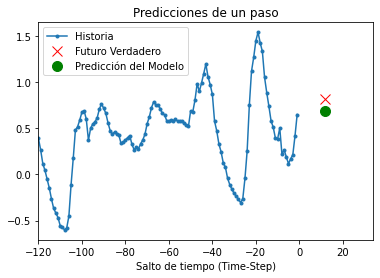

8/8 [==============================] - 0s 20ms/step


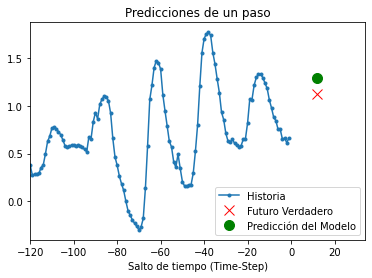

8/8 [==============================] - 0s 20ms/step


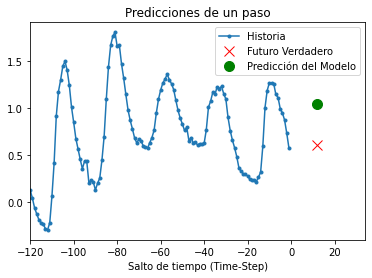

8/8 [==============================] - 0s 23ms/step


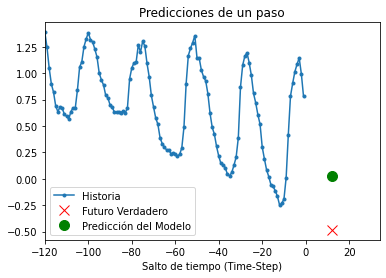

8/8 [==============================] - 0s 21ms/step


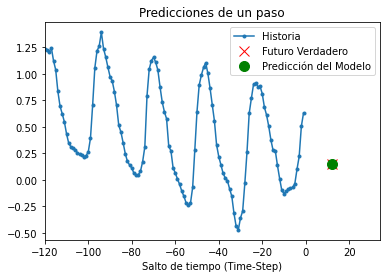

8/8 [==============================] - 0s 20ms/step


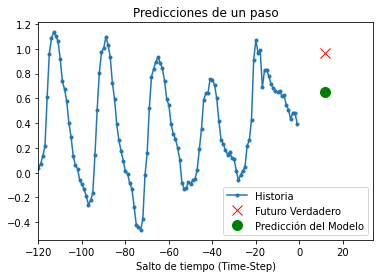

8/8 [==============================] - 0s 25ms/step


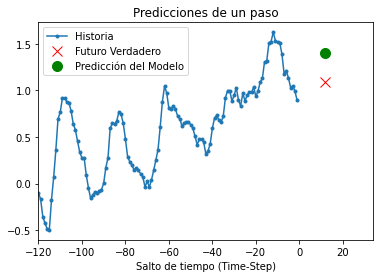

8/8 [==============================] - 0s 22ms/step


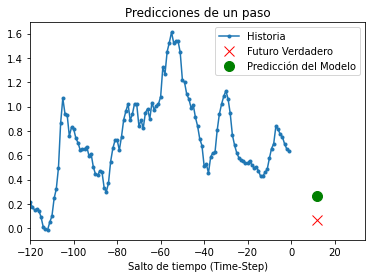

8/8 [==============================] - 0s 20ms/step


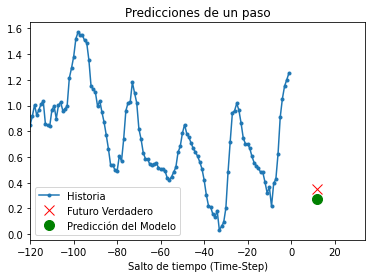

8/8 [==============================] - 0s 22ms/step


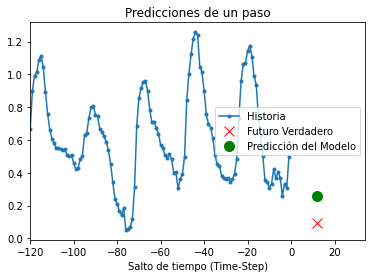

8/8 [==============================] - 0s 22ms/step


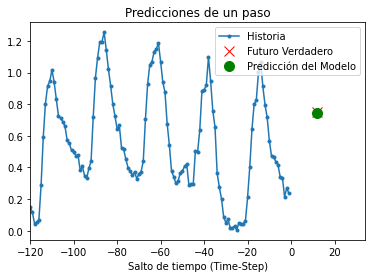

8/8 [==============================] - 0s 22ms/step


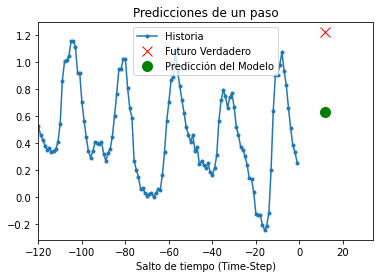

8/8 [==============================] - 0s 25ms/step


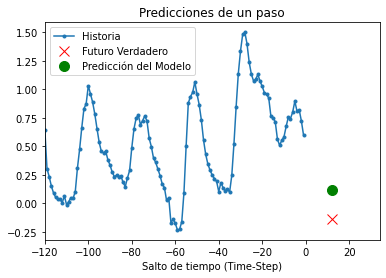

8/8 [==============================] - 0s 20ms/step


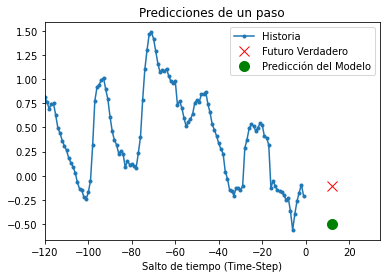

8/8 [==============================] - 0s 25ms/step


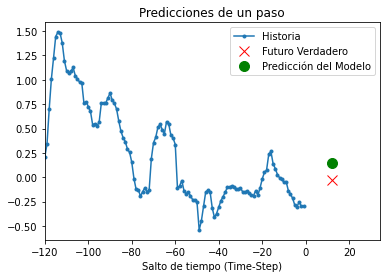

8/8 [==============================] - 0s 25ms/step


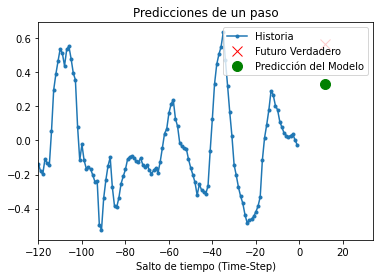

8/8 [==============================] - 0s 23ms/step


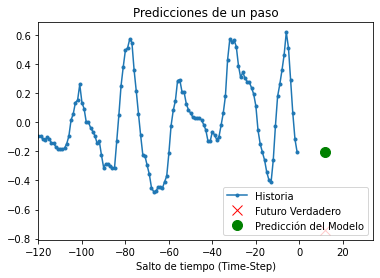

8/8 [==============================] - 0s 23ms/step


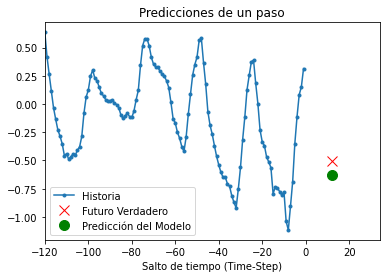

8/8 [==============================] - 0s 22ms/step


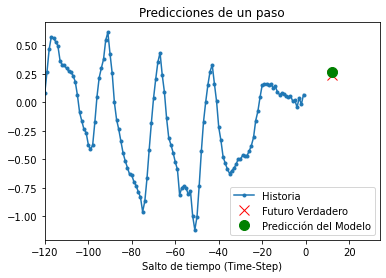

8/8 [==============================] - 0s 23ms/step


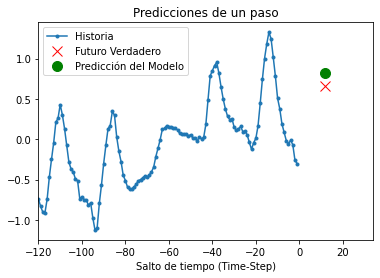

8/8 [==============================] - 0s 24ms/step


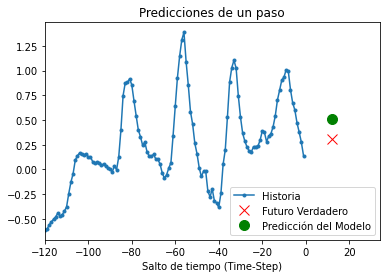

8/8 [==============================] - 0s 23ms/step


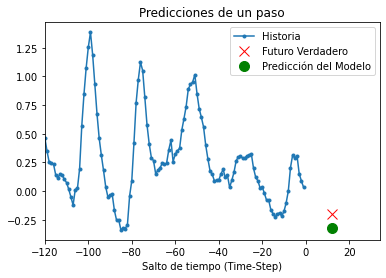

8/8 [==============================] - 0s 29ms/step


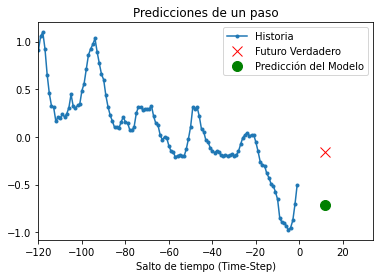

8/8 [==============================] - 0s 23ms/step


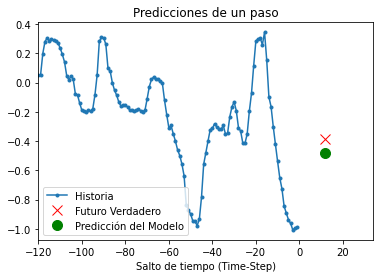

8/8 [==============================] - 0s 24ms/step


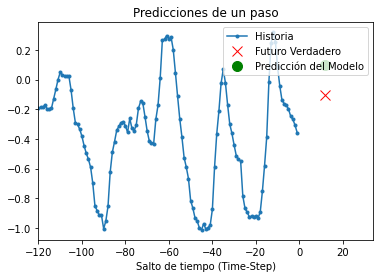

8/8 [==============================] - 0s 22ms/step


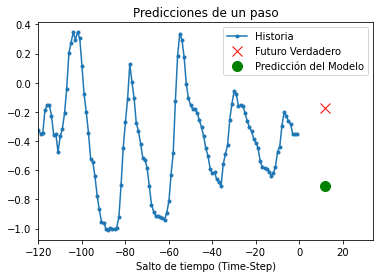

8/8 [==============================] - 0s 22ms/step


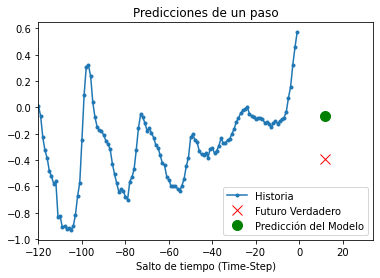

8/8 [==============================] - 0s 23ms/step


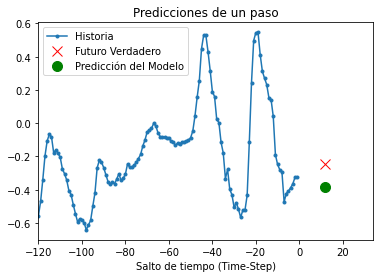

8/8 [==============================] - 0s 20ms/step


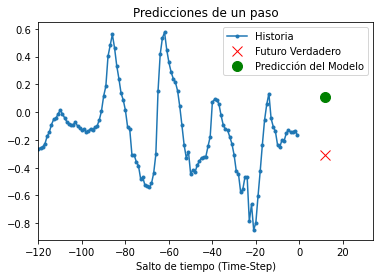

8/8 [==============================] - 0s 18ms/step


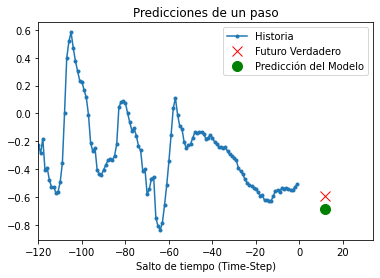

8/8 [==============================] - 0s 18ms/step


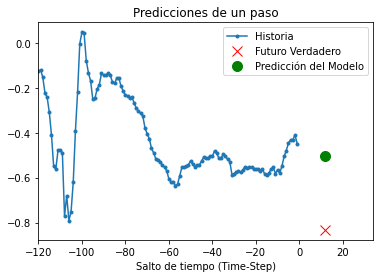

8/8 [==============================] - 0s 20ms/step


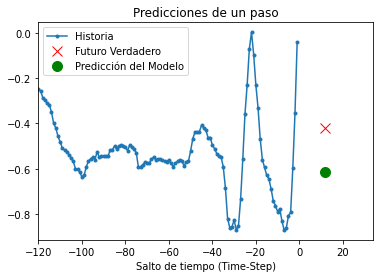

8/8 [==============================] - 0s 20ms/step


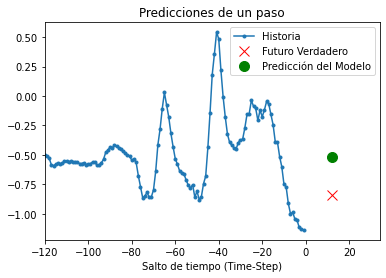

8/8 [==============================] - 0s 20ms/step


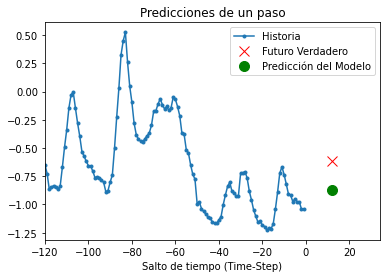

8/8 [==============================] - 0s 20ms/step


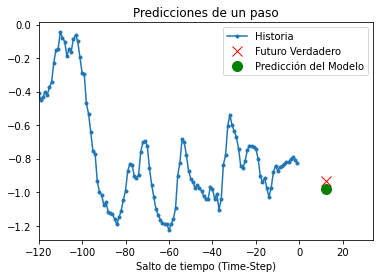

8/8 [==============================] - 0s 25ms/step


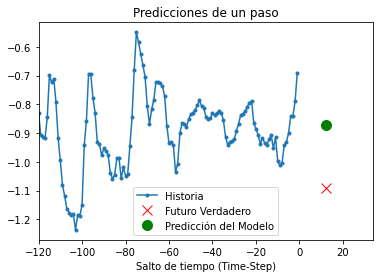

8/8 [==============================] - 0s 23ms/step


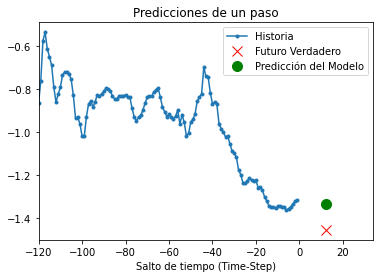

8/8 [==============================] - 0s 24ms/step


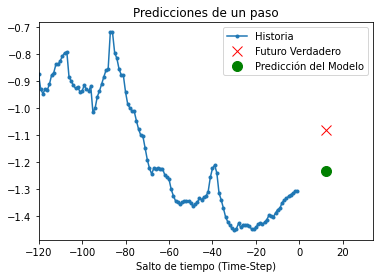

8/8 [==============================] - 0s 22ms/step


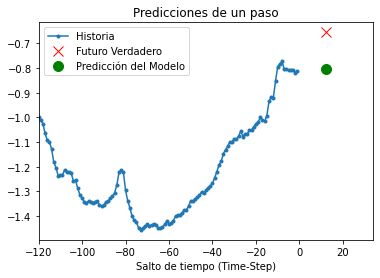

8/8 [==============================] - 0s 24ms/step


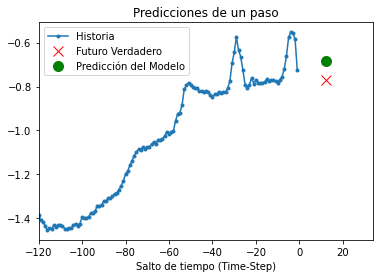

8/8 [==============================] - 0s 18ms/step


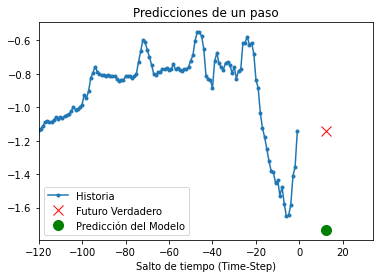

8/8 [==============================] - 0s 20ms/step


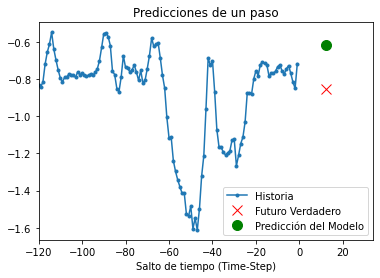

8/8 [==============================] - 0s 27ms/step


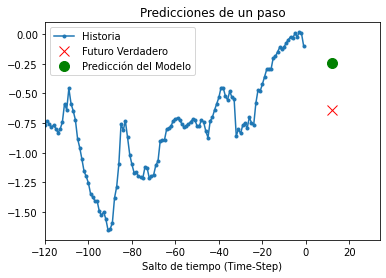

8/8 [==============================] - 0s 22ms/step


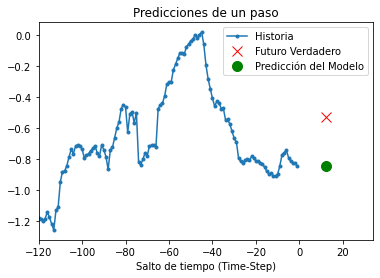

8/8 [==============================] - 0s 20ms/step


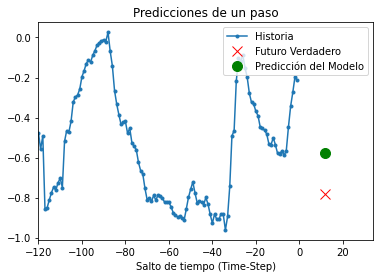

8/8 [==============================] - 0s 21ms/step


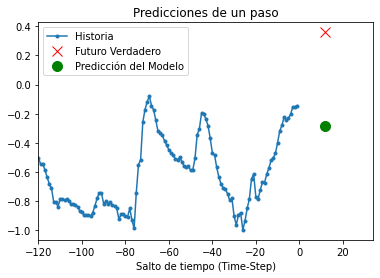

8/8 [==============================] - 0s 21ms/step


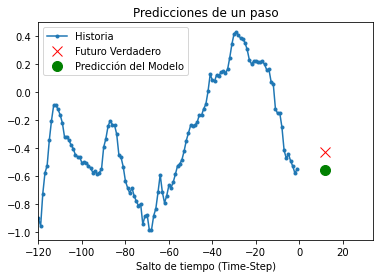

8/8 [==============================] - 0s 22ms/step


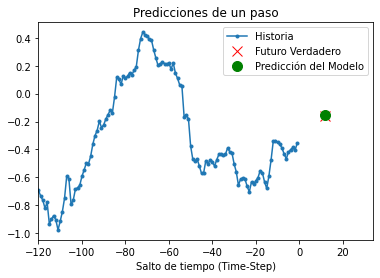

8/8 [==============================] - 0s 20ms/step


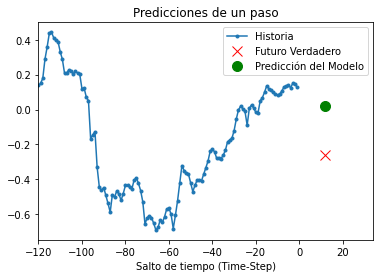

8/8 [==============================] - 0s 22ms/step


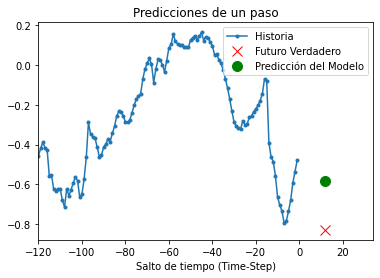

8/8 [==============================] - 0s 18ms/step


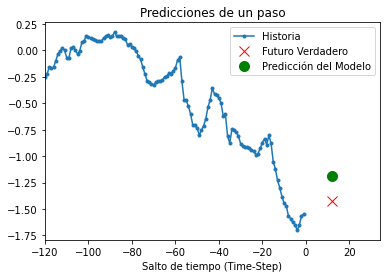

8/8 [==============================] - 0s 20ms/step


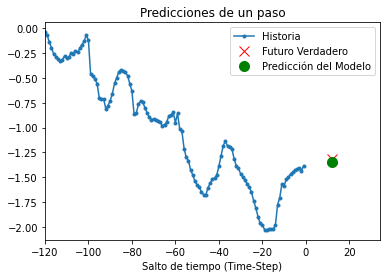

8/8 [==============================] - 0s 20ms/step


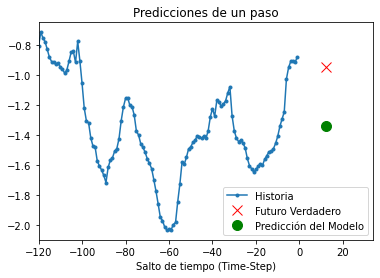

8/8 [==============================] - 0s 20ms/step


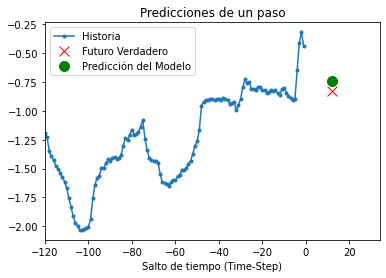

8/8 [==============================] - 0s 22ms/step


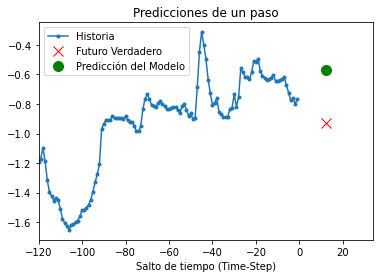

8/8 [==============================] - 0s 21ms/step


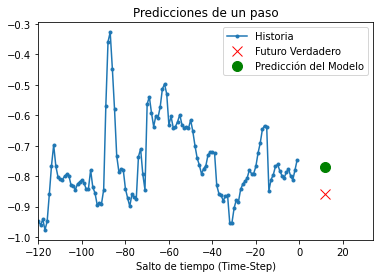

8/8 [==============================] - 0s 25ms/step


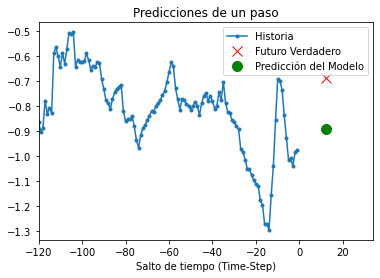

8/8 [==============================] - 0s 22ms/step


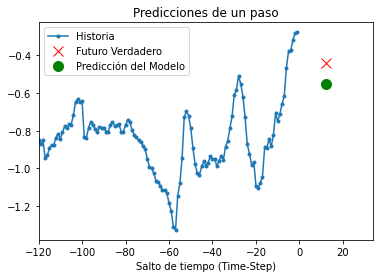

8/8 [==============================] - 0s 25ms/step


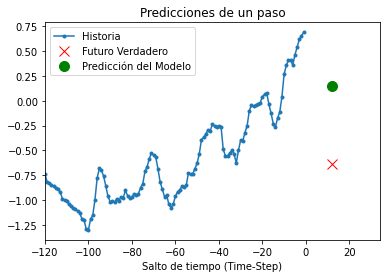

8/8 [==============================] - 0s 24ms/step


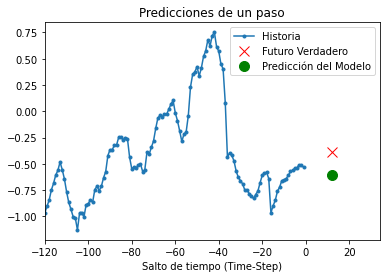

8/8 [==============================] - 0s 21ms/step


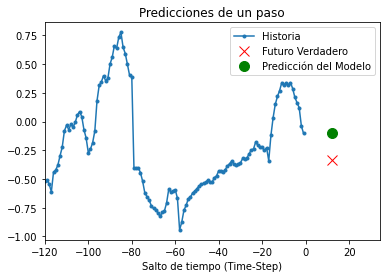

8/8 [==============================] - 0s 26ms/step


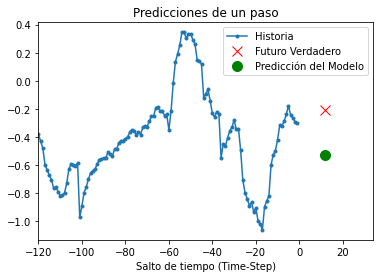

8/8 [==============================] - 0s 24ms/step


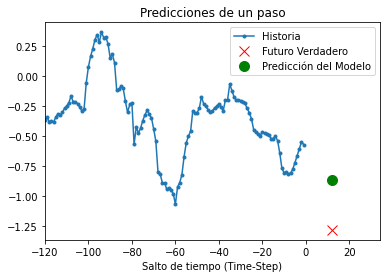

8/8 [==============================] - 0s 25ms/step


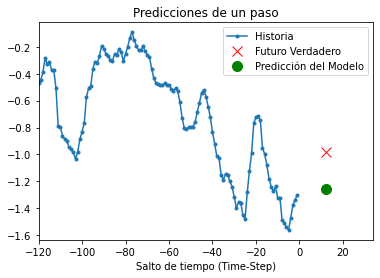

8/8 [==============================] - 0s 22ms/step


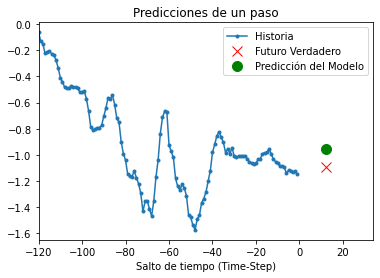

8/8 [==============================] - 0s 22ms/step


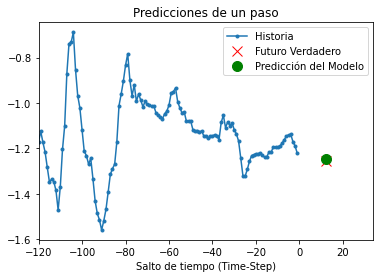

8/8 [==============================] - 0s 20ms/step


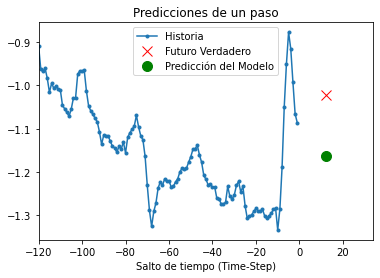

8/8 [==============================] - 0s 22ms/step


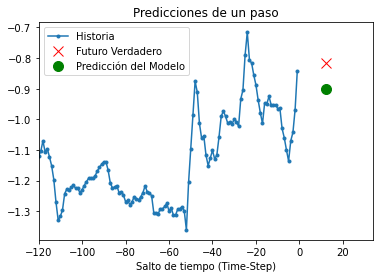

8/8 [==============================] - 0s 20ms/step


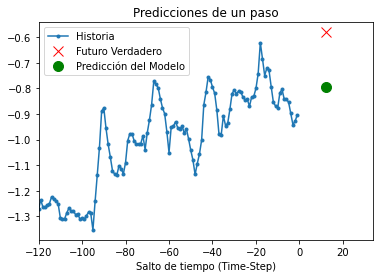

8/8 [==============================] - 0s 20ms/step


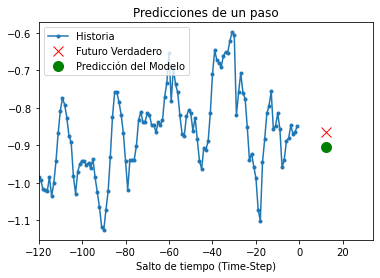

8/8 [==============================] - 0s 23ms/step


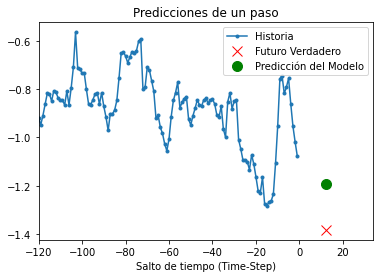

8/8 [==============================] - 0s 24ms/step


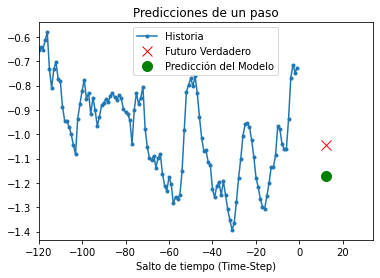

8/8 [==============================] - 0s 26ms/step


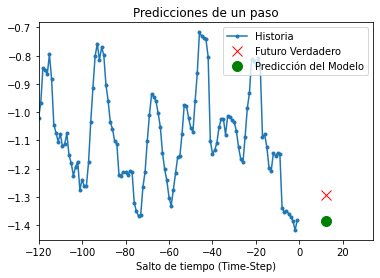

8/8 [==============================] - 0s 18ms/step


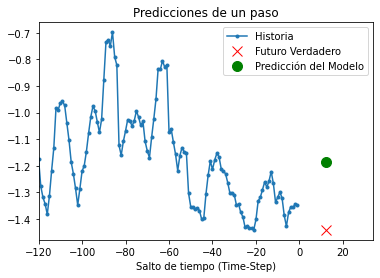

8/8 [==============================] - 0s 18ms/step


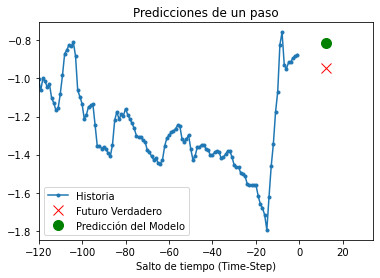

8/8 [==============================] - 0s 20ms/step


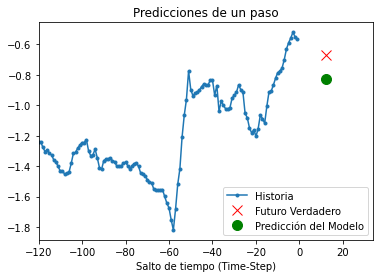

8/8 [==============================] - 0s 21ms/step


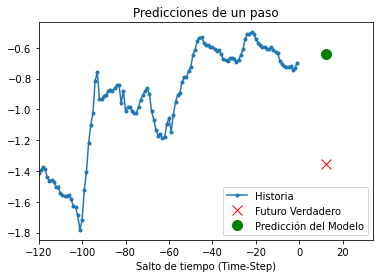

8/8 [==============================] - 0s 25ms/step


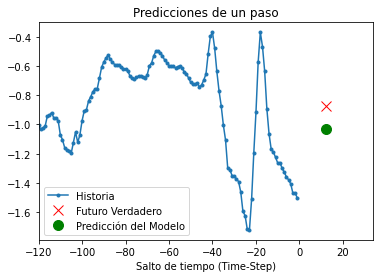

8/8 [==============================] - 0s 25ms/step


In [32]:
y_pred =[]

for x, y in val_data_single:
    pred = single_step_model.predict(x)
    
    plot = show_plot([x[0][:, 1].numpy(), y[0].numpy(),
                    single_step_model.predict(x)[0]], 12,
                   'Predicciones de un paso')
    plot.show()


In [ ]:
#y_pred = single_step_model.predict(x_val_single)
y_pred = np.squeeze(y_pred,axis=1)
y_test = y_val_single

In [ ]:
print(y_pred.shape)
print(y_test.shape)

(119759,)
(119759,)


### <span style="color:#4CC9F0">rms</span>


In [ ]:
rmsLSTM = np.sqrt(np.mean(np.power(y_pred-y_test,2)))
print(rmsLSTM )

0.33212310373385173


In [ ]:
def plot_series(y_test,y_pred, title, x_label, y_label,rms,epochs):
    plt.plot(np.arange(0, len(y_test)), y_test, marker='.', label="verdadero")
    plt.plot(np.arange(0, len(y_test)), y_pred, marker='+', label="predicho")
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    plt.annotate("rms="+str(round(rms,2)) , xy=(500, 1.3), size = 10)
    #plt.annotate("modelo = LSTM(50), timestep=60" , xy=(100, 146), size = 15)
    #
    plt.annotate("epochs="+str(epochs) , xy=(500, 1.5), size = 10)
    plt.title(title)
    plt.legend()
    plt.show()
    


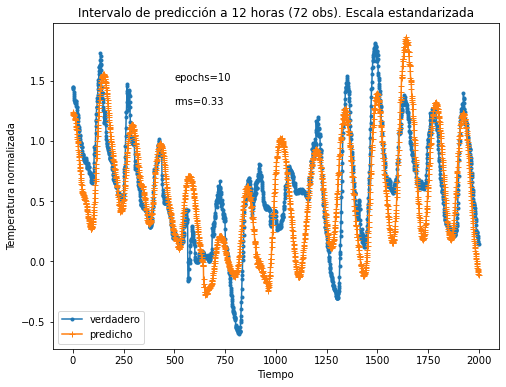

In [ ]:
title = "Intervalo de predicción a 12 horas (72 obs). Escala estandarizada"
x_label = 'Tiempo'
y_label = 'Temperatura normalizada'
rms = rmsLSTM
plot_series(y_test[:2000], y_pred[:2000],title,x_label, y_label, rms,epochs=10 )

## <span style="color:#4361EE">Modelo multipaso</span>

 En un modelo de predicción de varios pasos, dado un historial pasado, el modelo necesita aprender a predecir un rango de valores futuros. Por lo tanto, a diferencia de un modelo de un solo paso, donde solo se predice un único punto futuro, un modelo de varios pasos predice una secuencia del futuro.

Para el modelo de varios pasos, los datos de entrenamiento nuevamente consisten en grabaciones de los últimos cinco días muestreados cada hora. Sin embargo, aquí, el modelo necesita aprender a predecir la temperatura durante las próximas 12 horas. Como se toma una observación cada 10 minutos, el resultado es 72 predicciones. Para esta tarea, el conjunto de datos debe prepararse en consecuencia, por lo tanto, el primer paso es crearlo nuevamente, pero con una ventana de destino diferente.

In [ ]:
future_target = 72
x_train_multi, y_train_multi = multivariate_data(dataset, dataset[:, 1], 0,
                                                 TRAIN_SPLIT, past_history,
                                                 future_target, STEP)
x_val_multi, y_val_multi = multivariate_data(dataset, dataset[:, 1],
                                             TRAIN_SPLIT, None, past_history,
                                             future_target, STEP)

Revisemos una muestra en un punto.

In [ ]:
print ('Single window of past history : {}'.format(x_train_multi[0].shape))
print ('\n Target temperature to predict : {}'.format(y_train_multi[0].shape))

Single window of past history : (120, 3)

 Target temperature to predict : (72,)


In [ ]:
train_data_multi = tf.data.Dataset.from_tensor_slices((x_train_multi, y_train_multi))
train_data_multi = train_data_multi.cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE).repeat()

val_data_multi = tf.data.Dataset.from_tensor_slices((x_val_multi, y_val_multi))
val_data_multi = val_data_multi.batch(BATCH_SIZE).repeat()

Plot de una muestra en un punto.

In [ ]:
def multi_step_plot(history, true_future, prediction):
  plt.figure(figsize=(12, 6))
  num_in = create_time_steps(len(history))
  num_out = len(true_future)

  plt.plot(num_in, np.array(history[:, 1]), label='History')
  plt.plot(np.arange(num_out)/STEP, np.array(true_future), 'bo',
           label='True Future')
  if prediction.any():
    plt.plot(np.arange(num_out)/STEP, np.array(prediction), 'ro',
             label='Predicted Future')
  plt.legend(loc='upper left')
  plt.show()

En este gráfico y otros similares, el historial y los datos futuros se muestrean cada hora.

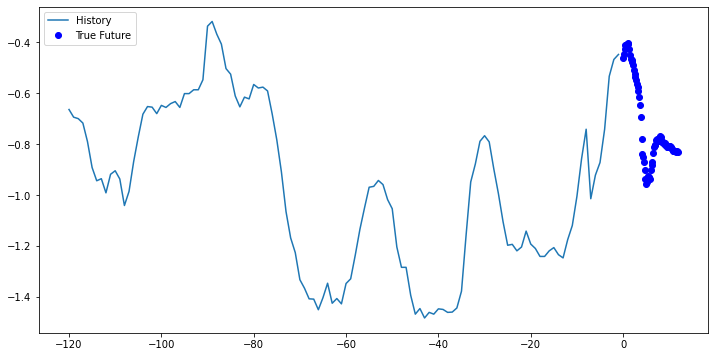

In [ ]:
for x, y in train_data_multi.take(1):
  multi_step_plot(x[0], y[0], np.array([0]))

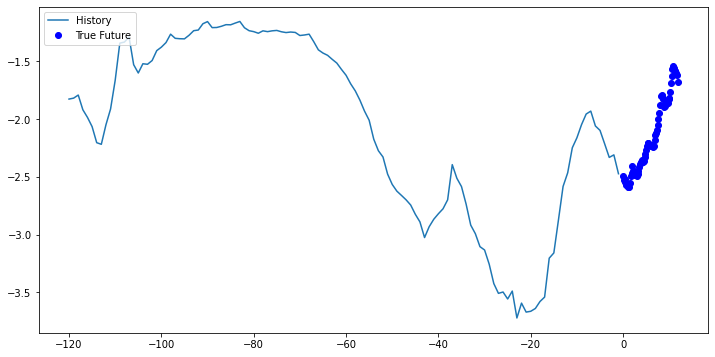

In [ ]:
for x, y in train_data_multi.take(1):
  multi_step_plot(x[0], y[0], np.array([0]))

Dado que la tarea aquí es un poco más complicada que la tarea anterior, el modelo ahora consta de dos capas LSTM. Finalmente, dado que se hacen 72 predicciones, la capa densa genera 72 predicciones.

### <span style="color:#4CC9F0">Modelo LSTM</span>


In [ ]:
multi_step_model = tf.keras.models.Sequential()
multi_step_model.add(tf.keras.layers.LSTM(32,
                                          return_sequences=True,
                                          input_shape=x_train_multi.shape[-2:]))
multi_step_model.add(tf.keras.layers.LSTM(16, activation='relu'))
multi_step_model.add(tf.keras.layers.Dense(72))

multi_step_model.compile(optimizer=tf.keras.optimizers.RMSprop(clipvalue=1.0), loss='mae')

In [ ]:
multi_step_model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm (LSTM)                  (None, 120, 32)           4608      
_________________________________________________________________
lstm_1 (LSTM)                (None, 16)                3136      
_________________________________________________________________
dense_2 (Dense)              (None, 72)                1224      
Total params: 8,968
Trainable params: 8,968
Non-trainable params: 0
_________________________________________________________________


Veamos como predice el modelo antes de entrenarlo.



In [ ]:
for x, y in val_data_multi.take(1):
  print (multi_step_model.predict(x).shape)


(256, 72)


### <span style="color:#4CC9F0">Entrena</span>


In [ ]:
multi_step_history = multi_step_model.fit(train_data_multi, epochs=EPOCHS,
                                          steps_per_epoch=EVALUATION_INTERVAL,
                                          validation_data=val_data_multi,
                                          validation_steps=50)

Epoch 1/10
200/200 [==============================] - 227s 1s/step - loss: 1.6560 - val_loss: 0.3004
Epoch 2/10
200/200 [==============================] - 208s 1s/step - loss: 0.3412 - val_loss: 0.2851
Epoch 3/10
200/200 [==============================] - 183s 914ms/step - loss: 0.3162 - val_loss: 0.2415
Epoch 4/10
 86/200 [===========>..................] - ETA: 1:39 - loss: 0.2504

In [ ]:
plot_train_history(multi_step_history, 'Entrenamiento del Modelo Multipaso y función de pérdida')

## <span style="color:#4361EE">Predicciones</span>


Veamos ahora qué tan bien la red ha aprendido a predecir el futuro.

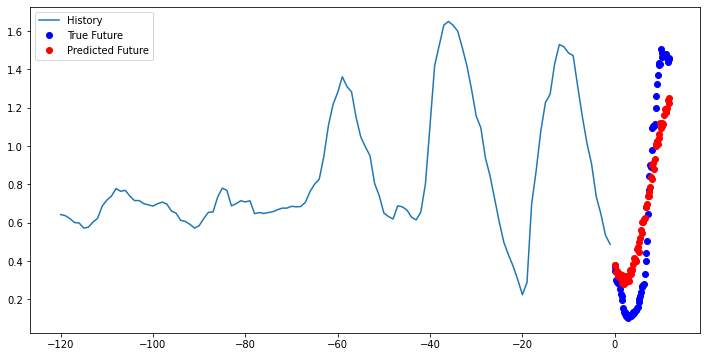

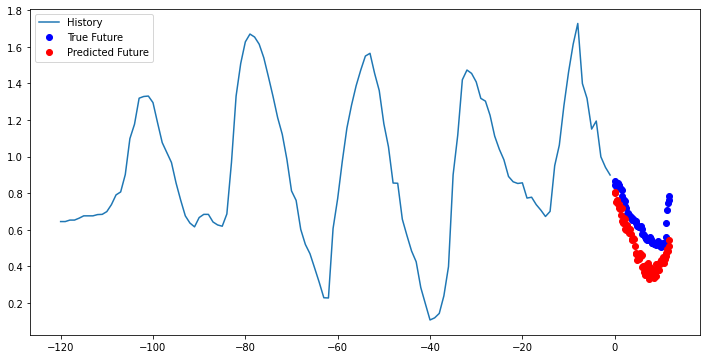

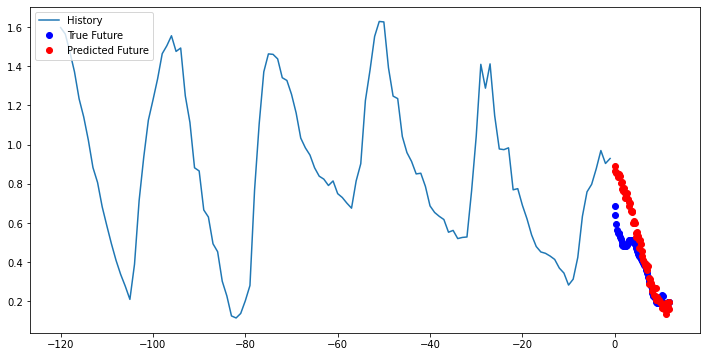

In [ ]:
for x, y in val_data_multi.take(3):
  multi_step_plot(x[0], y[0], multi_step_model.predict(x)[0])

## <span style="color:#4361EE">Los siguientes pasos</span>


Este cuaderno fue una introducción rápida a la predicción de series de tiempo utilizando un RNR. Ahora puede intentar predecir el mercado de valores y convertirse en multimillonario.

Además, también puede escribir un generador para generar datos (en lugar de la función uni / multivariate_data), que sería más eficiente en la memoria. También puede ver [time series windowing](https://www.tensorflow.org/guide/data#time_series_windowing). Úselo para mejorar el código de este cuaderno.

## <span style="color:#4361EE">Referencias</span>

1. [Introducción a Redes LSTM](Intro_LSTM.ipynb)
1. [Time Series Forecasting with LSTMs using TensorFlow 2 and Keras in Python](https://towardsdatascience.com/time-series-forecasting-with-lstms-using-tensorflow-2-and-keras-in-python-6ceee9c6c651/)
1. [Dive into Deep Learnig](https://d2l.ai/)
1. [Understanding LSTM Networks](https://colah.github.io/posts/2015-08-Understanding-LSTMs/)
1. Ralf C. Staudemeyer and Eric Rothstein Morris,[*Understanding LSTM a tutorial into Long Short-Term Memory Recurrent Neural Networks*](https://arxiv.org/pdf/1909.09586.pdf), arxiv, September 2019
1. Karpathy, [*The Unreasonable Effectiveness of Recurrent Neural Networks*](http://karpathy.github.io/2015/05/21/rnn-effectiveness/)
1. Anton Lucanus, [Making Automation More Efficient by Learning from Historical Trade Data](https://datafloq.com/read/making-automation-more-efficient-by-learning-from-/7444), 8:43 AM, January 7, 2020
1. https://www.analyticsvidhya.com/blog/2018/10/predicting-stock-price-machine-learningnd-deep-learning-techniques-python/
1. https://www.youtube.com/watch?v=2BrpKpWwT2A&list=PLQVvvaa0QuDcOdF96TBtRtuQksErCEBYZ&index=1
1. https://towardsdatascience.com/using-lstms-for-stock-market-predictions-tensorflow-9e83999d4653
1. https://github.com/llSourcell/Reinforcement_Learning_for_Stock_Prediction/blob/master/README.md
1. [Tensoflow-Time series forecasting](https://www.tensorflow.org/tutorials/structured_data/time_series)